In [1]:
print('')

aim to plot change in gradient as consider changing minimum magntiude of data

In [1]:
import os
import scipy
import numpy as np
import matplotlib.pyplot as plt
import obspy
import pickle
from obspy import UTCDateTime
from obspy.clients.fdsn import Client
import pandas as pd
import math

import matplotlib
matplotlib.rcParams.update({'font.size': 20})

In [2]:
import warnings
warnings.filterwarnings("ignore")

In [3]:
from spearman_plotting_func import *

change magnitude limits, colors in functions file

In [4]:
filenames = ['eq_object_03s_bandpass_01_19_snr_20_blank_0_new_snr20',
            'eq_object_05s_bandpass_01_19_snr_20_blank_0_new_snr20',
            'eq_object_1s_bandpass_01_19_snr_20_blank_0_new_snr20',
            'eq_object_4s_bandpass_01_19_snr_20_blank_0_new_snr20']


'''filenames = ['eq_object_03s_bandpass_01_19_snr_20_blank_0_new',
              'eq_object_03s_bandpass_01_19_snr_20_blank_005_new',
              'eq_object_03s_bandpass_01_19_snr_20_blank_01_new']

filenames = ['eq_object_05s_bandpass_01_19_snr_20_blank_0_new',
             'eq_object_05s_bandpass_01_19_snr_20_blank_005_new', 
             'eq_object_05s_bandpass_01_19_snr_20_blank_01_new',
             'eq_object_05s_bandpass_01_19_snr_20_blank_025_new',
             'eq_object_1s_bandpass_01_19_snr_20_blank_0_new', 
             'eq_object_1s_bandpass_01_19_snr_20_blank_005_new',
             'eq_object_1s_bandpass_01_19_snr_20_blank_01_new',
             'eq_object_1s_bandpass_01_19_snr_20_blank_025_new',
             'eq_object_1s_bandpass_01_19_snr_20_blank_05_new',
              'eq_object_4s_bandpass_01_19_snr_20_blank_0_new',
              'eq_object_4s_bandpass_01_19_snr_20_blank_005_new',
              'eq_object_4s_bandpass_01_19_snr_20_blank_01_new',
              'eq_object_4s_bandpass_01_19_snr_20_blank_025_new',
              'eq_object_4s_bandpass_01_19_snr_20_blank_05_new']'''

filenames = ['eq_object_03s_bandpass_01_19_snr_20_blank_0_new_snr20',
            'eq_object_05s_bandpass_01_19_snr_20_blank_0_new_snr20',
            'eq_object_1s_bandpass_01_19_snr_20_blank_0_new_snr20',
            'eq_object_4s_bandpass_01_19_snr_20_blank_0_new_snr20',
            'eq_object_03s_bandpass_01_19_snr_20_blank_0_new_snr5',
             'eq_object_03s_bandpass_01_19_snr_20_blank_005_new_snr5', 
             'eq_object_03s_bandpass_01_19_snr_20_blank_01_new_snr5',
             'eq_object_05s_bandpass_01_19_snr_20_blank_0_new_snr5',
             'eq_object_05s_bandpass_01_19_snr_20_blank_005_new_snr5', 
             'eq_object_05s_bandpass_01_19_snr_20_blank_01_new_snr5',
             'eq_object_05s_bandpass_01_19_snr_20_blank_025_new_snr5',
             'eq_object_1s_bandpass_01_19_snr_20_blank_0_new_snr5', 
             'eq_object_1s_bandpass_01_19_snr_20_blank_005_new_snr5',
             'eq_object_1s_bandpass_01_19_snr_20_blank_01_new_snr5',
             'eq_object_1s_bandpass_01_19_snr_20_blank_025_new_snr5',
             'eq_object_1s_bandpass_01_19_snr_20_blank_05_new_snr5',
              'eq_object_4s_bandpass_01_19_snr_20_blank_0_new_snr5',
              'eq_object_4s_bandpass_01_19_snr_20_blank_005_new_snr5',
              'eq_object_4s_bandpass_01_19_snr_20_blank_01_new_snr5',
              'eq_object_4s_bandpass_01_19_snr_20_blank_025_new_snr5',
              'eq_object_4s_bandpass_01_19_snr_20_blank_05_new_snr5',
              'eq_object_03s_bandpass_01_19_snr_20_blank_0_new_snr20',
             'eq_object_03s_bandpass_01_19_snr_20_blank_005_new_snr20', 
             'eq_object_03s_bandpass_01_19_snr_20_blank_01_new_snr20',
             'eq_object_05s_bandpass_01_19_snr_20_blank_0_new_snr20',
             'eq_object_05s_bandpass_01_19_snr_20_blank_005_new_snr20', 
             'eq_object_05s_bandpass_01_19_snr_20_blank_01_new_snr20',
             'eq_object_05s_bandpass_01_19_snr_20_blank_025_new_snr20',
             'eq_object_1s_bandpass_01_19_snr_20_blank_0_new_snr20', 
             'eq_object_1s_bandpass_01_19_snr_20_blank_005_new_snr20',
             'eq_object_1s_bandpass_01_19_snr_20_blank_01_new_snr20',
             'eq_object_1s_bandpass_01_19_snr_20_blank_025_new_snr20',
             'eq_object_1s_bandpass_01_19_snr_20_blank_05_new_snr20',
              'eq_object_4s_bandpass_01_19_snr_20_blank_0_new_snr20',
              'eq_object_4s_bandpass_01_19_snr_20_blank_005_new_snr20',
              'eq_object_4s_bandpass_01_19_snr_20_blank_01_new_snr20',
              'eq_object_4s_bandpass_01_19_snr_20_blank_025_new_snr20',
              'eq_object_4s_bandpass_01_19_snr_20_blank_05_new_snr20']


eq_object_03s_bandpass_01_19_snr_20_blank_0_new_snr20
tp 0.4787708116760028
pgd 0.6089165968103959
tc 0.5572061023765785
iv2 0.44732639520425554
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


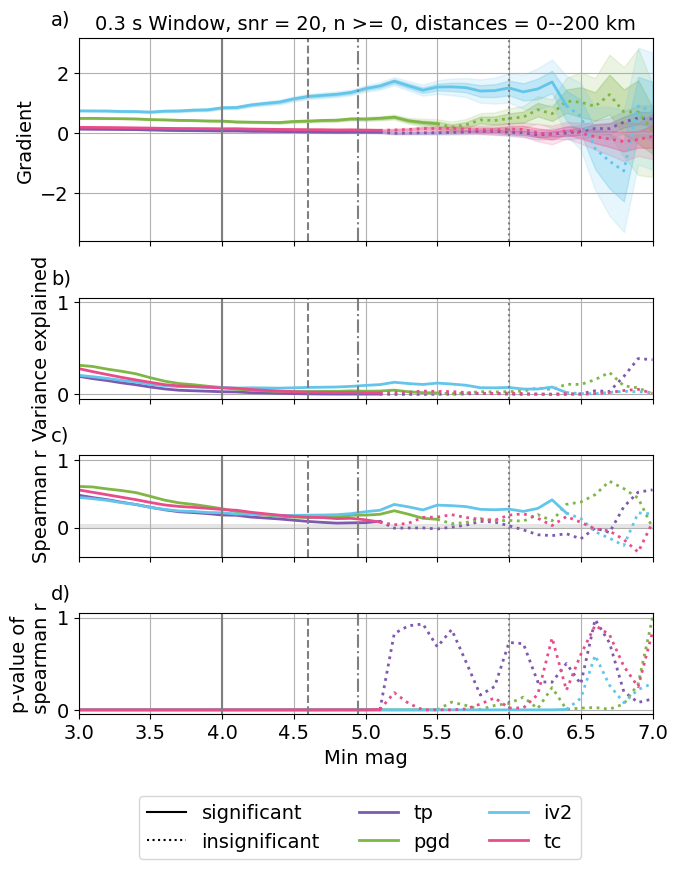

tp 0.47090884952291506
pgd 0.6015954116204764
tc 0.5471434272081742
iv2 0.4446846280107827
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


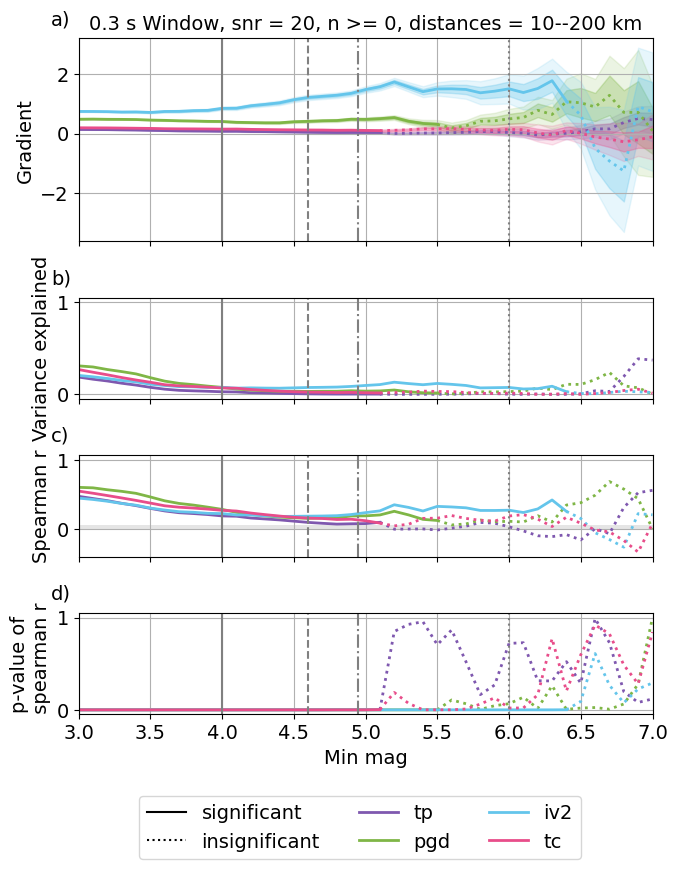

tp 0.4537511941607365
pgd 0.591319471998318
tc 0.5309970726686649
iv2 0.4409473375684877
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


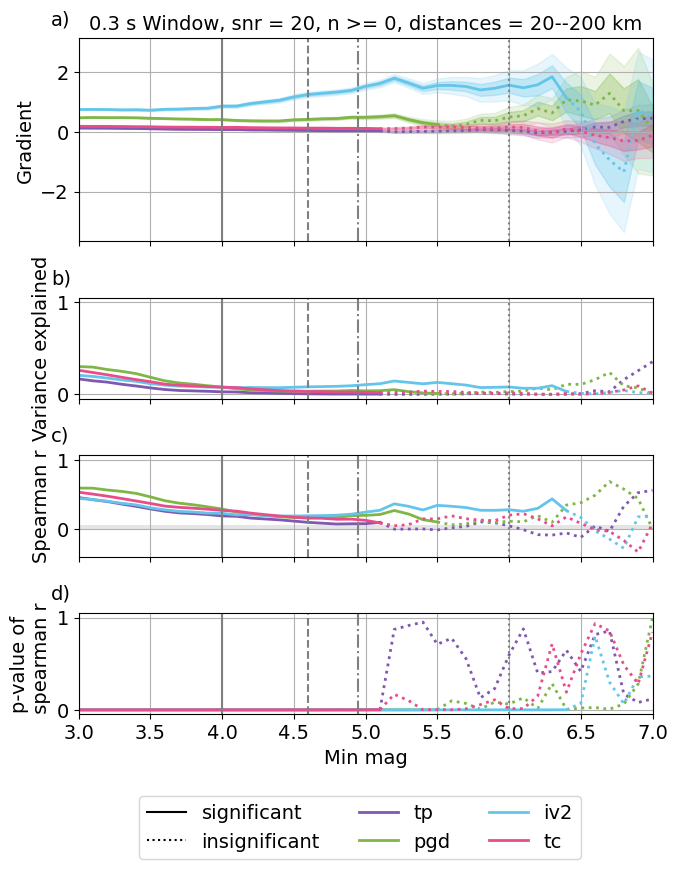

tp 0.44091748363953515
pgd 0.5783480527535996
tc 0.5058832841507201
iv2 0.4282272044621029
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


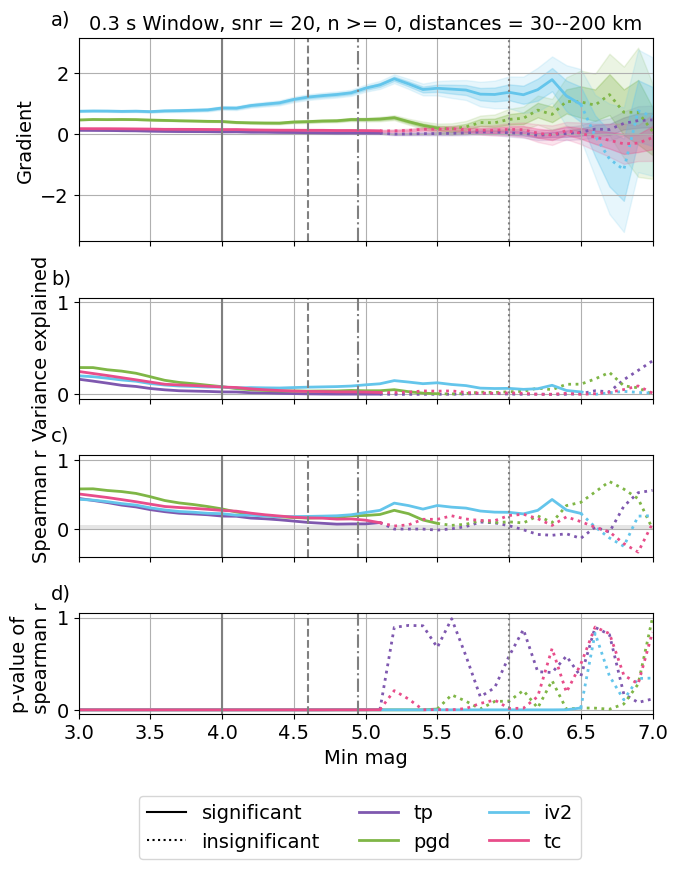

tp 0.43186269278180256
pgd 0.568657457388001
tc 0.4865925393194123
iv2 0.419616106570247
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


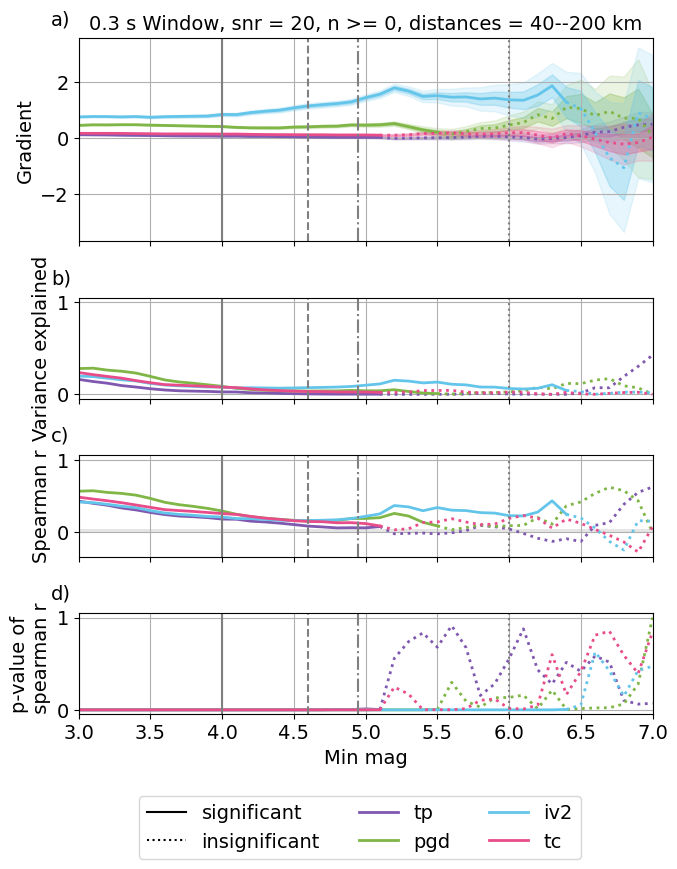

tp 0.42050859711707506
pgd 0.5744901948627723
tc 0.46245069750025
iv2 0.4310452631611048
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


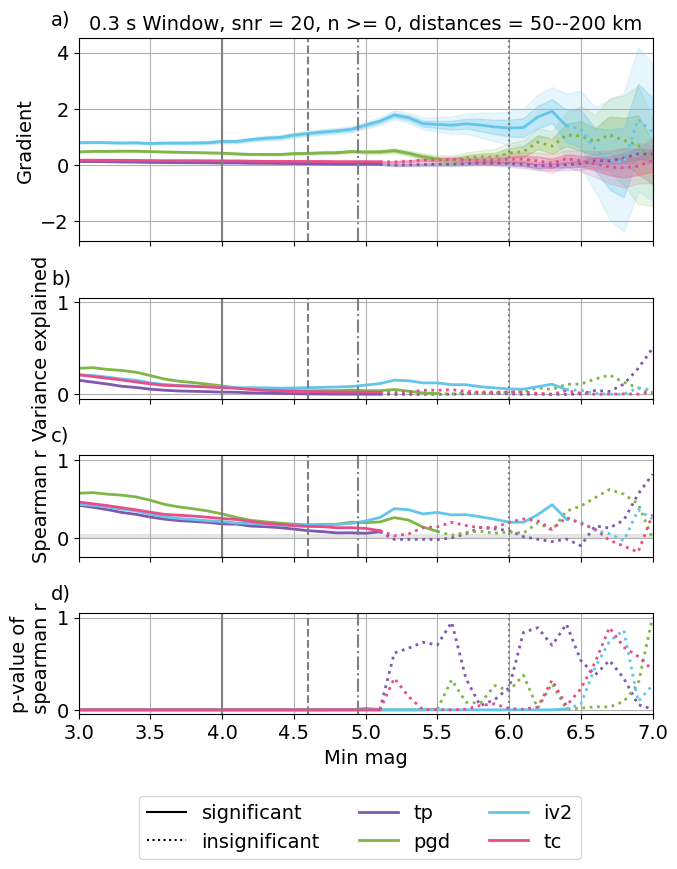

tp 0.4062879090262572
pgd 0.5774666881508789
tc 0.4232014445361078
iv2 0.45229635018573716
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


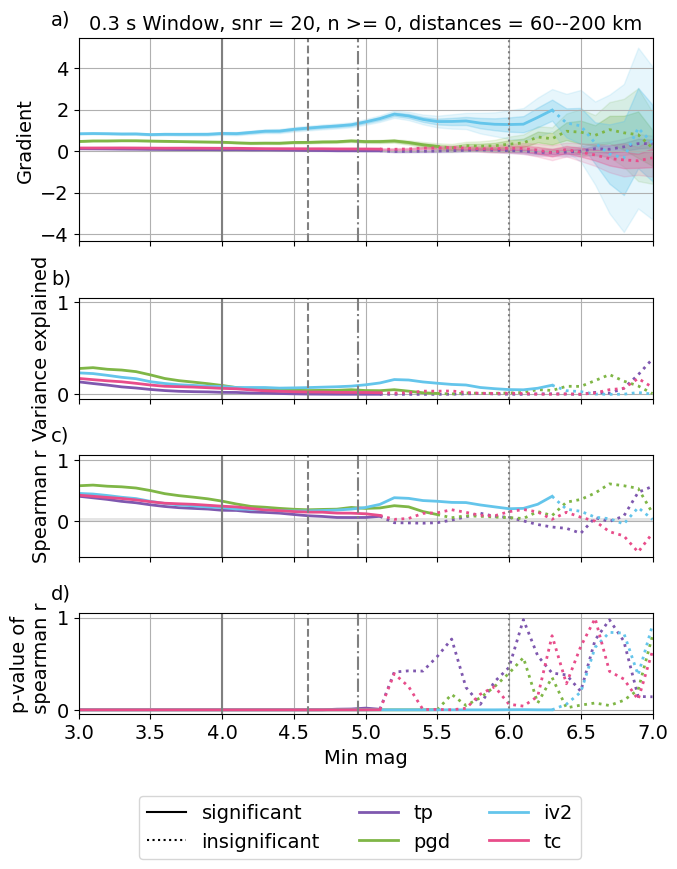

tp 0.3966241197012461
pgd 0.5870658818039405
tc 0.3787647189458437
iv2 0.4846135602781693
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


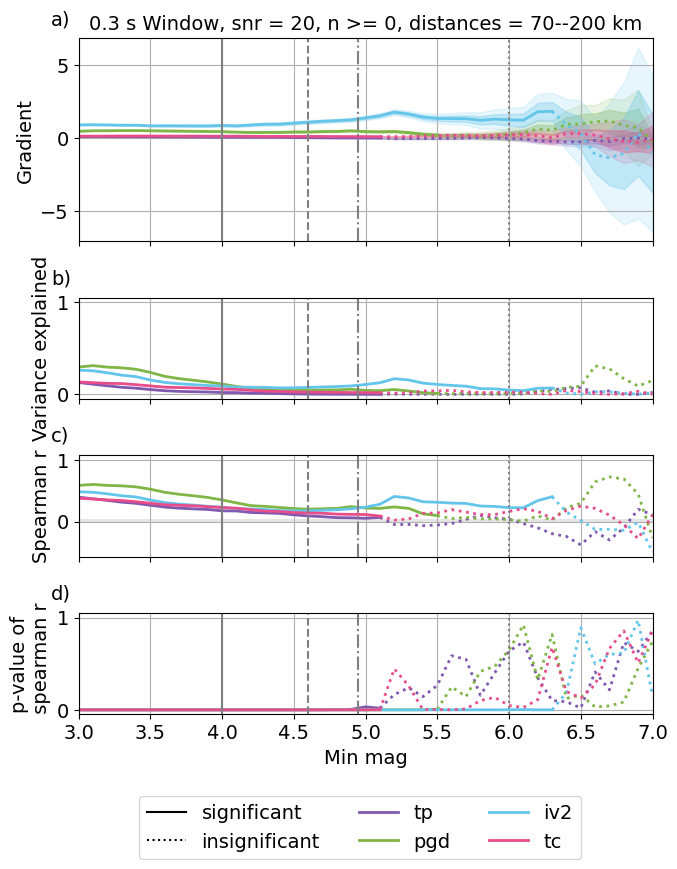

tp 0.38164912867236095
pgd 0.5855264448848957
tc 0.32218420941509096
iv2 0.5069781428944471
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


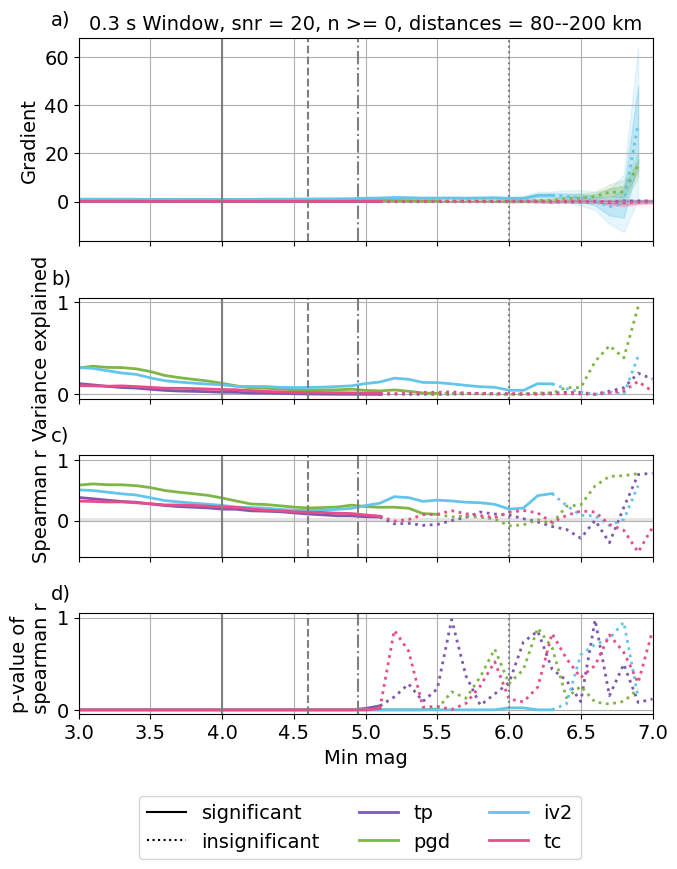

tp 0.36316966942995577
pgd 0.5793294971771363
tc 0.2633137115289228
iv2 0.5050015823607434
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


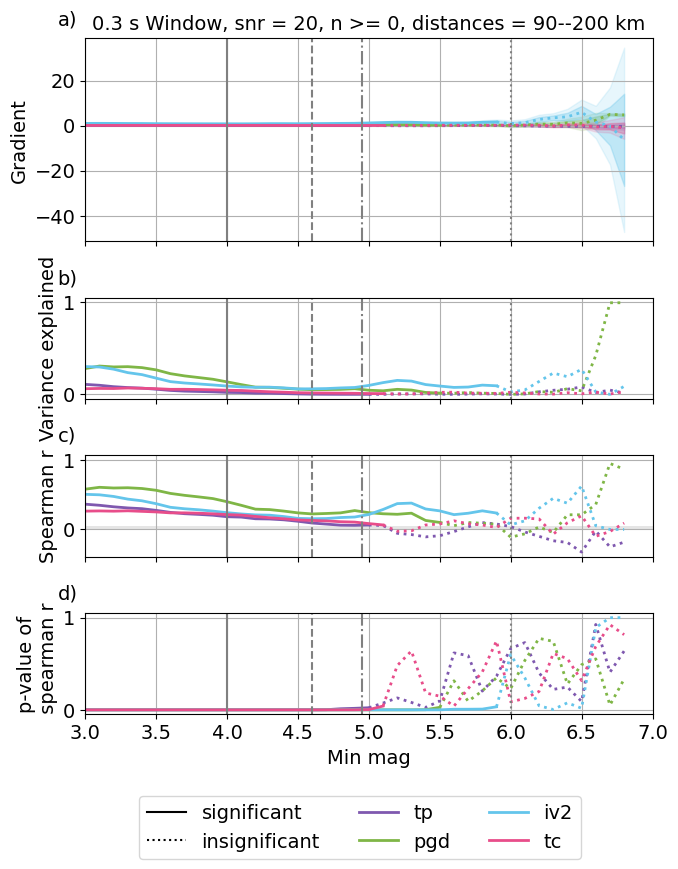

tp 0.4787708116760028
pgd 0.6089165968103959
tc 0.5572061023765785
iv2 0.44732639520425554
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


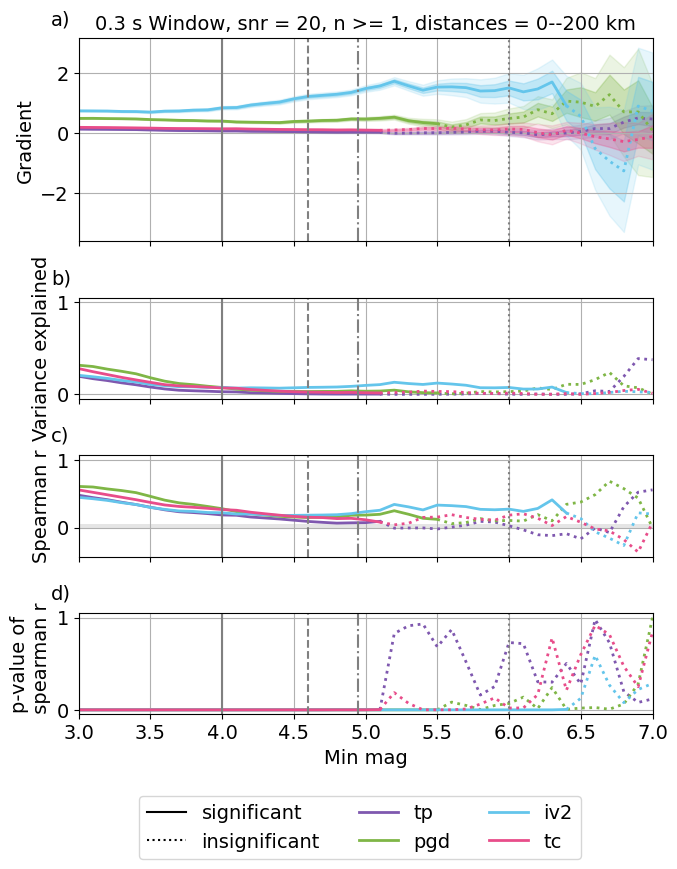

tp 0.47090884952291506
pgd 0.6015954116204764
tc 0.5471434272081742
iv2 0.4446846280107827
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


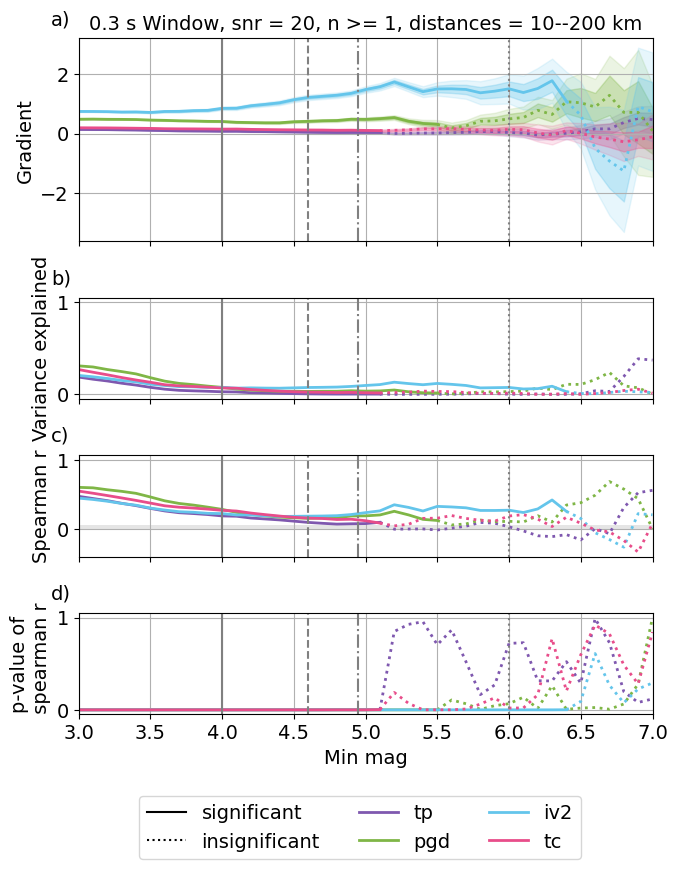

tp 0.4537511941607365
pgd 0.591319471998318
tc 0.5309970726686649
iv2 0.4409473375684877
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


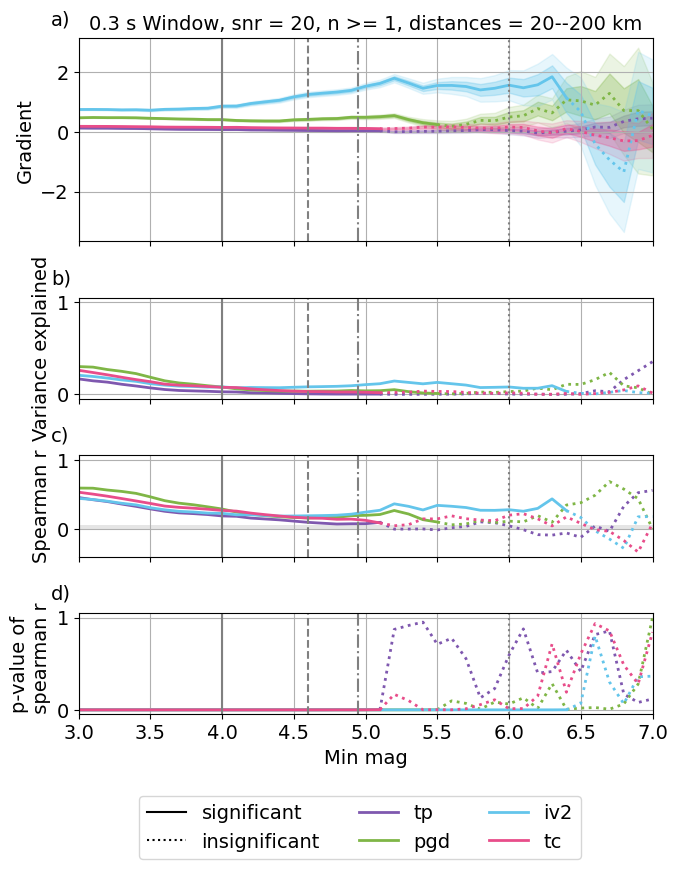

tp 0.44091748363953515
pgd 0.5783480527535996
tc 0.5058832841507201
iv2 0.4282272044621029
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


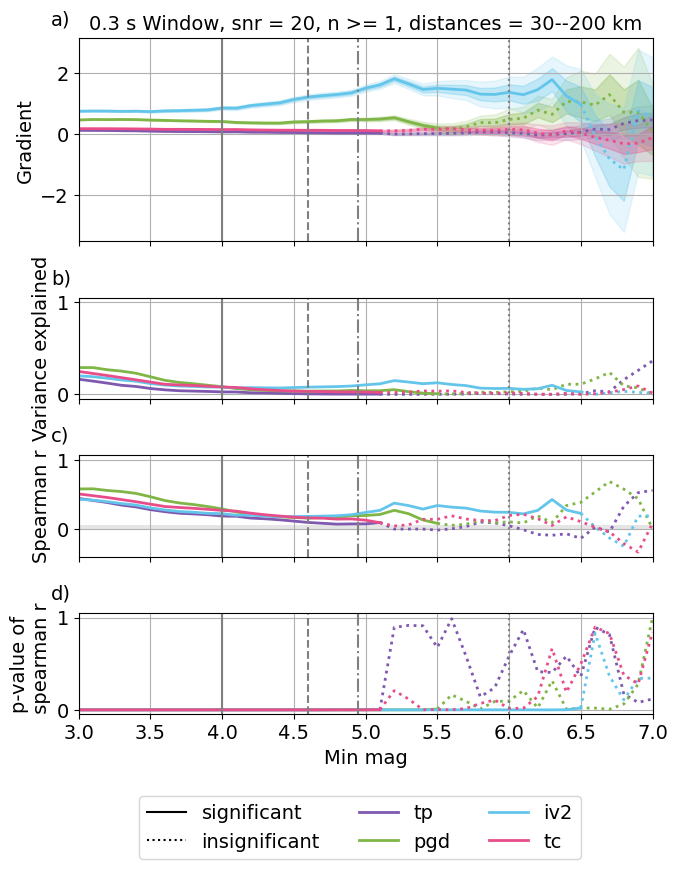

tp 0.43186269278180256
pgd 0.568657457388001
tc 0.4865925393194123
iv2 0.419616106570247
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


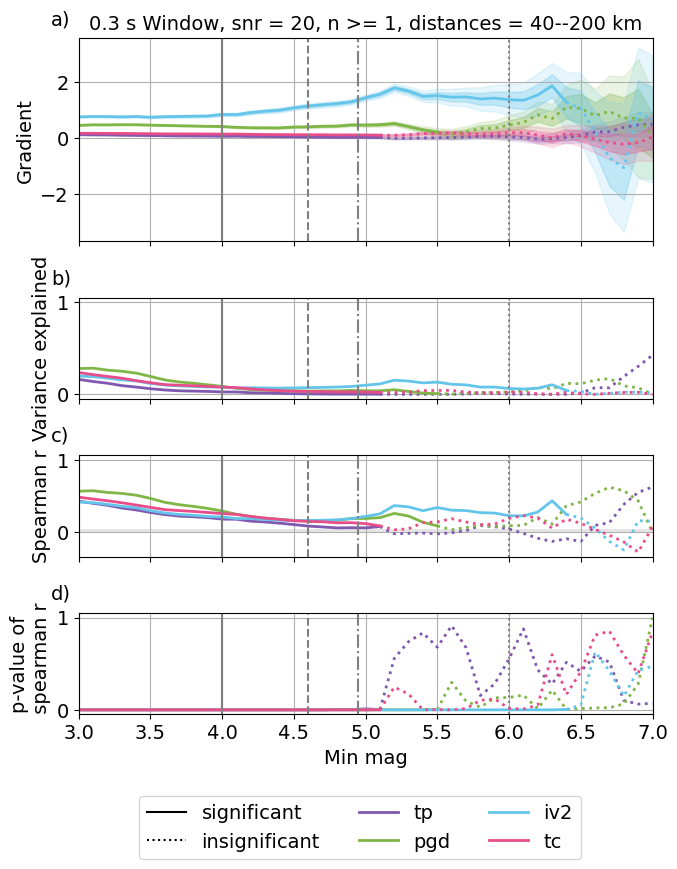

tp 0.42050859711707506
pgd 0.5744901948627723
tc 0.46245069750025
iv2 0.4310452631611048
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


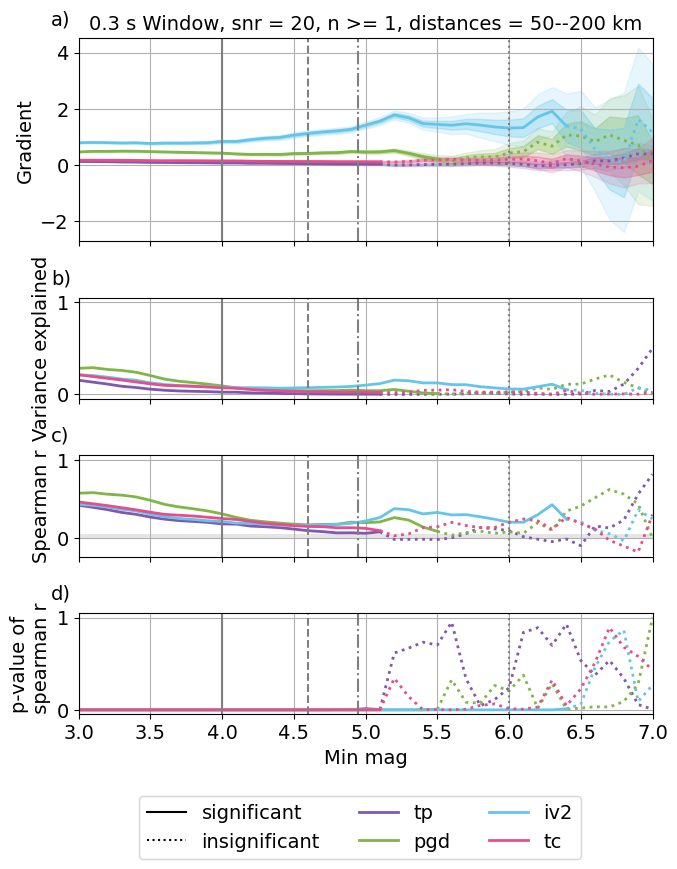

tp 0.4062879090262572
pgd 0.5774666881508789
tc 0.4232014445361078
iv2 0.45229635018573716
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


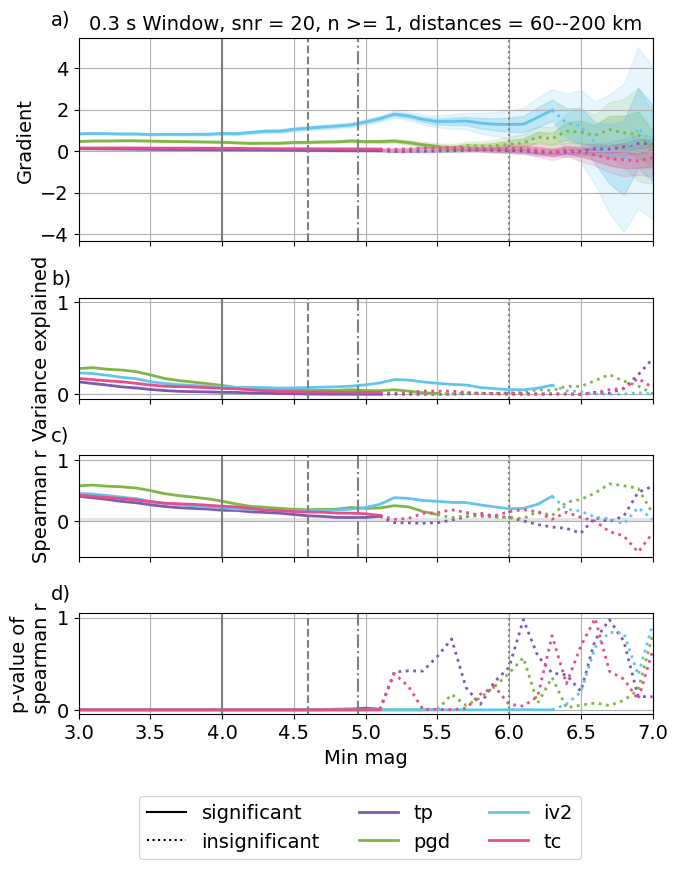

tp 0.3966241197012461
pgd 0.5870658818039405
tc 0.3787647189458437
iv2 0.4846135602781693
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


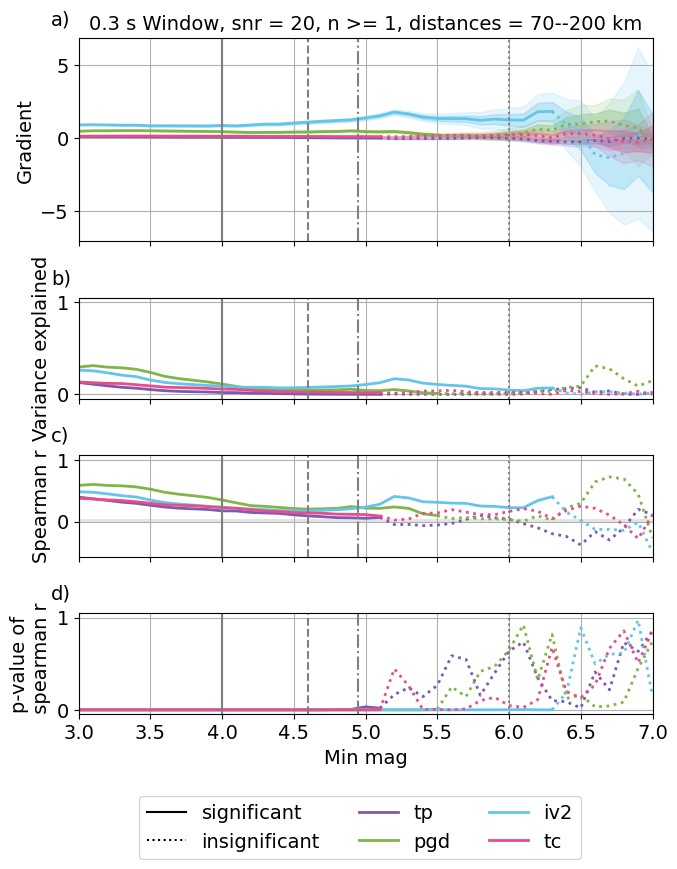

tp 0.38164912867236095
pgd 0.5855264448848957
tc 0.32218420941509096
iv2 0.5069781428944471
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


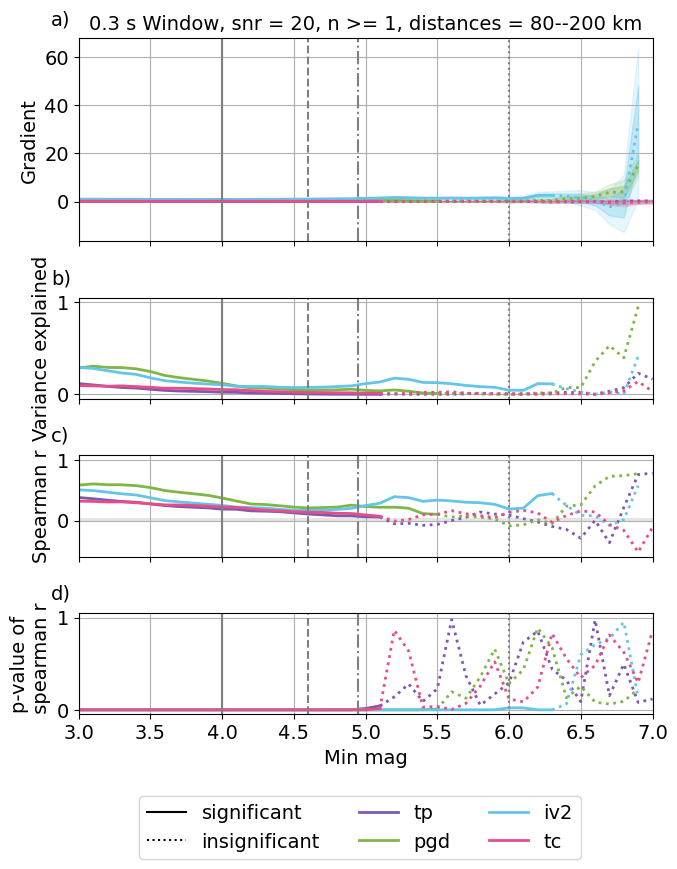

tp 0.36316966942995577
pgd 0.5793294971771363
tc 0.2633137115289228
iv2 0.5050015823607434
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


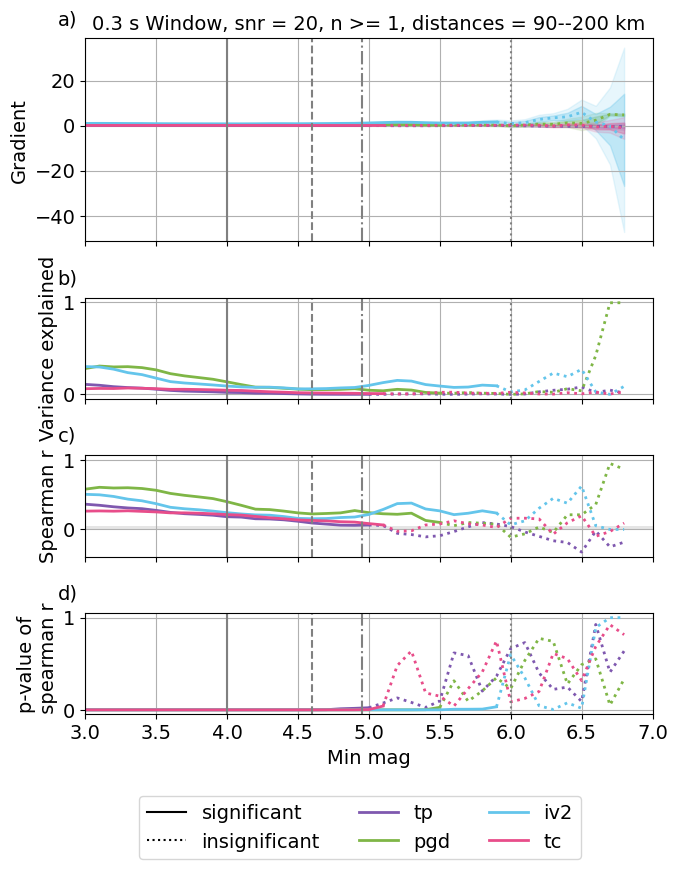

tp 0.5833836798454335
pgd 0.609833662744778
tc 0.6408455169150533
iv2 0.44720098005908876
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


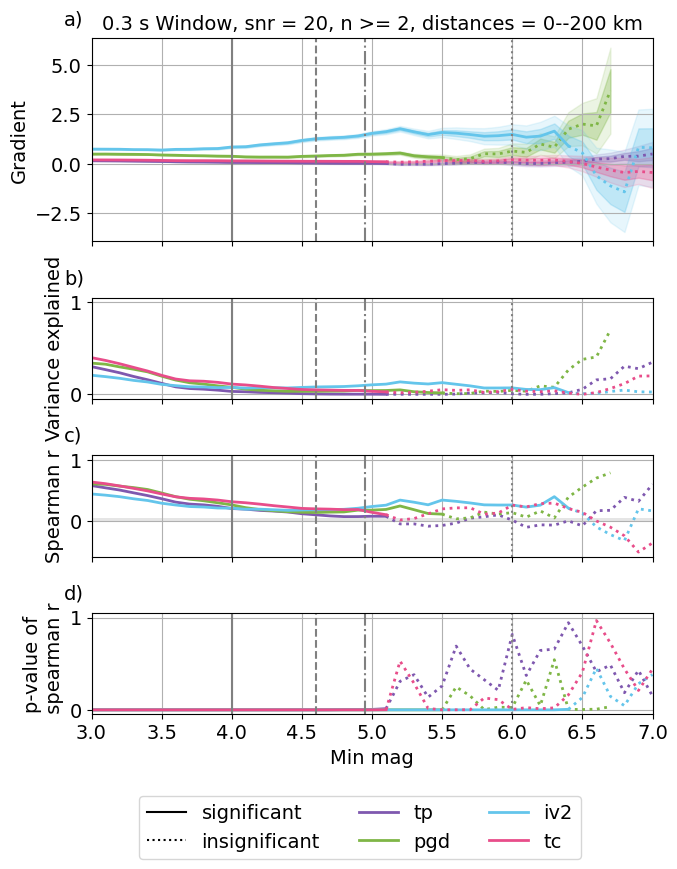

tp 0.5764505460318482
pgd 0.6024285585782024
tc 0.628851186124815
iv2 0.4445100631484766
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


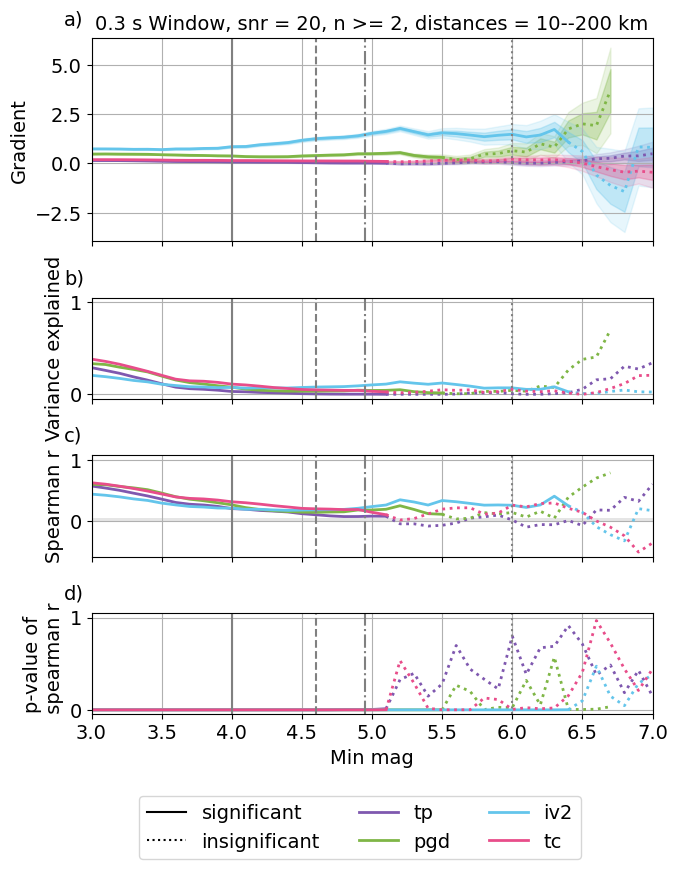

tp 0.55651046401465
pgd 0.5927475608412048
tc 0.6101213747501808
iv2 0.44159432890113187
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


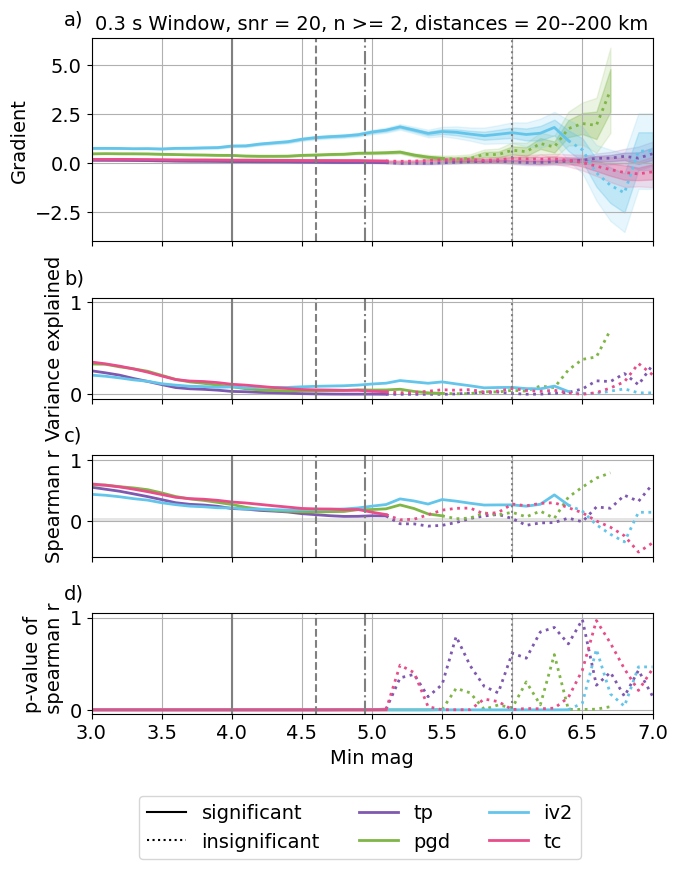

tp 0.5398245273625515
pgd 0.5813957735833387
tc 0.5786097185169289
iv2 0.4284296193309148
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


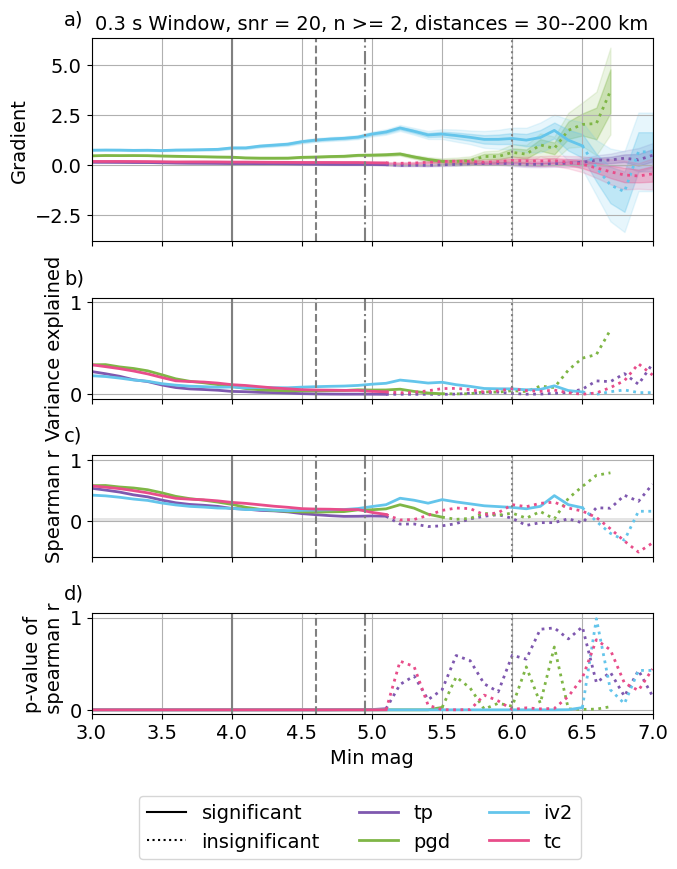

tp 0.5302956027778555
pgd 0.572572612230544
tc 0.5564705095448041
iv2 0.4204555524231751
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


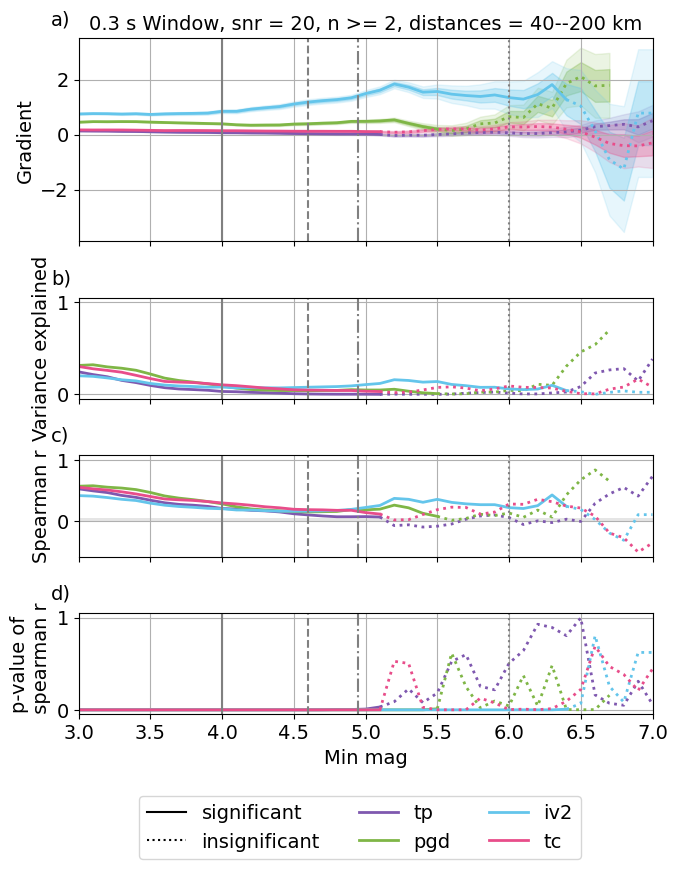

tp 0.5169934888136524
pgd 0.5796630347161178
tc 0.5267736623272625
iv2 0.4334039904990859
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


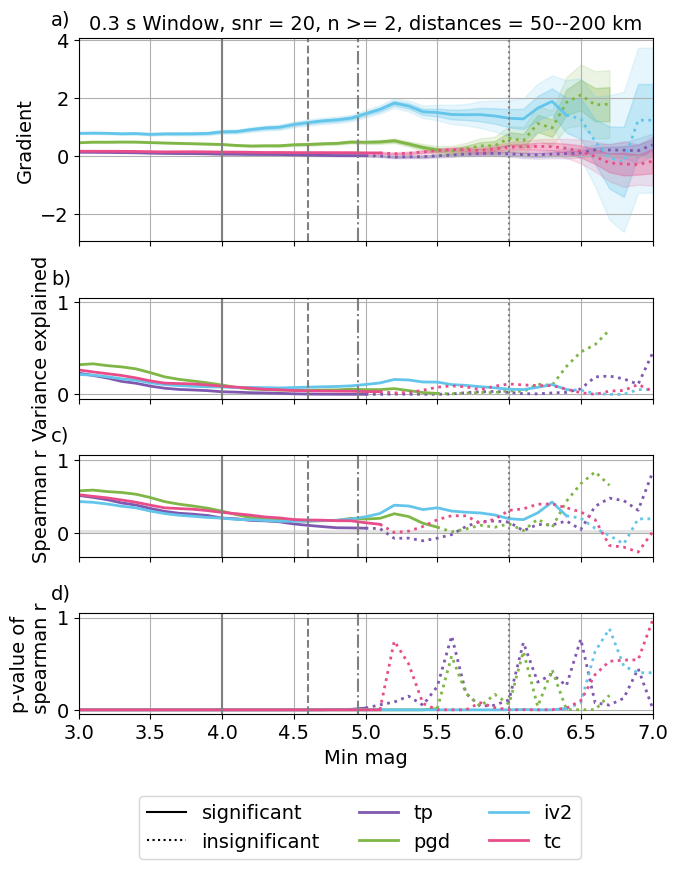

tp 0.5000631833744434
pgd 0.5826986990241153
tc 0.47884184129072055
iv2 0.4557943758233896
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


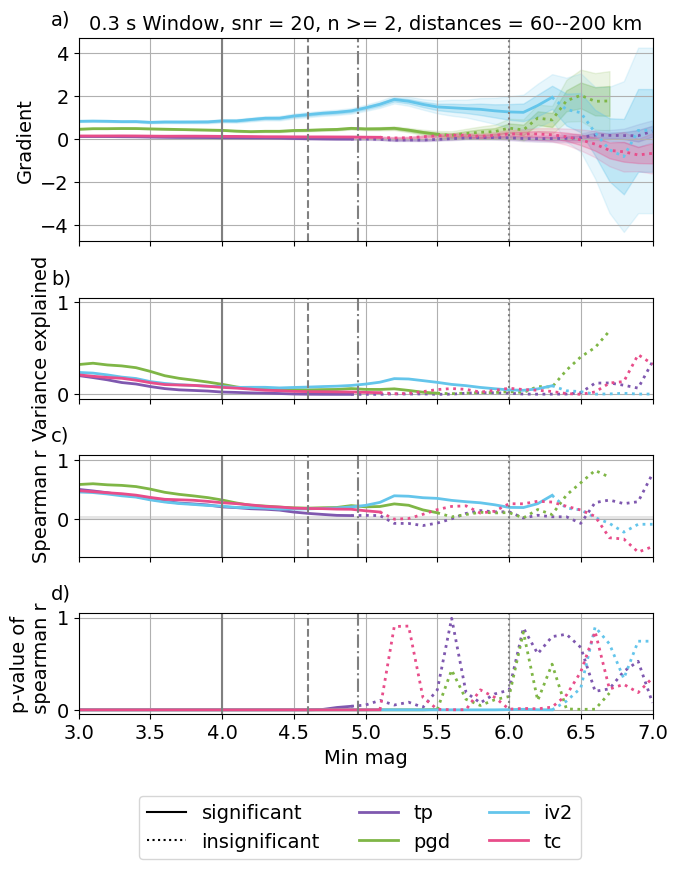

tp 0.48391534616141874
pgd 0.5916813754718274
tc 0.4225029263526719
iv2 0.4905582162090476
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


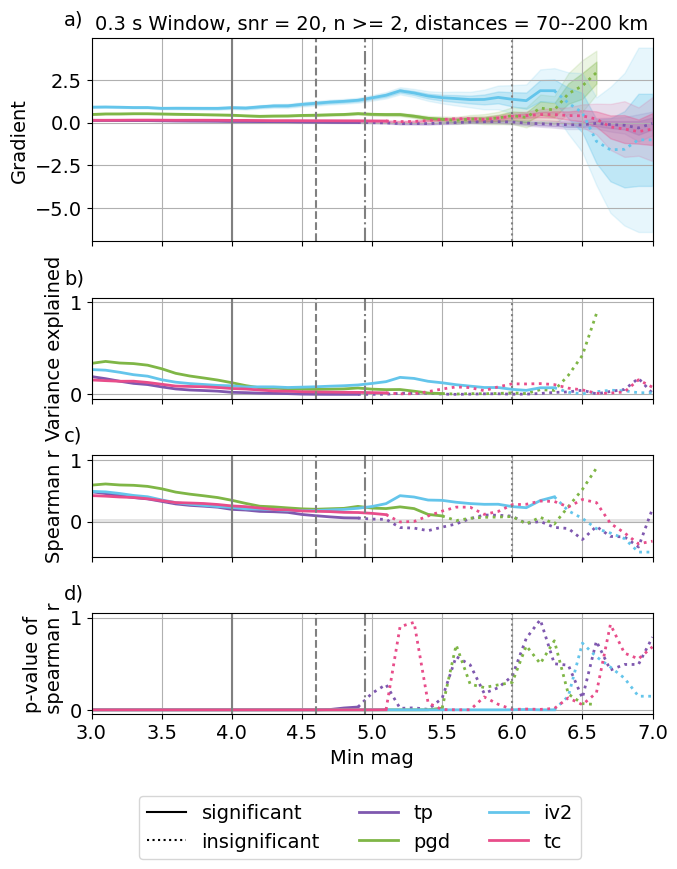

tp 0.4572850263186828
pgd 0.5911670519777277
tc 0.3466831171597062
iv2 0.5196951878782788
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


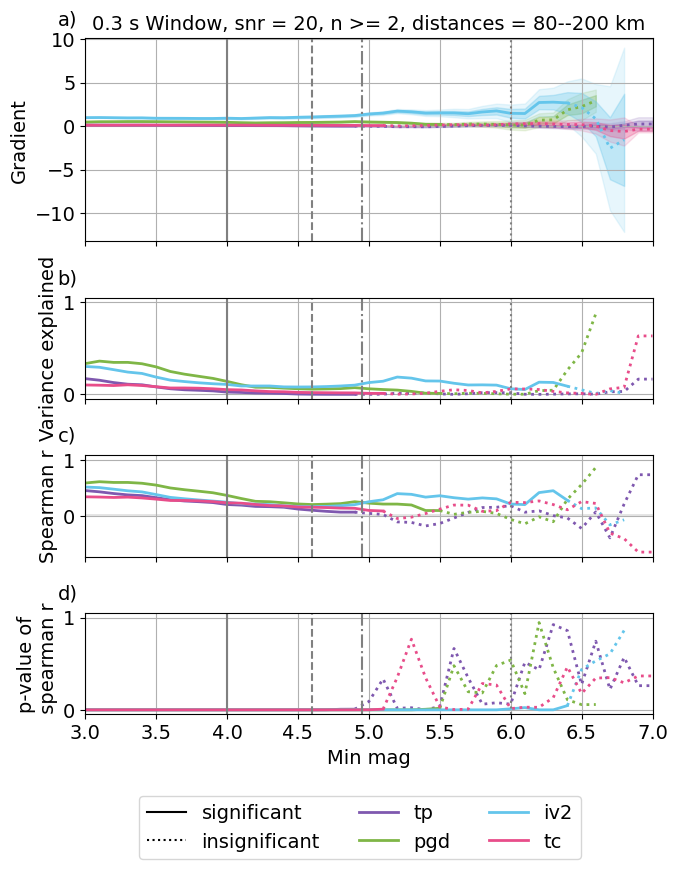

tp 0.4308652253694015
pgd 0.5812104625552563
tc 0.2702564205284227
iv2 0.5258157951567004
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


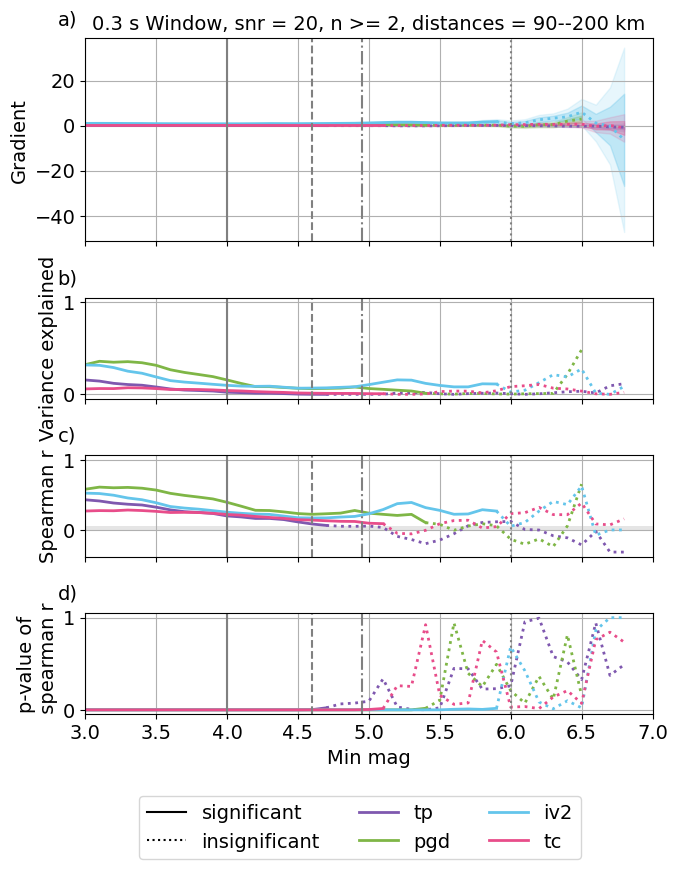

tp 0.6312453509448782
pgd 0.6066635892141742
tc 0.6745077832650485
iv2 0.4423410564315505
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


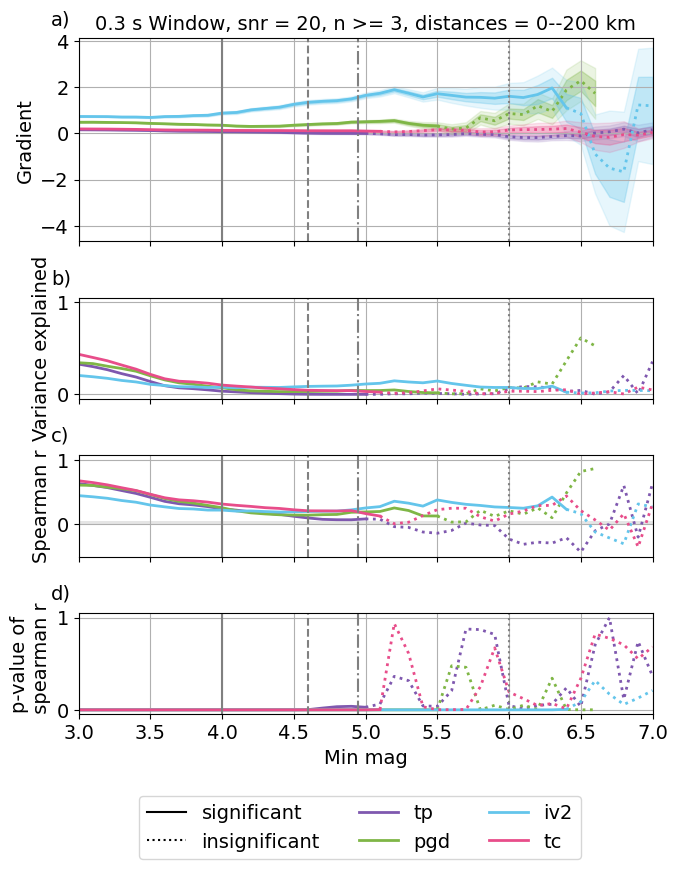

tp 0.6294033252790453
pgd 0.6000321358475605
tc 0.6600197798633983
iv2 0.43961854242678683
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


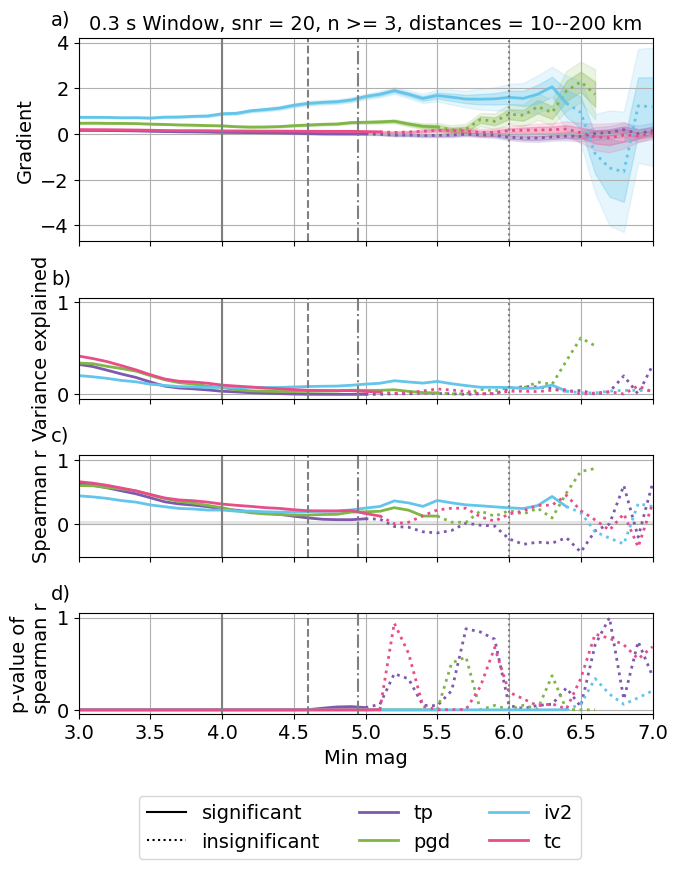

tp 0.6130277357494809
pgd 0.5917597276543781
tc 0.6402406274461819
iv2 0.4385178222488471
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


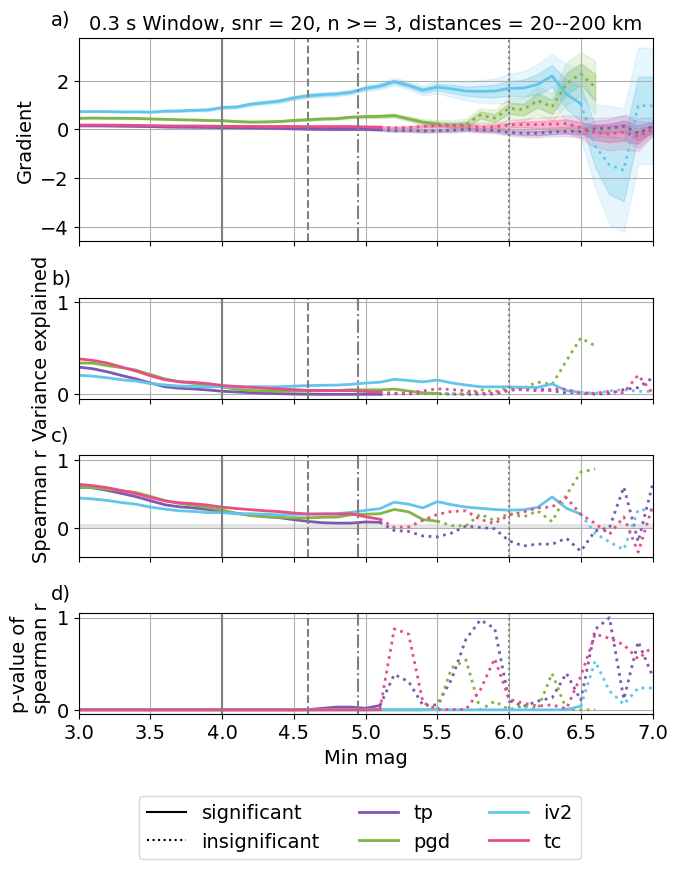

tp 0.5968752019020034
pgd 0.581335555345236
tc 0.6066686713433627
iv2 0.42617853742903306
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


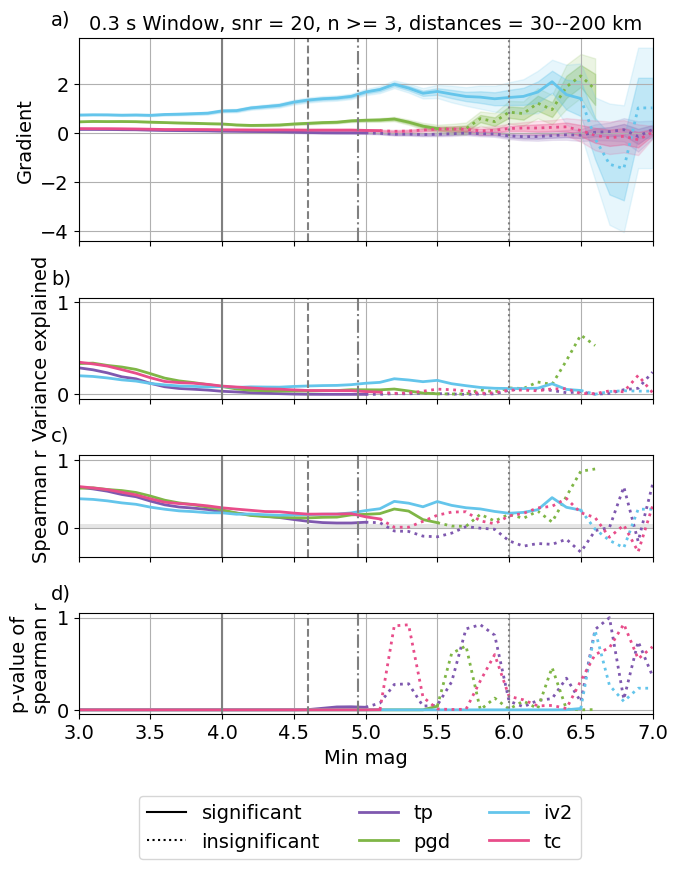

tp 0.586042276115452
pgd 0.5740884392313096
tc 0.581989040394223
iv2 0.4201507515169582
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


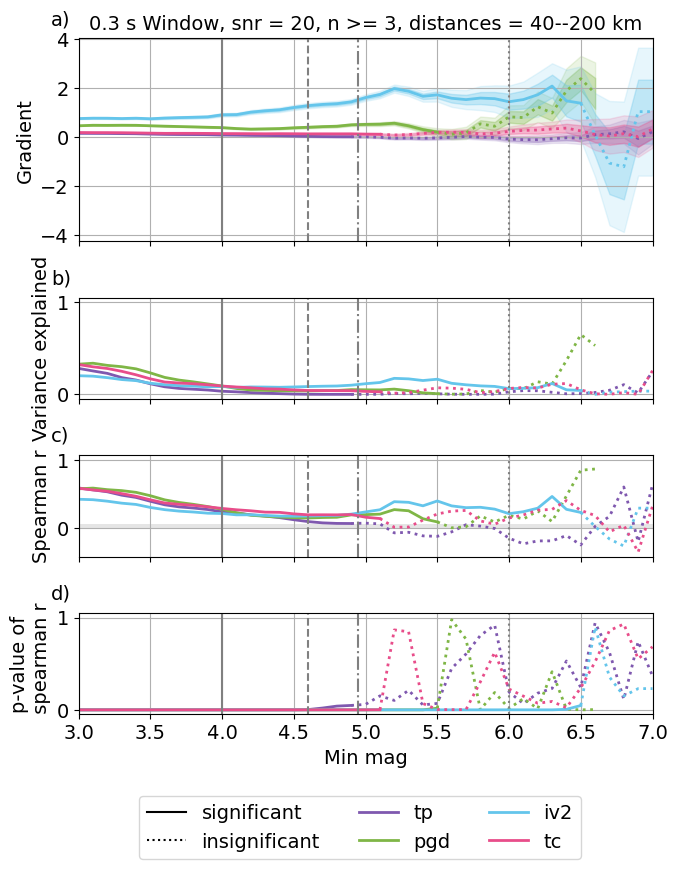

tp 0.5764901248308649
pgd 0.5813699664997308
tc 0.5491618617356646
iv2 0.43410504145221906
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


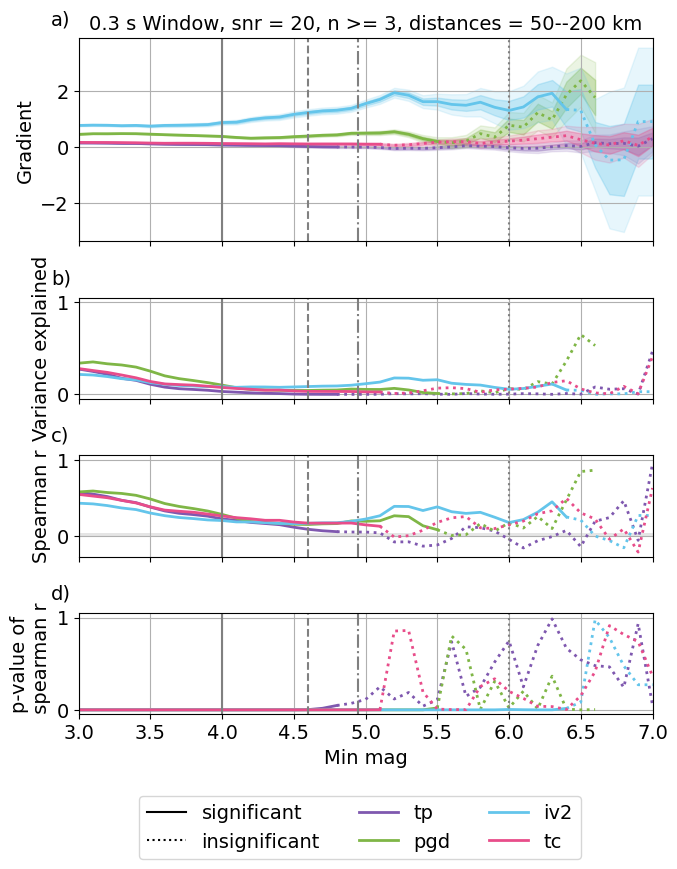

tp 0.5605610022613349
pgd 0.5847875799122799
tc 0.49524199667206237
iv2 0.4592348406390435
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


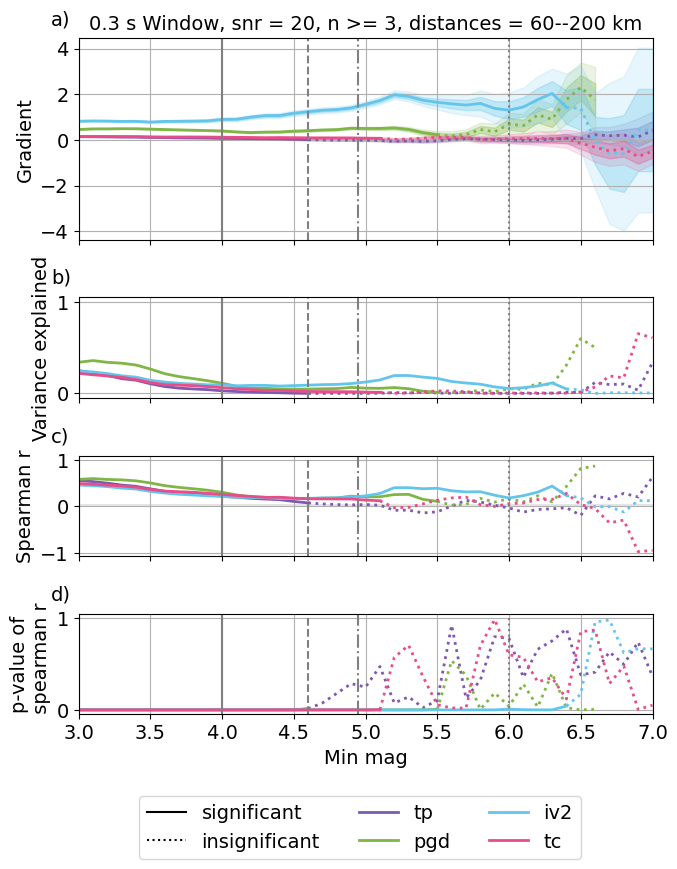

tp 0.553052633900437
pgd 0.5926618266430642
tc 0.43734489990210595
iv2 0.49525542216291407
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


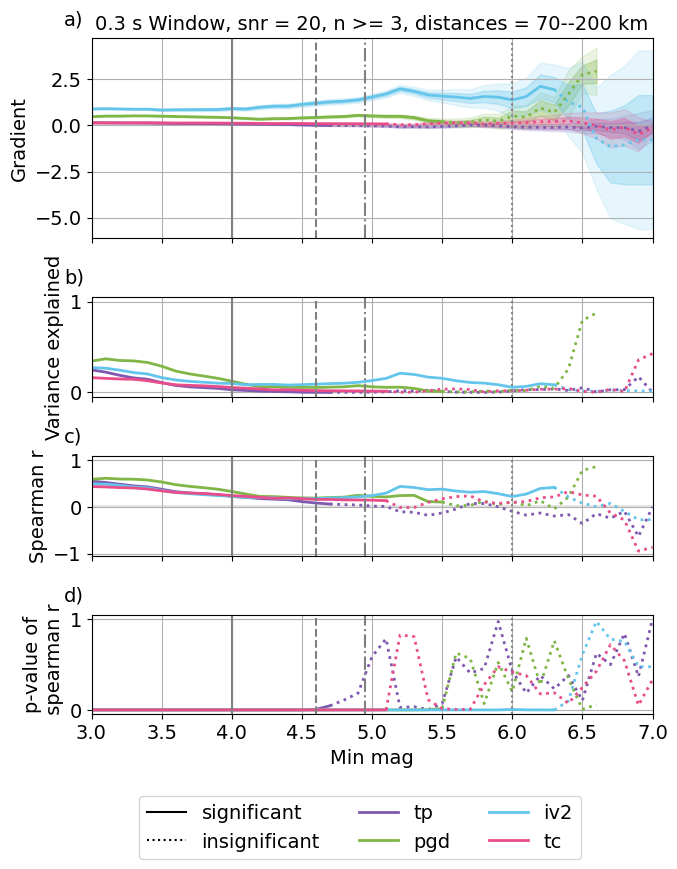

tp 0.514698195807385
pgd 0.5918689469700742
tc 0.34626082774407313
iv2 0.5281399500540663
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


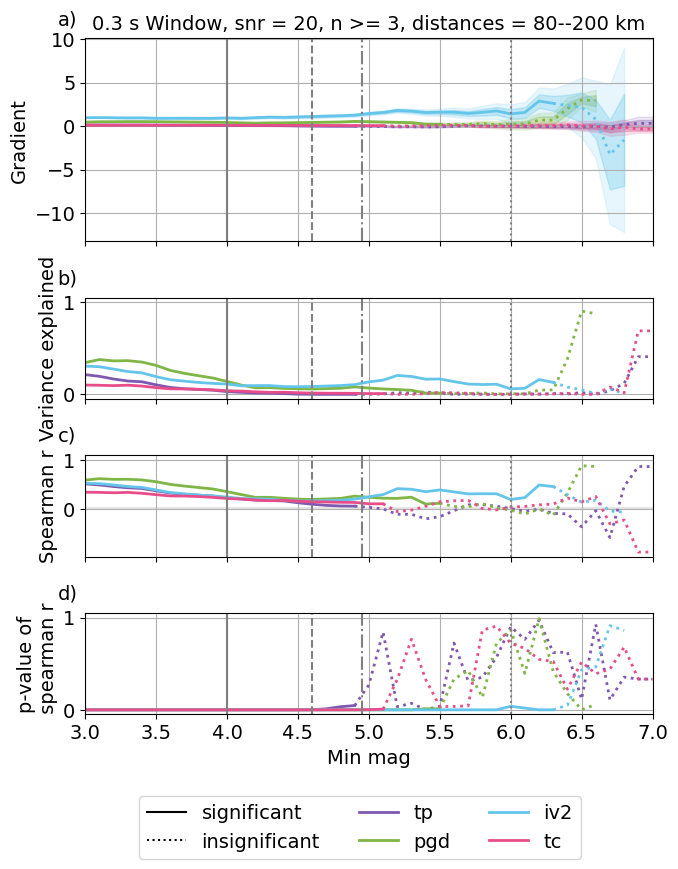

tp 0.4853206658126945
pgd 0.5771094494629057
tc 0.25299847674298903
iv2 0.531721268166309
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


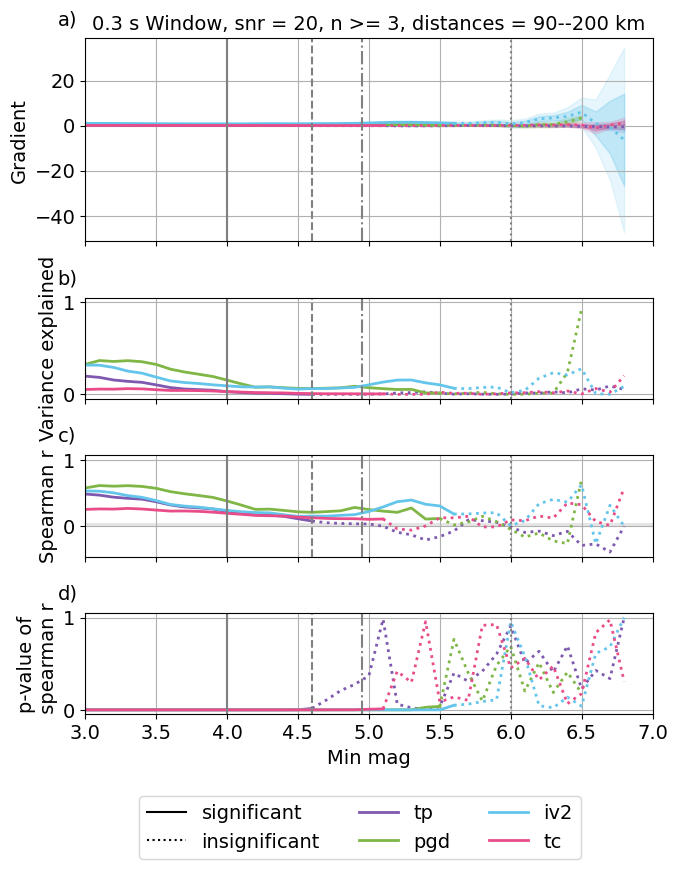

tp 0.6824217011802971
pgd 0.6013318285134083
tc 0.7132585470961837
iv2 0.4349758146257554
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


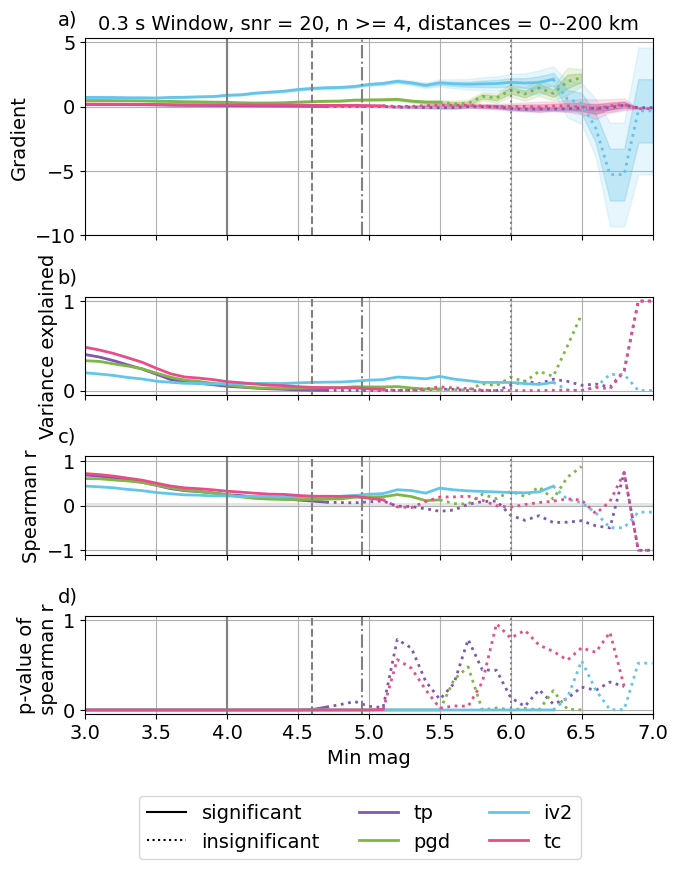

tp 0.678754015139375
pgd 0.5950763667063226
tc 0.6986204661846799
iv2 0.4320813963327231
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


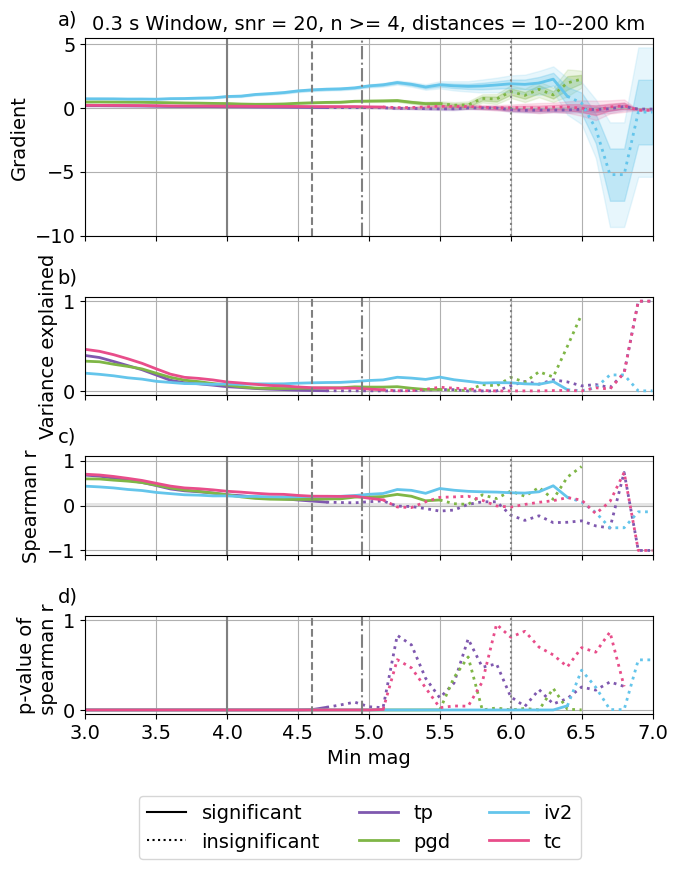

tp 0.6632627665290969
pgd 0.5874139615134824
tc 0.6771072620798334
iv2 0.4316270018151432
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


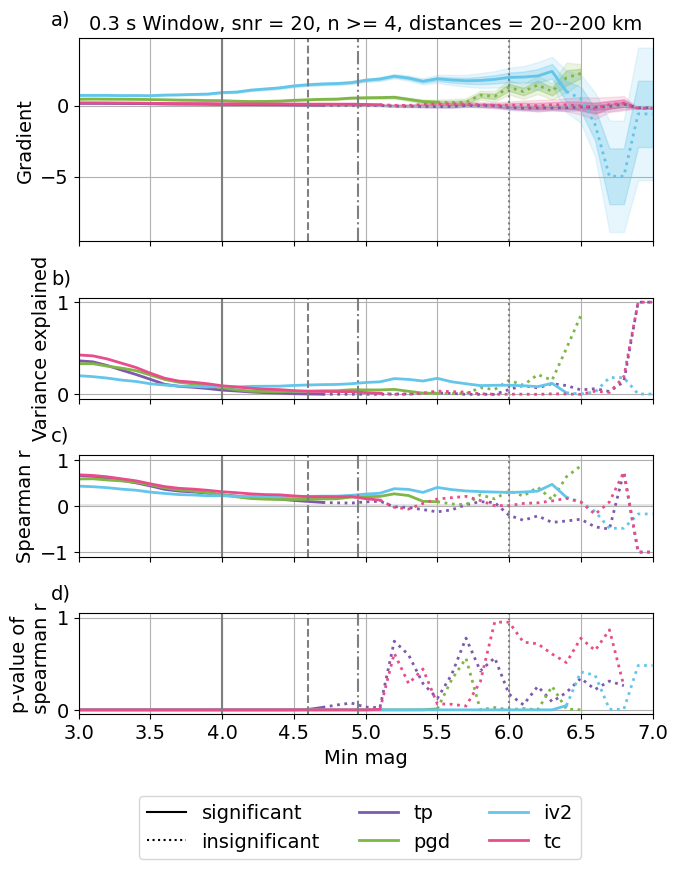

tp 0.647274019234155
pgd 0.5778556991769012
tc 0.6429382314572679
iv2 0.41963774346151383
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


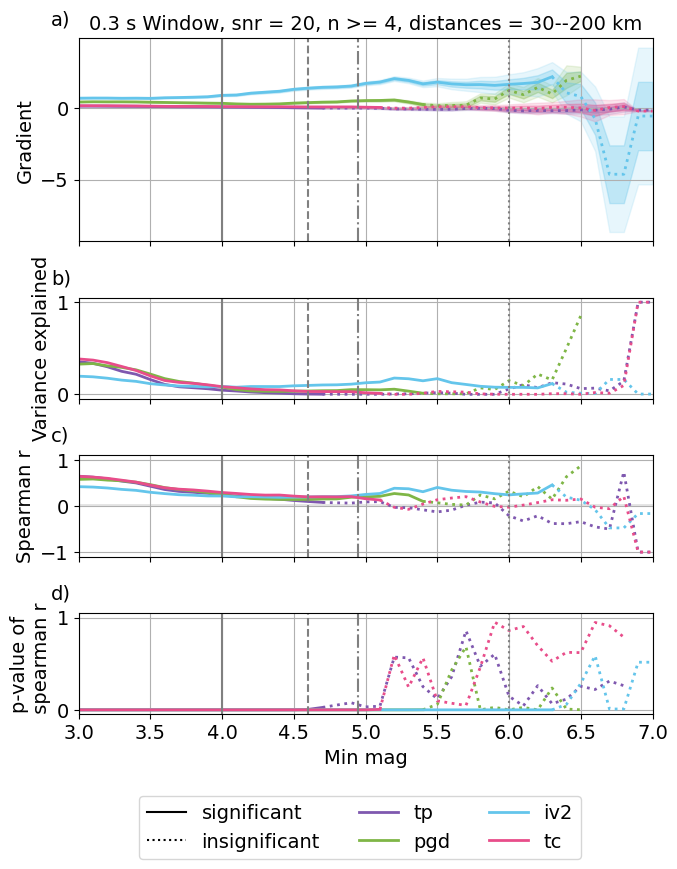

tp 0.6342149168204583
pgd 0.5715177567623386
tc 0.6171345463569988
iv2 0.41494970705159334
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


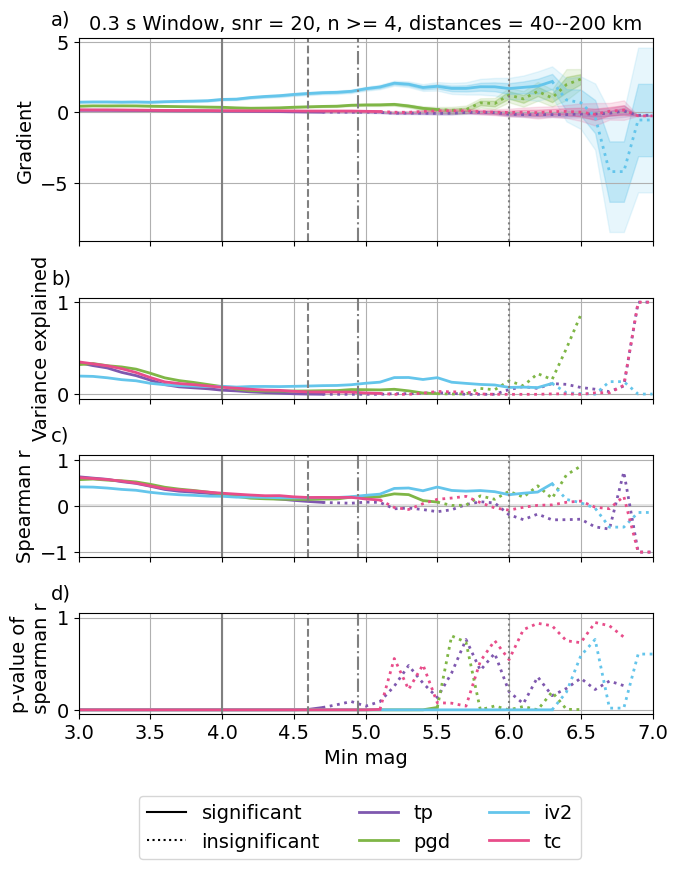

tp 0.6204442119022967
pgd 0.5800909995408206
tc 0.5856023951020037
iv2 0.4307081200250849
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


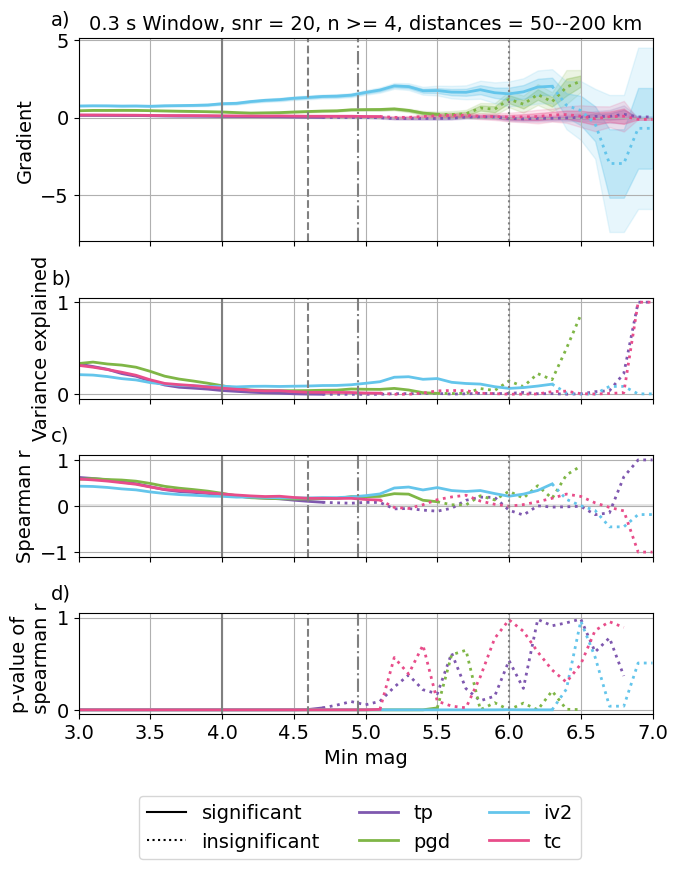

tp 0.5994715559950666
pgd 0.5821599615570864
tc 0.5219054420647048
iv2 0.4573895049161443
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


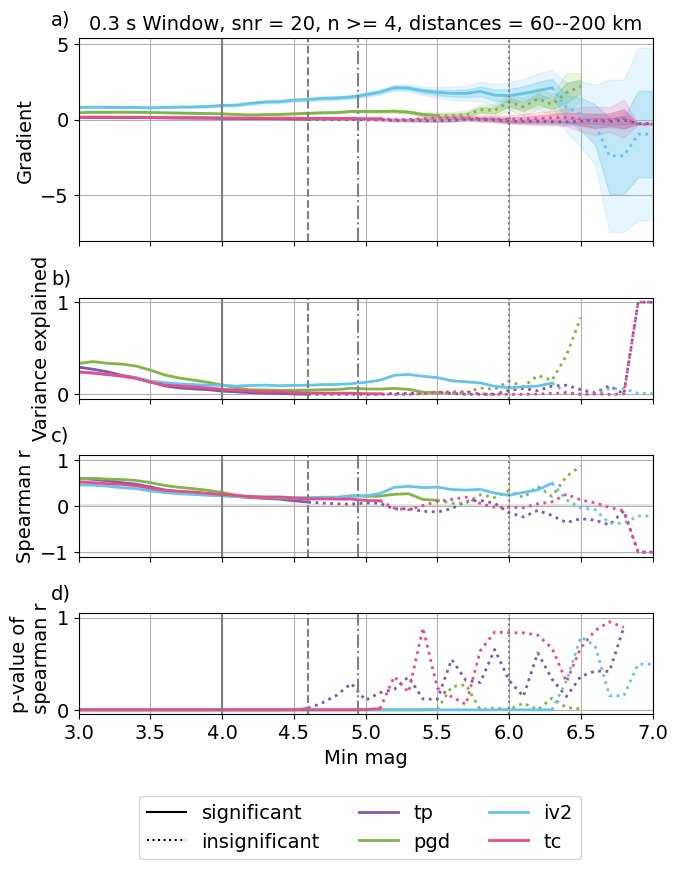

tp 0.5872374651327804
pgd 0.5893887412359582
tc 0.4534563498621993
iv2 0.4979425204784265
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


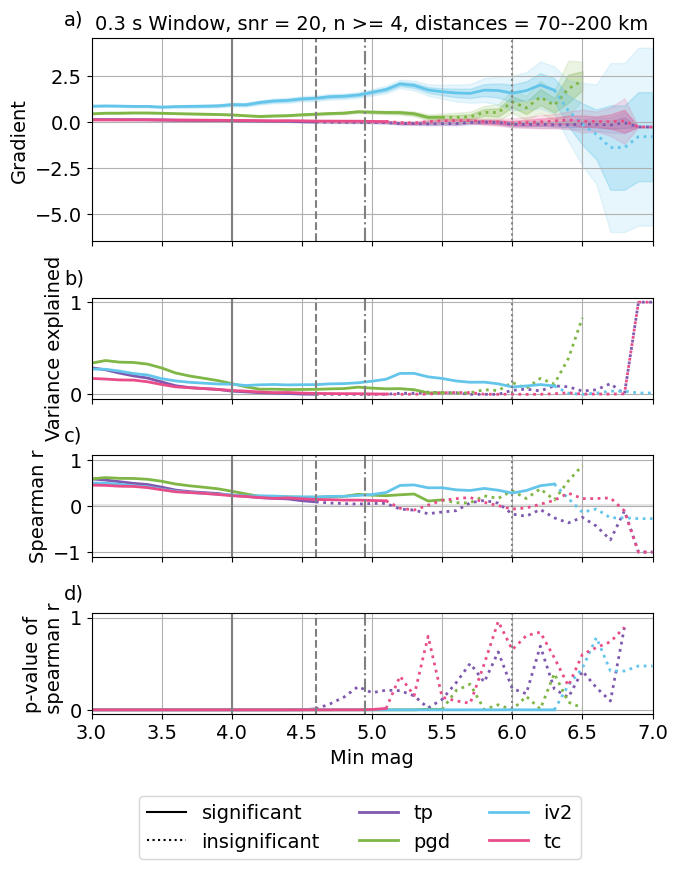

tp 0.5520676847524079
pgd 0.5867566262564179
tc 0.3541182181832689
iv2 0.5375806393980056
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


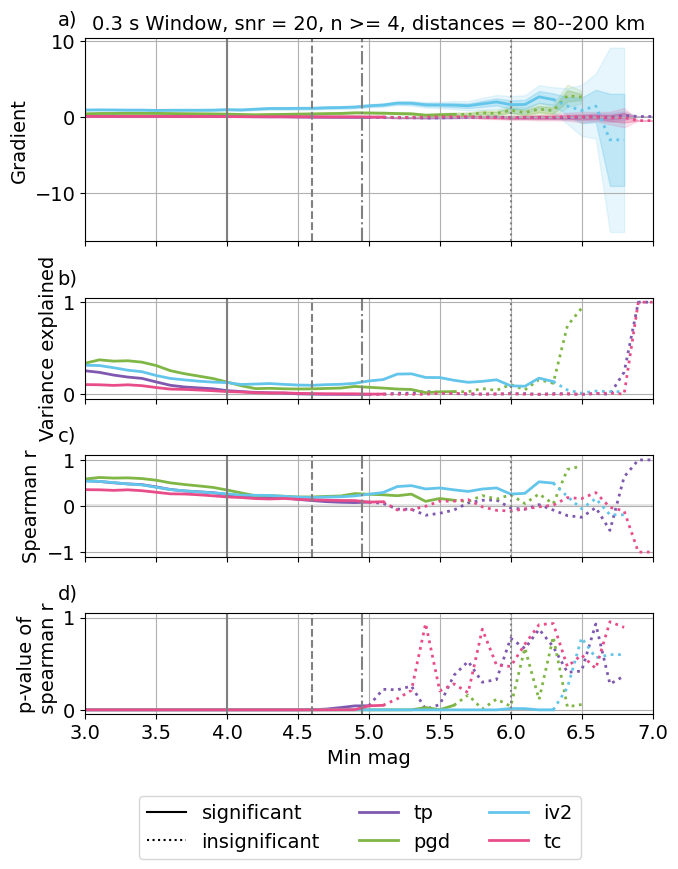

tp 0.517804945778101
pgd 0.5679612276536217
tc 0.2572578681133007
iv2 0.538926898374247
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


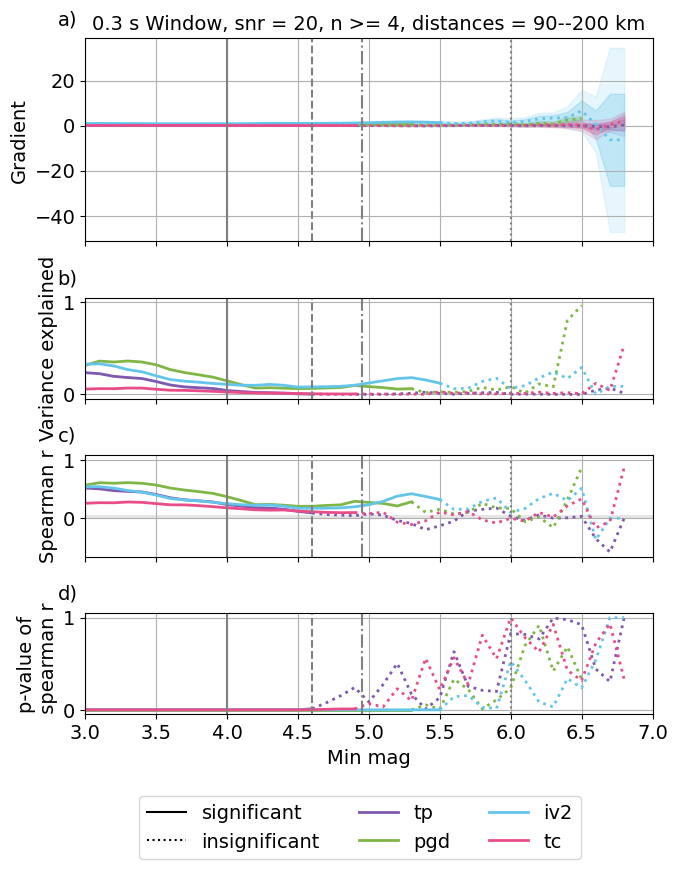

tp 0.7085792031300279
pgd 0.5988549272083004
tc 0.7388812871421753
iv2 0.4329540432680593
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


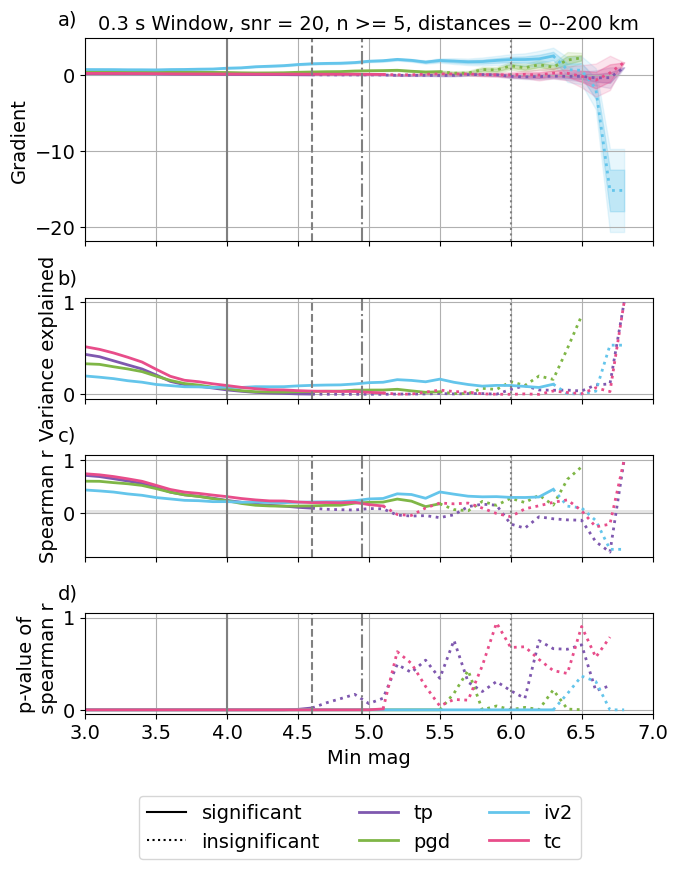

tp 0.7069836355787418
pgd 0.5934081012418666
tc 0.7293205384873375
iv2 0.43013816453181947
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


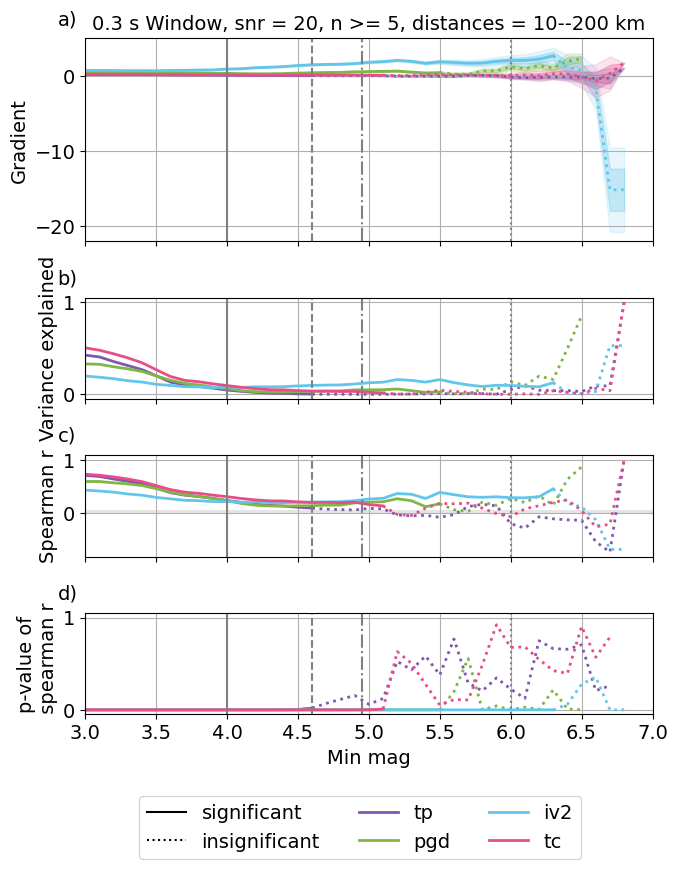

tp 0.6886451274856391
pgd 0.5870352164579598
tc 0.7085912859373281
iv2 0.43062590543019896
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


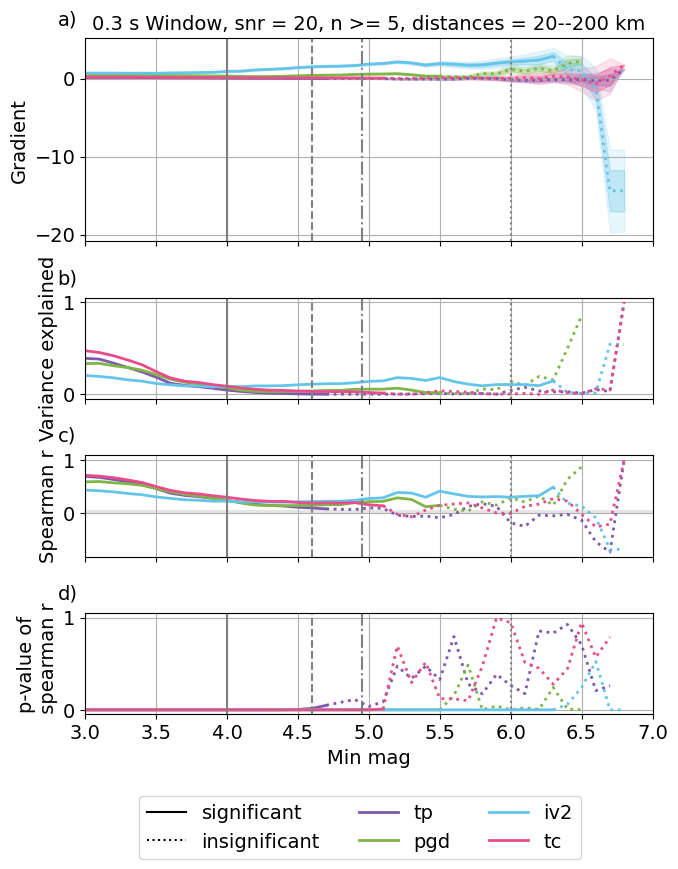

tp 0.6770936677777559
pgd 0.5794724209631974
tc 0.6787210502200264
iv2 0.4196166727093648
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


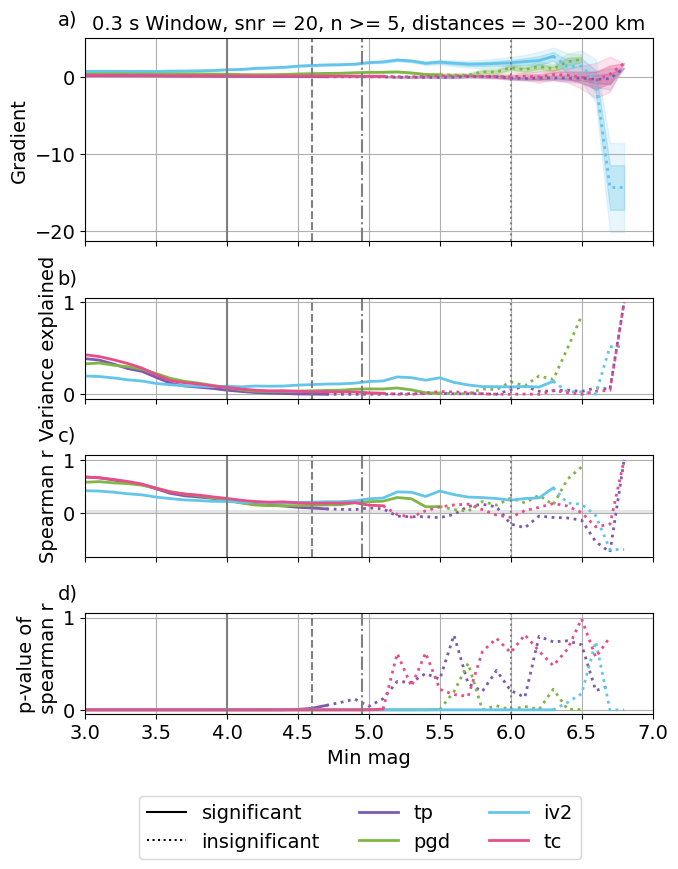

tp 0.6634332974914069
pgd 0.5751348898666279
tc 0.6468522578448042
iv2 0.4157422038516936
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


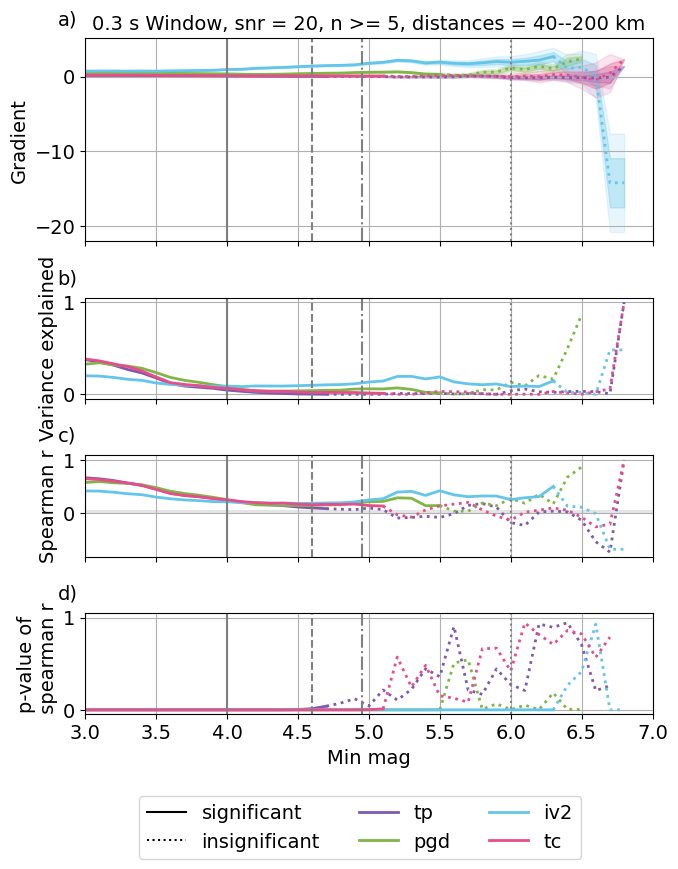

tp 0.6512011682321188
pgd 0.5848745521627388
tc 0.6196011637557003
iv2 0.43239497220617634
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


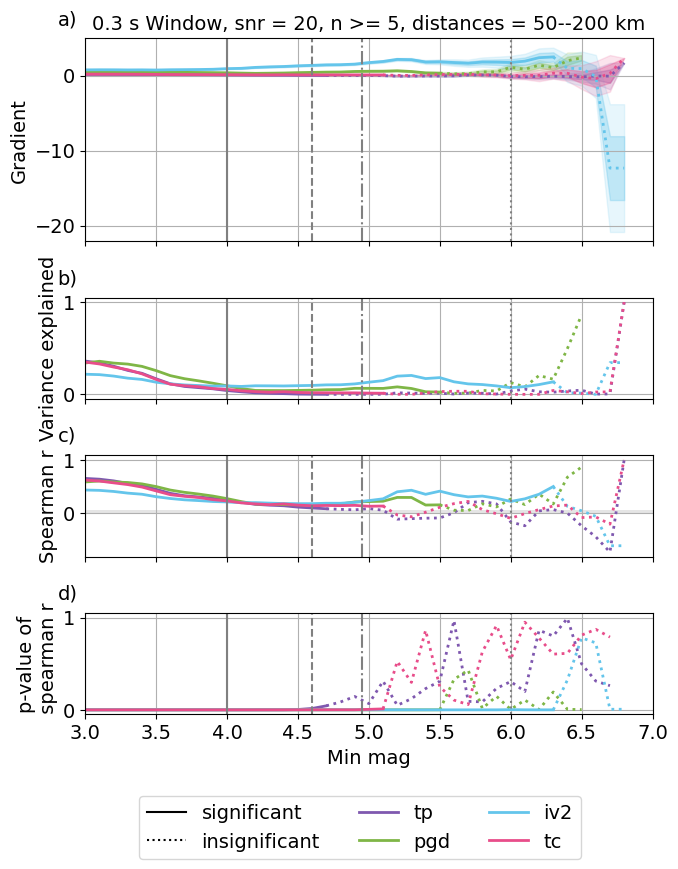

tp 0.628734500815904
pgd 0.5874965271789833
tc 0.5548168757643543
iv2 0.4577859652169467
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


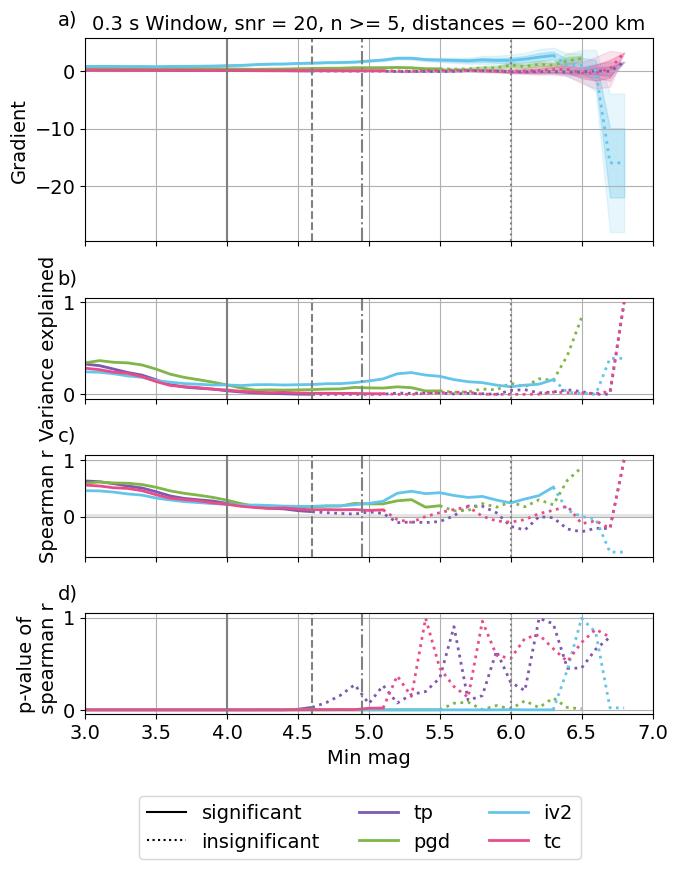

tp 0.6119409431800292
pgd 0.5927989827571155
tc 0.48349865676797094
iv2 0.5007047840759045
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


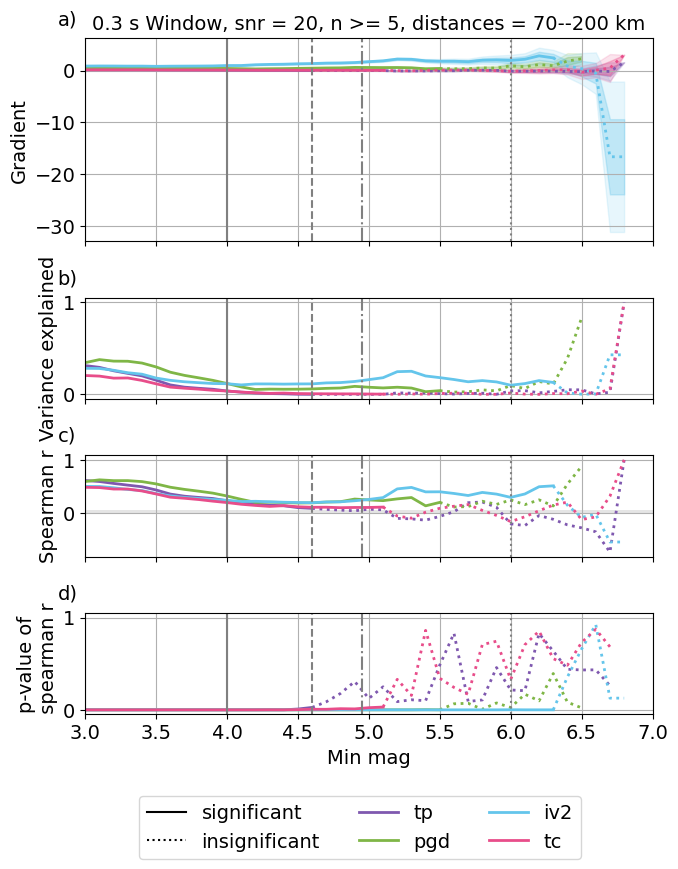

tp 0.5714680277918653
pgd 0.5921408840423417
tc 0.37066673921725163
iv2 0.5487820506199463
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


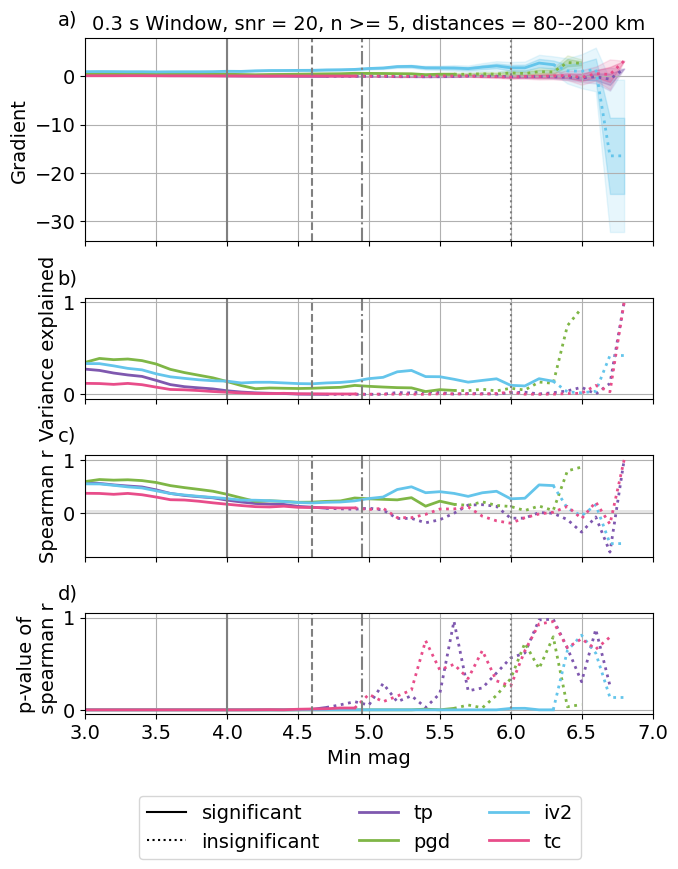

tp 0.5420448509136226
pgd 0.5725582574329569
tc 0.26504443414481493
iv2 0.5564569980431502
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


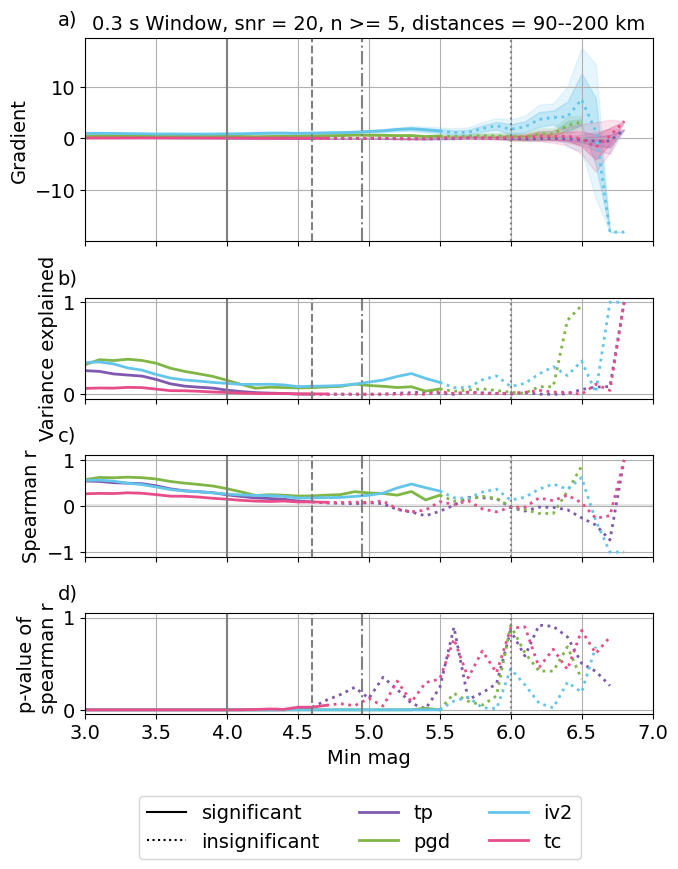

tp 0.7317940358750562
pgd 0.5936173459584555
tc 0.7554947202463272
iv2 0.427607911706213
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


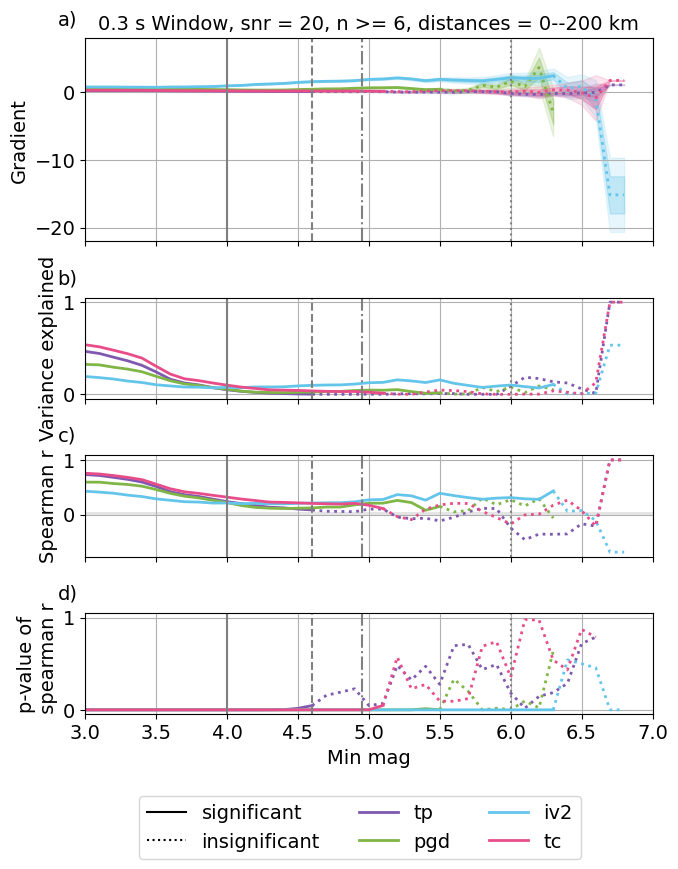

tp 0.7303562655177858
pgd 0.5877728750953792
tc 0.7452096609715474
iv2 0.4253069331276153
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


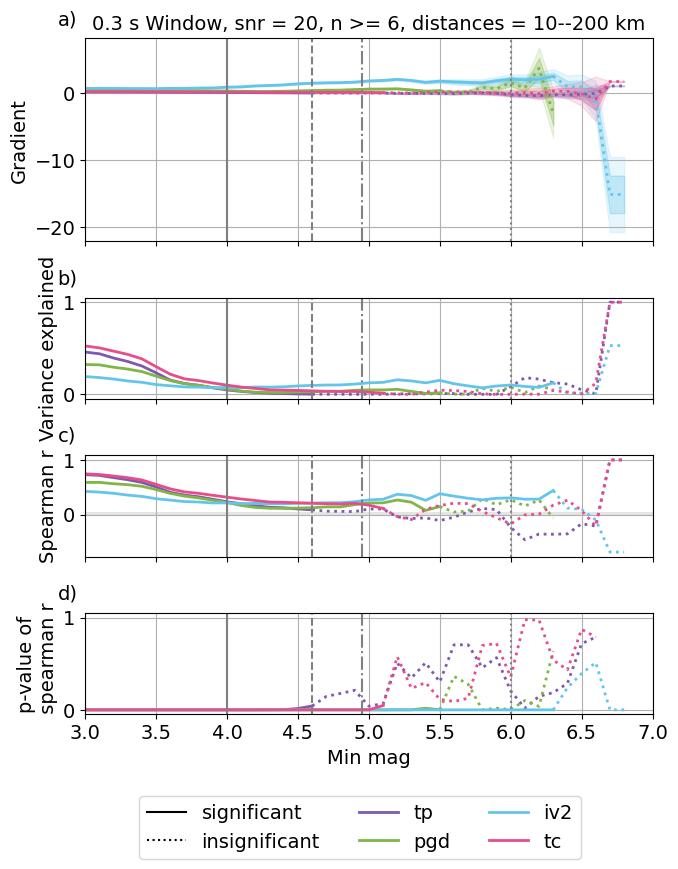

tp 0.7100204266382956
pgd 0.5816958962721672
tc 0.7297172684552905
iv2 0.4254215307372914
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


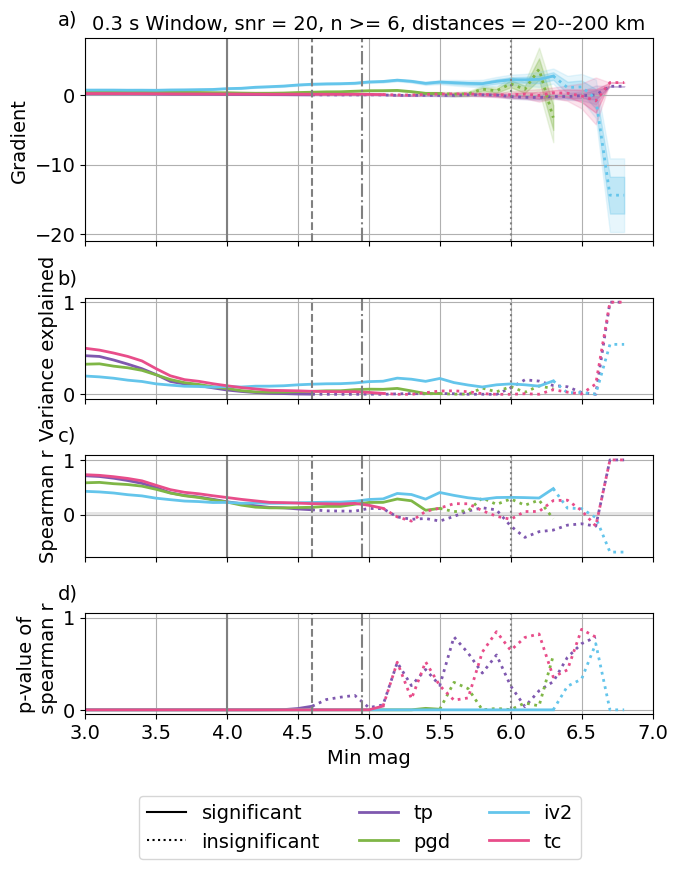

tp 0.7063964797831821
pgd 0.5755799166232733
tc 0.7105565481781113
iv2 0.41510467906007376
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


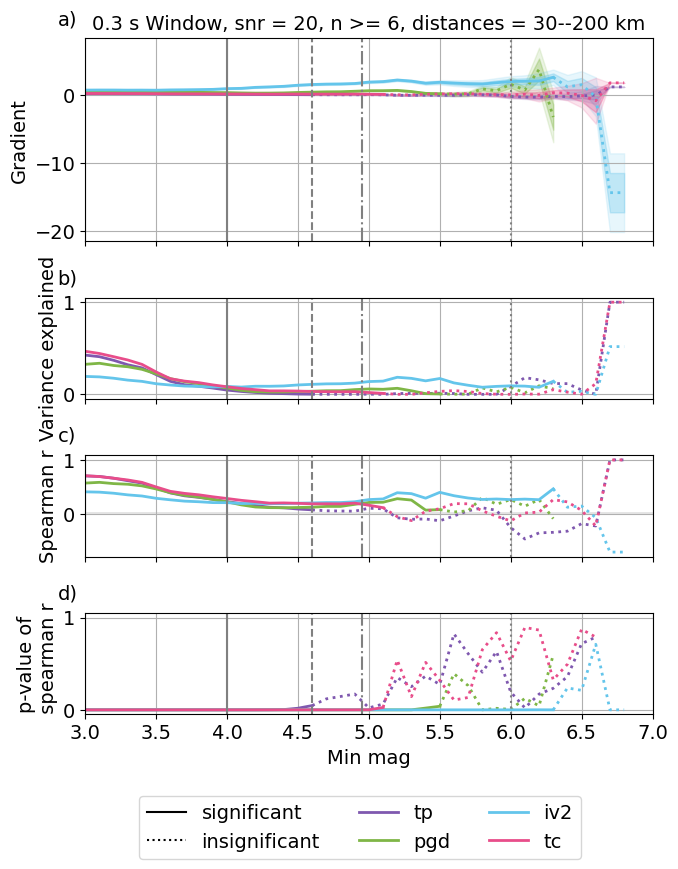

tp 0.6942230661381585
pgd 0.5719427017326384
tc 0.6801714325011626
iv2 0.4110916152548353
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


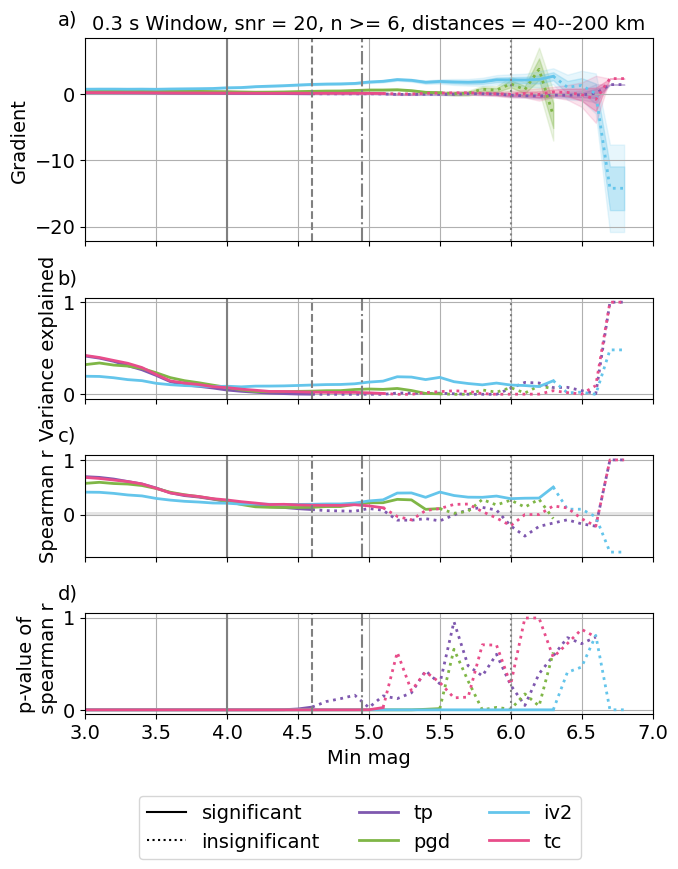

tp 0.6839874670351666
pgd 0.5812842409194559
tc 0.6511881560192323
iv2 0.42597882183670954
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


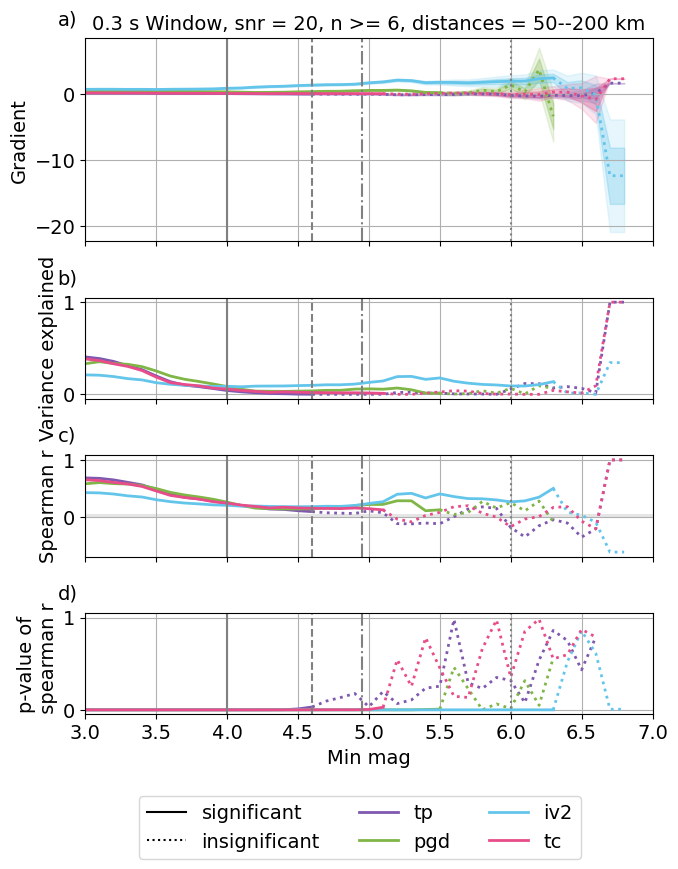

tp 0.6614931878872786
pgd 0.5839536088543474
tc 0.5838818235898457
iv2 0.4520937089594897
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


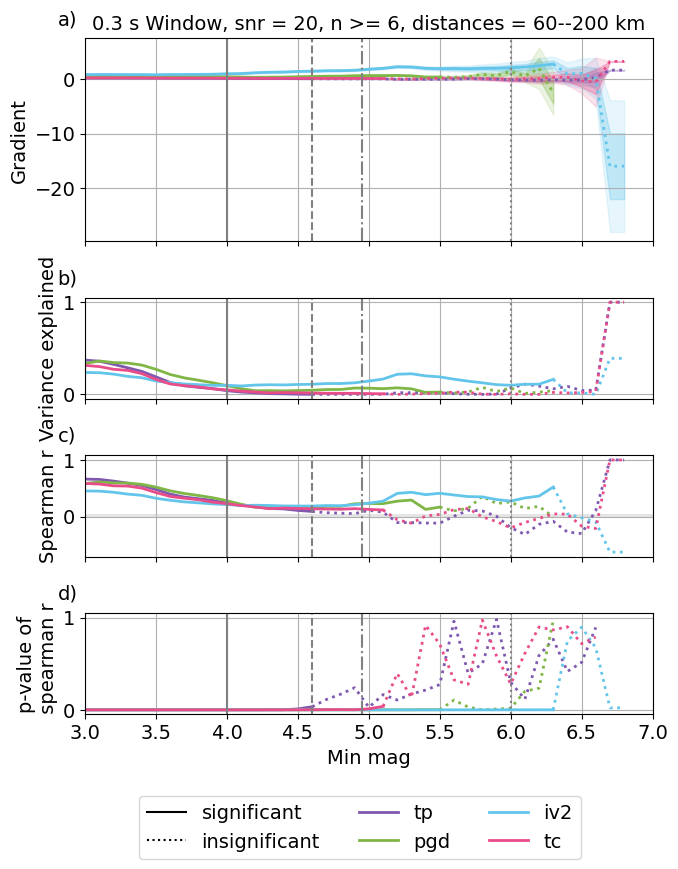

tp 0.6430792319814581
pgd 0.5892667837333755
tc 0.5104902930369775
iv2 0.49587338341095594
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


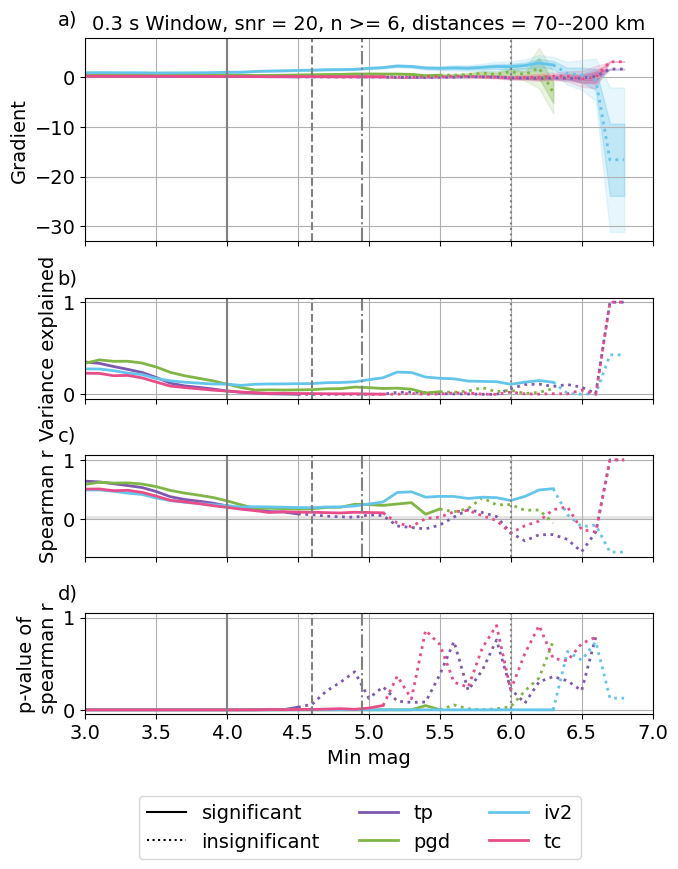

tp 0.6021119408966573
pgd 0.5882396928979238
tc 0.3877421025455902
iv2 0.5503081213520603
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


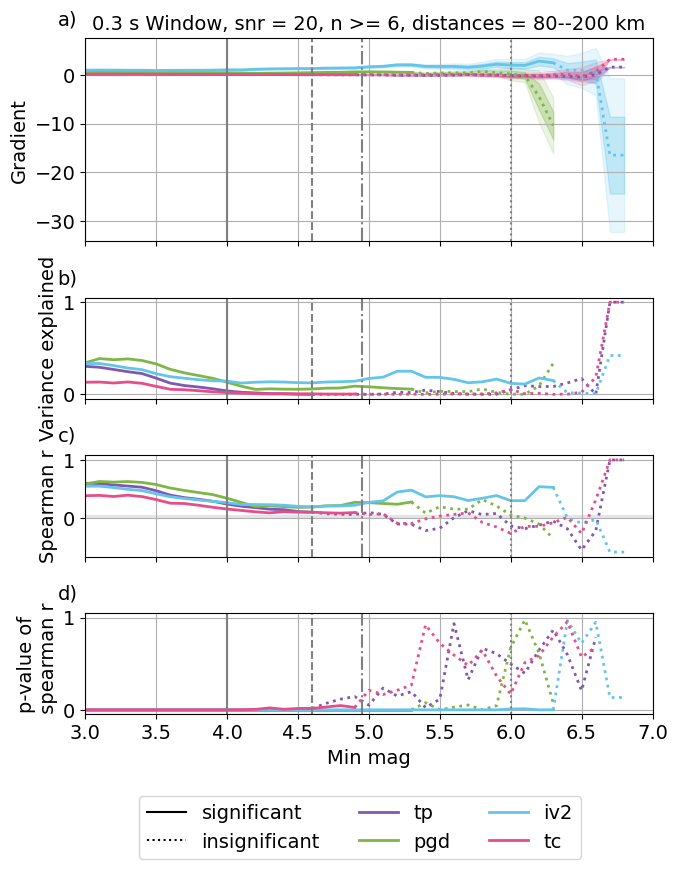

tp 0.5641335856295338
pgd 0.5709166110660551
tc 0.2806105580259349
iv2 0.5624090741856489
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


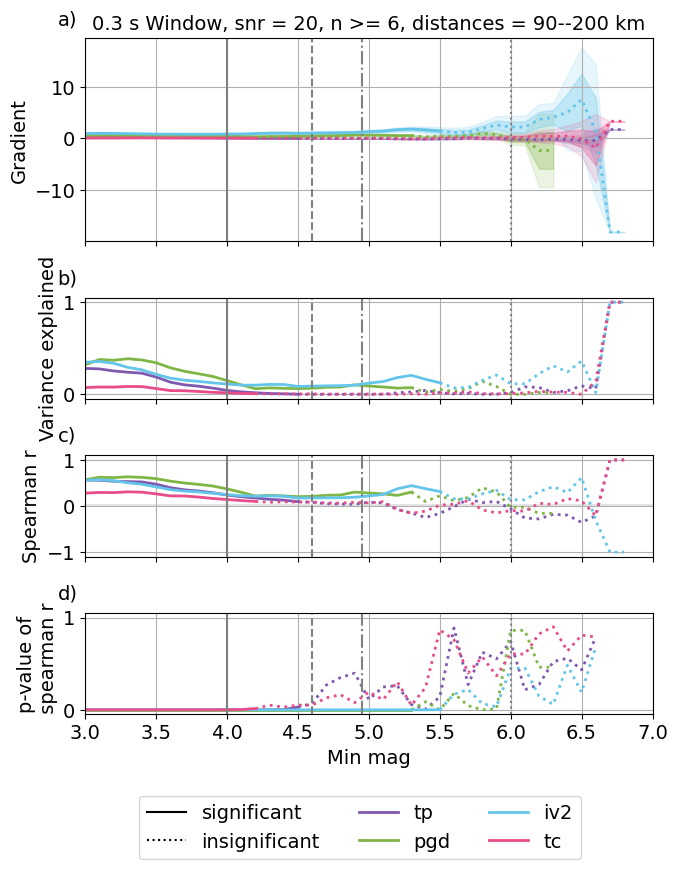

eq_object_05s_bandpass_01_19_snr_20_blank_0_new_snr20
tp 0.5257459165887971
pgd 0.7009132152553517
tc 0.6859444463388383
iv2 0.546661181167167
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


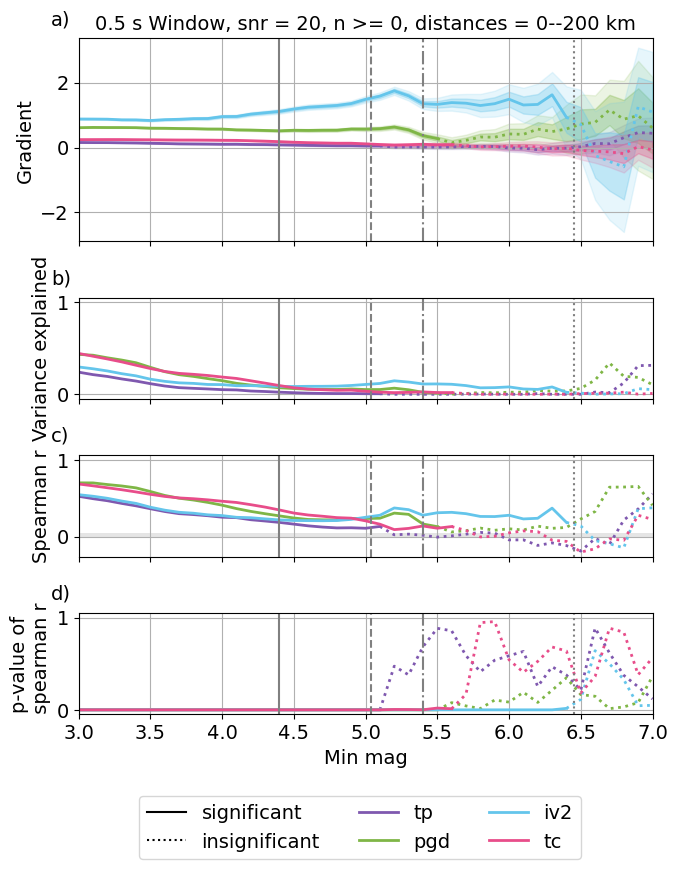

tp 0.5181513039774711
pgd 0.6961748122512399
tc 0.6772228829949718
iv2 0.5434957815338146
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


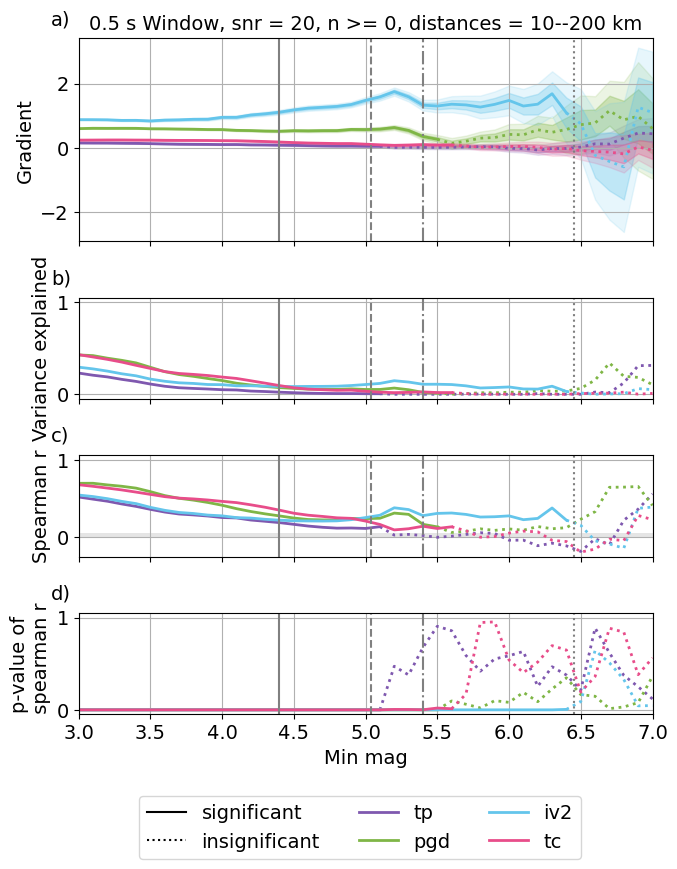

tp 0.5030971852016193
pgd 0.6863868952976343
tc 0.6650251045515859
iv2 0.5336474102228052
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


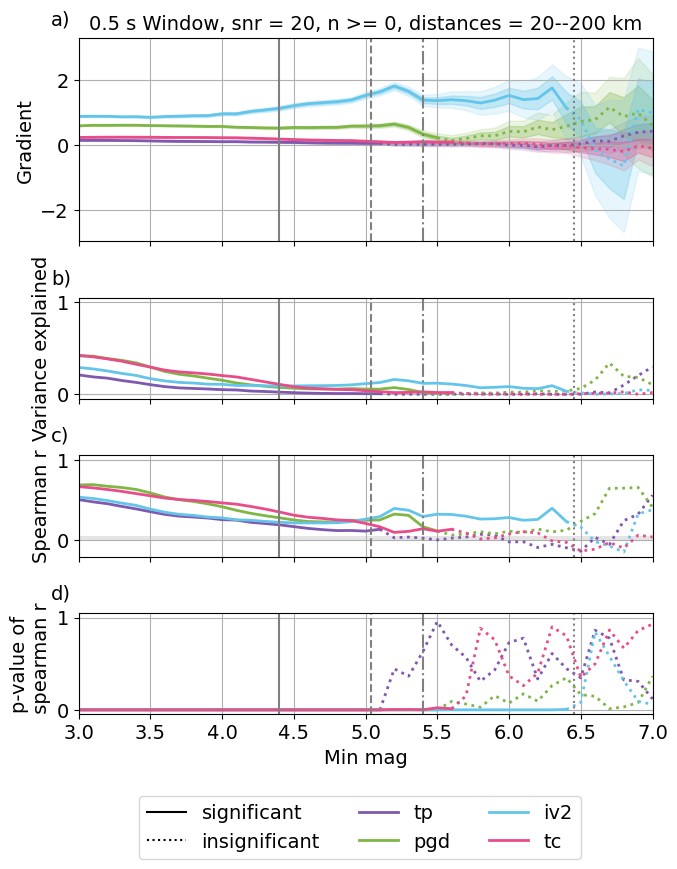

tp 0.4920752937118558
pgd 0.6745678349285876
tc 0.6475756675576819
iv2 0.5168773902086966
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


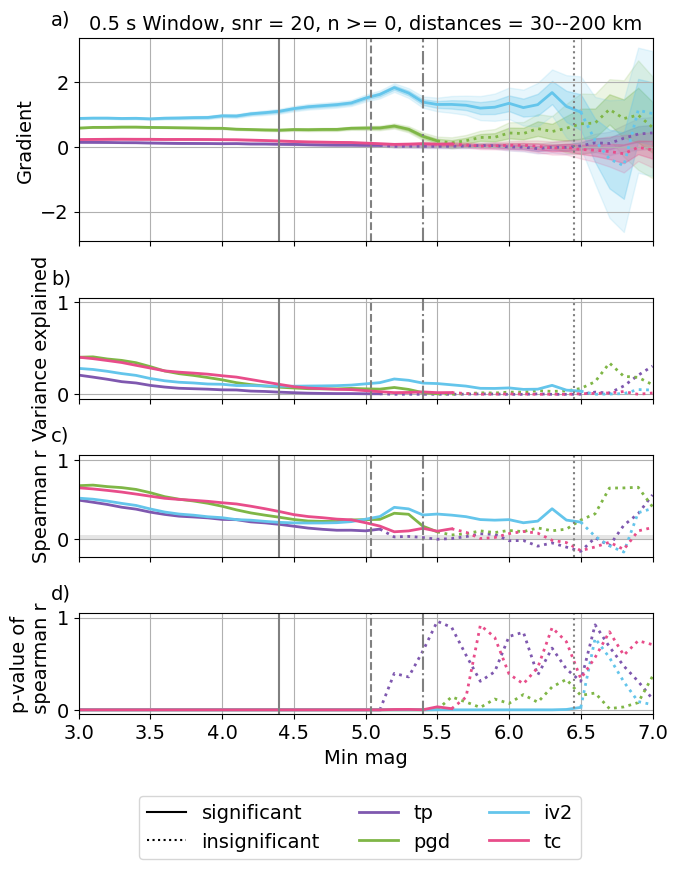

tp 0.48576182557671166
pgd 0.6643355659431396
tc 0.6316828941319482
iv2 0.5024259728416122
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


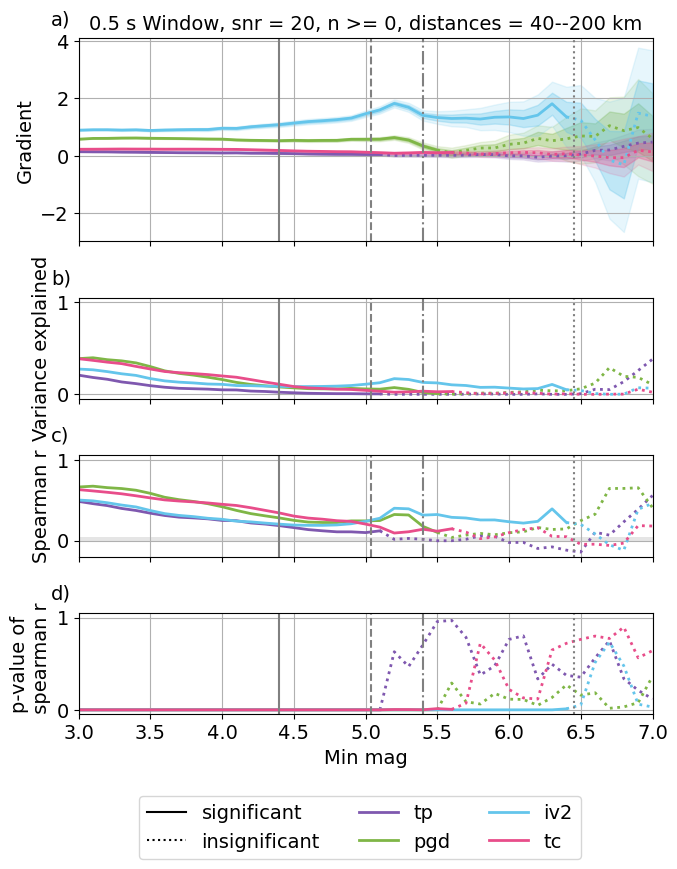

tp 0.474119948129225
pgd 0.6669855195968508
tc 0.6114326630089458
iv2 0.5116439496308781
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


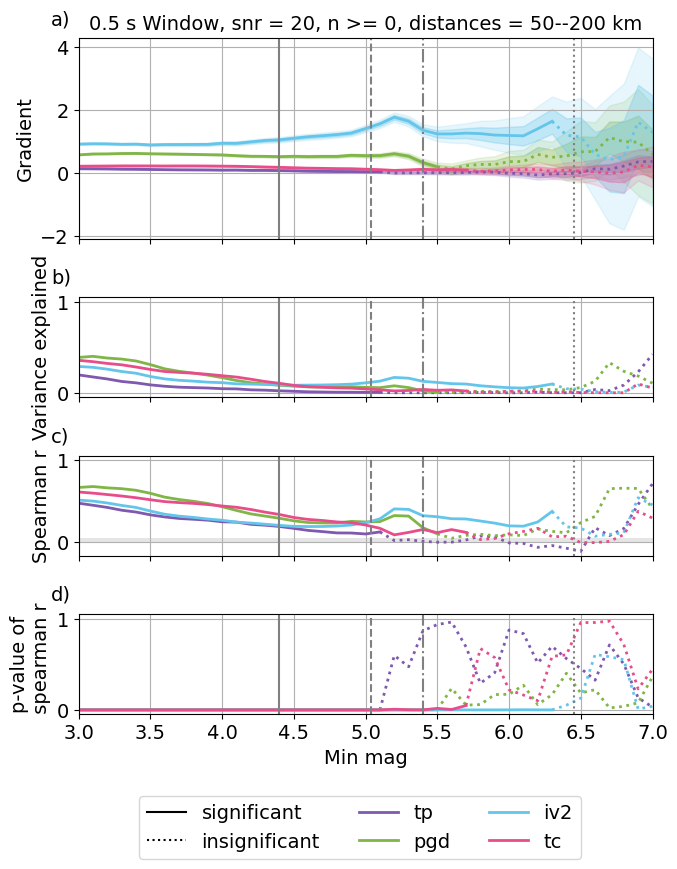

tp 0.4625908874224642
pgd 0.6683540353450487
tc 0.5823699995825231
iv2 0.5285211631078217
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


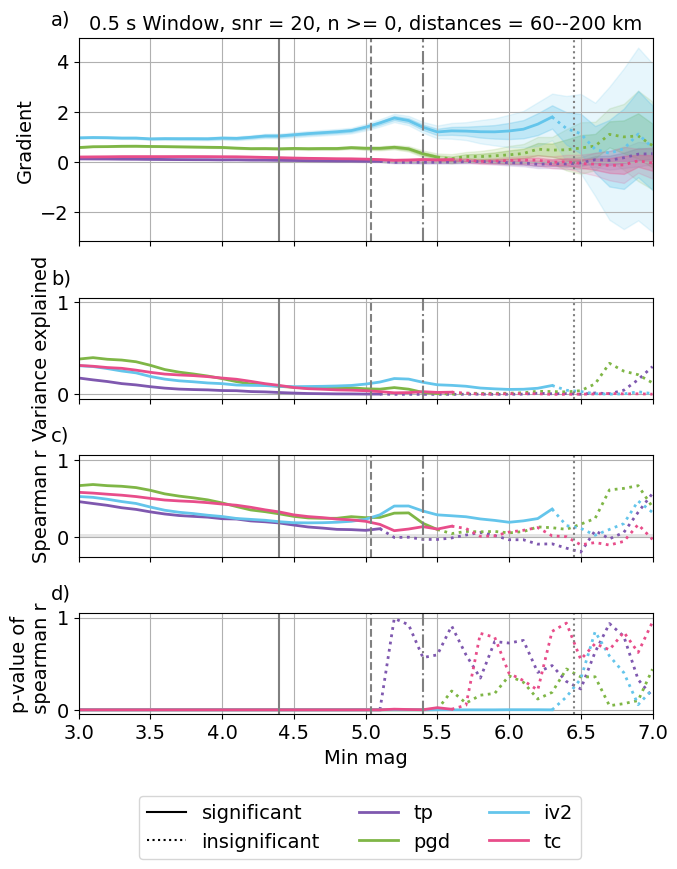

tp 0.4528320900772664
pgd 0.6745416156344536
tc 0.5460500488442241
iv2 0.5557941246662619
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


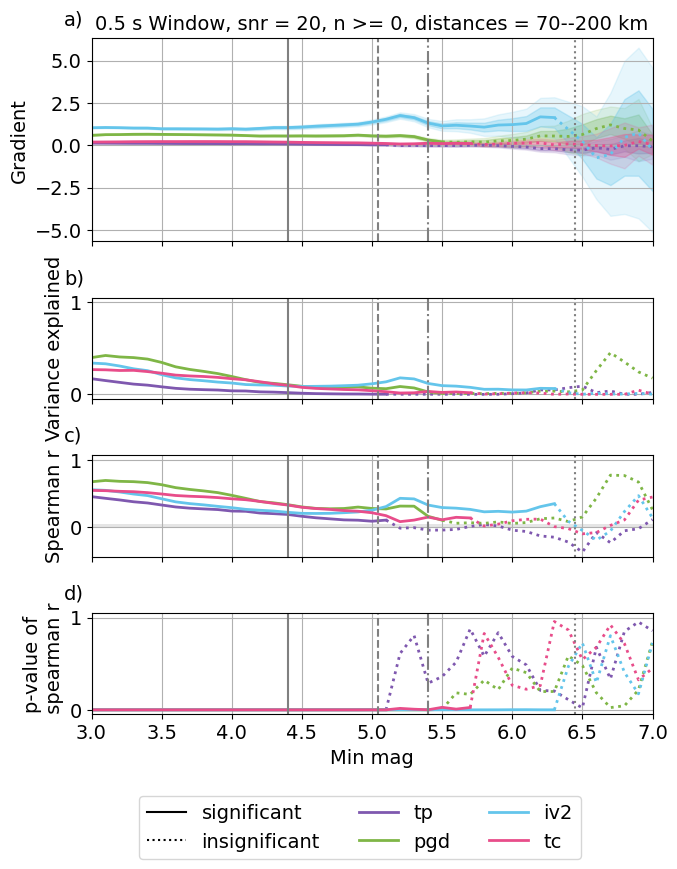

tp 0.43664951016026965
pgd 0.6697005000054757
tc 0.4912748564215376
iv2 0.5715944060005956
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


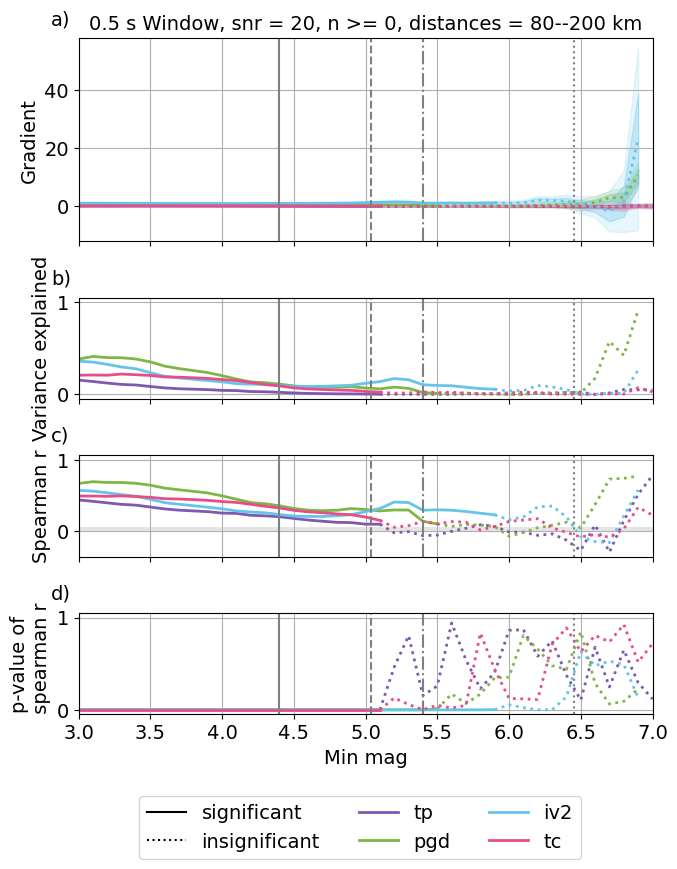

tp 0.416326306559753
pgd 0.6575486915245613
tc 0.43878228489118887
iv2 0.5639587194318232
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


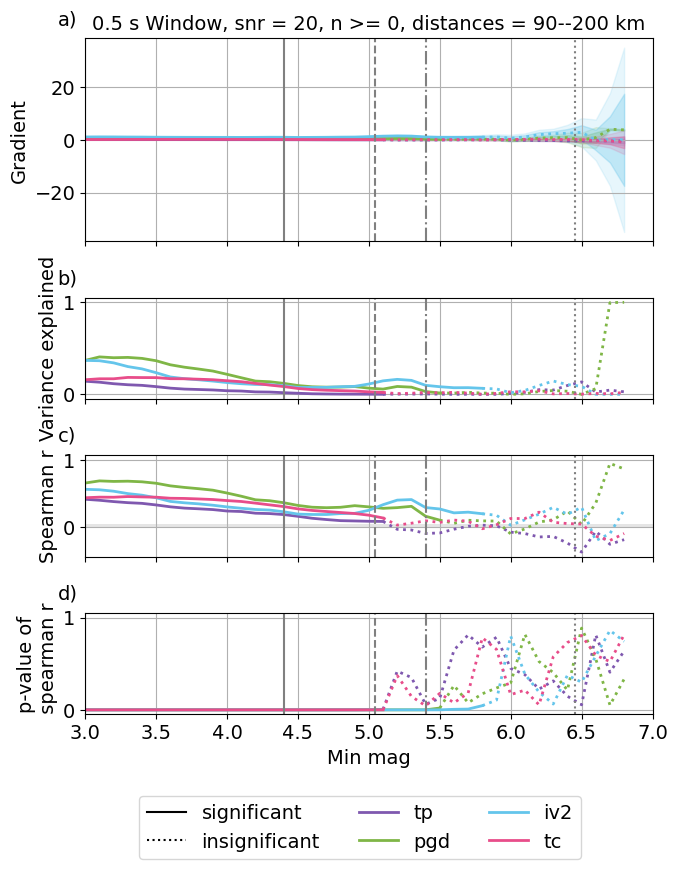

tp 0.5257459165887971
pgd 0.7009132152553517
tc 0.6859444463388383
iv2 0.546661181167167
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


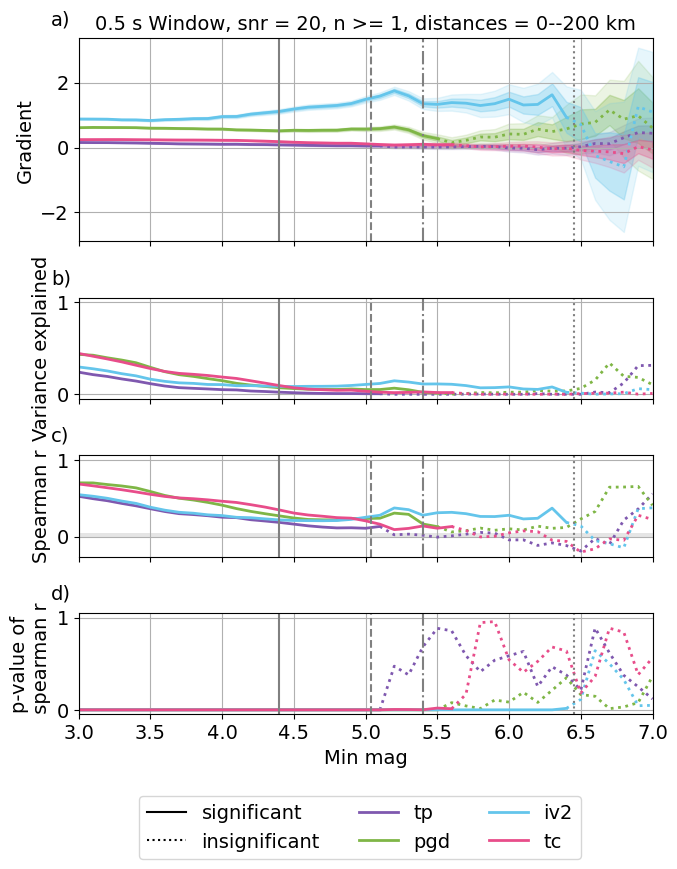

tp 0.5181513039774711
pgd 0.6961748122512399
tc 0.6772228829949718
iv2 0.5434957815338146
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


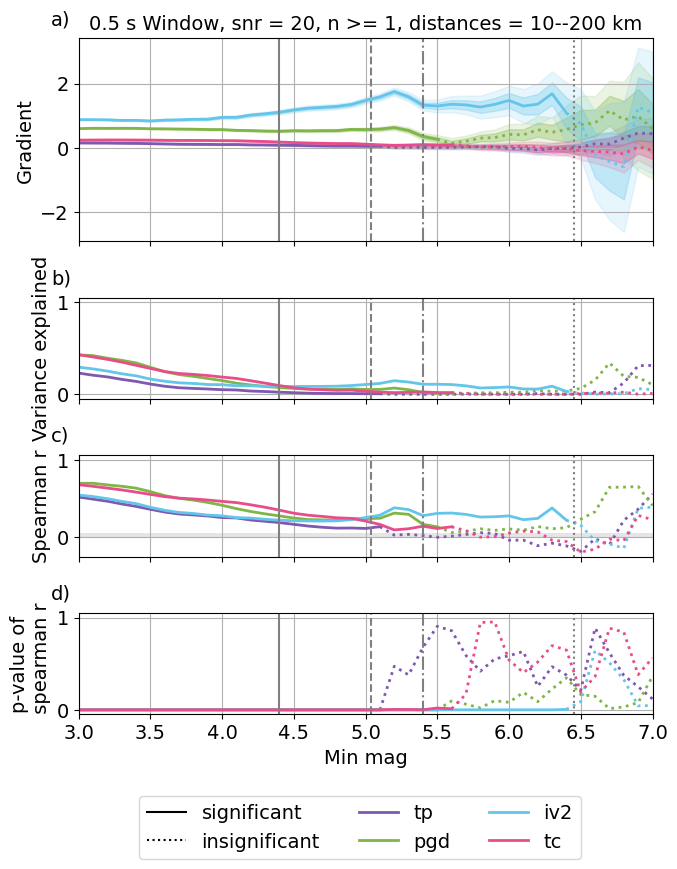

tp 0.5030971852016193
pgd 0.6863868952976343
tc 0.6650251045515859
iv2 0.5336474102228052
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


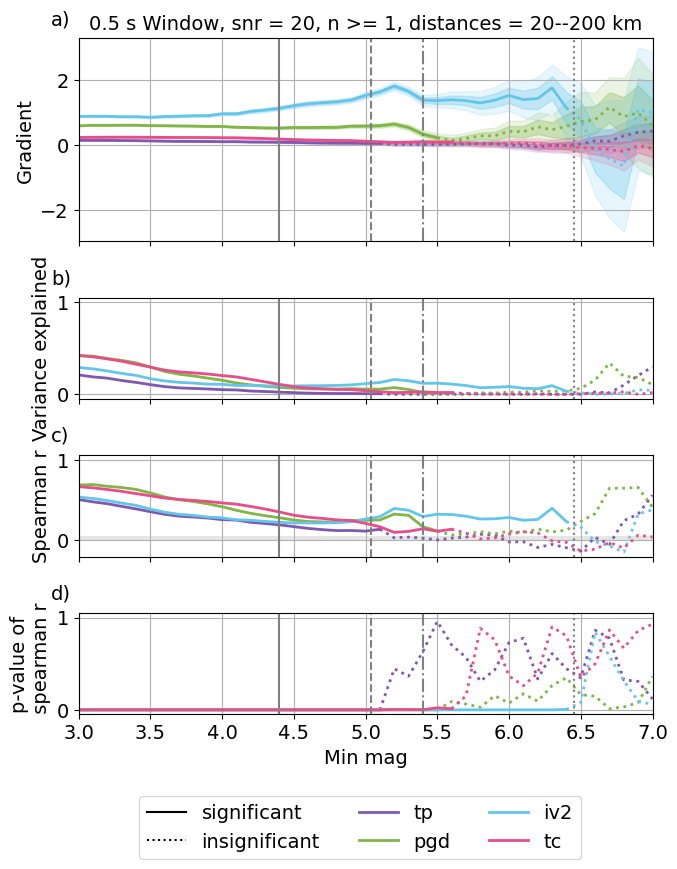

tp 0.4920752937118558
pgd 0.6745678349285876
tc 0.6475756675576819
iv2 0.5168773902086966
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


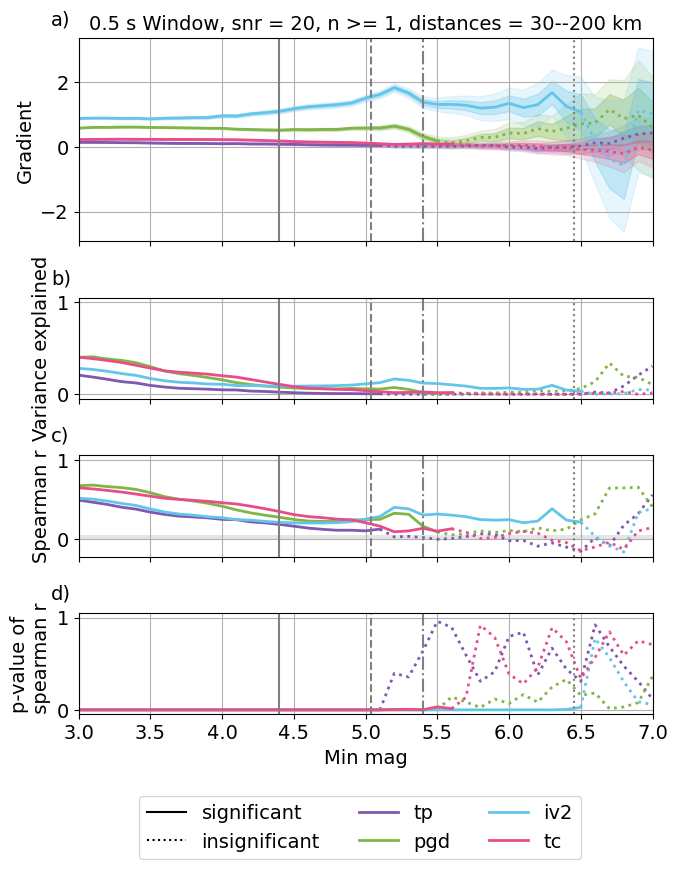

tp 0.48576182557671166
pgd 0.6643355659431396
tc 0.6316828941319482
iv2 0.5024259728416122
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


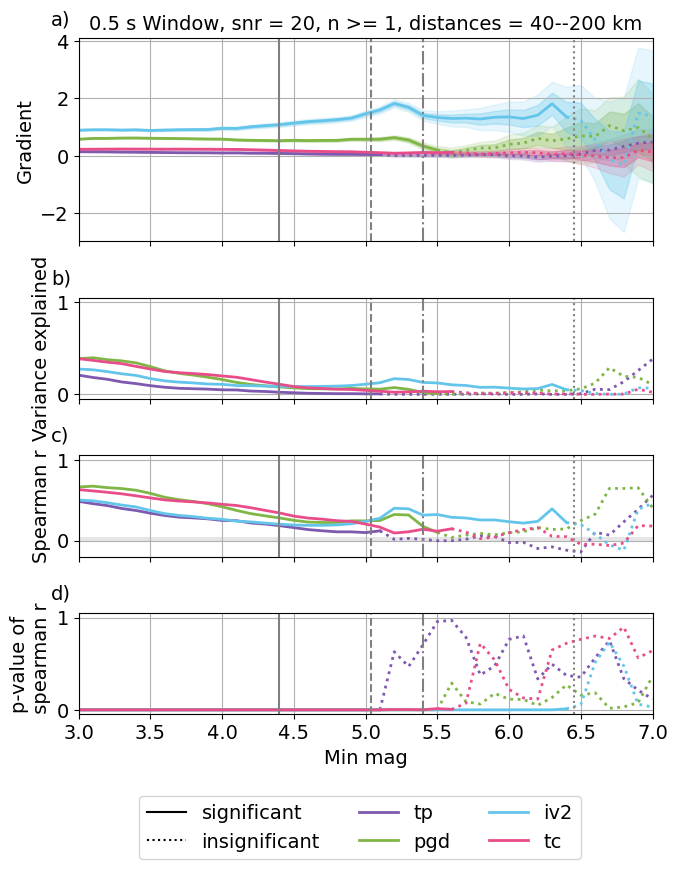

tp 0.474119948129225
pgd 0.6669855195968508
tc 0.6114326630089458
iv2 0.5116439496308781
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


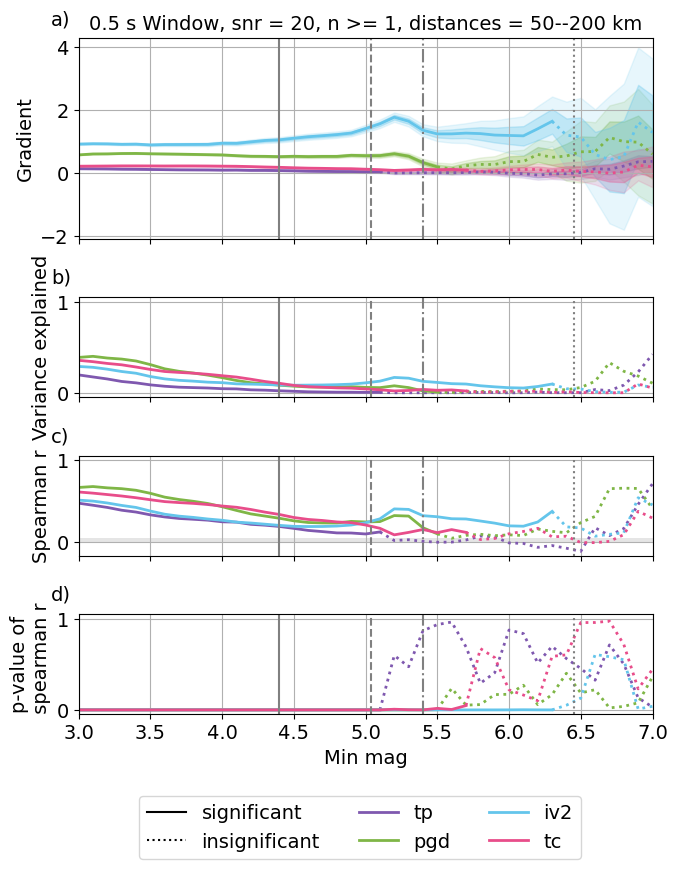

tp 0.4625908874224642
pgd 0.6683540353450487
tc 0.5823699995825231
iv2 0.5285211631078217
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


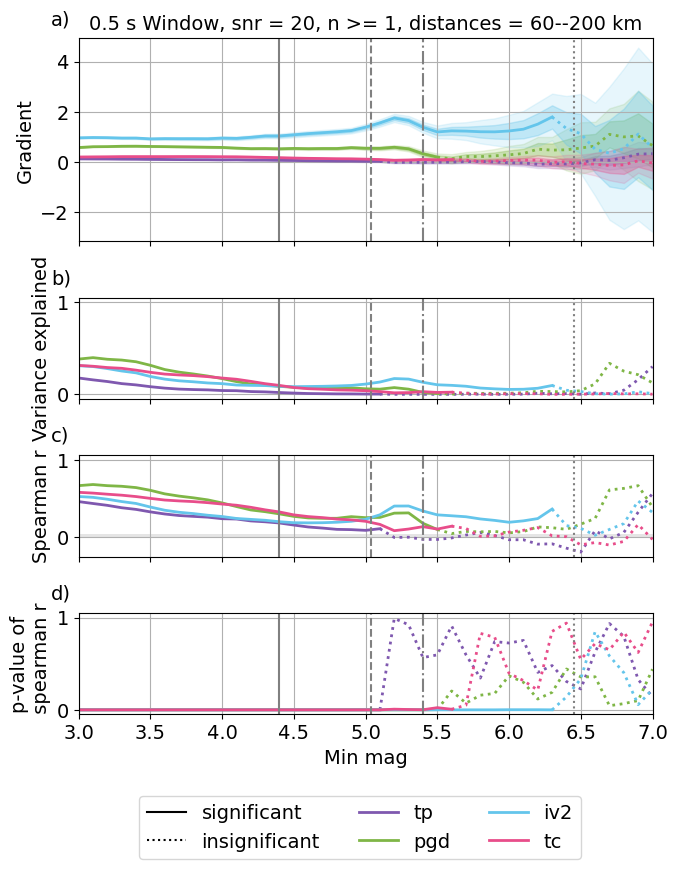

tp 0.4528320900772664
pgd 0.6745416156344536
tc 0.5460500488442241
iv2 0.5557941246662619
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


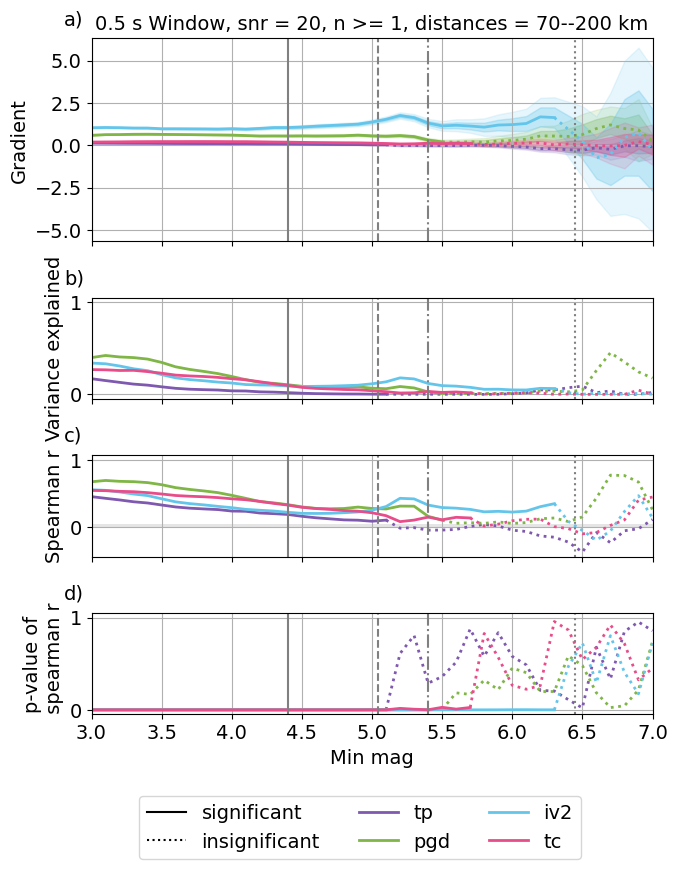

tp 0.43664951016026965
pgd 0.6697005000054757
tc 0.4912748564215376
iv2 0.5715944060005956
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


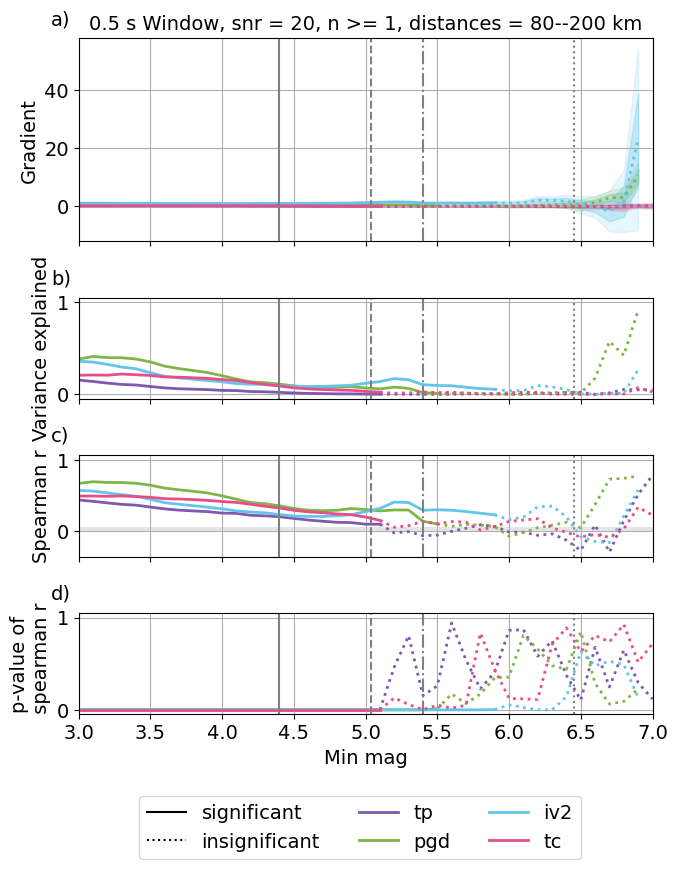

tp 0.416326306559753
pgd 0.6575486915245613
tc 0.43878228489118887
iv2 0.5639587194318232
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


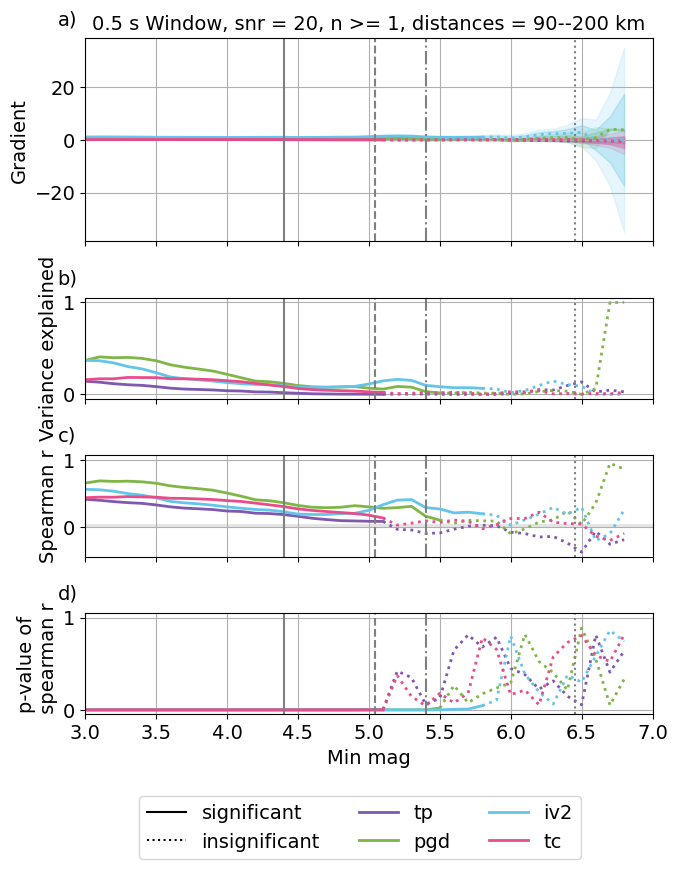

tp 0.6173126157396744
pgd 0.7007997933562345
tc 0.7387001973409776
iv2 0.5463917403169899
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


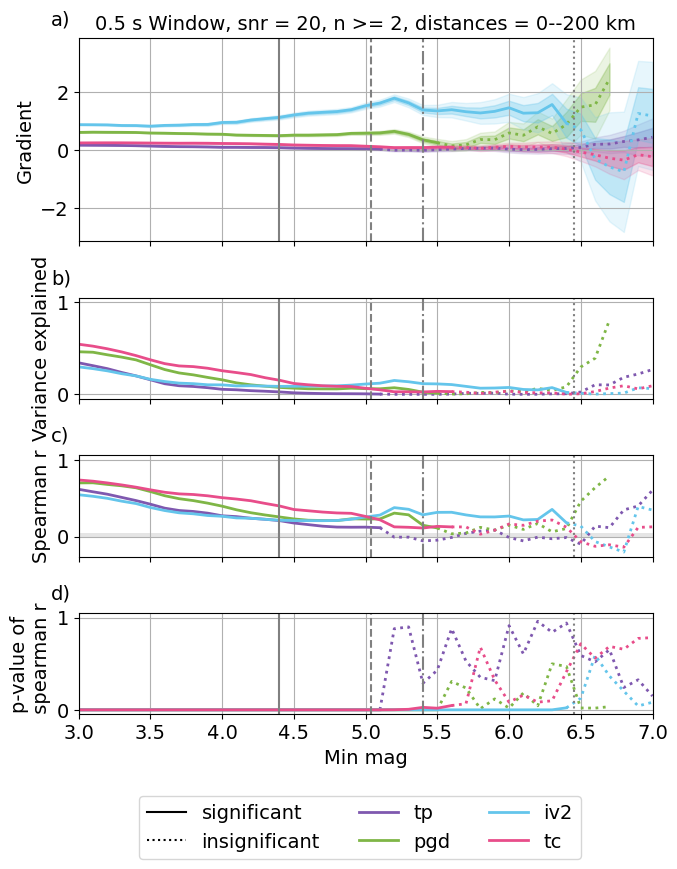

tp 0.6104161789156332
pgd 0.6962481999103967
tc 0.7277055557624352
iv2 0.5434629467714505
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


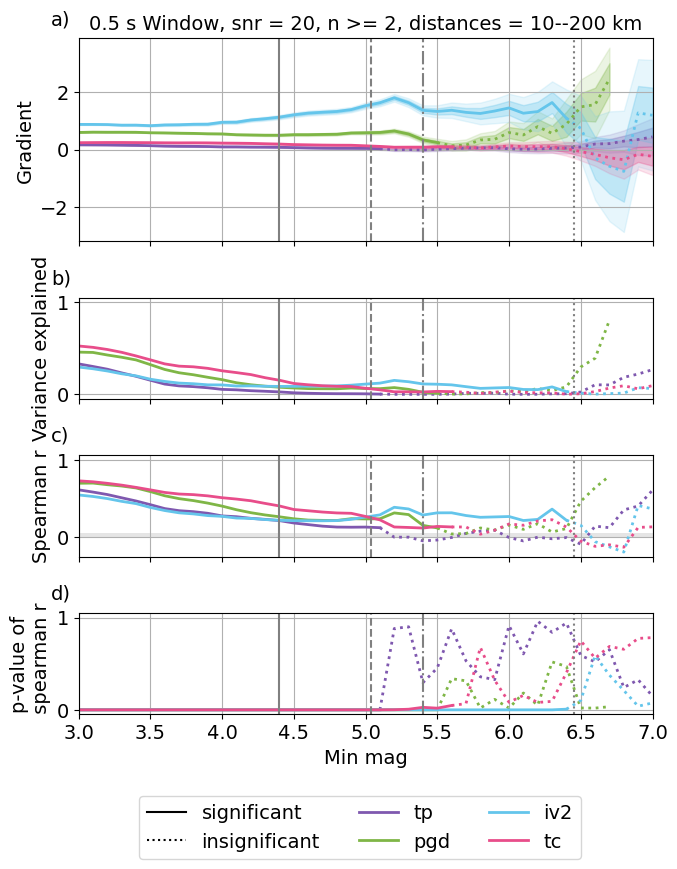

tp 0.5918900527200025
pgd 0.6866539379505666
tc 0.712741421055528
iv2 0.5341460839152868
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


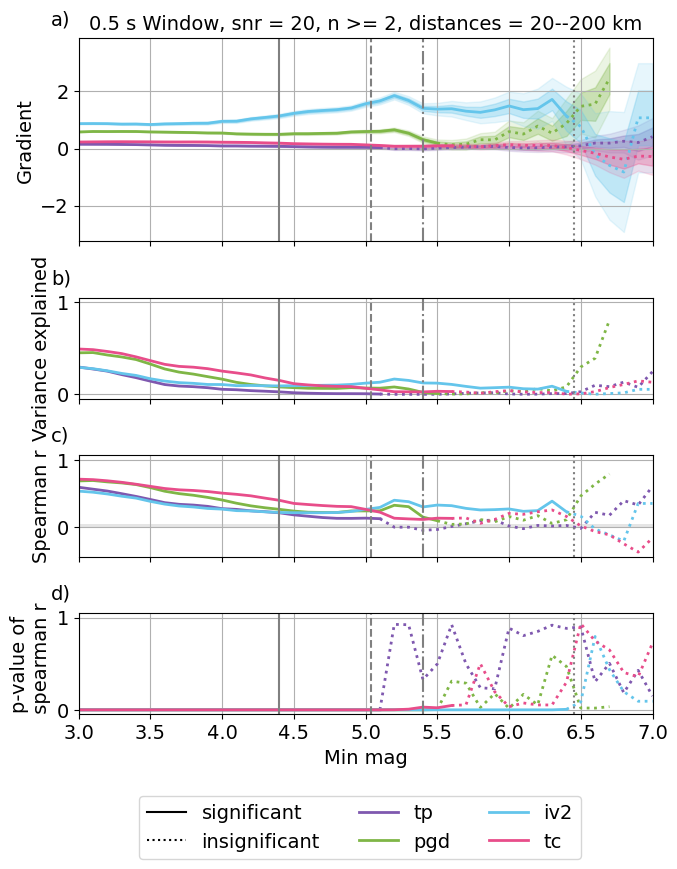

tp 0.577599911434704
pgd 0.6760562905381983
tc 0.6909233721119838
iv2 0.517234896975843
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


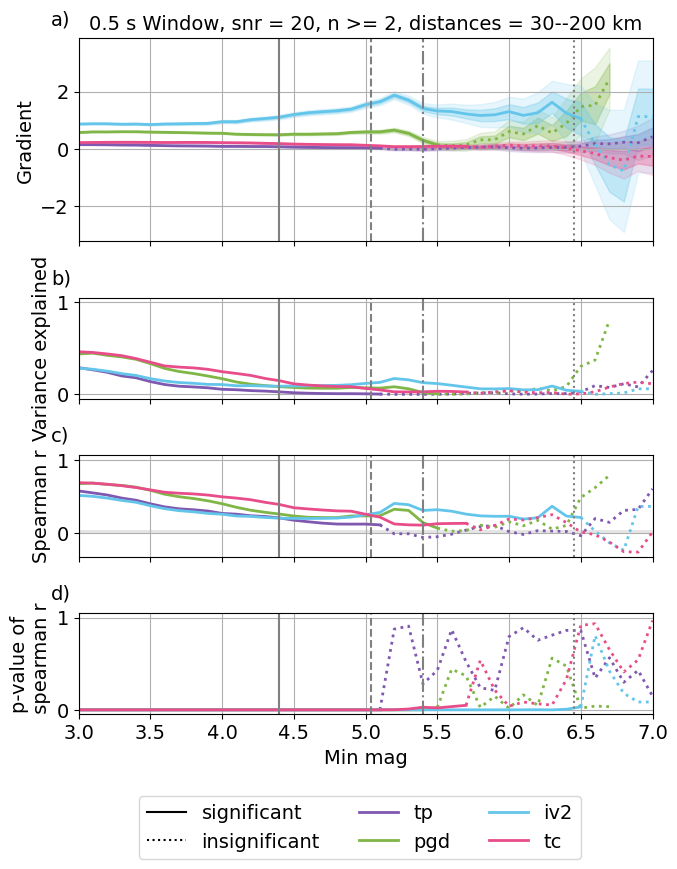

tp 0.5709633822391563
pgd 0.6667891244276166
tc 0.6760783124095349
iv2 0.5035762484549082
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


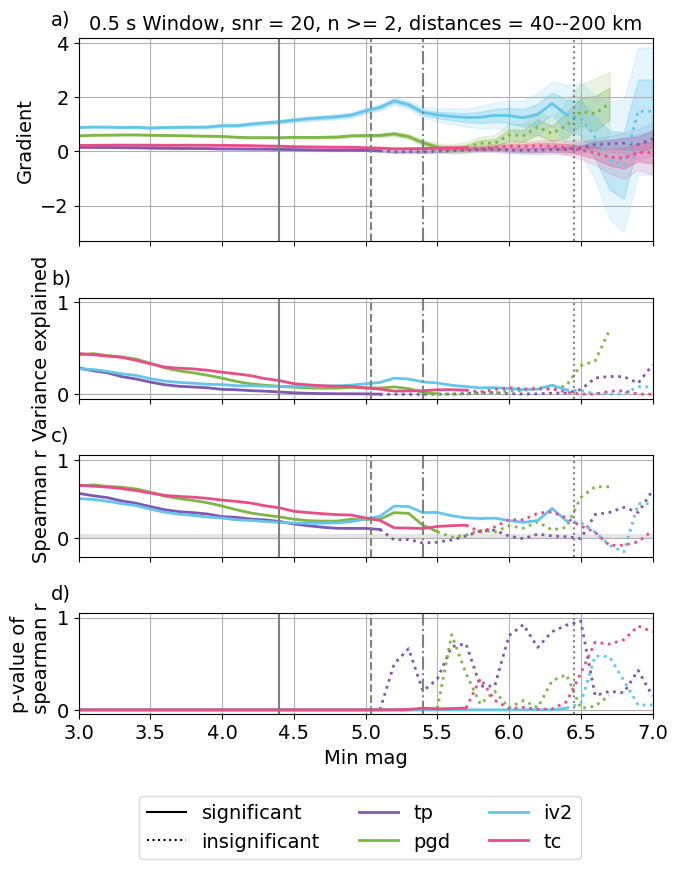

tp 0.5573513690339436
pgd 0.6704862801295562
tc 0.6522169536784085
iv2 0.5146552846769074
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


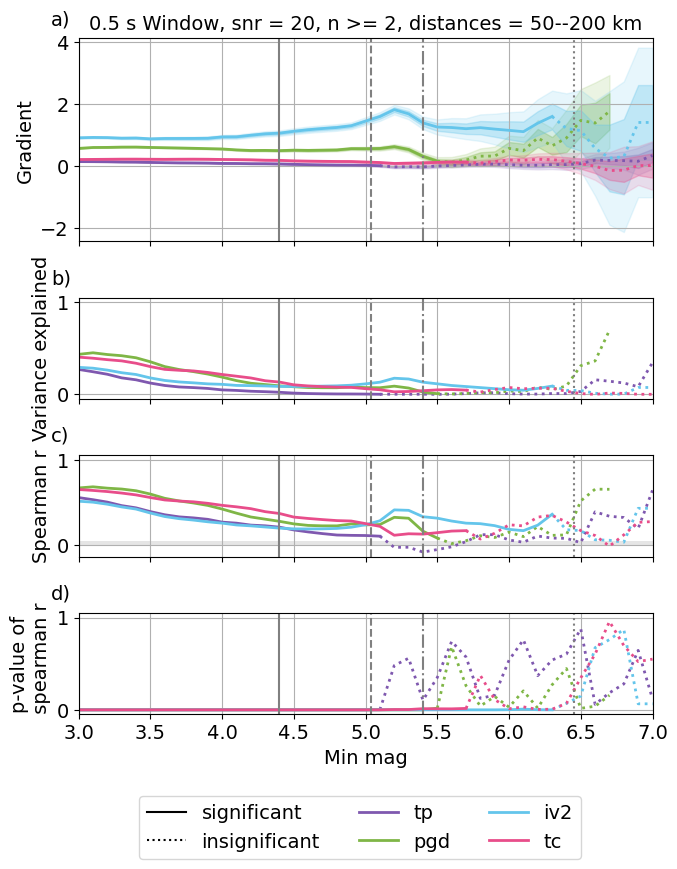

tp 0.5432917081384843
pgd 0.6719255252697924
tc 0.6167100404253425
iv2 0.5337172015048891
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


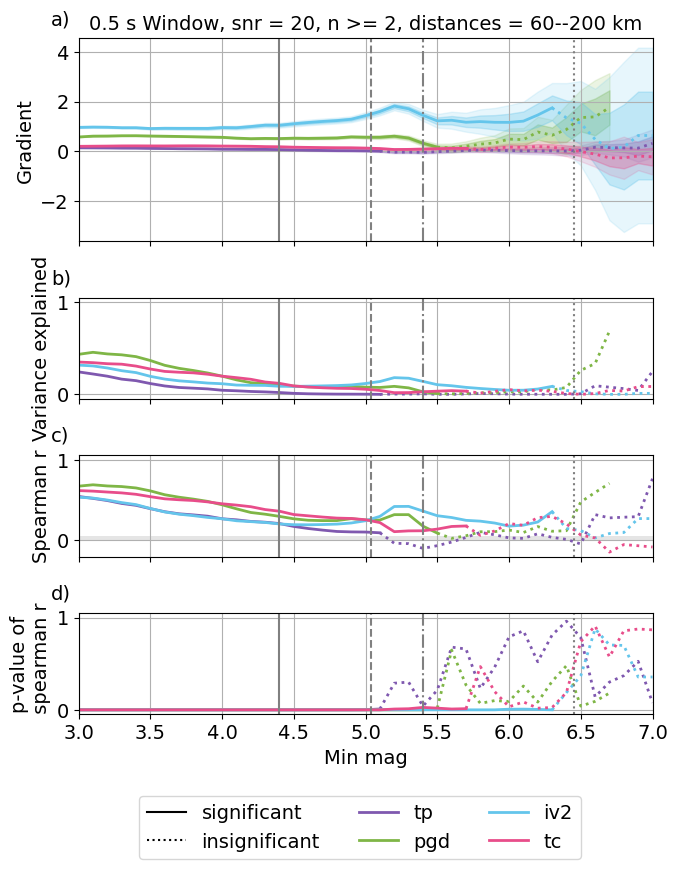

tp 0.5287444522174171
pgd 0.6772626430258161
tc 0.572026558298611
iv2 0.5631131154491473
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


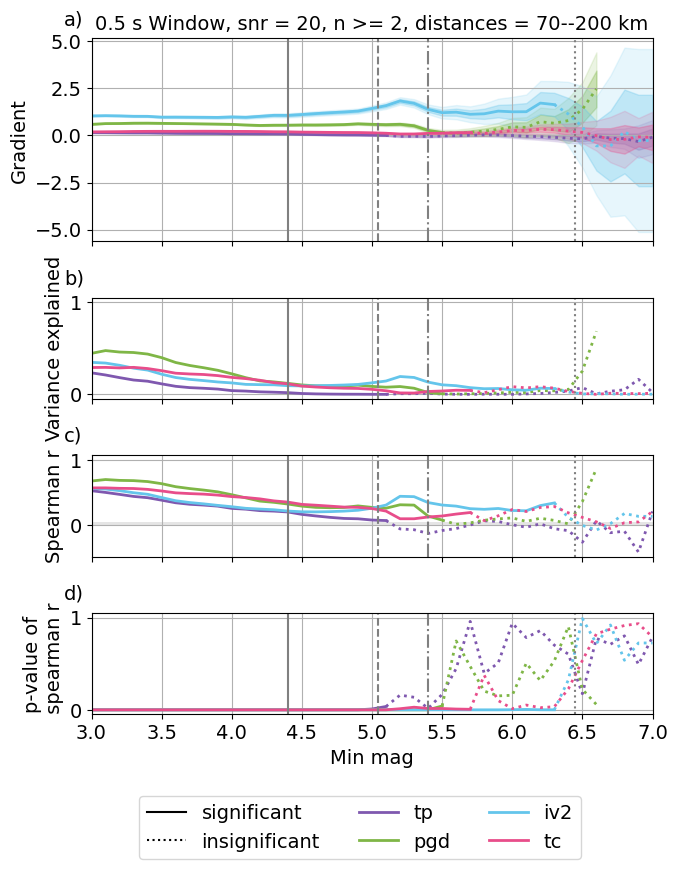

tp 0.501699988112585
pgd 0.6730437500275472
tc 0.5013341199870458
iv2 0.5851328528013128
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


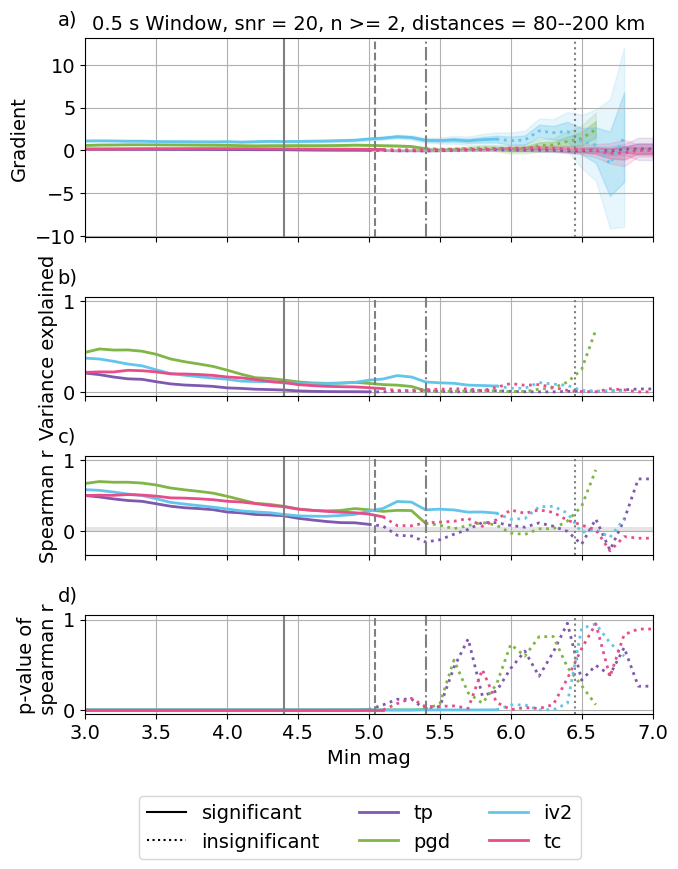

tp 0.47414783549692313
pgd 0.6580003668655398
tc 0.4365249526810202
iv2 0.5862860791237469
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


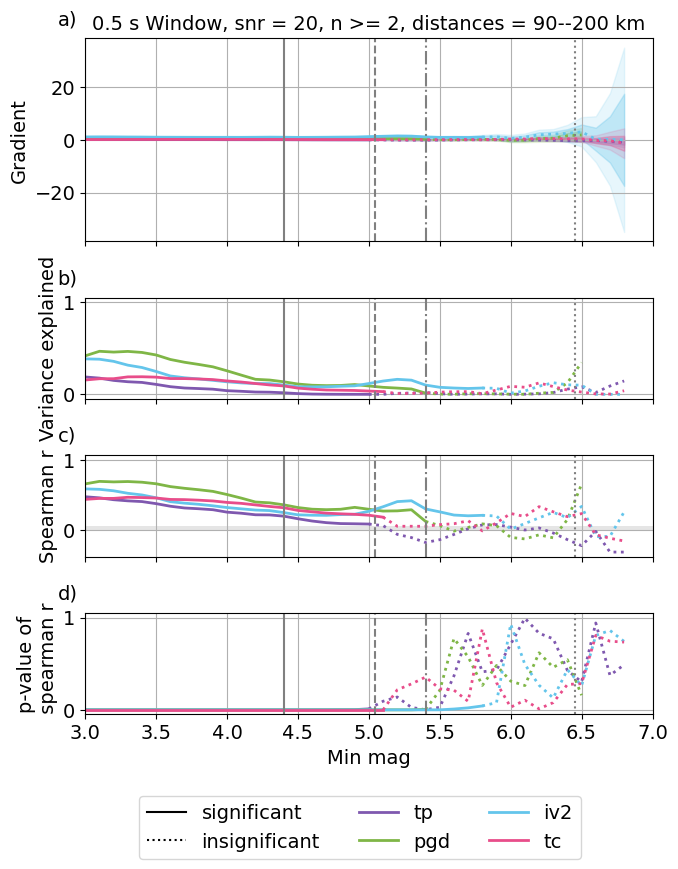

tp 0.6637270154576689
pgd 0.6971697949912664
tc 0.7674411929362103
iv2 0.5418688012621092
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


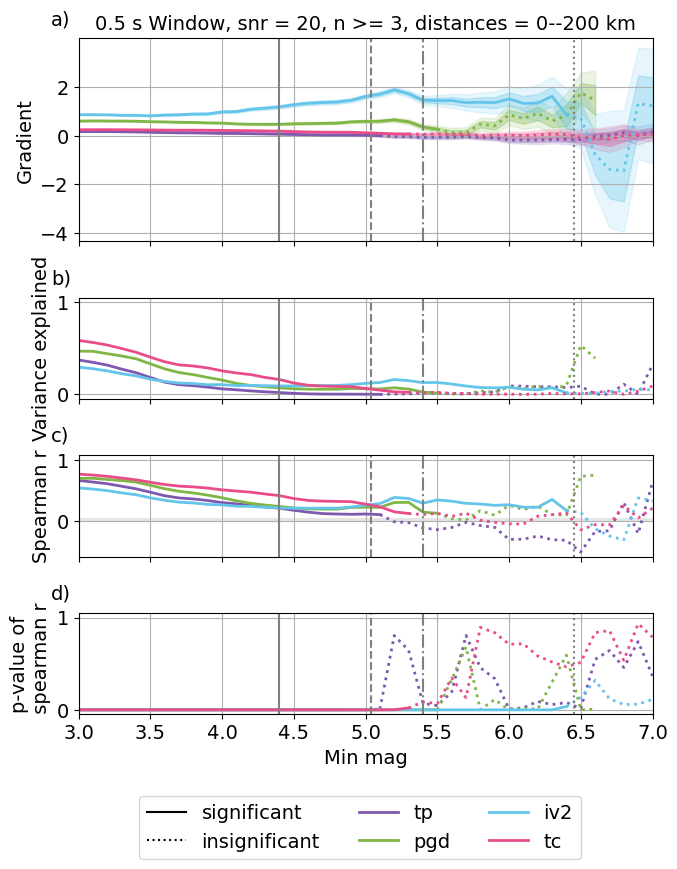

tp 0.6618957669090857
pgd 0.6932747245394546
tc 0.7555575808495939
iv2 0.5391314188941172
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


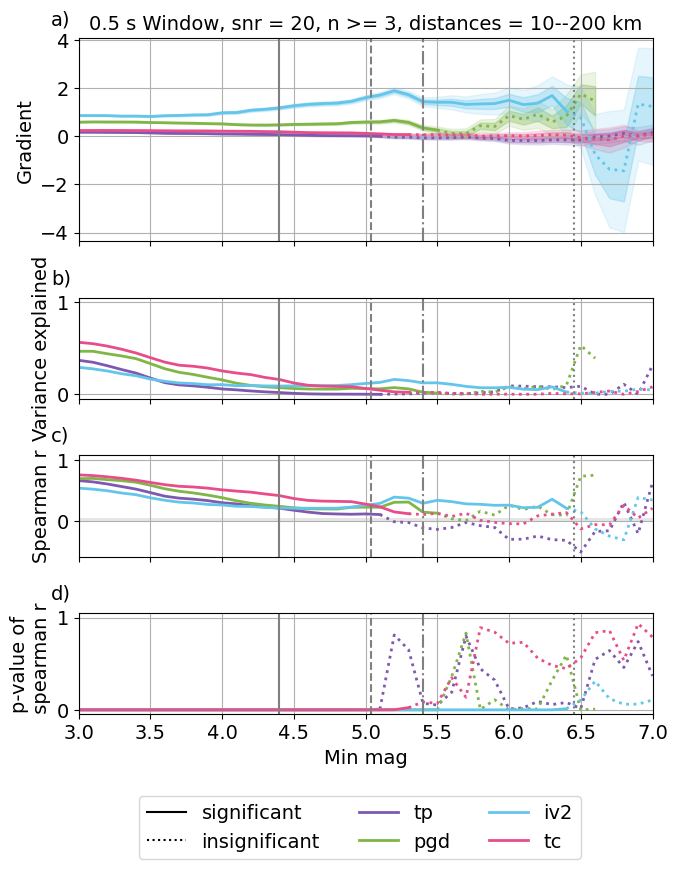

tp 0.6470406628038736
pgd 0.6844501019956399
tc 0.7416642619878966
iv2 0.531690933867111
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


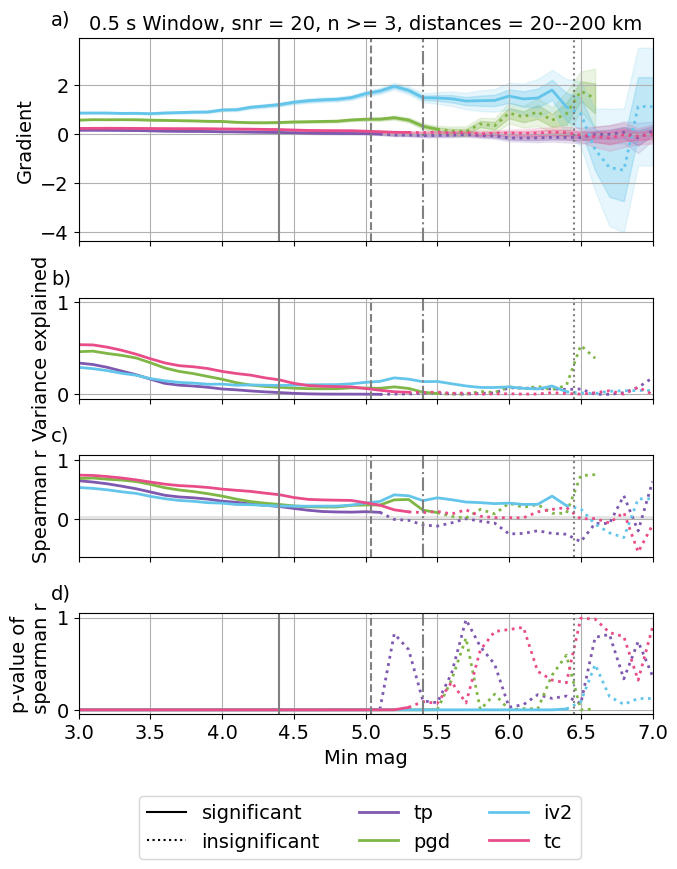

tp 0.6330466937847484
pgd 0.674562627062271
tc 0.7189493093870271
iv2 0.5157697524023641
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


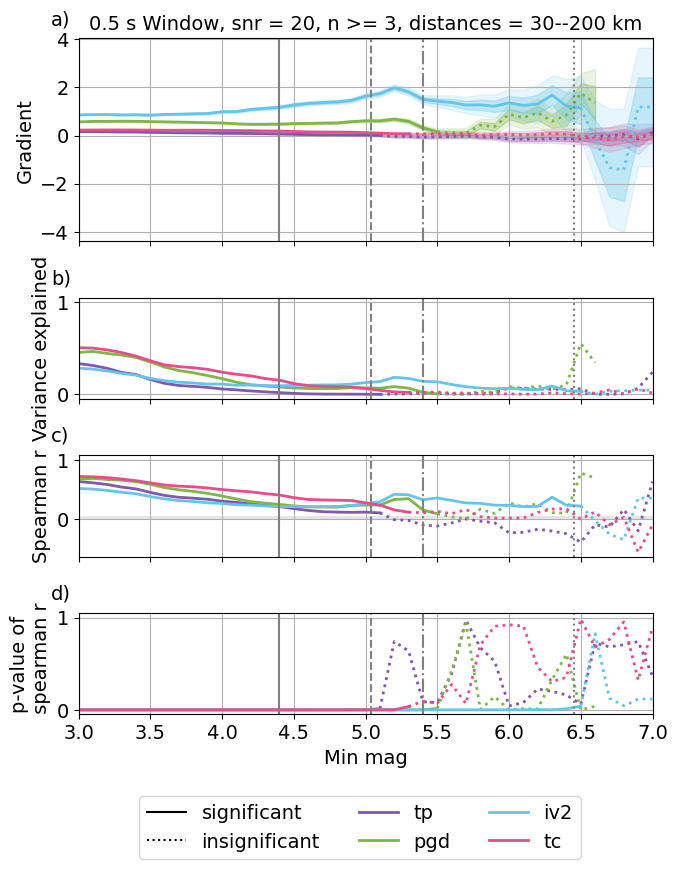

tp 0.6252059477595522
pgd 0.6661752288225353
tc 0.699060071359168
iv2 0.5040320028162025
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


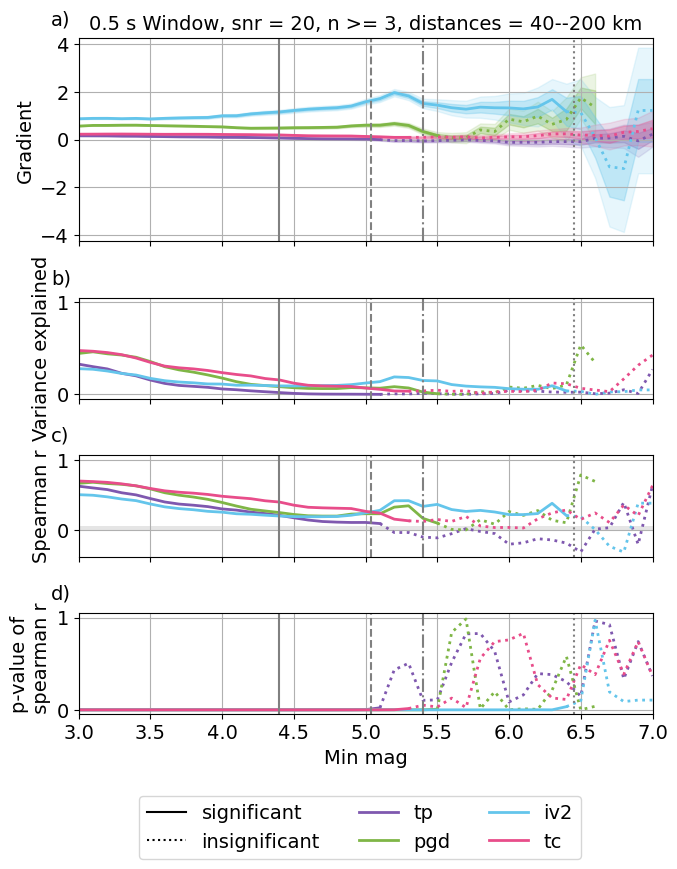

tp 0.615248998141317
pgd 0.6708678340598822
tc 0.6701483243107182
iv2 0.516207152115665
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


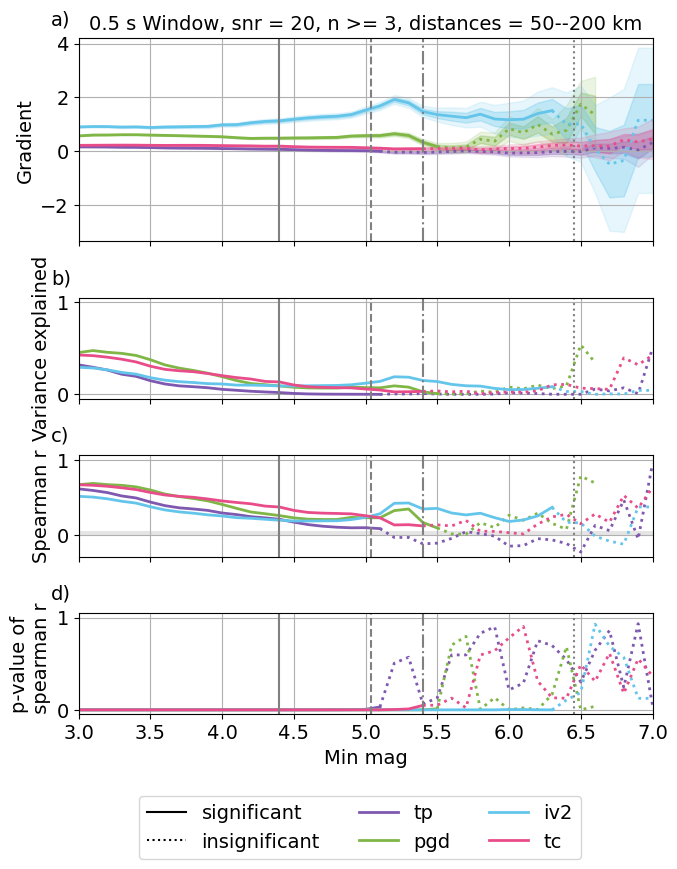

tp 0.6027768794266851
pgd 0.6722649208626905
tc 0.6287427138752985
iv2 0.5378062602718808
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


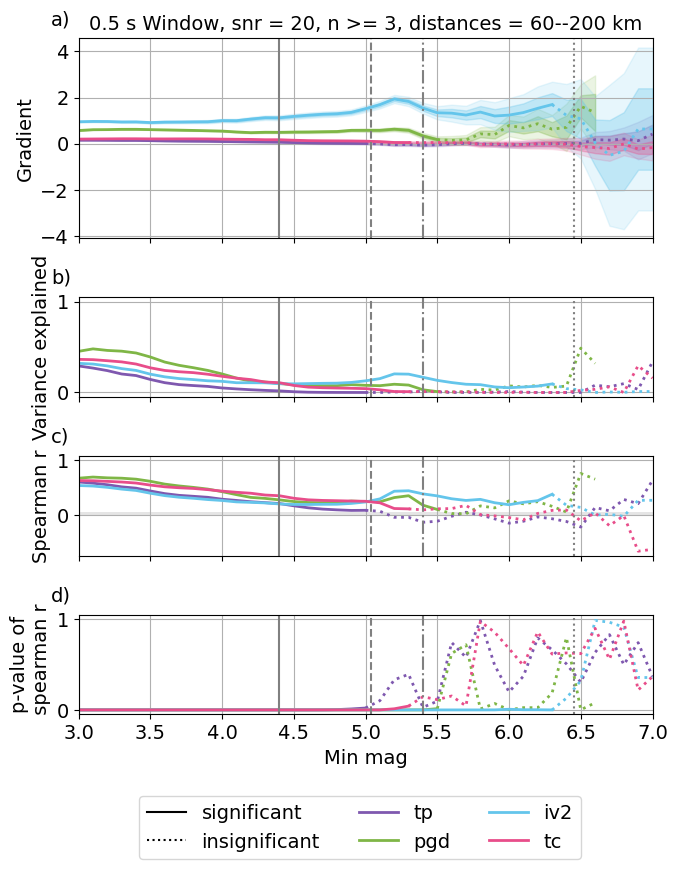

tp 0.5953769777646382
pgd 0.6761168793723734
tc 0.5814475684171009
iv2 0.5682366187574253
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


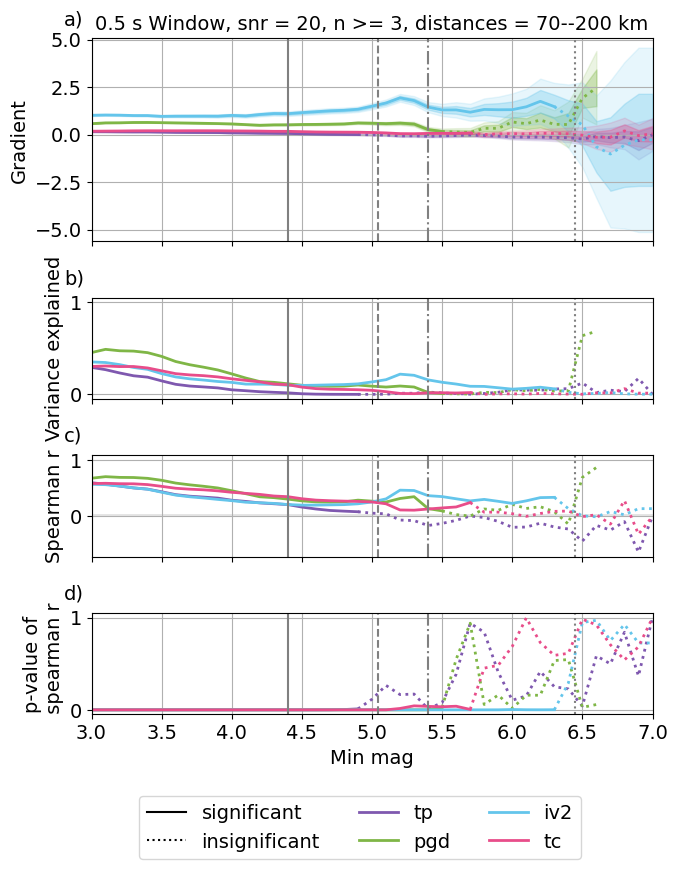

tp 0.5575453545781798
pgd 0.6703037205426823
tc 0.4999818436896686
iv2 0.5928745495532136
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


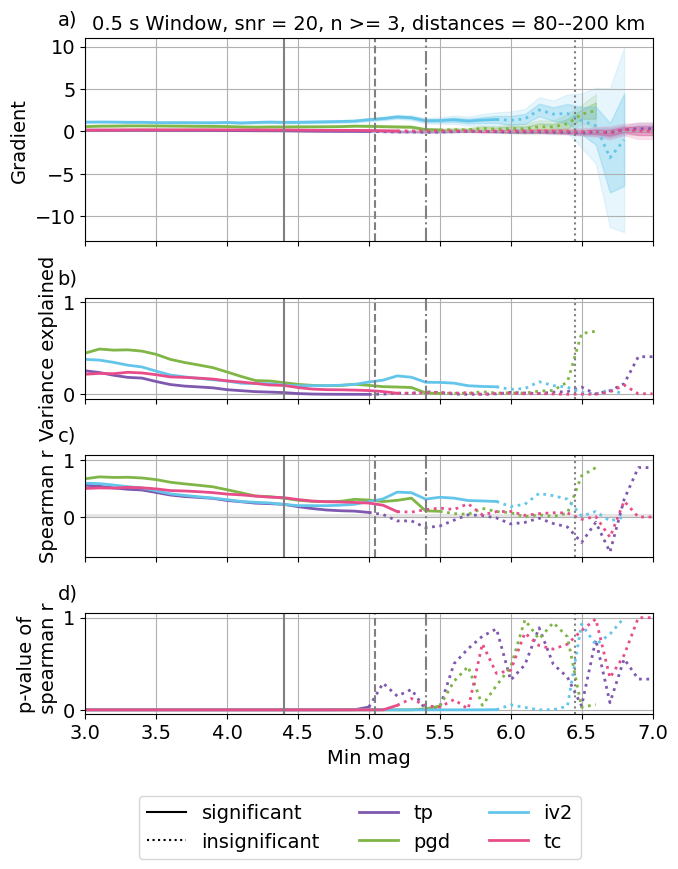

tp 0.5292717933415607
pgd 0.6533264744683732
tc 0.4223416437905199
iv2 0.5940163974915429
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


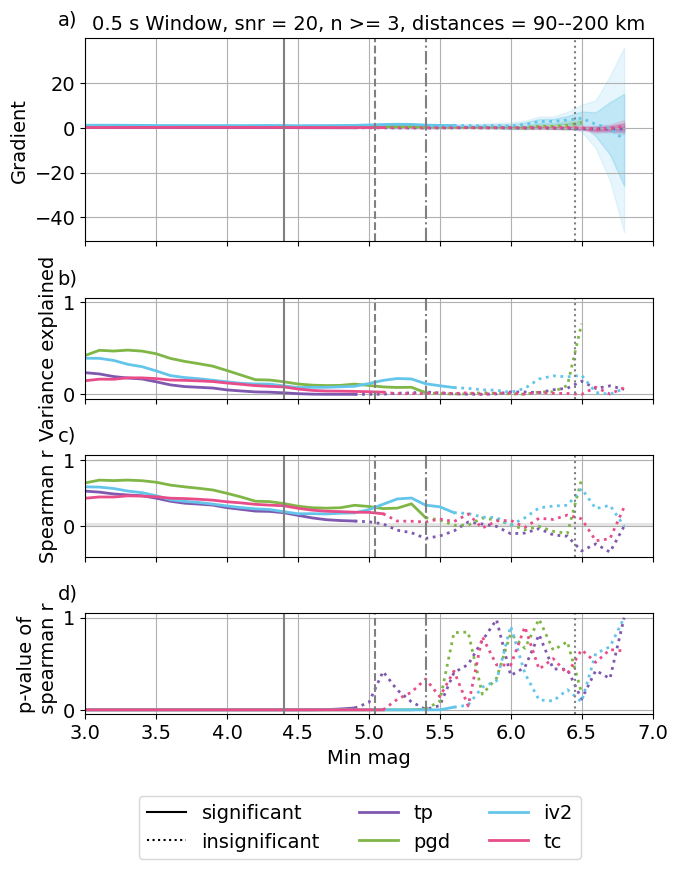

tp 0.7122469504540819
pgd 0.6908175238813171
tc 0.7880794416254201
iv2 0.5326650516265677
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


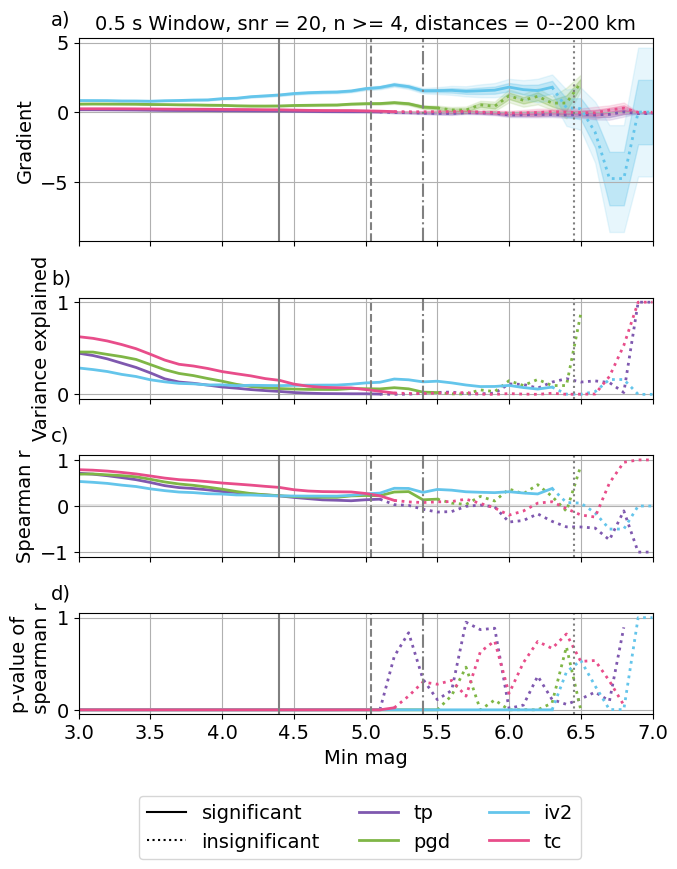

tp 0.7085562110628901
pgd 0.6873491015098762
tc 0.7755094960402923
iv2 0.5300252701578362
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


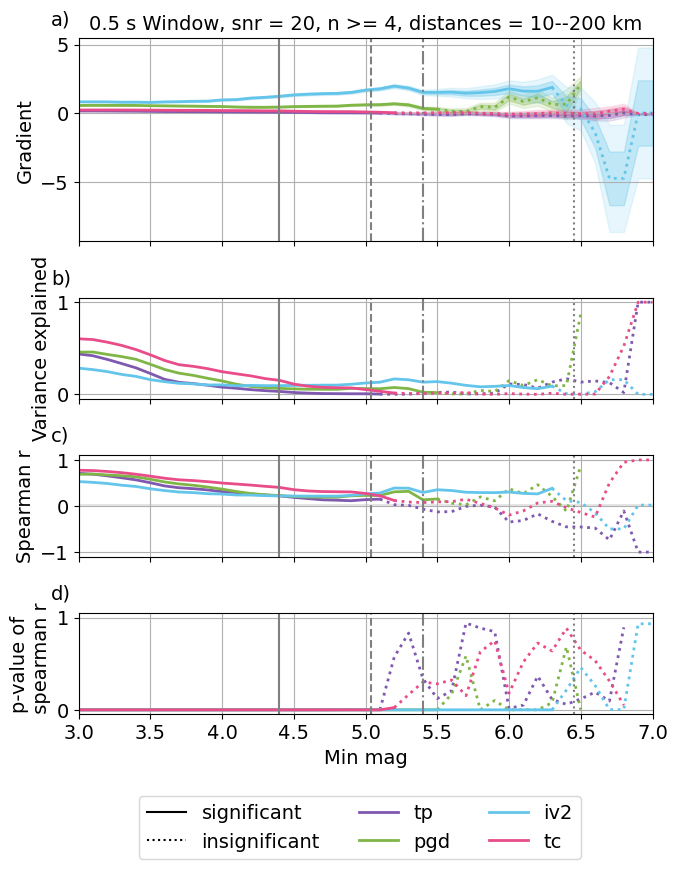

tp 0.695368109592062
pgd 0.6785381680661408
tc 0.7592705783281726
iv2 0.52340376832577
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


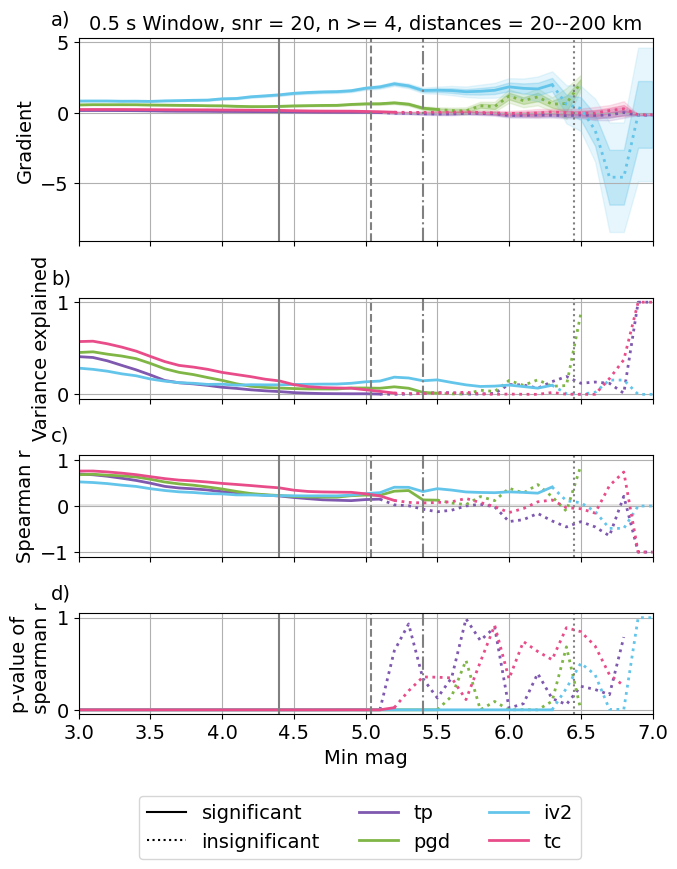

tp 0.6812207470836217
pgd 0.6693041704418328
tc 0.7345414309163406
iv2 0.508359937742953
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


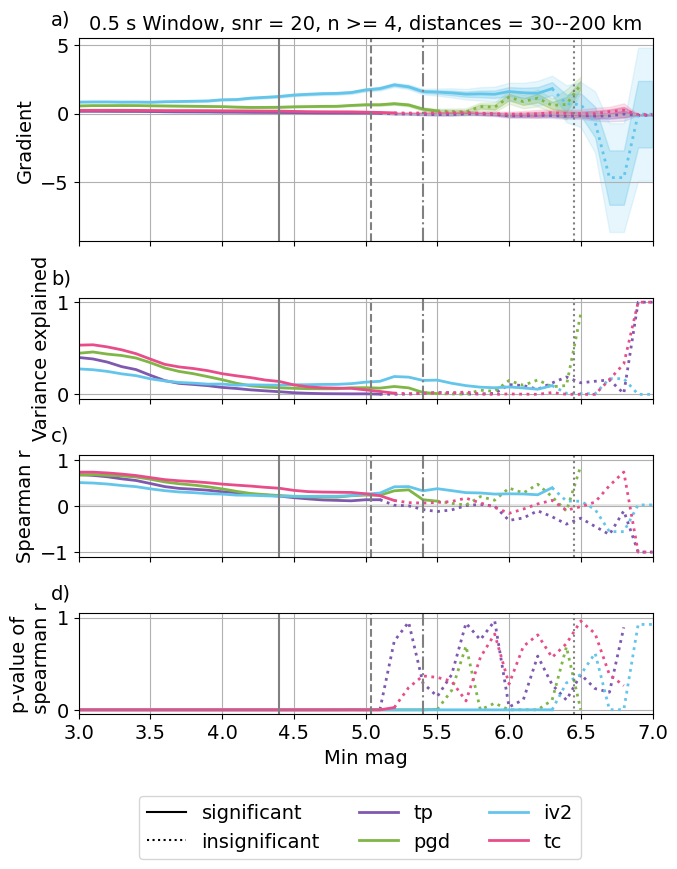

tp 0.6721380321988095
pgd 0.6613895565261941
tc 0.7143313065321728
iv2 0.4976438516940109
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


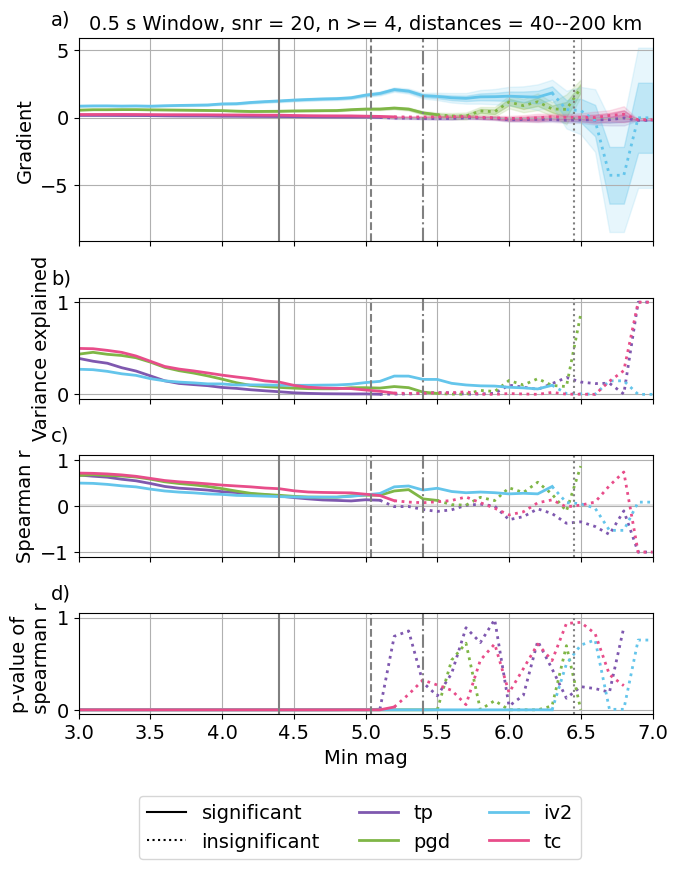

tp 0.6576830741838263
pgd 0.6668290861117541
tc 0.688105971883592
iv2 0.5122165759364716
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


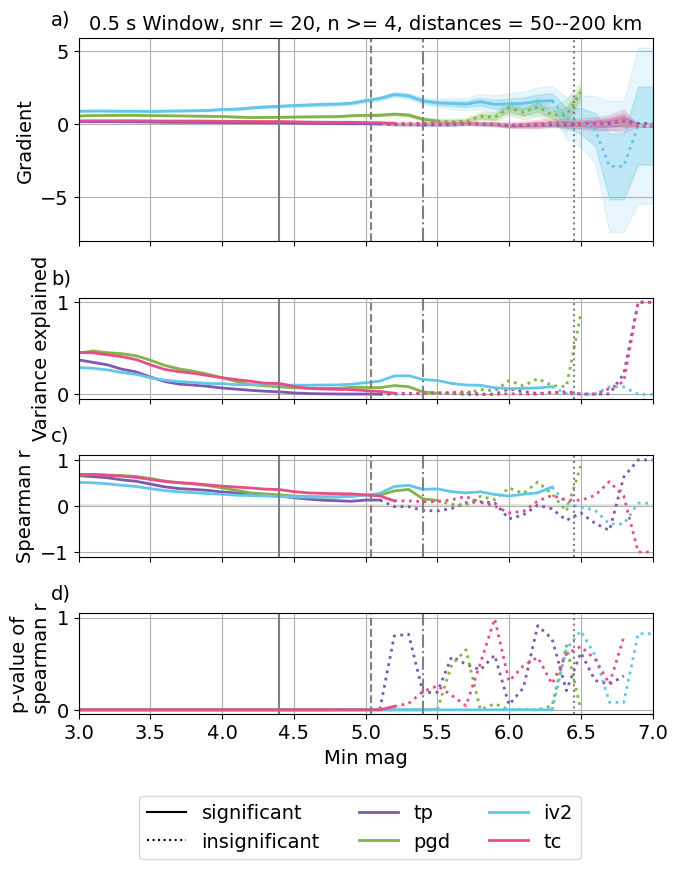

tp 0.6396711087187266
pgd 0.6666184383538907
tc 0.6437530413536446
iv2 0.5348007588878476
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


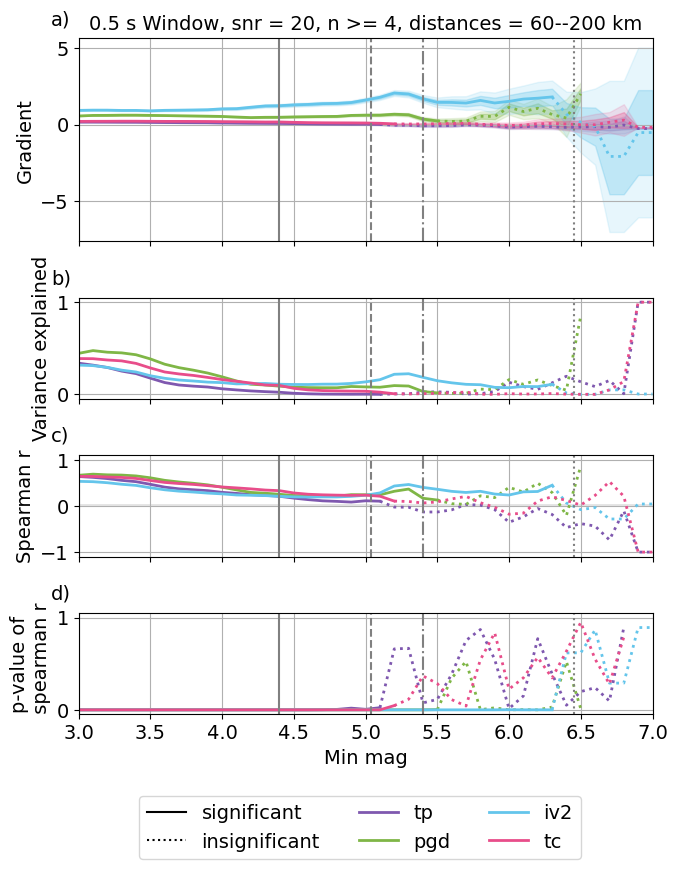

tp 0.6288271818327111
pgd 0.6707956314244605
tc 0.5881903418227225
iv2 0.5707622908450893
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


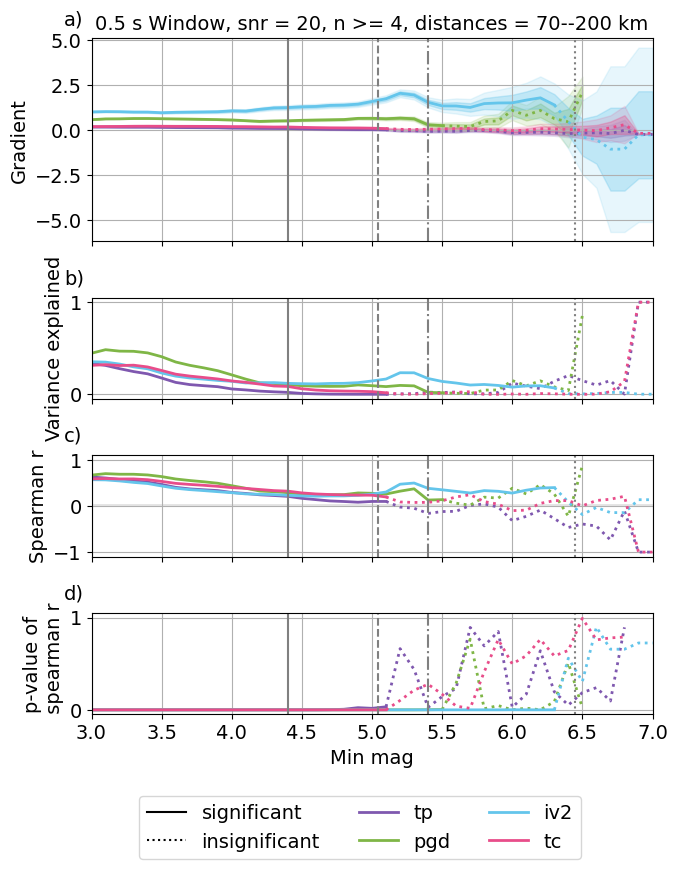

tp 0.5925747011523523
pgd 0.6641536423603888
tc 0.49994560623509904
iv2 0.6027653864615884
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


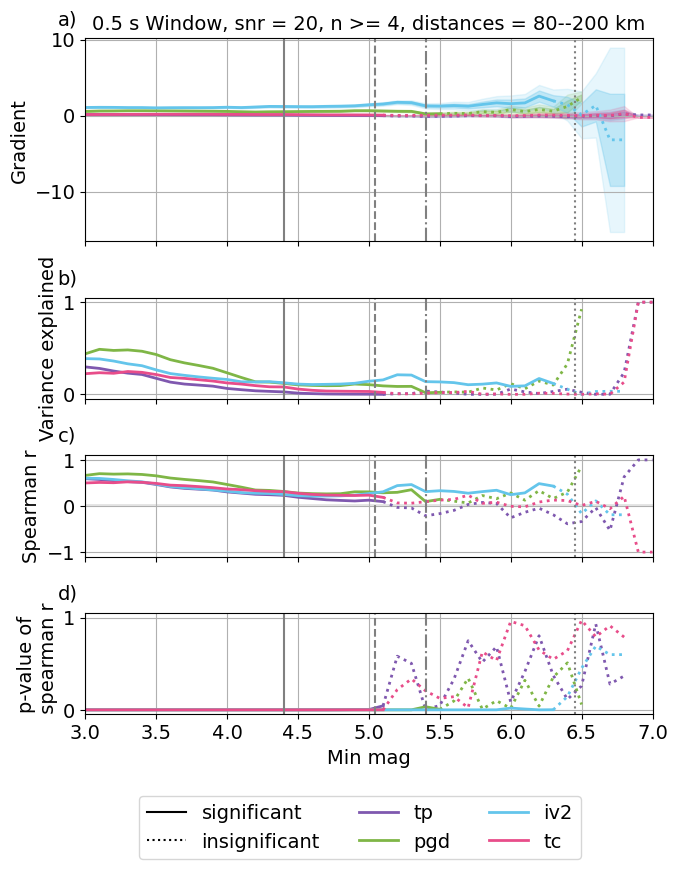

tp 0.5623219272720857
pgd 0.643557482073757
tc 0.414153429282858
iv2 0.6045665332690372
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


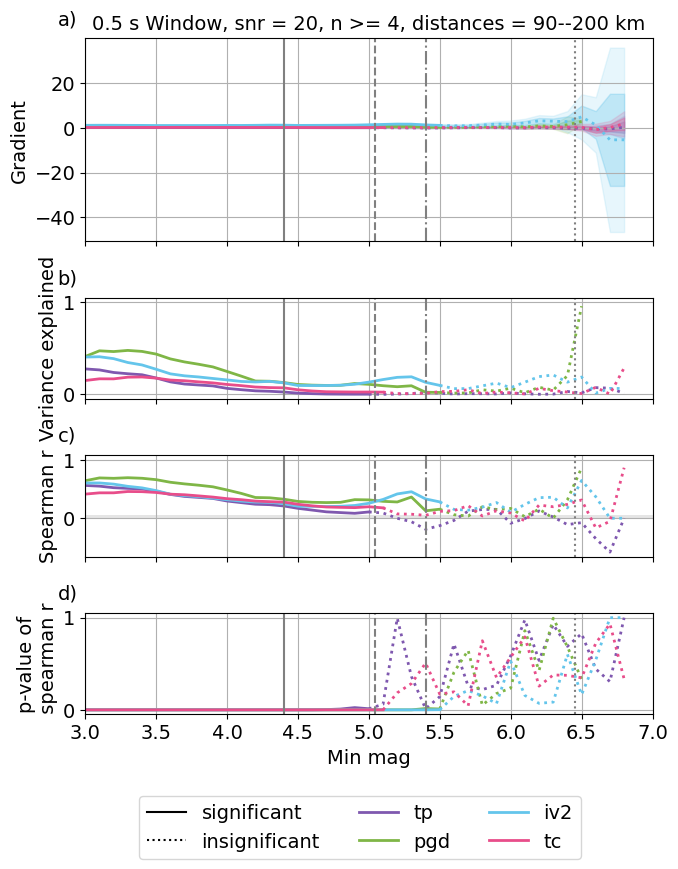

tp 0.7367758647780875
pgd 0.6860524945822111
tc 0.8006152429466552
iv2 0.5293073156037617
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


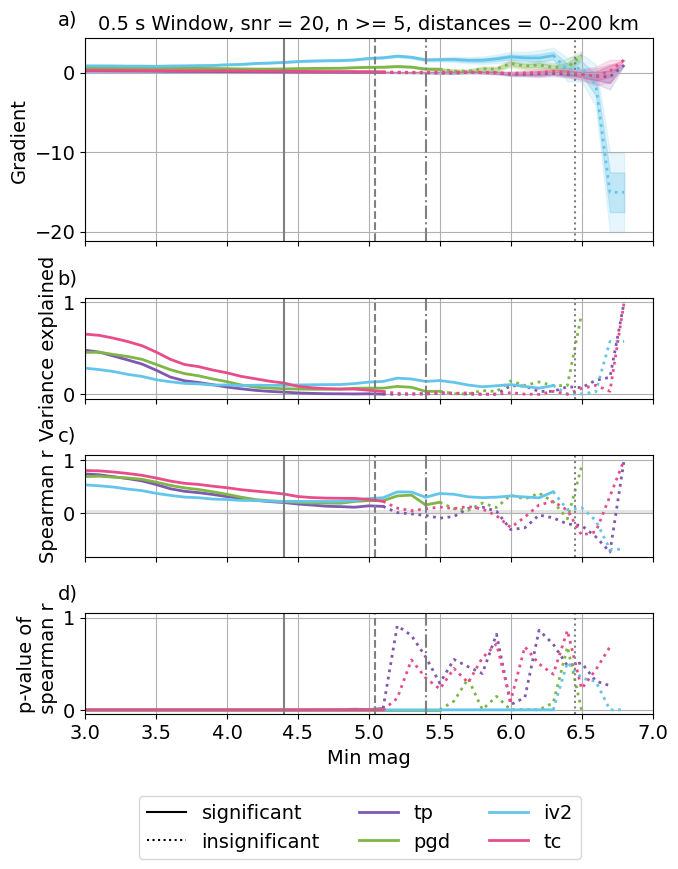

tp 0.7352882929778529
pgd 0.6831579320327376
tc 0.791323892619339
iv2 0.5270434551418504
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


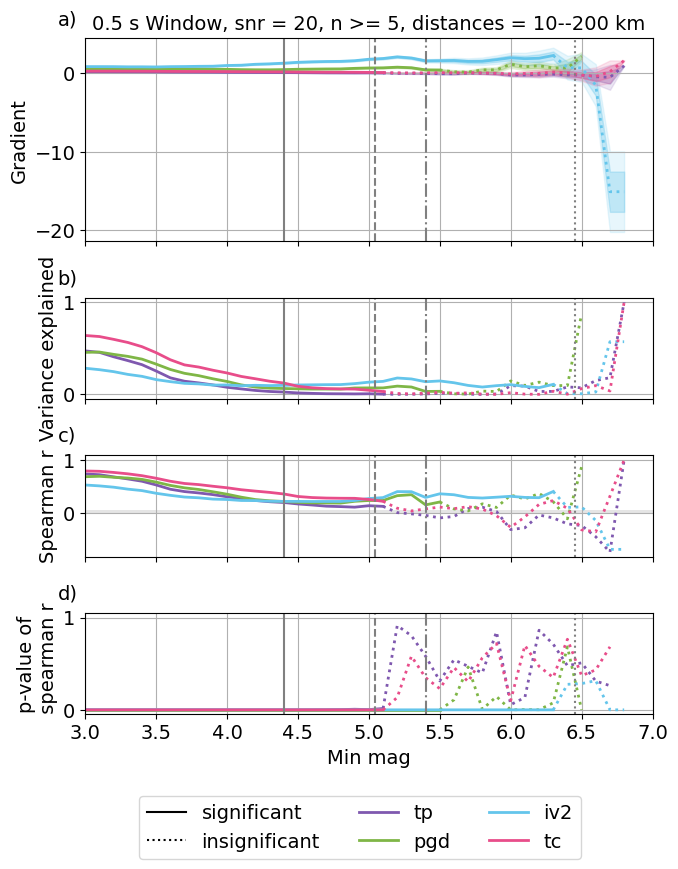

tp 0.7194869113417757
pgd 0.675262057200001
tc 0.7783021922532497
iv2 0.5213401289242896
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


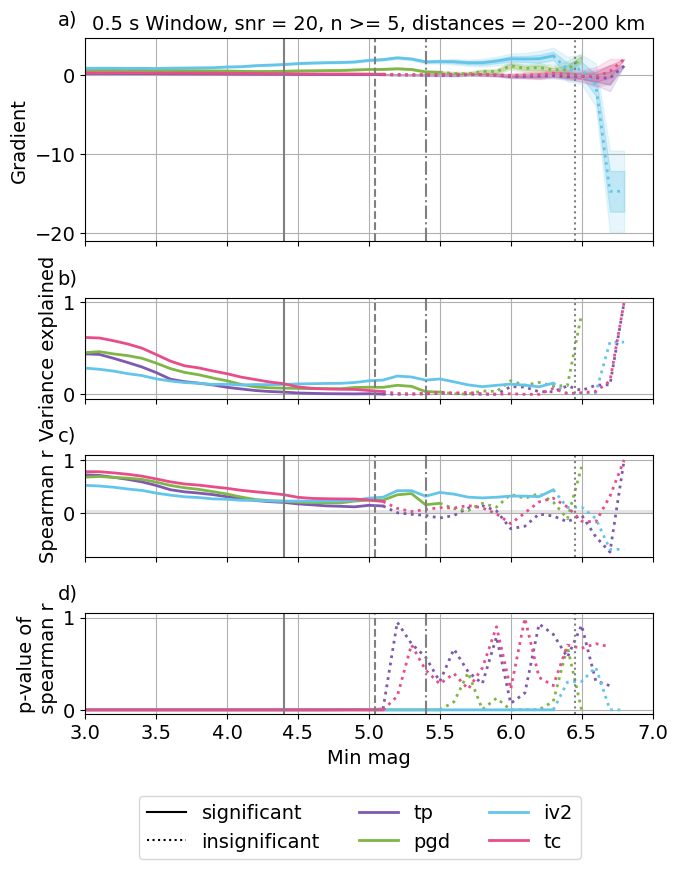

tp 0.7080807919727984
pgd 0.6679713555314483
tc 0.7560672744977641
iv2 0.5074940482302222
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


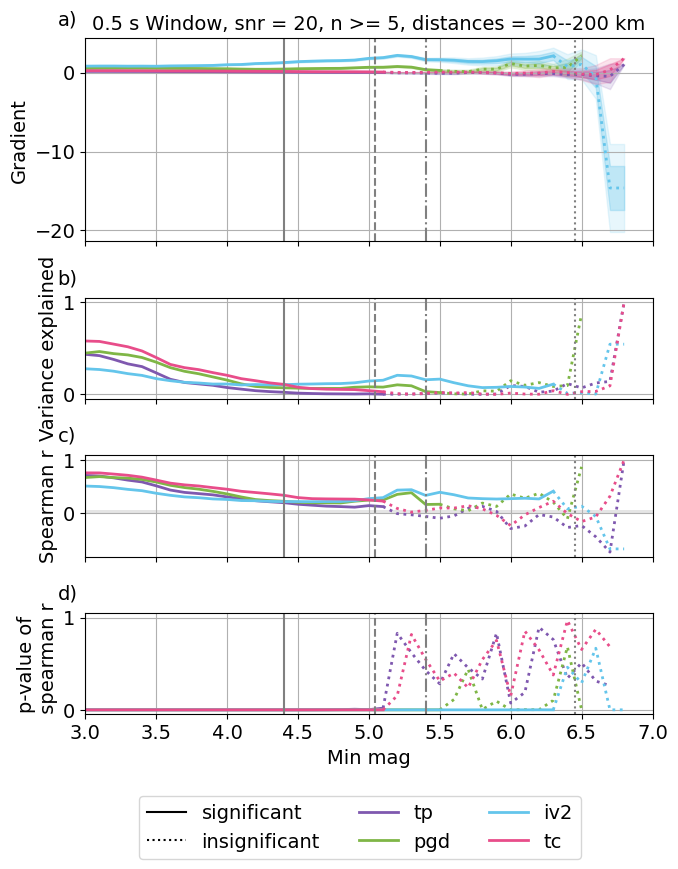

tp 0.6984402830860467
pgd 0.661389083639402
tc 0.7324408455403312
iv2 0.49756940923315773
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


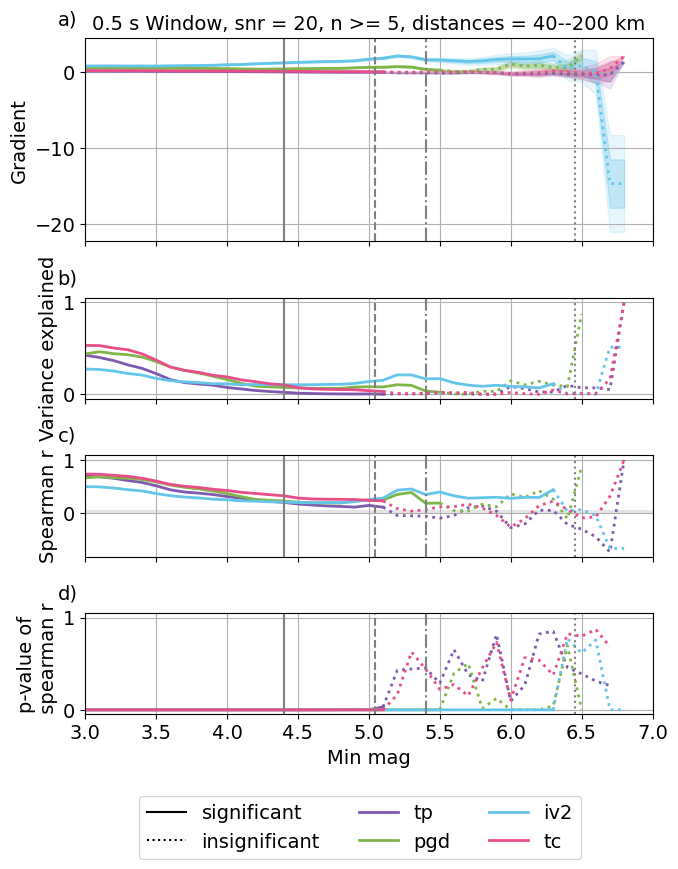

tp 0.686256353165719
pgd 0.6679189532655012
tc 0.7113373438375533
iv2 0.5138531005002924
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


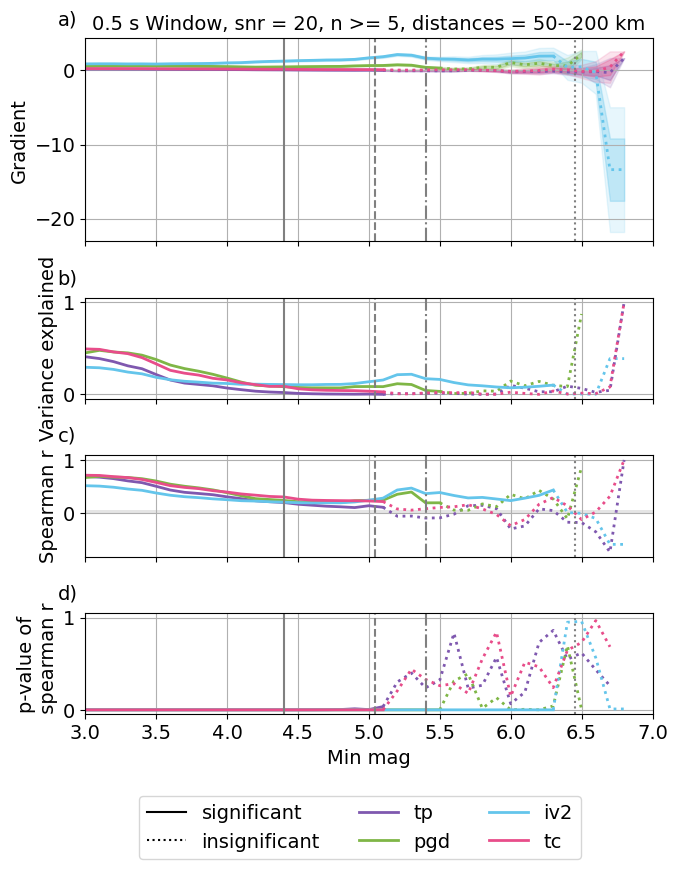

tp 0.6666625506479226
pgd 0.6678867573787023
tc 0.6683726425140384
iv2 0.536275591710394
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


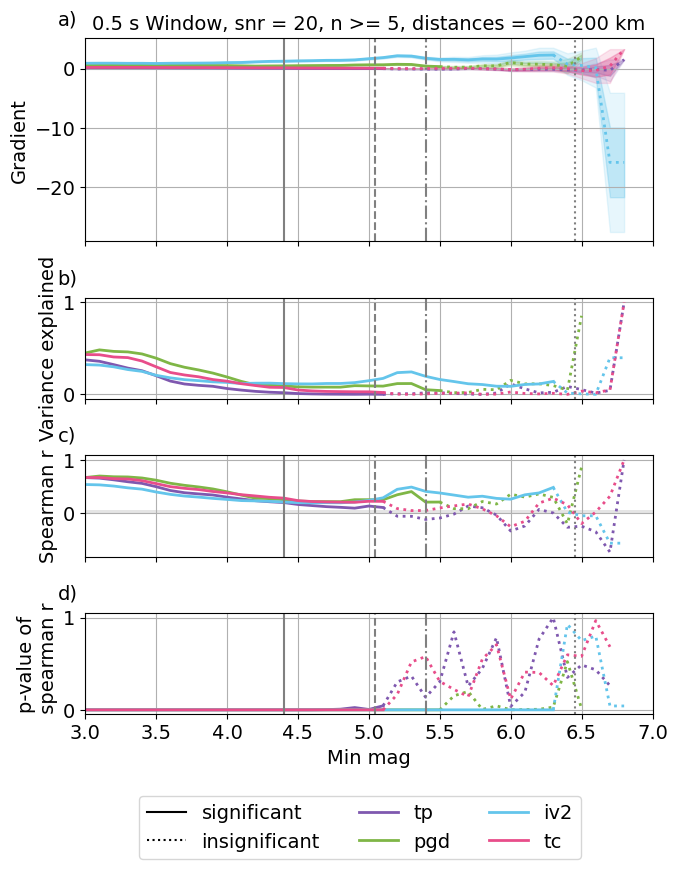

tp 0.650042414439971
pgd 0.6704103495296486
tc 0.6098785767258658
iv2 0.5737613737593519
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


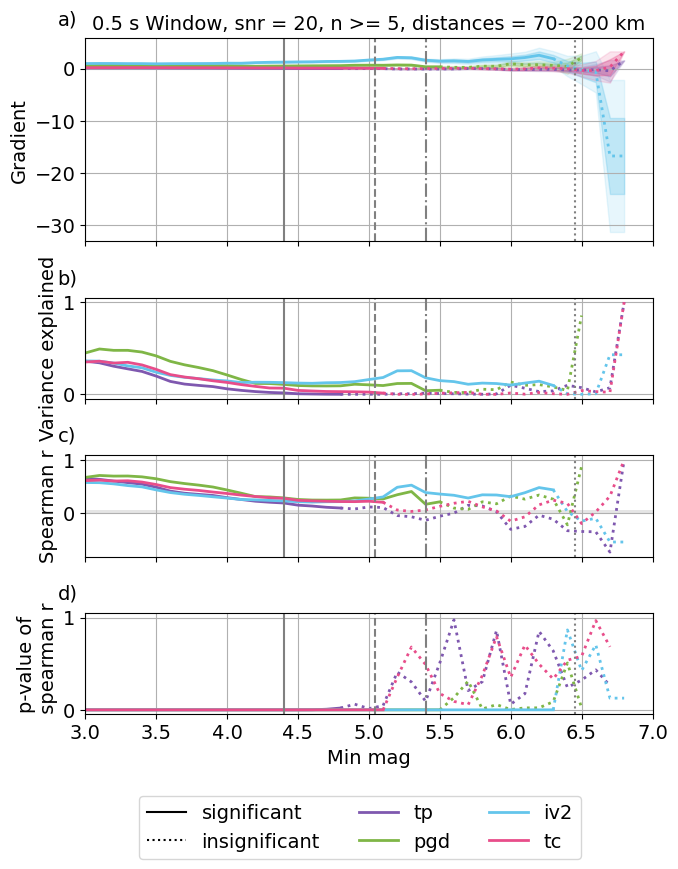

tp 0.6093410799862111
pgd 0.6645973851137965
tc 0.5070834295898785
iv2 0.6140832220970703
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


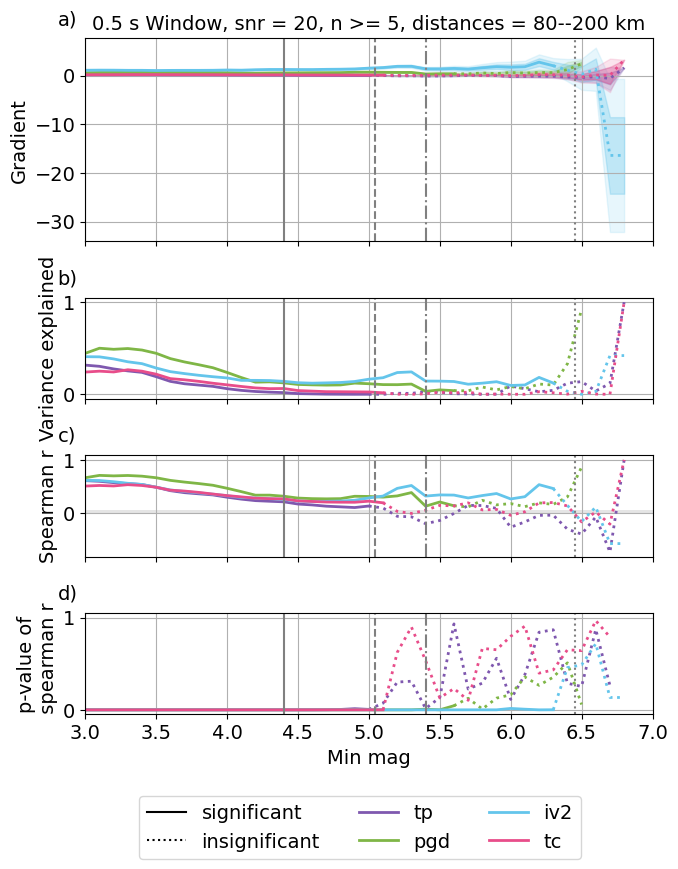

tp 0.5822047704328708
pgd 0.643715747007613
tc 0.41547019062677487
iv2 0.6214132088702792
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


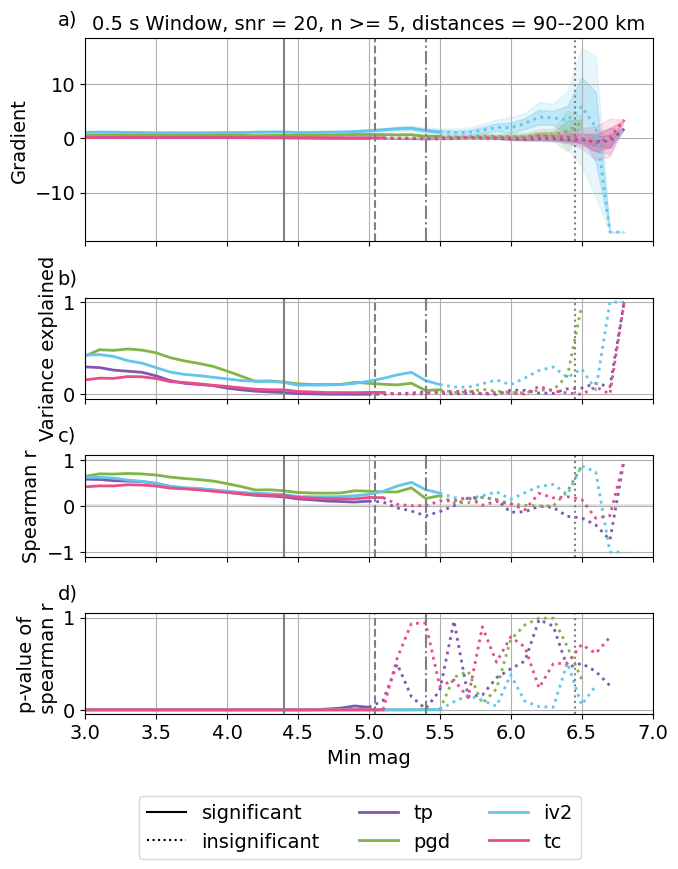

tp 0.756865310944757
pgd 0.6798531008419205
tc 0.8148024099284212
iv2 0.5231427280460722
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


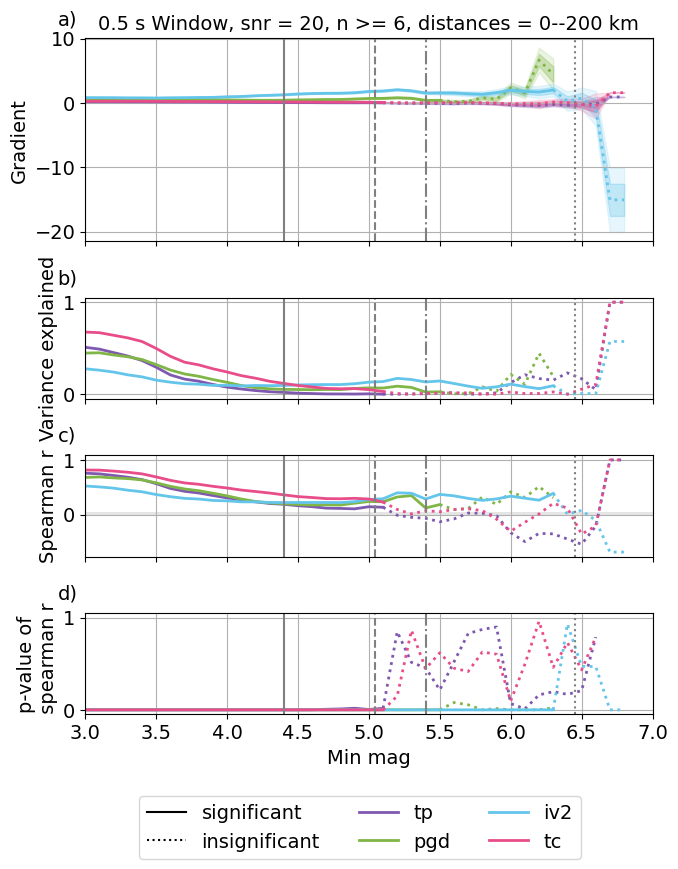

tp 0.7555600821250252
pgd 0.6768940512862921
tc 0.8048975161097773
iv2 0.5212474661415769
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


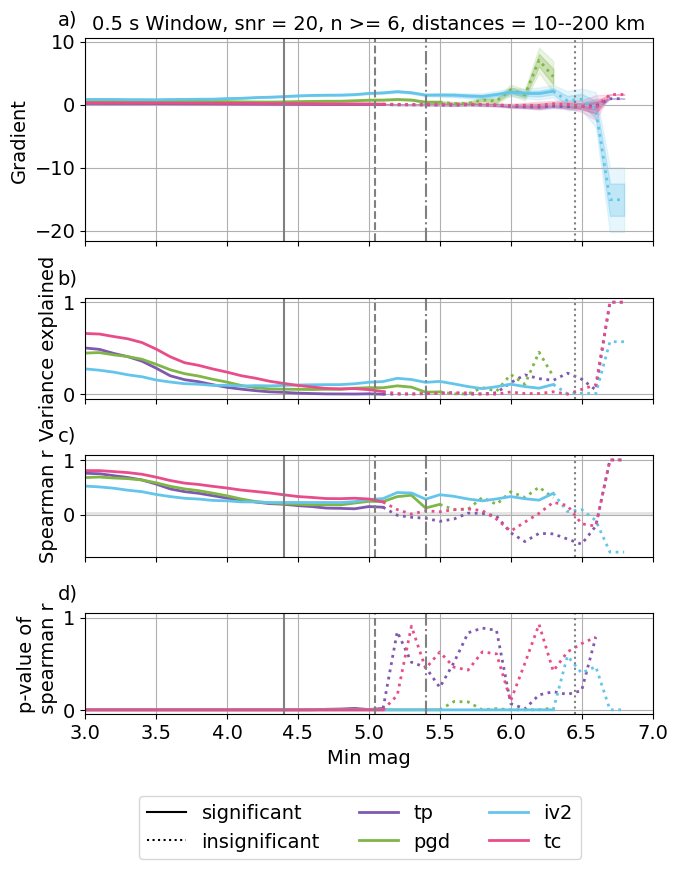

tp 0.7378923994020111
pgd 0.66886235653328
tc 0.7949084856309973
iv2 0.5151180244414654
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


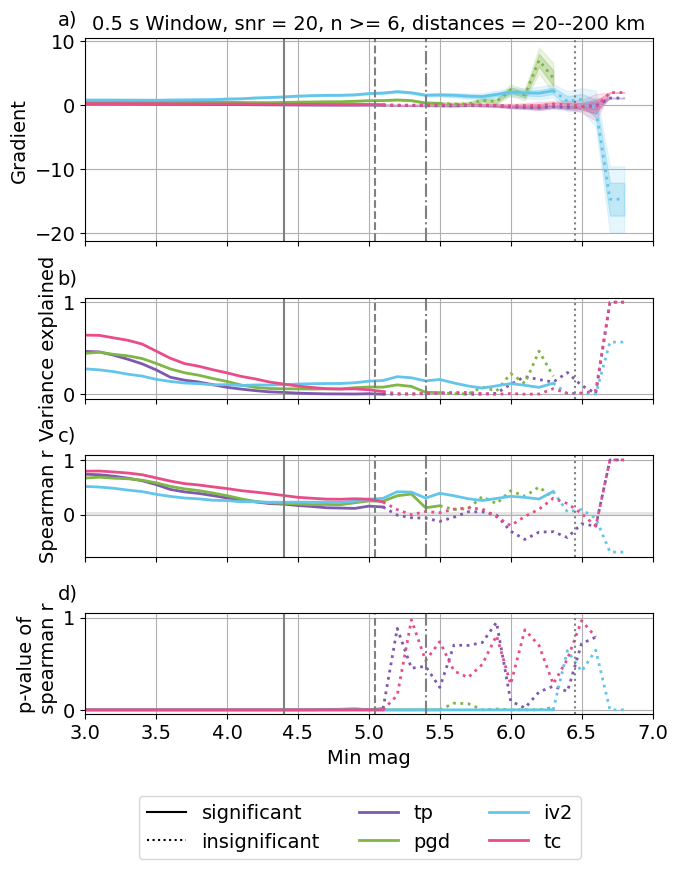

tp 0.7334815619859891
pgd 0.66282860994079
tc 0.7826277859734424
iv2 0.5020752235248561
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


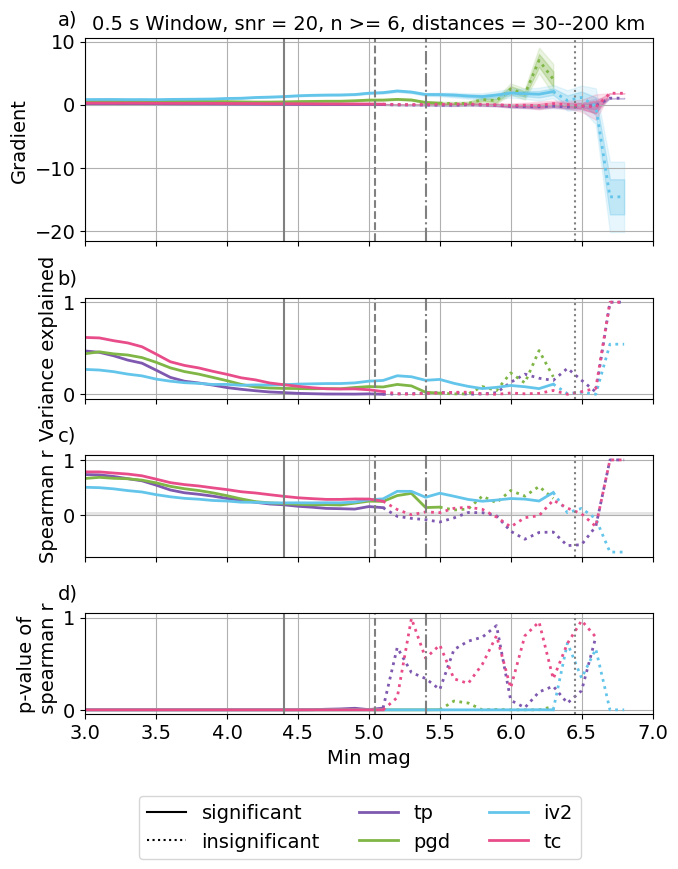

tp 0.7248335939129499
pgd 0.6570877494538757
tc 0.7592612739102212
iv2 0.4930646402846114
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


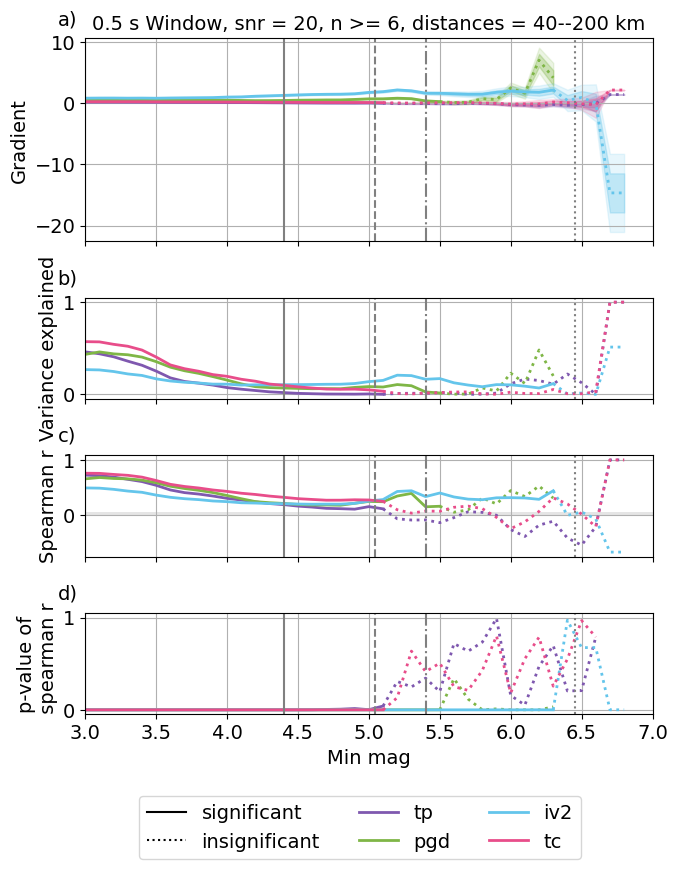

tp 0.7142797418818593
pgd 0.6636116989453285
tc 0.7350081334429284
iv2 0.508734365438319
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


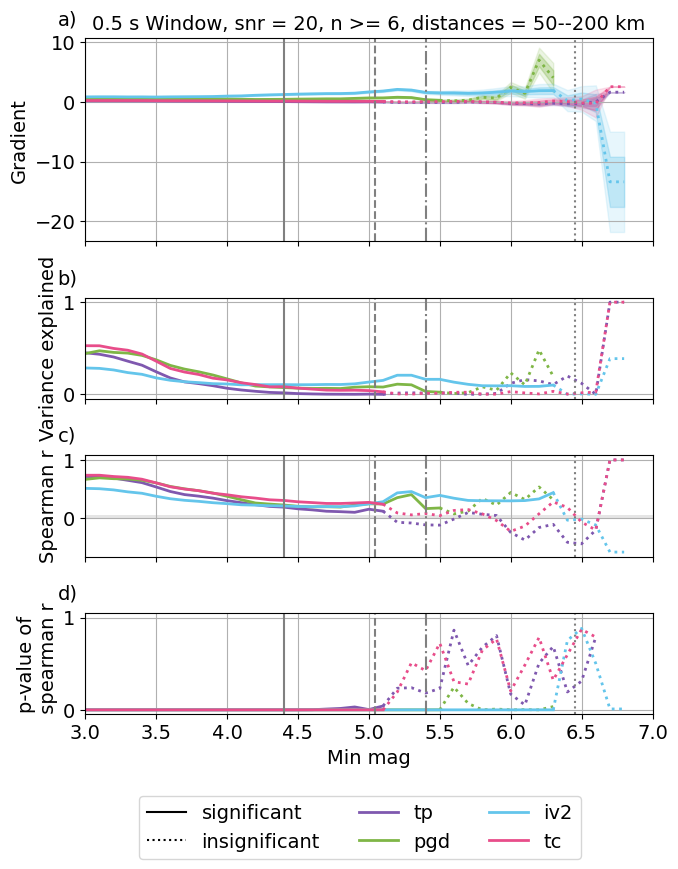

tp 0.6948029053496376
pgd 0.6634341035797907
tc 0.688433301635625
iv2 0.532294532316172
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


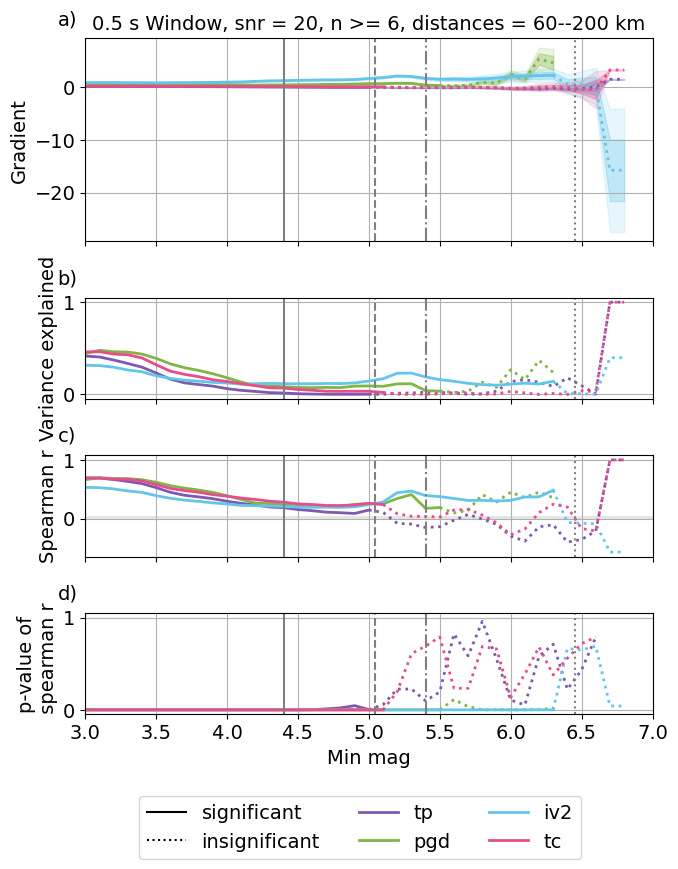

tp 0.6776553588104576
pgd 0.6655735480256368
tc 0.6275984416582848
iv2 0.569494801619513
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


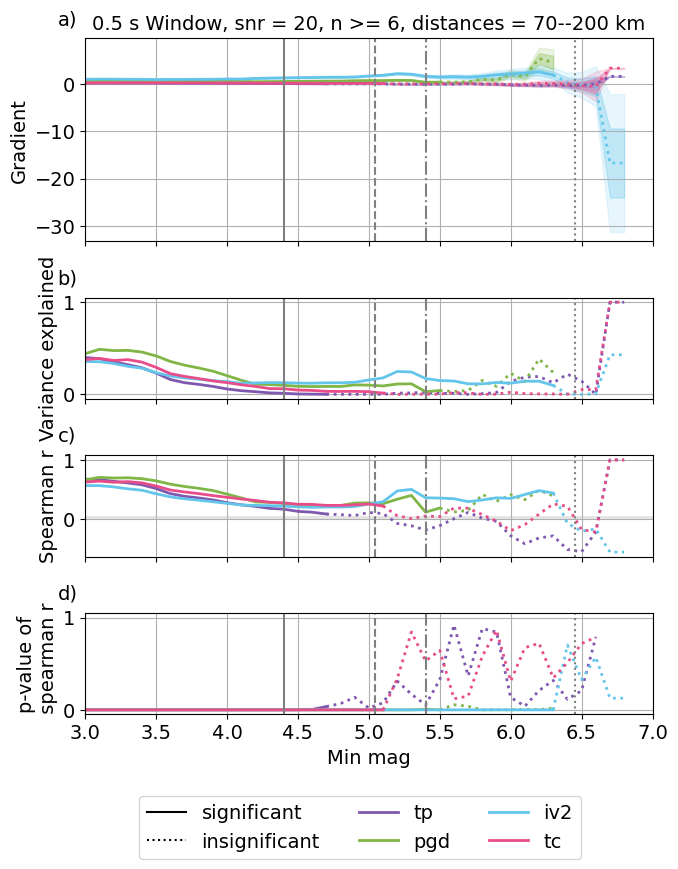

tp 0.6375569729968918
pgd 0.6592708531111483
tc 0.5169860119286886
iv2 0.6149783772644501
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


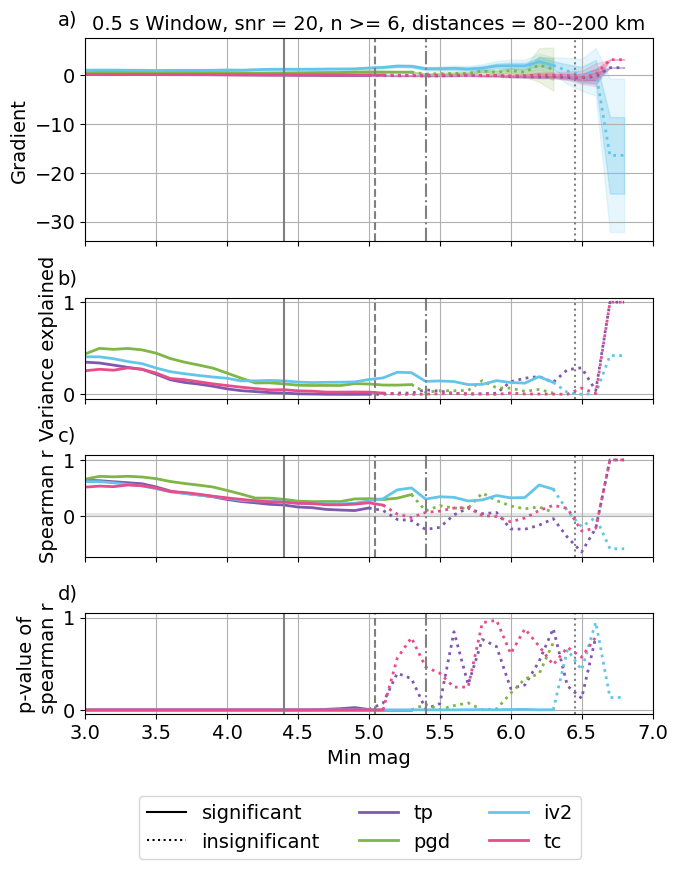

tp 0.6027857567307636
pgd 0.6392805151054566
tc 0.4217454221912447
iv2 0.6274331966944893
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


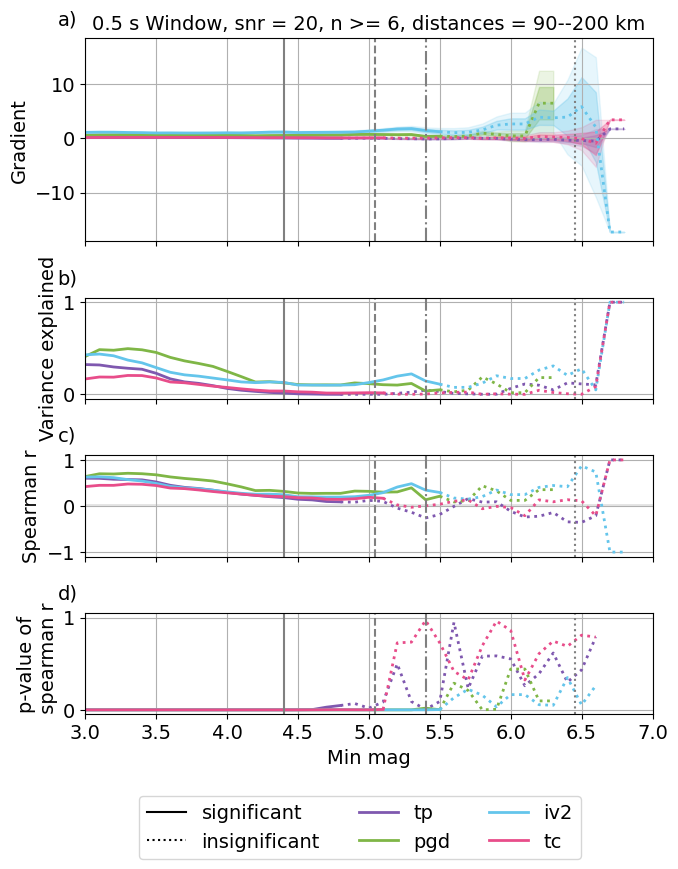

eq_object_1s_bandpass_01_19_snr_20_blank_0_new_snr20
tp 0.5496780154004132
pgd 0.7843421371281877
tc 0.762588141665039
iv2 0.6636591359076717
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


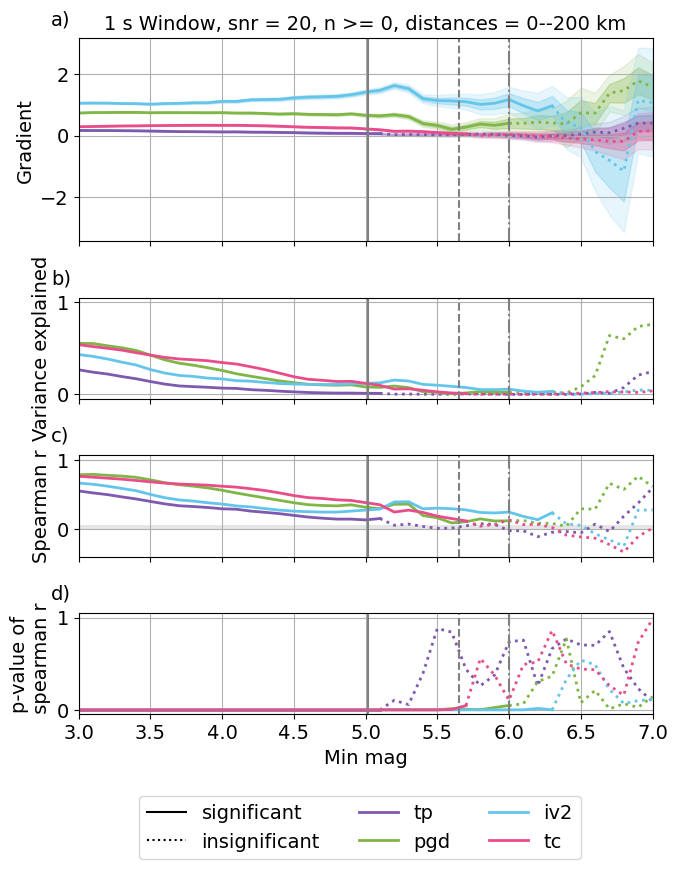

tp 0.5427133111230151
pgd 0.7815531072205659
tc 0.7562816927186967
iv2 0.6610594513622373
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


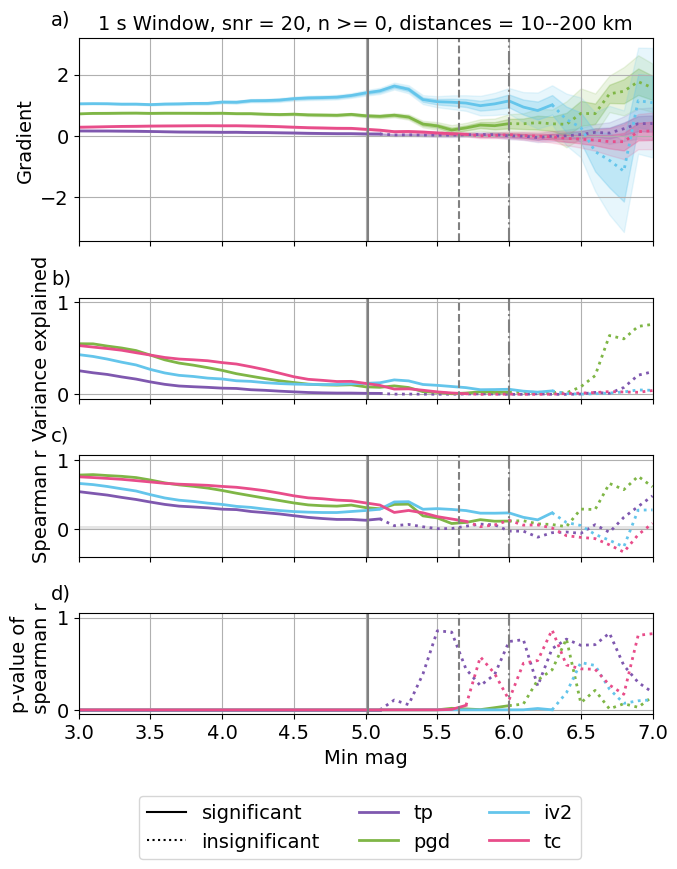

tp 0.5281968288365475
pgd 0.7736454216873317
tc 0.7466355533021141
iv2 0.6474520251440593
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


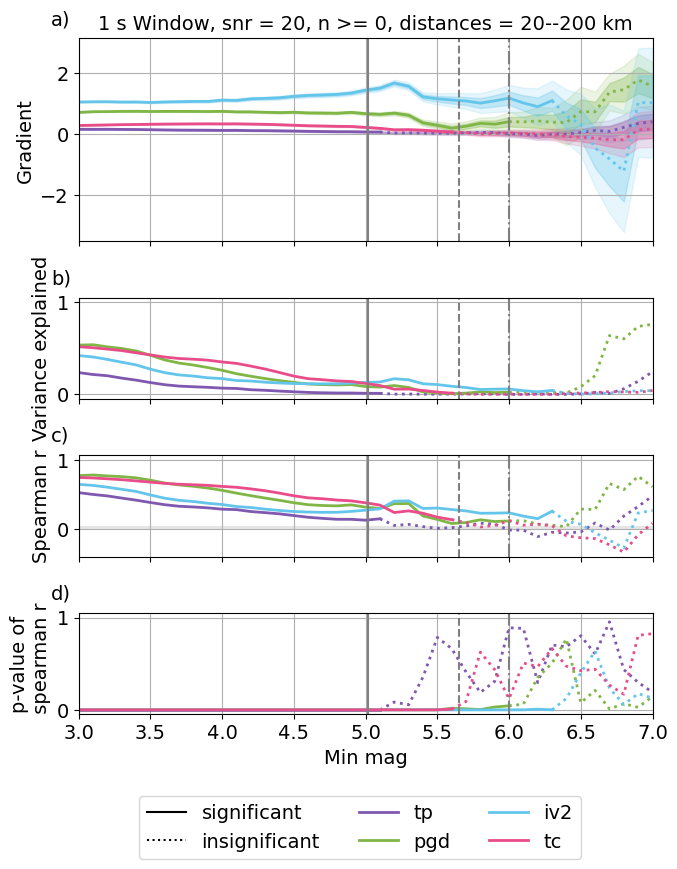

tp 0.5169056208821171
pgd 0.7627166394956099
tc 0.7360261313768585
iv2 0.6242263906596388
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


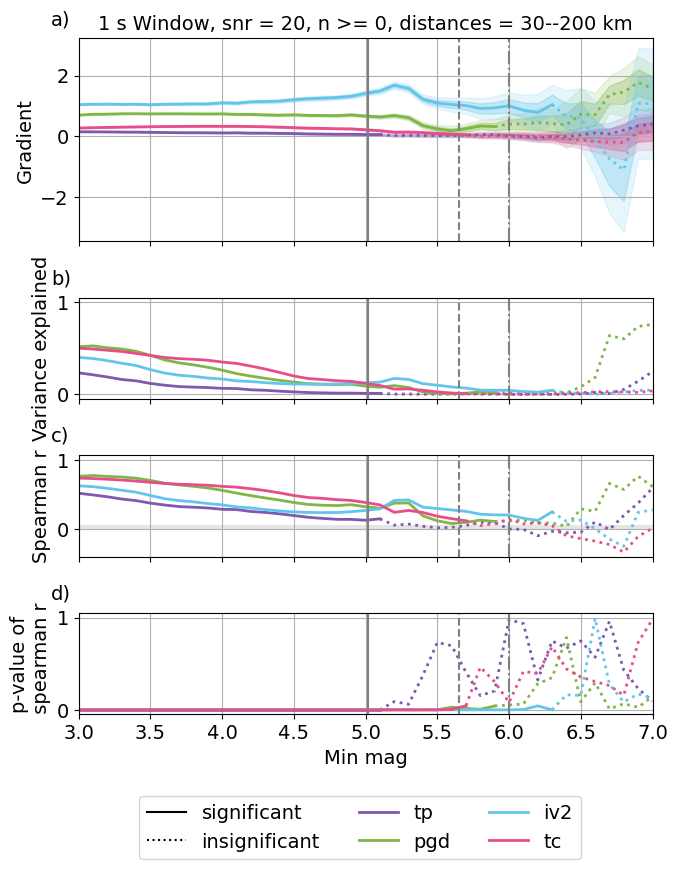

tp 0.5116155456130056
pgd 0.7529130375137443
tc 0.7276883006177441
iv2 0.6055852664423204
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


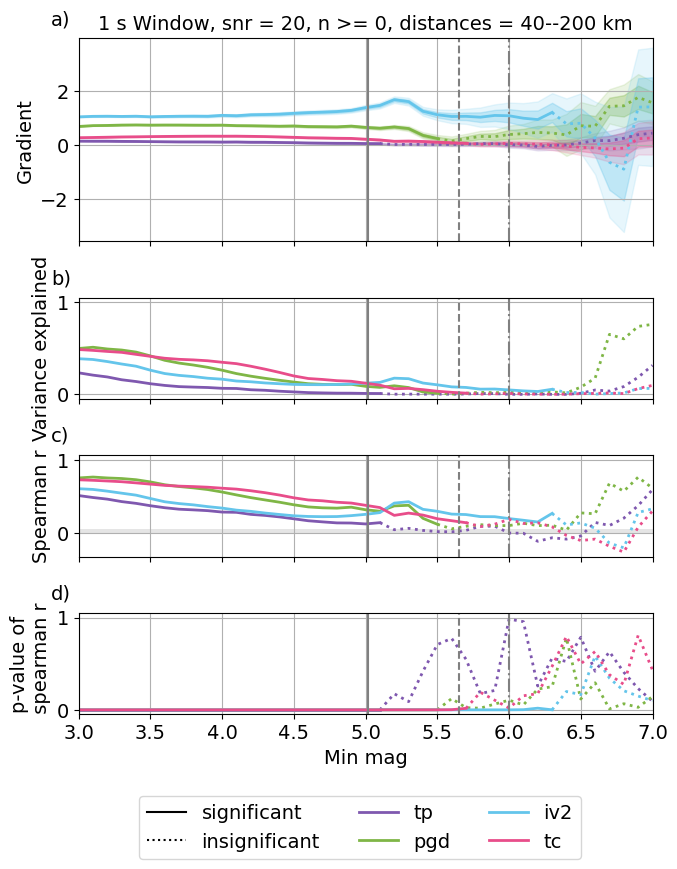

tp 0.4992960912596748
pgd 0.750902053192964
tc 0.7140705369364636
iv2 0.6075178918253333
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


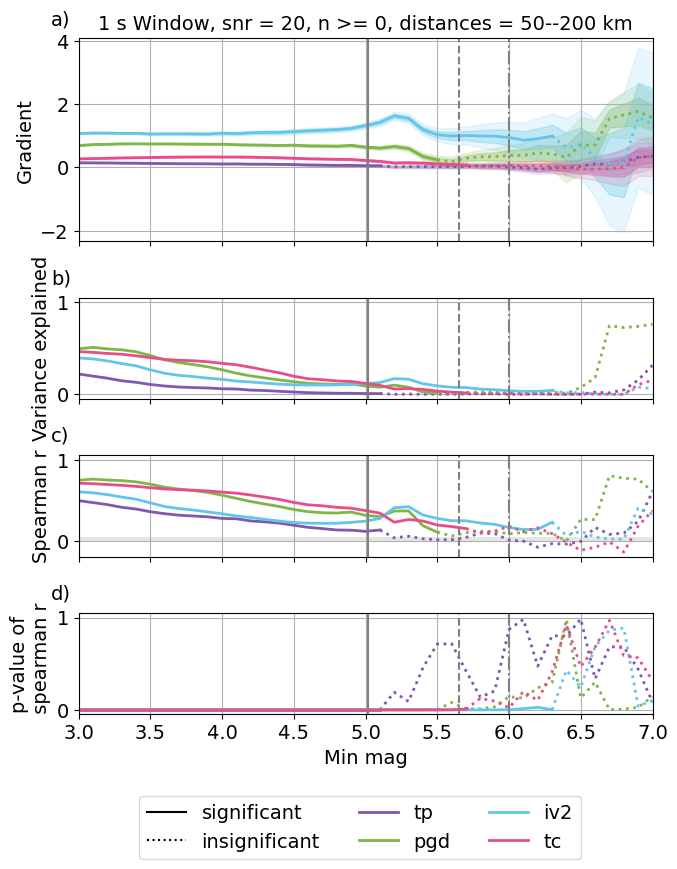

tp 0.488228450241806
pgd 0.7487212854285258
tc 0.6927899594849325
iv2 0.6162893240675861
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


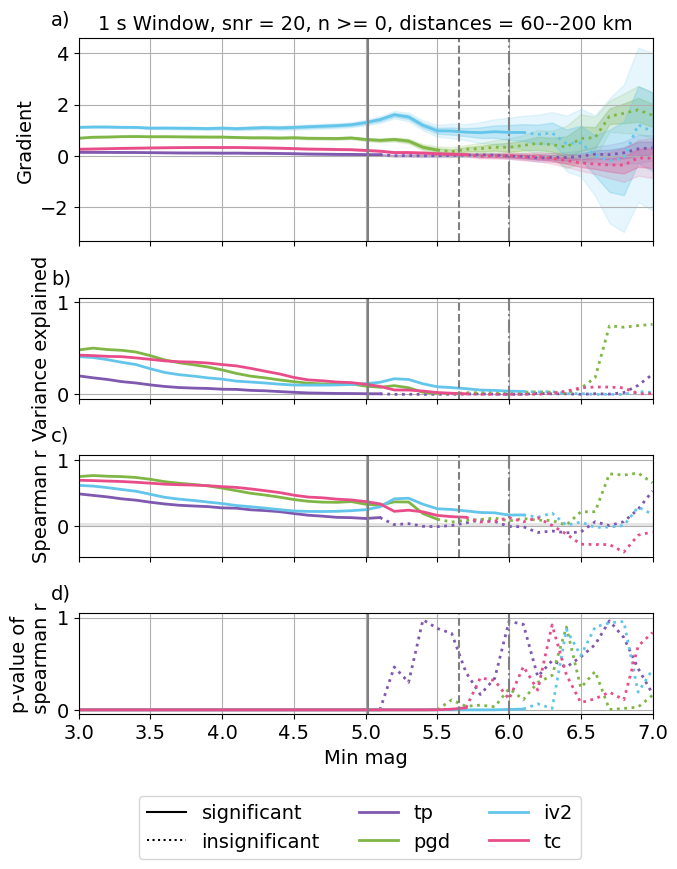

tp 0.4773293144458624
pgd 0.748142211847721
tc 0.6604588366902537
iv2 0.6319559588579112
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


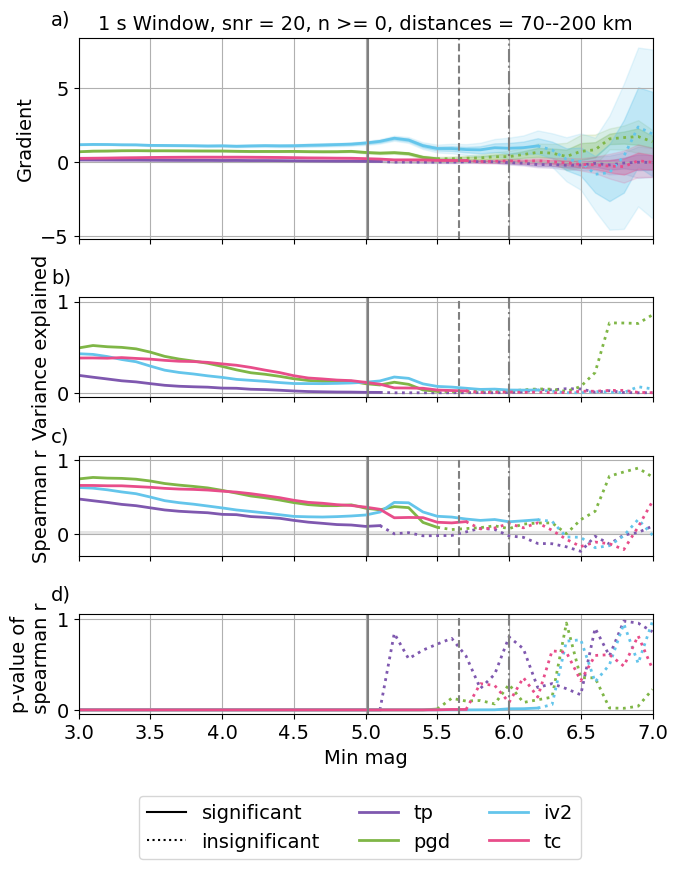

tp 0.4620979863169433
pgd 0.7406220328930815
tc 0.6195912006867225
iv2 0.645050471929609
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


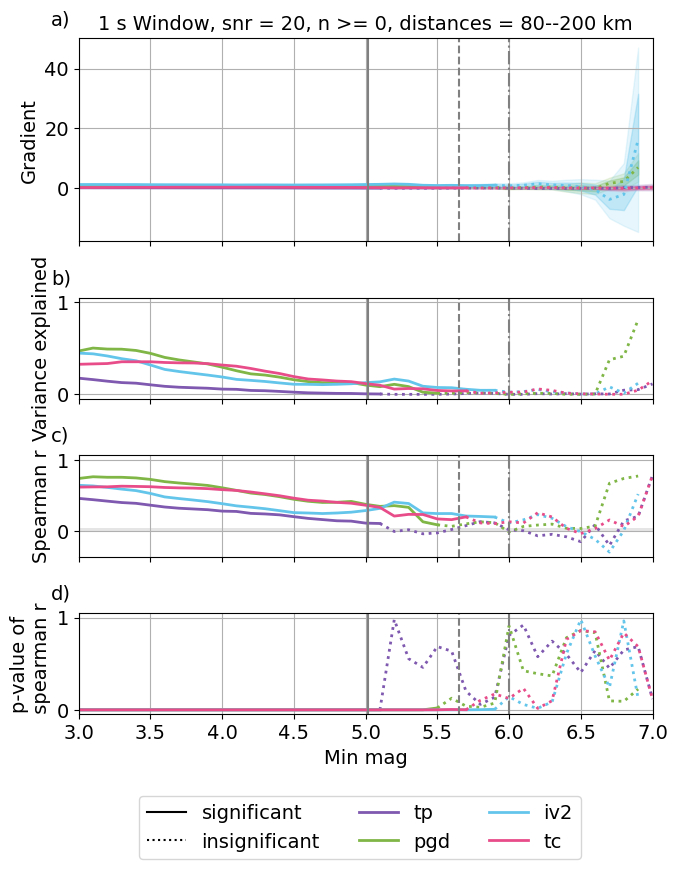

tp 0.43861464813596457
pgd 0.7248890797451294
tc 0.5813324375034576
iv2 0.6358179787817336
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


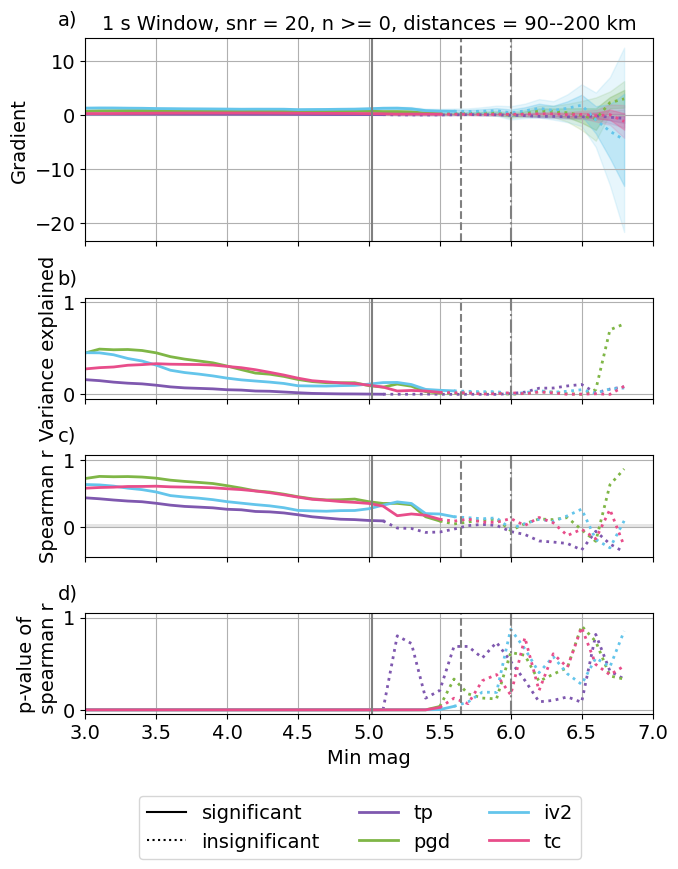

tp 0.5496780154004132
pgd 0.7843421371281877
tc 0.762588141665039
iv2 0.6636591359076717
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


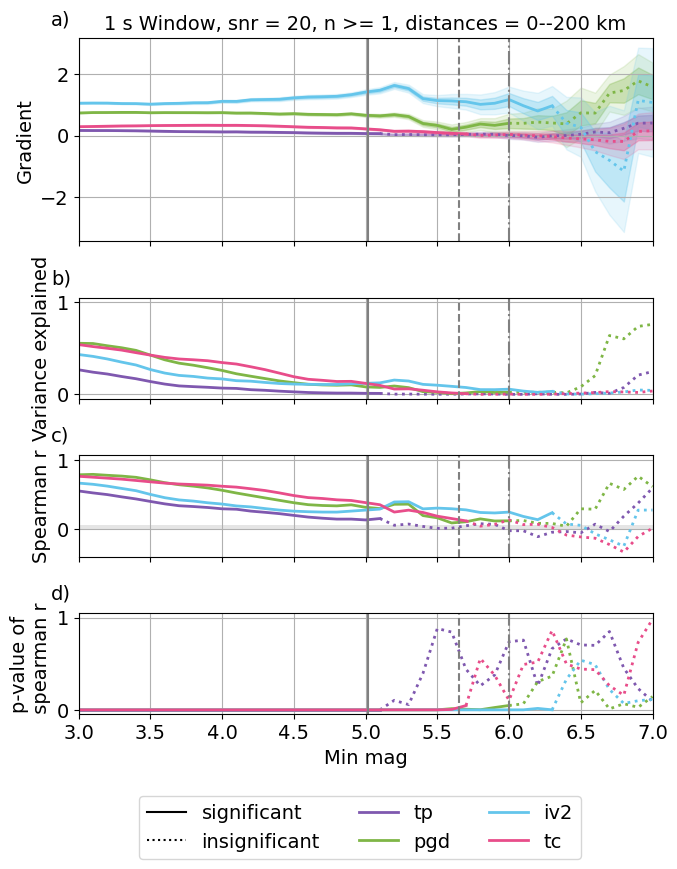

tp 0.5427133111230151
pgd 0.7815531072205659
tc 0.7562816927186967
iv2 0.6610594513622373
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


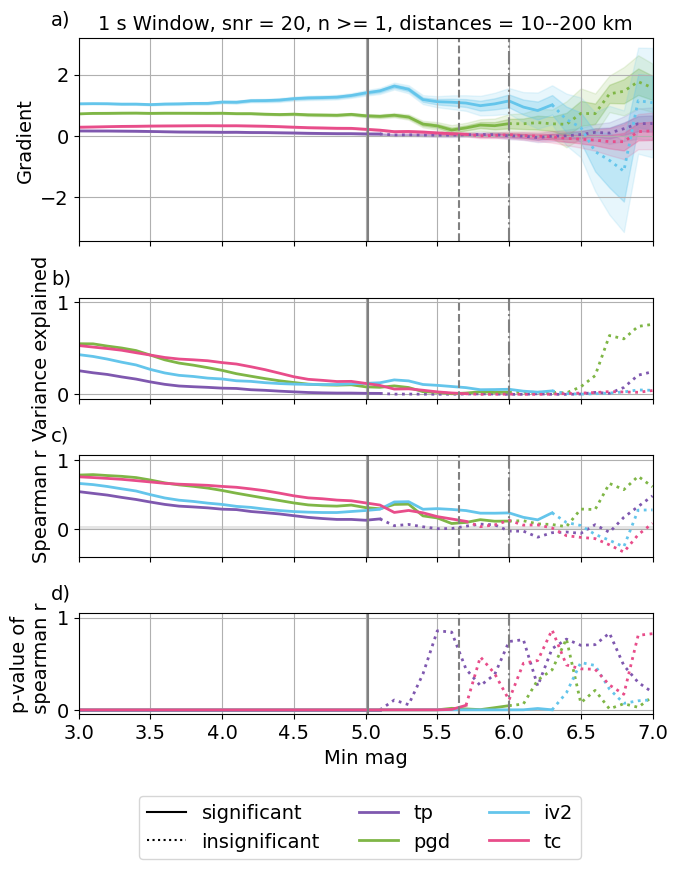

tp 0.5281968288365475
pgd 0.7736454216873317
tc 0.7466355533021141
iv2 0.6474520251440593
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


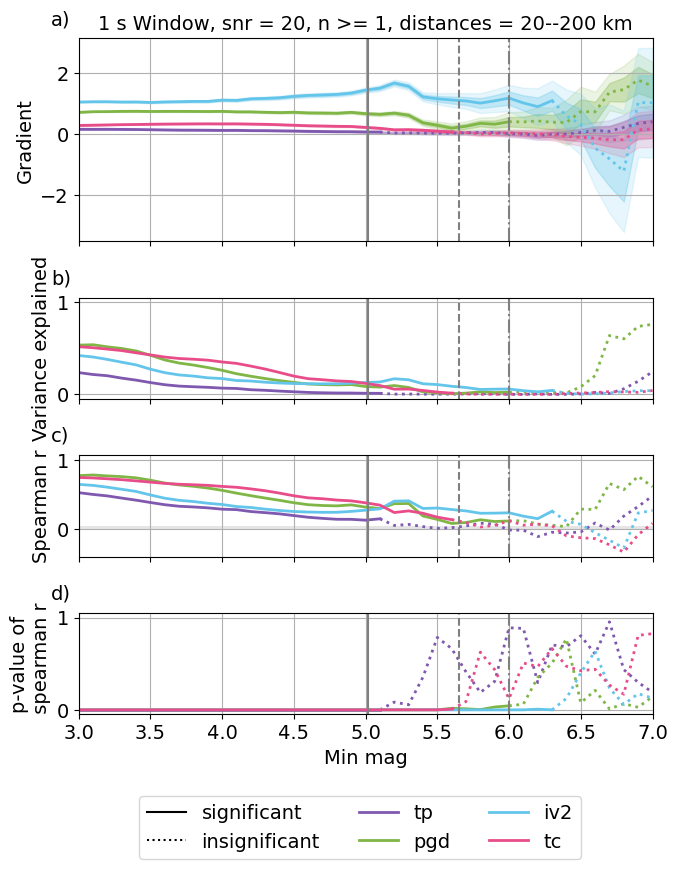

tp 0.5169056208821171
pgd 0.7627166394956099
tc 0.7360261313768585
iv2 0.6242263906596388
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


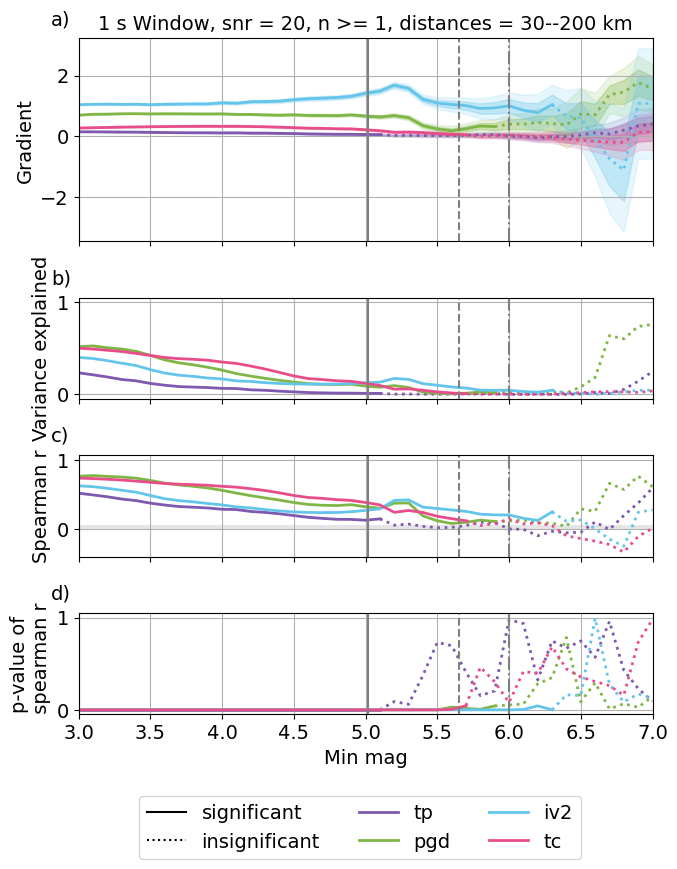

tp 0.5116155456130056
pgd 0.7529130375137443
tc 0.7276883006177441
iv2 0.6055852664423204
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


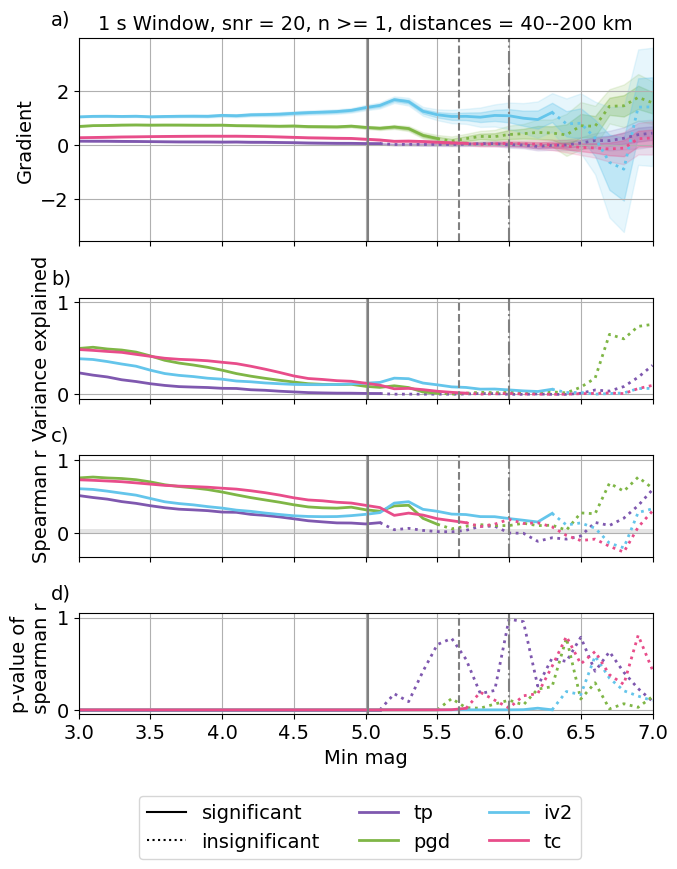

tp 0.4992960912596748
pgd 0.750902053192964
tc 0.7140705369364636
iv2 0.6075178918253333
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


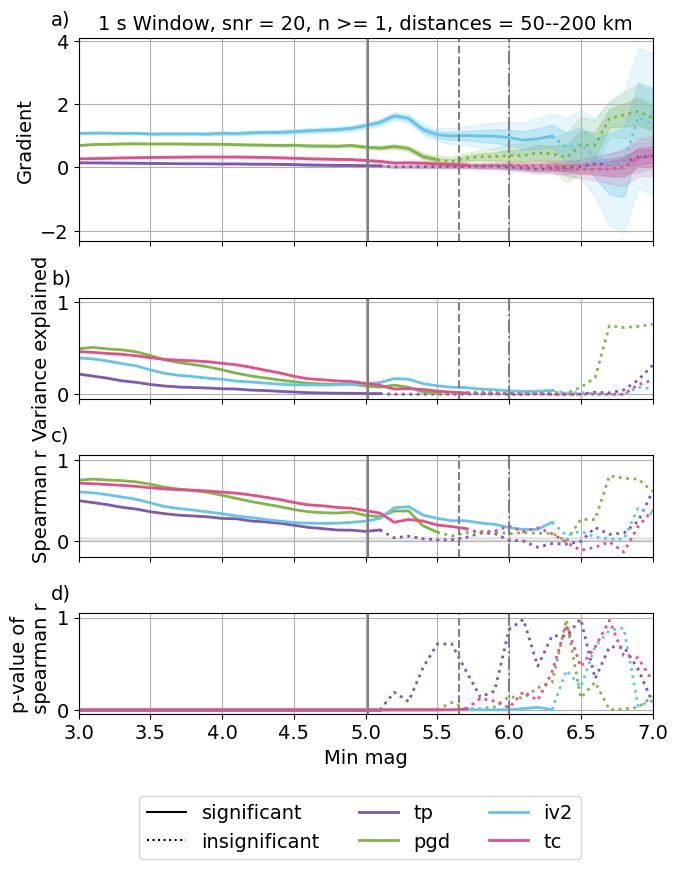

tp 0.488228450241806
pgd 0.7487212854285258
tc 0.6927899594849325
iv2 0.6162893240675861
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


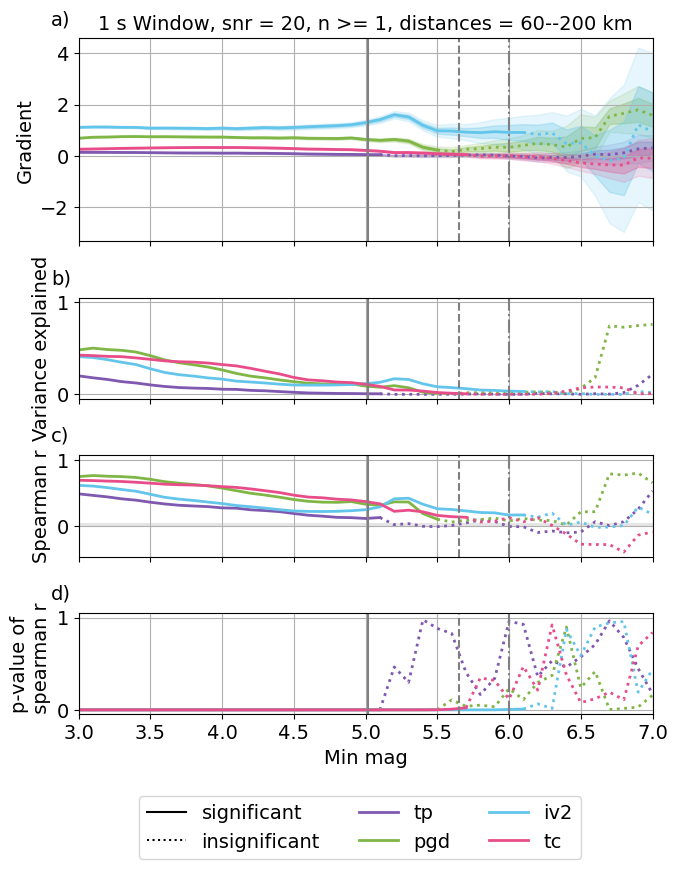

tp 0.4773293144458624
pgd 0.748142211847721
tc 0.6604588366902537
iv2 0.6319559588579112
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


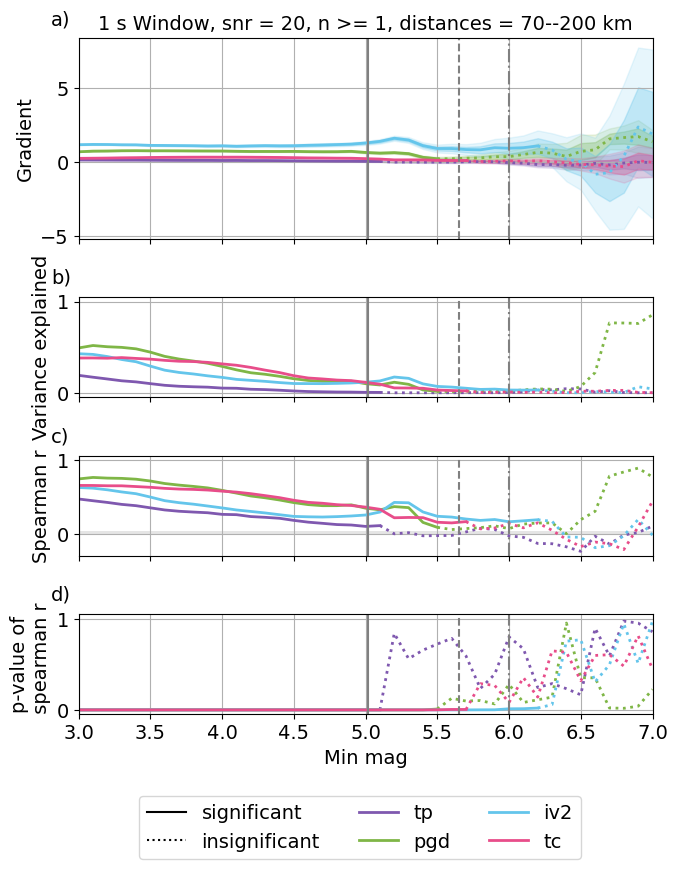

tp 0.4620979863169433
pgd 0.7406220328930815
tc 0.6195912006867225
iv2 0.645050471929609
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


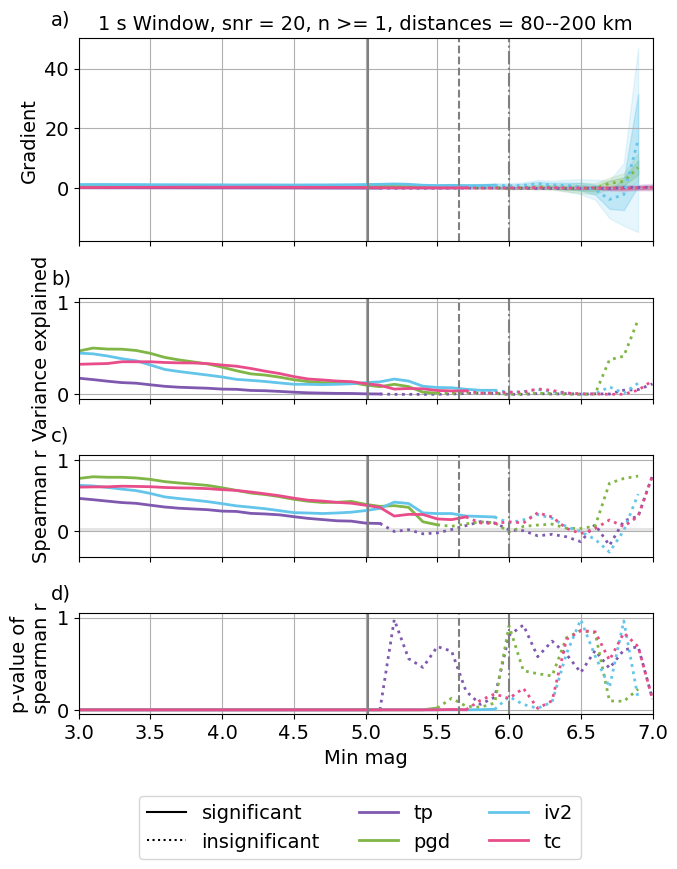

tp 0.43861464813596457
pgd 0.7248890797451294
tc 0.5813324375034576
iv2 0.6358179787817336
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


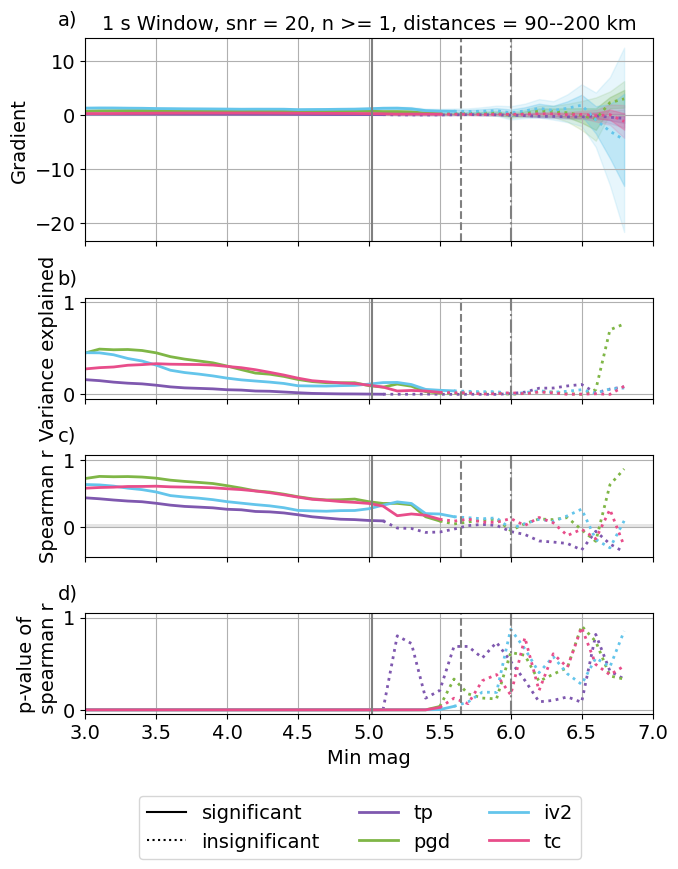

tp 0.6371979710750464
pgd 0.7846381582995257
tc 0.7996087048342366
iv2 0.6654711636637513
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


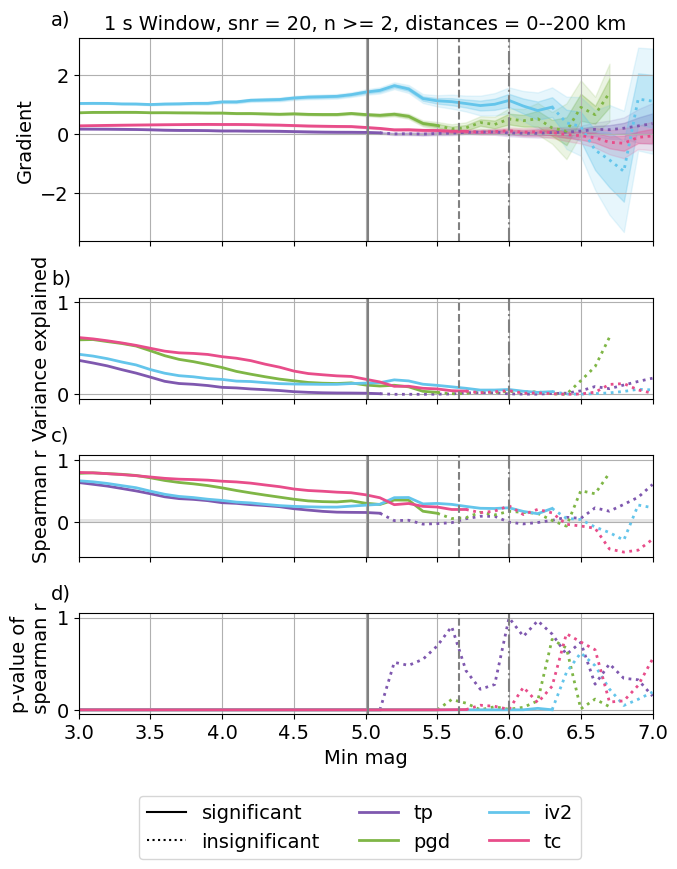

tp 0.631024724605026
pgd 0.782093764146376
tc 0.7910357691448457
iv2 0.6632040725662478
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


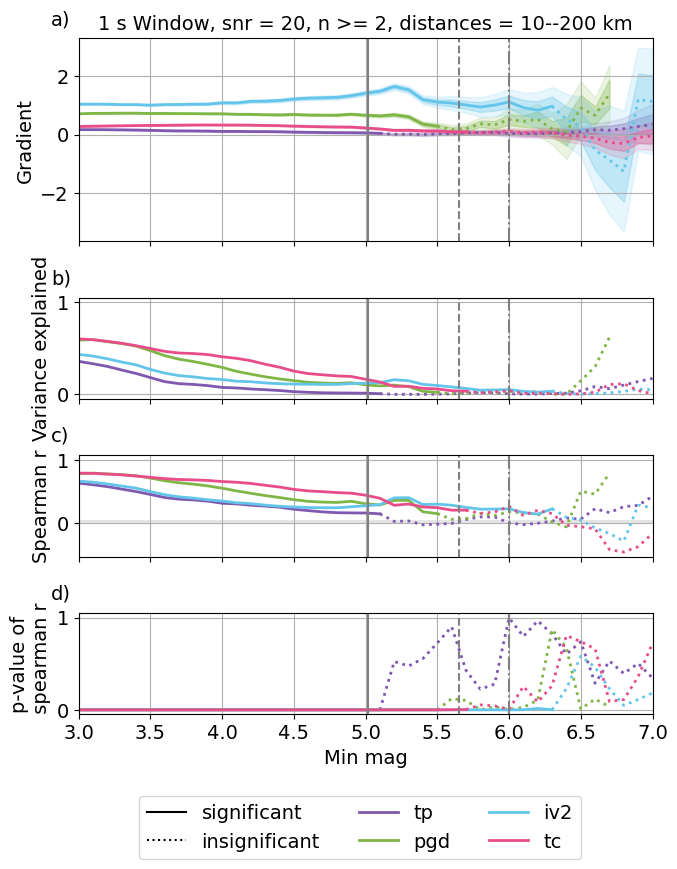

tp 0.6132228374023037
pgd 0.7741062099341737
tc 0.777830633904946
iv2 0.6499850115428207
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


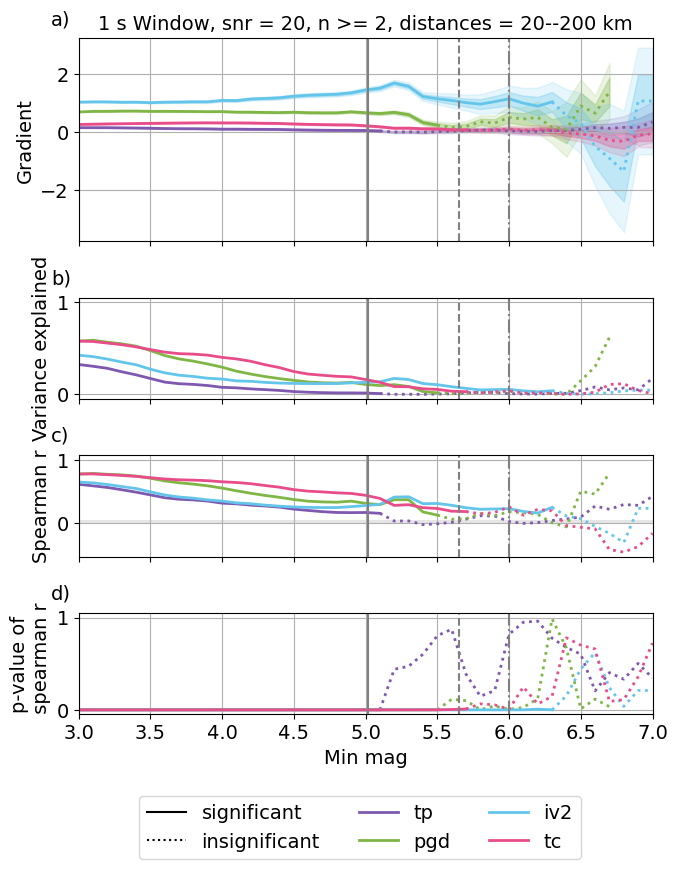

tp 0.5986811818493093
pgd 0.7639691741306918
tc 0.7633384855285066
iv2 0.6267349758539069
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


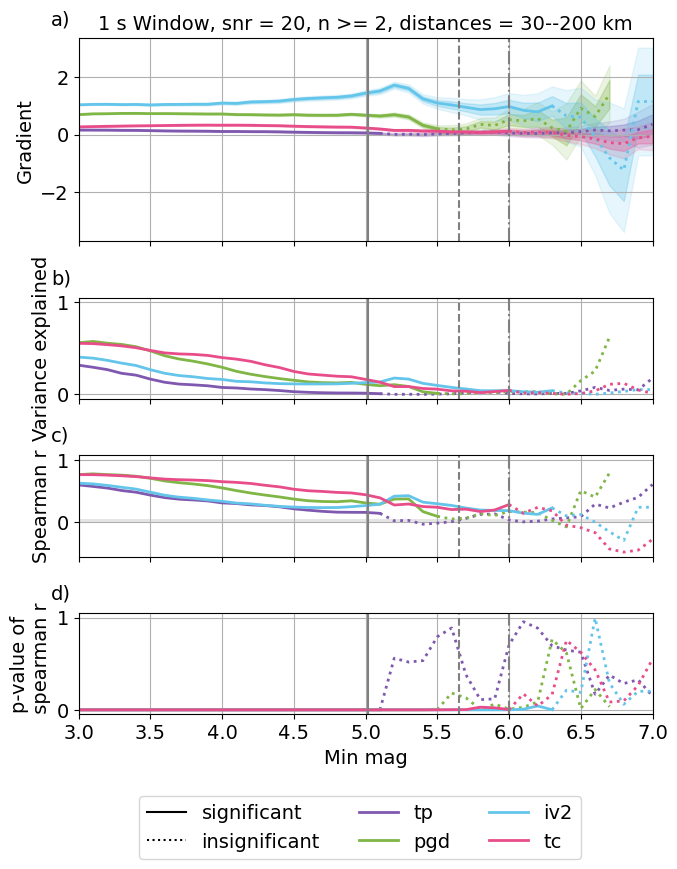

tp 0.592730653016526
pgd 0.7549291476557112
tc 0.7557319106635854
iv2 0.6087268081762182
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


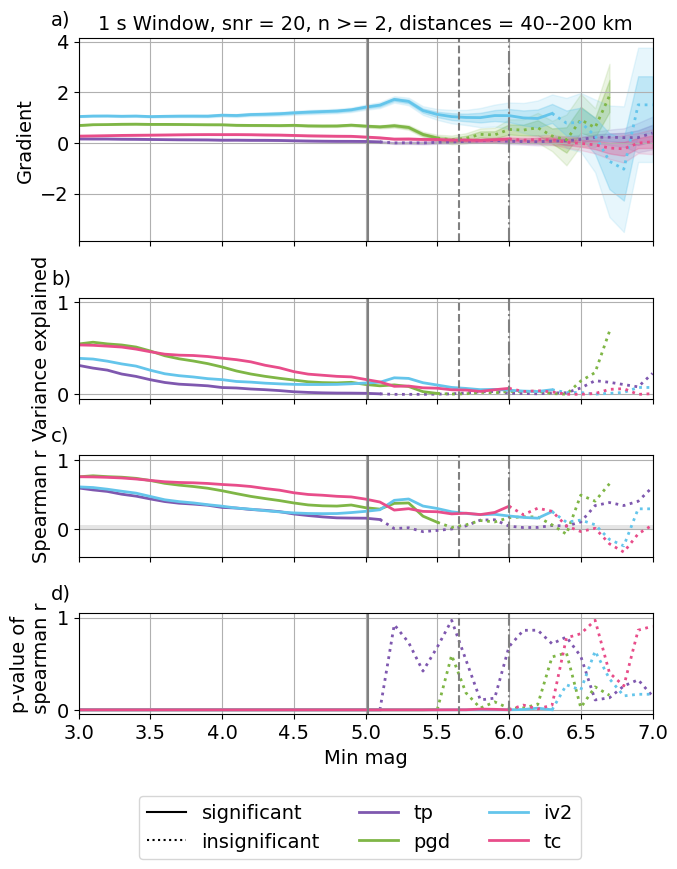

tp 0.5781449028094565
pgd 0.7532077499302827
tc 0.738688466631313
iv2 0.6122446490509744
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


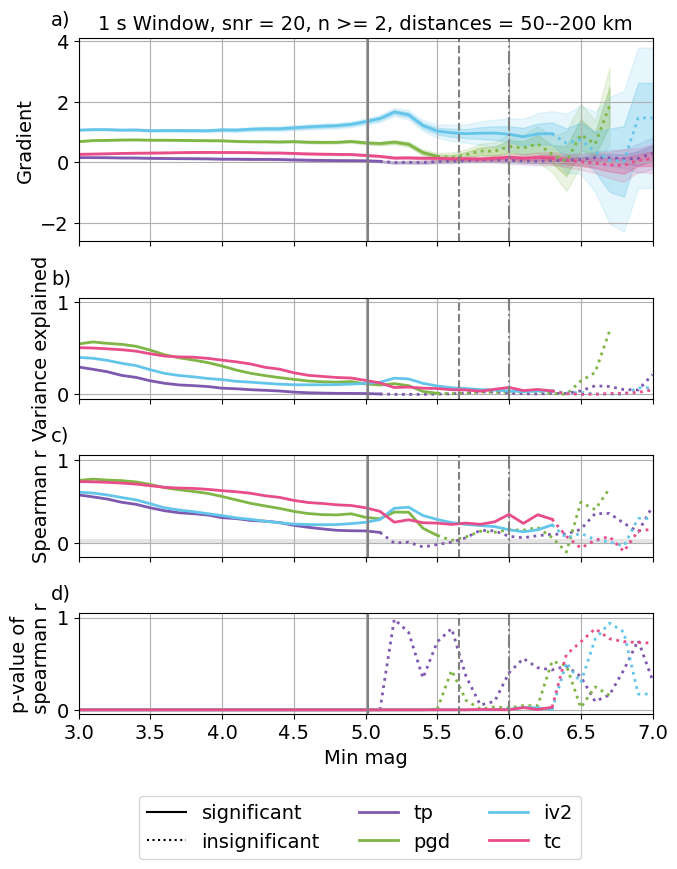

tp 0.5653756589488402
pgd 0.7511414101675891
tc 0.7139337884699244
iv2 0.6227824996025813
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


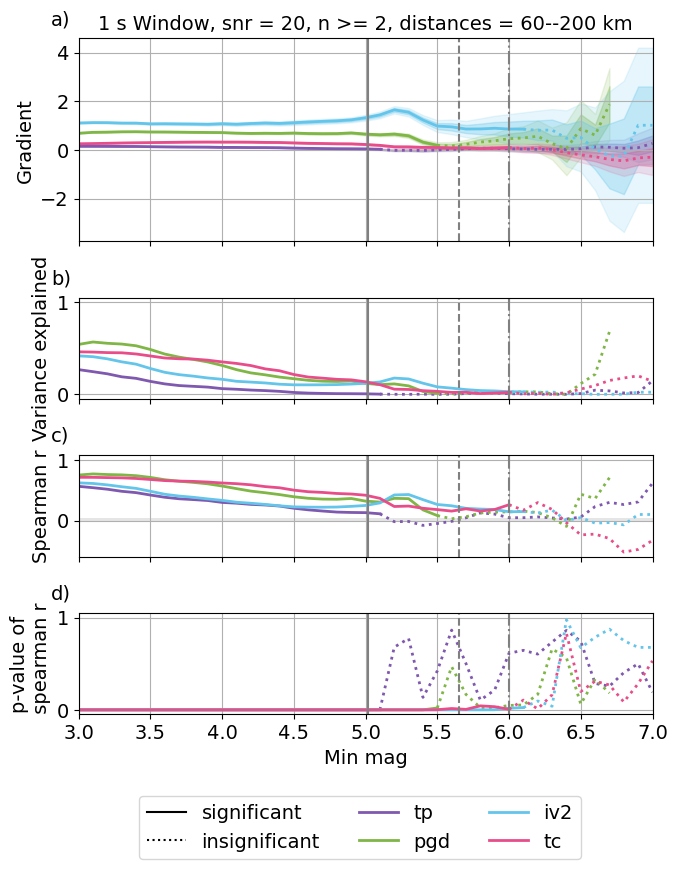

tp 0.5504403881359484
pgd 0.7494162787495428
tc 0.6736051598642694
iv2 0.6395825886326832
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


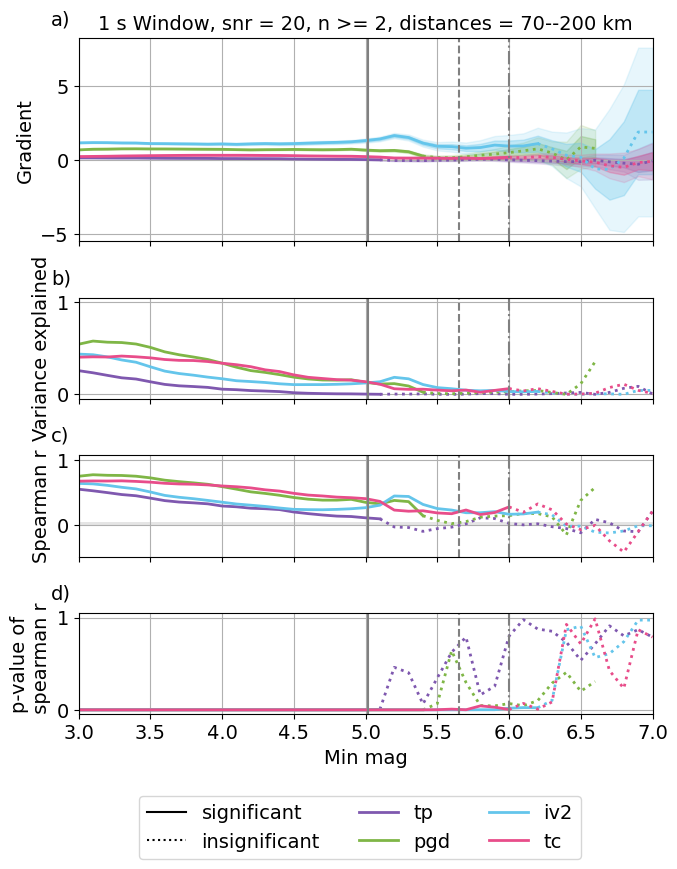

tp 0.5237760469051396
pgd 0.7422127972531061
tc 0.6196542702553015
iv2 0.6583947235782842
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


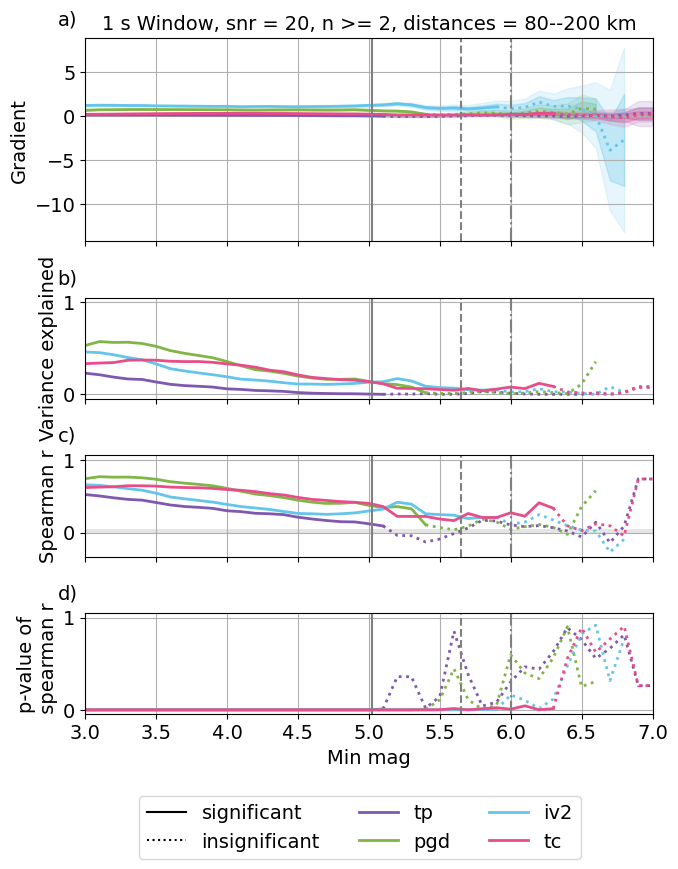

tp 0.49163499426535906
pgd 0.7240082250399628
tc 0.5711395014338557
iv2 0.6567998397464018
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


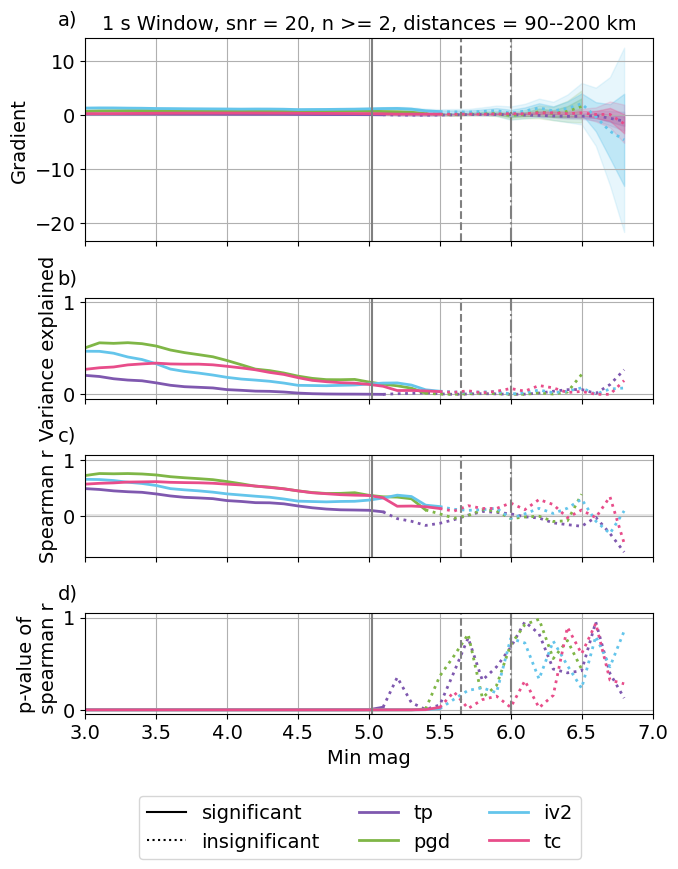

tp 0.6852110060588803
pgd 0.7818493606726978
tc 0.8091308666588922
iv2 0.6630965581124019
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


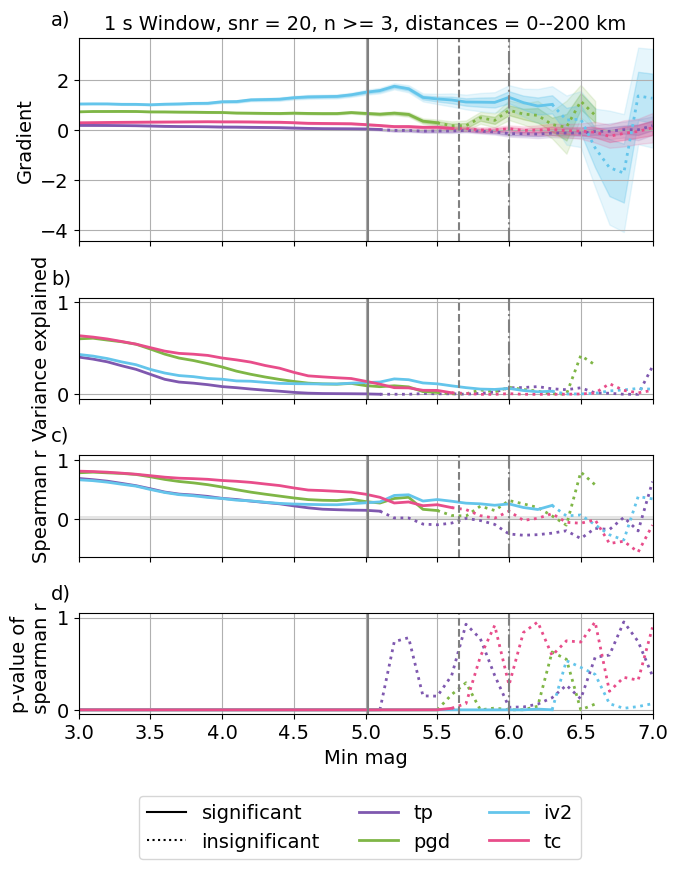

tp 0.6840948803347208
pgd 0.7798141976652352
tc 0.8012401374789776
iv2 0.661153092574373
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


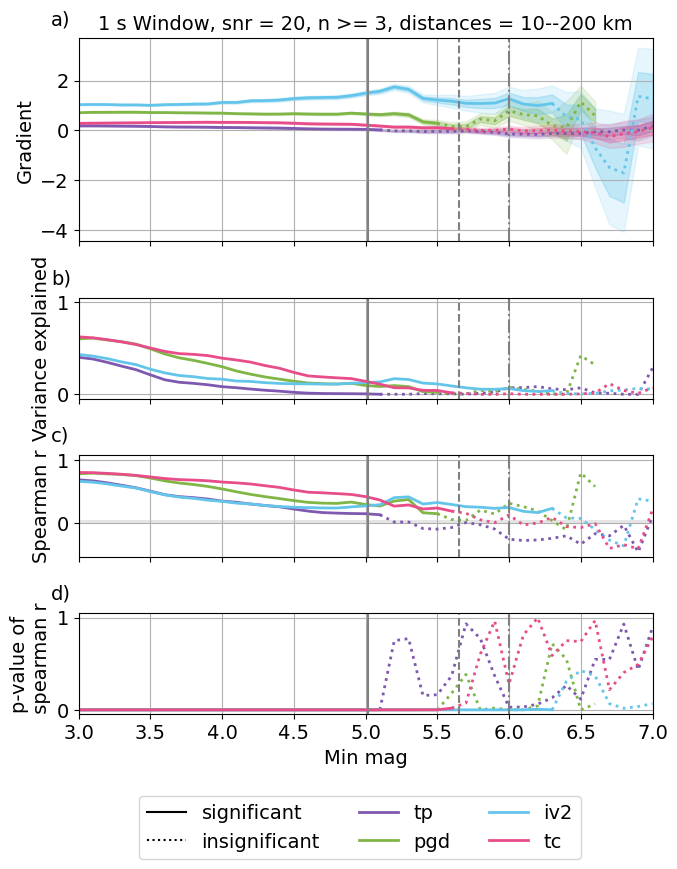

tp 0.6692850808969901
pgd 0.7722018829460213
tc 0.7898753008833326
iv2 0.6497205384787665
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


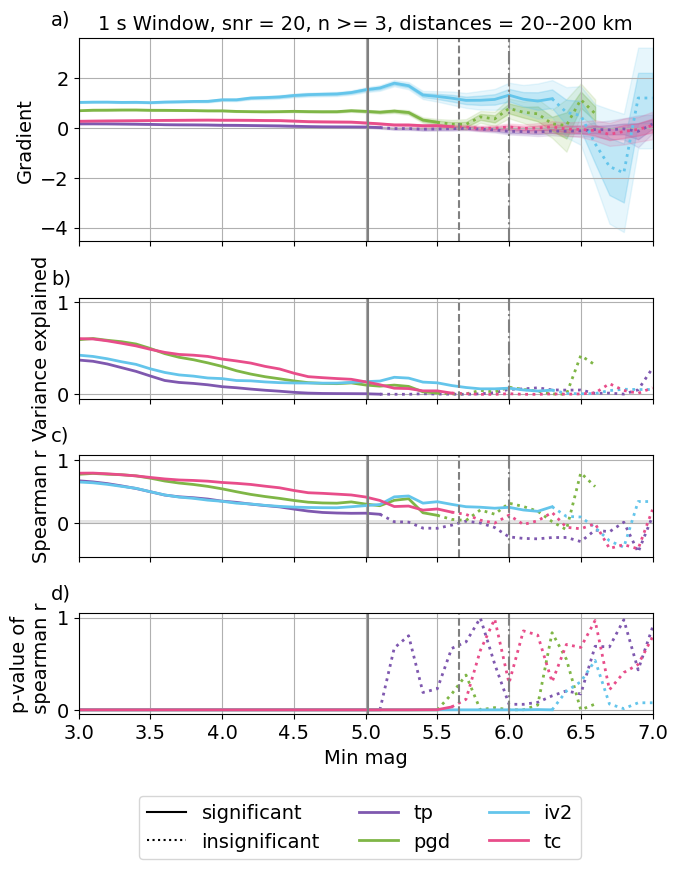

tp 0.6550972863377356
pgd 0.7625725033493627
tc 0.7728864358413755
iv2 0.627630809415938
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


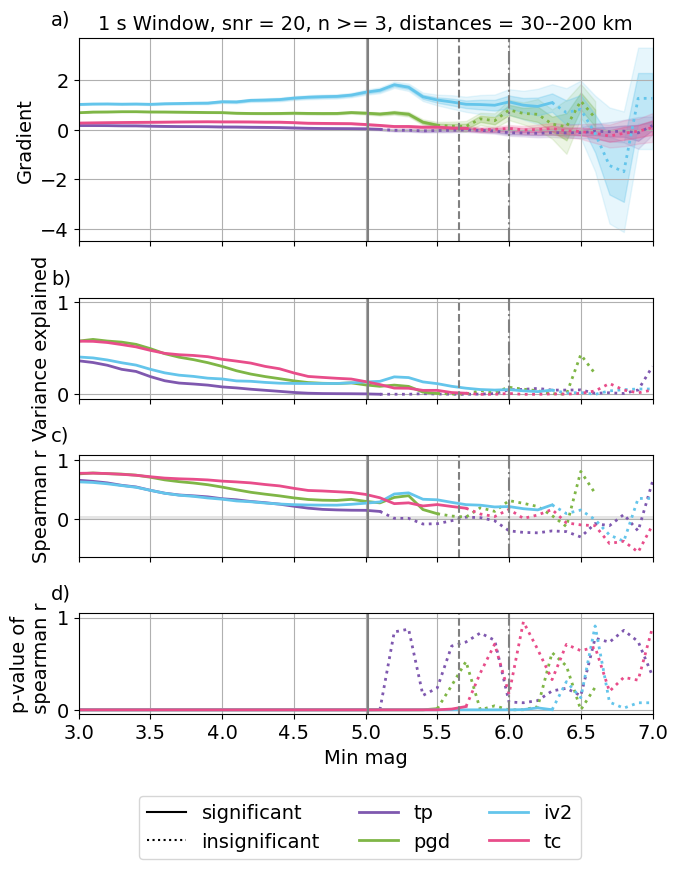

tp 0.6475228331675458
pgd 0.754039403745296
tc 0.7594938470631234
iv2 0.6118737113500927
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


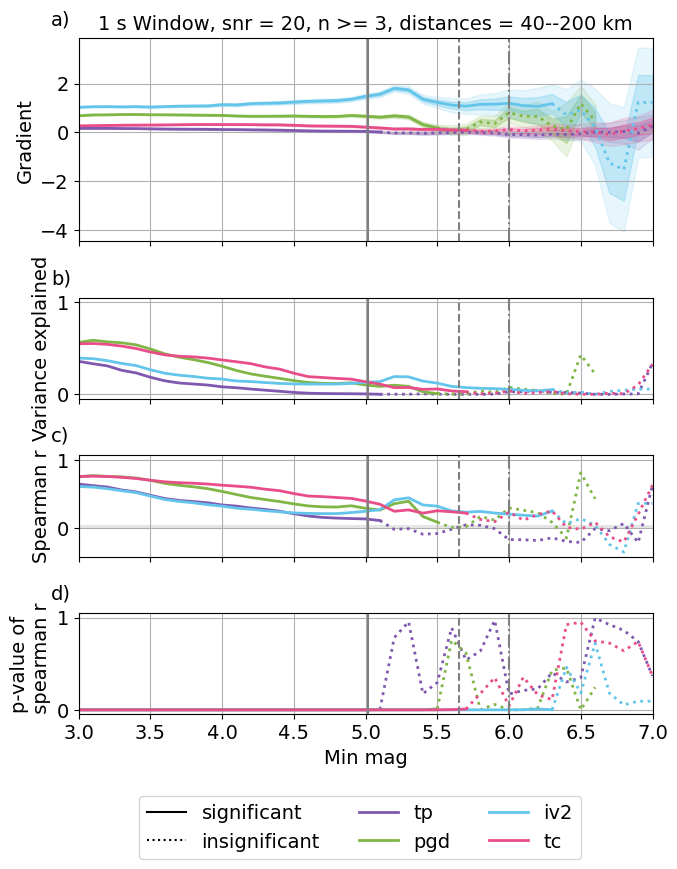

tp 0.6357275659123586
pgd 0.7526961614911927
tc 0.7392587954793931
iv2 0.6162528101307737
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


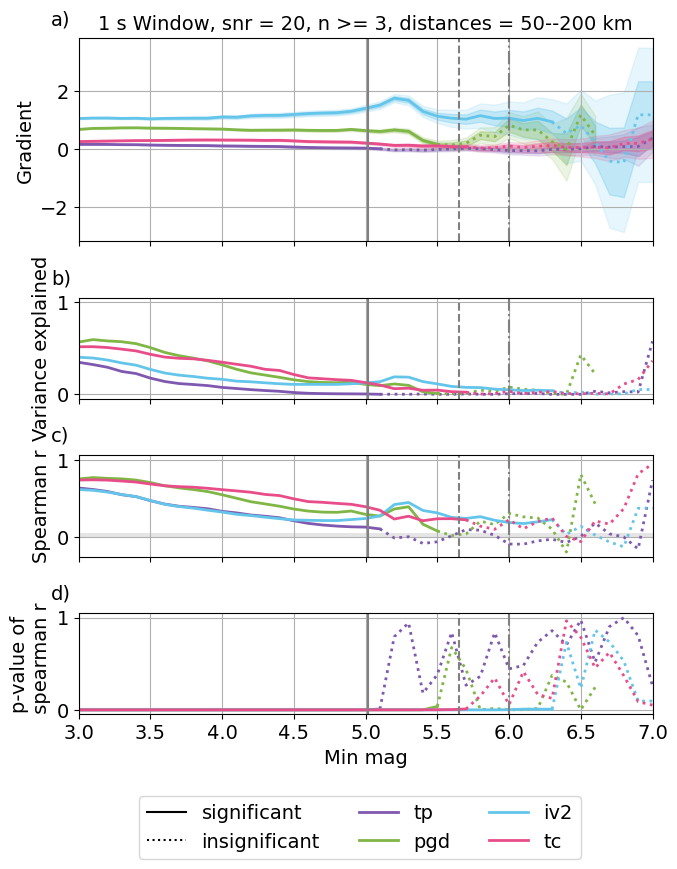

tp 0.6247869566755543
pgd 0.7499645777475654
tc 0.7134010768953637
iv2 0.6289819115884809
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


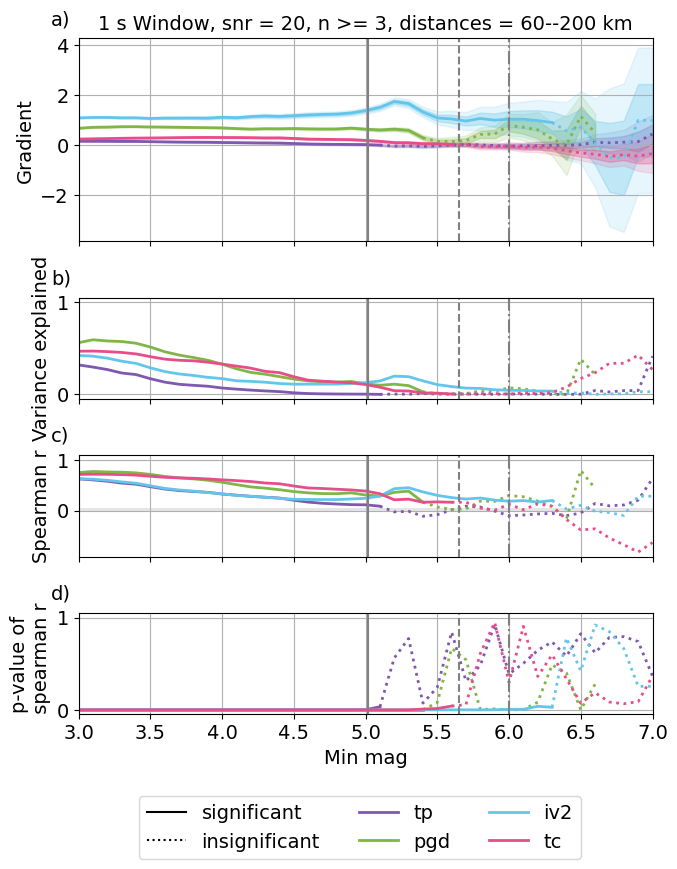

tp 0.6175312518916383
pgd 0.7461456423822442
tc 0.669808588882222
iv2 0.6444540903508
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


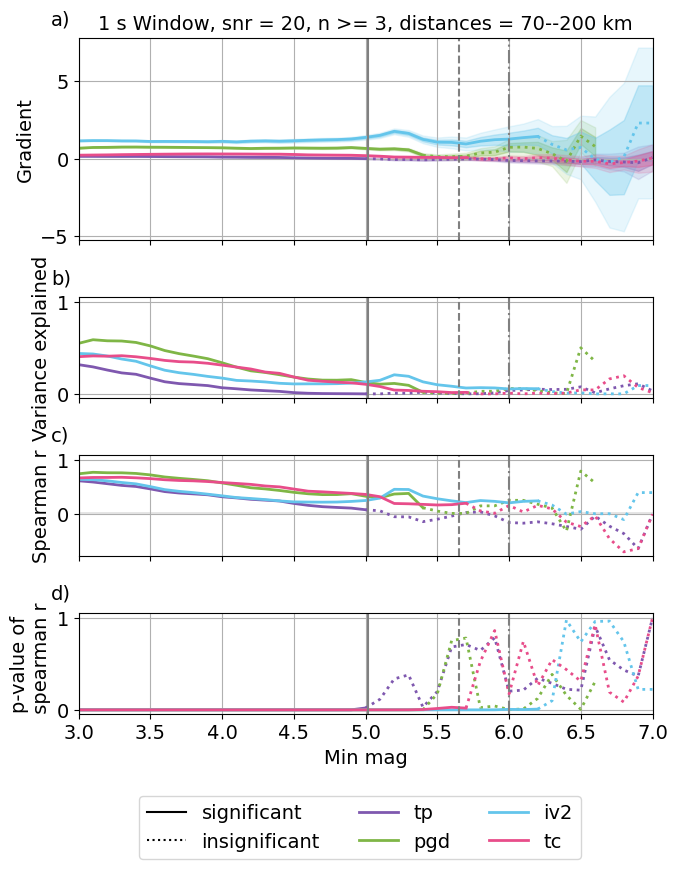

tp 0.580351656307434
pgd 0.7367130102943859
tc 0.6100912671387071
iv2 0.6653823367164459
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


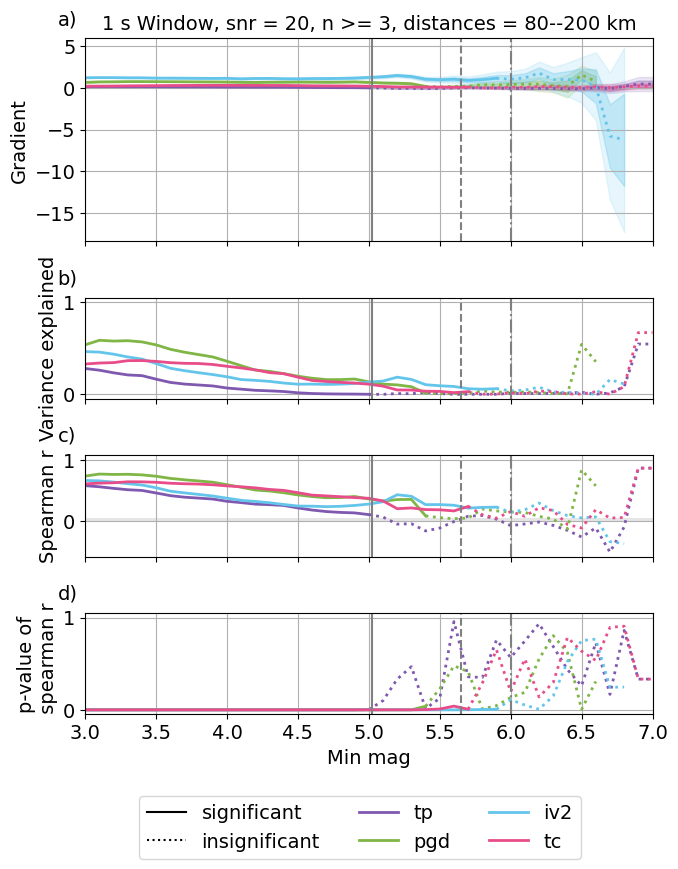

tp 0.5474120925571659
pgd 0.7160321057179433
tc 0.5546522878523891
iv2 0.664497971262494
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


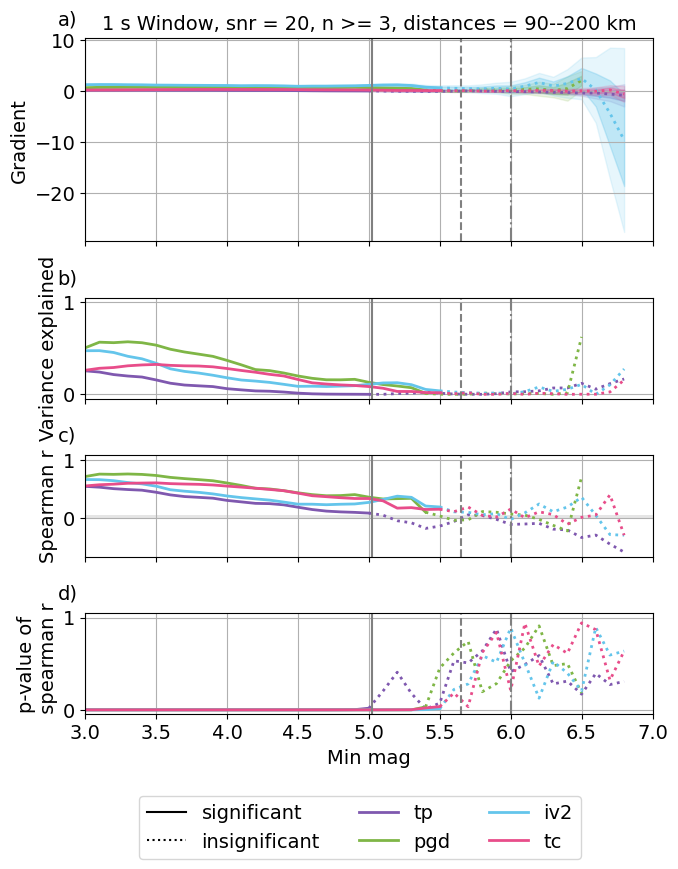

tp 0.7294144602317064
pgd 0.7769026513128152
tc 0.8163524734433537
iv2 0.6579694794672123
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


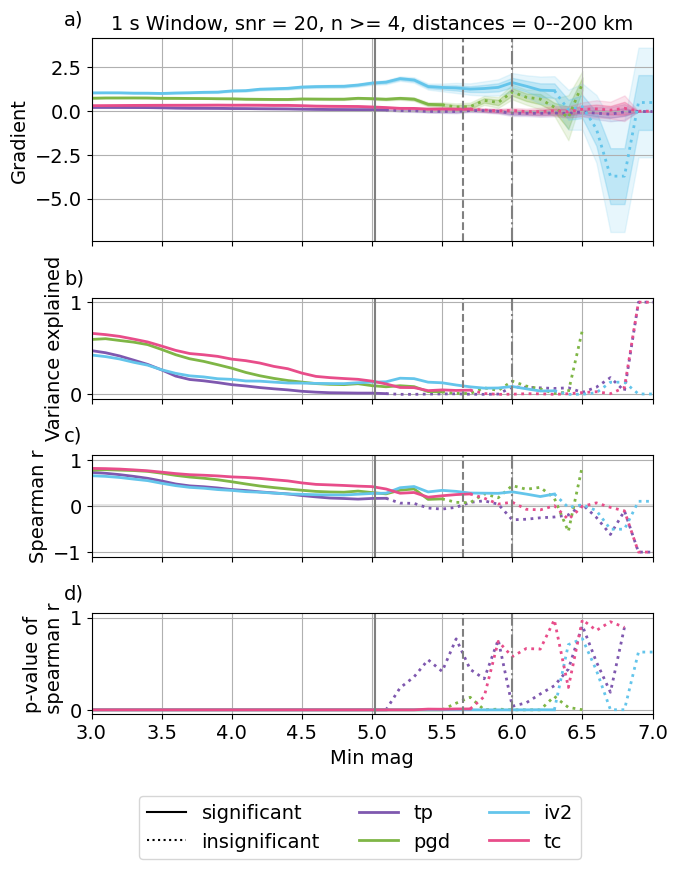

tp 0.7263018256053196
pgd 0.7751981968298115
tc 0.8072414347364261
iv2 0.6564459242130897
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


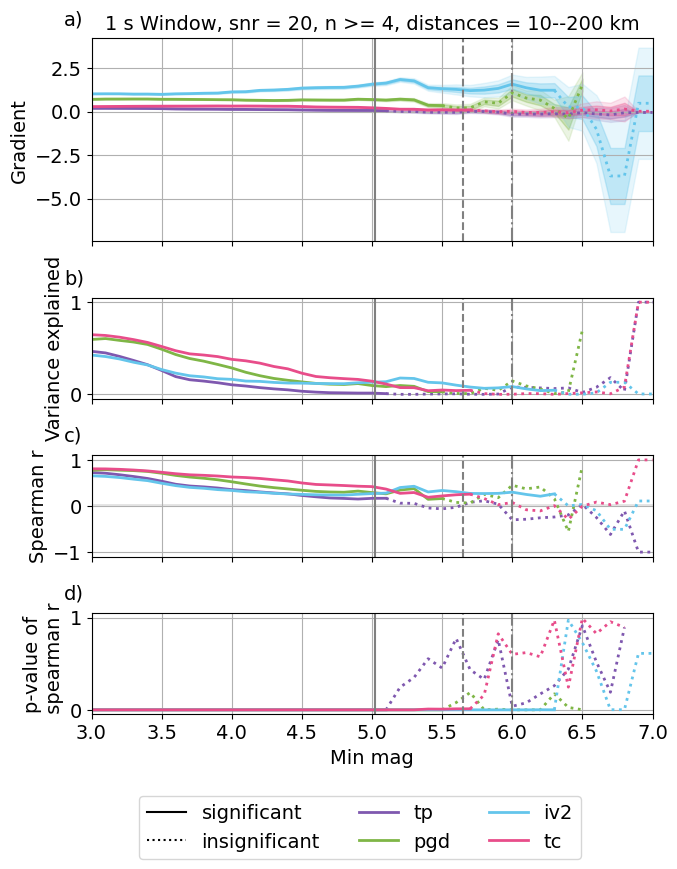

tp 0.7127503484662004
pgd 0.7676283284813246
tc 0.7954350132531428
iv2 0.6458877637669984
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


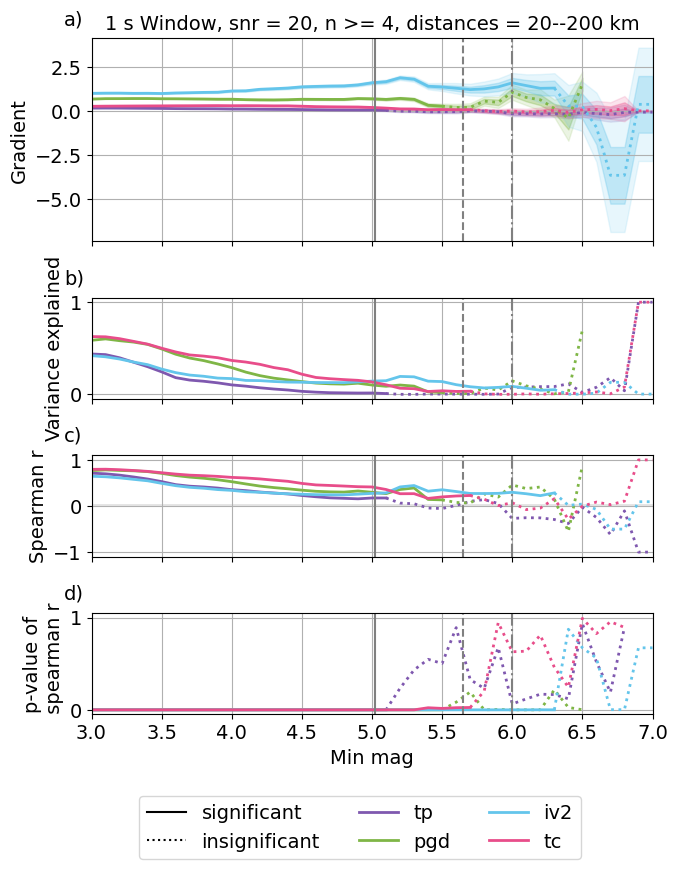

tp 0.6986369587157208
pgd 0.7582224312046428
tc 0.7763729141128355
iv2 0.624842889876616
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


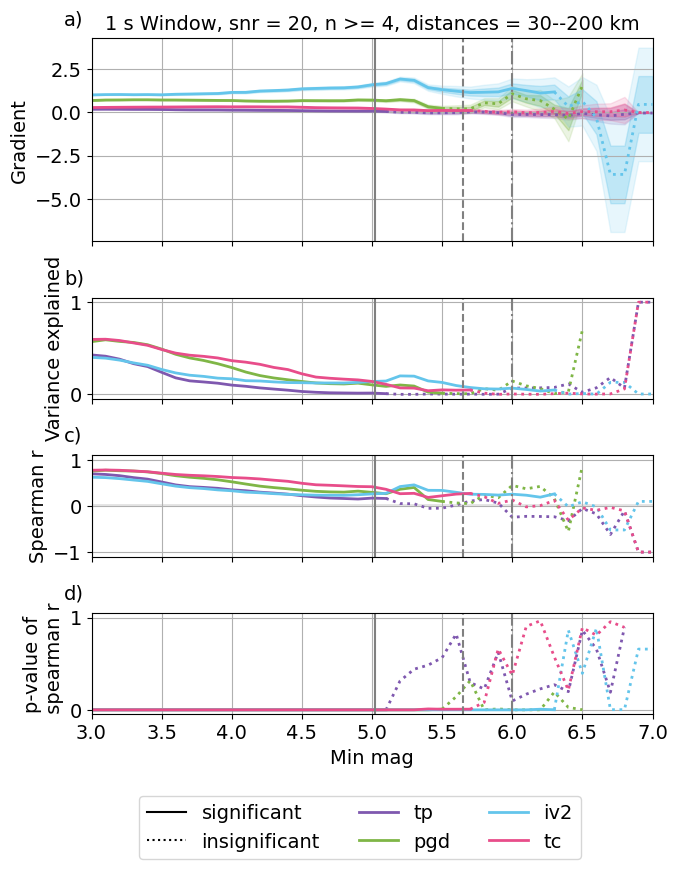

tp 0.6893092668530643
pgd 0.7499226946649623
tc 0.7609682002864625
iv2 0.610385765915939
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


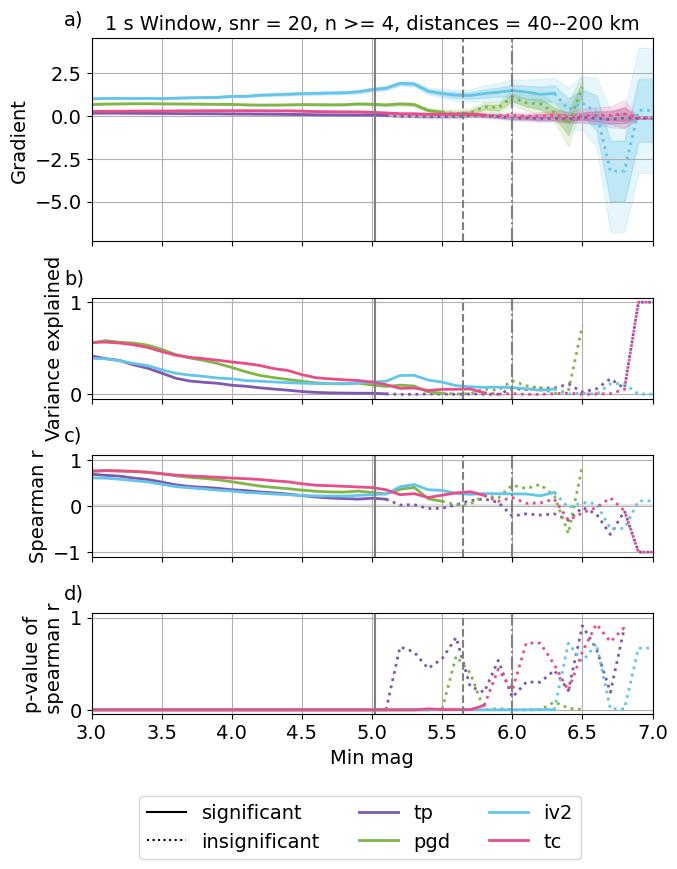

tp 0.6741023977449322
pgd 0.7485065932758432
tc 0.7429568960489409
iv2 0.6168405053839012
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


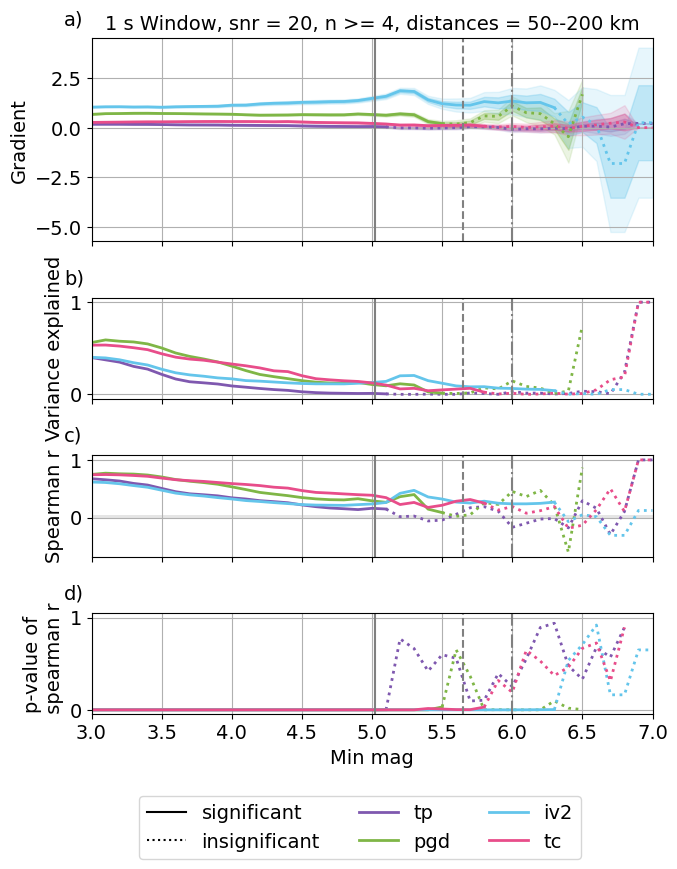

tp 0.6593596992091586
pgd 0.7444568501346878
tc 0.7138147824794858
iv2 0.6303234437088089
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


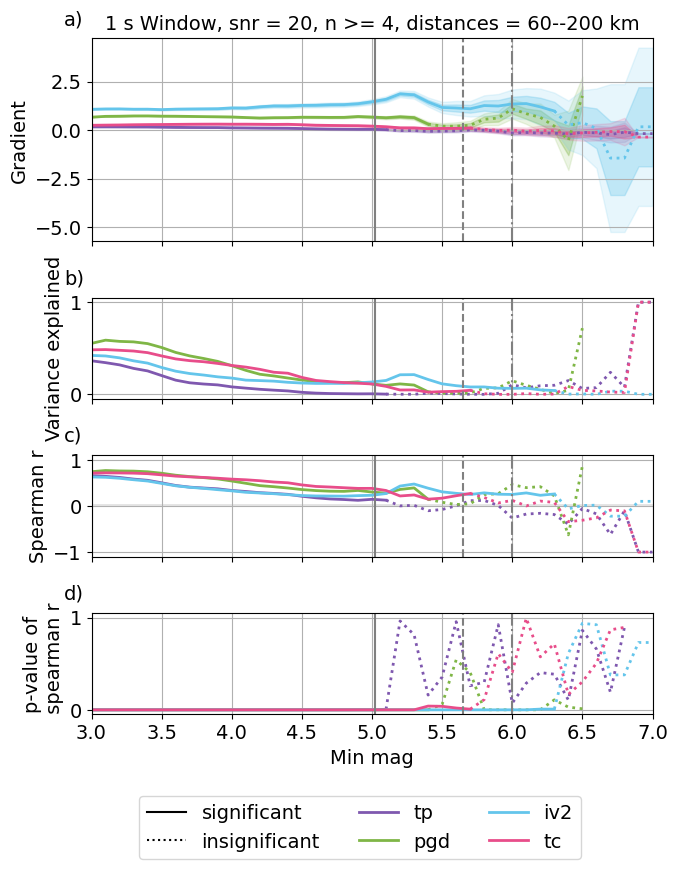

tp 0.6496566169784873
pgd 0.7398837910077536
tc 0.6633033856187629
iv2 0.6495653490929513
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


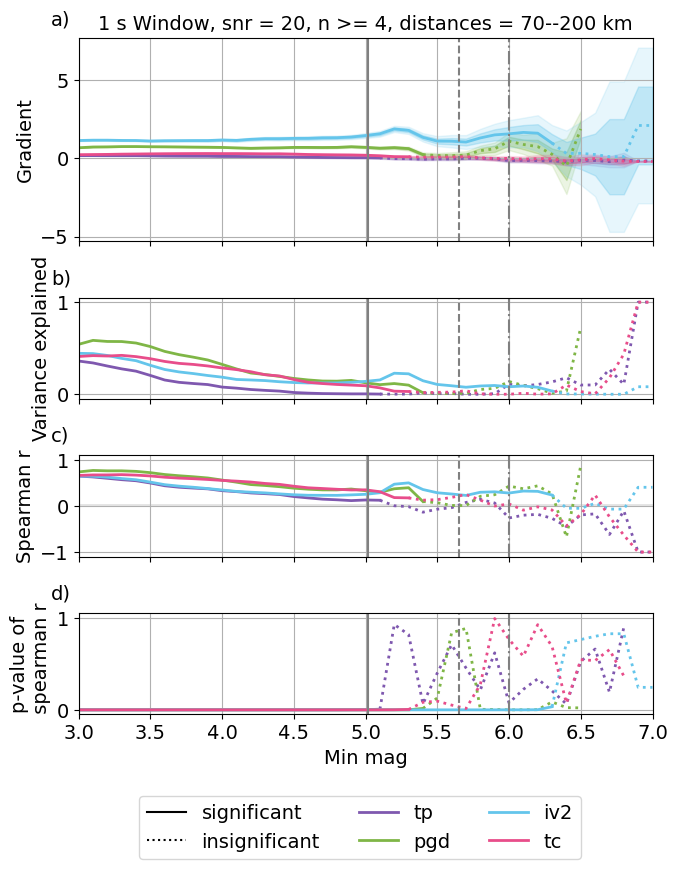

tp 0.613588261370102
pgd 0.7297656059838965
tc 0.5974835037189333
iv2 0.6775356765369495
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


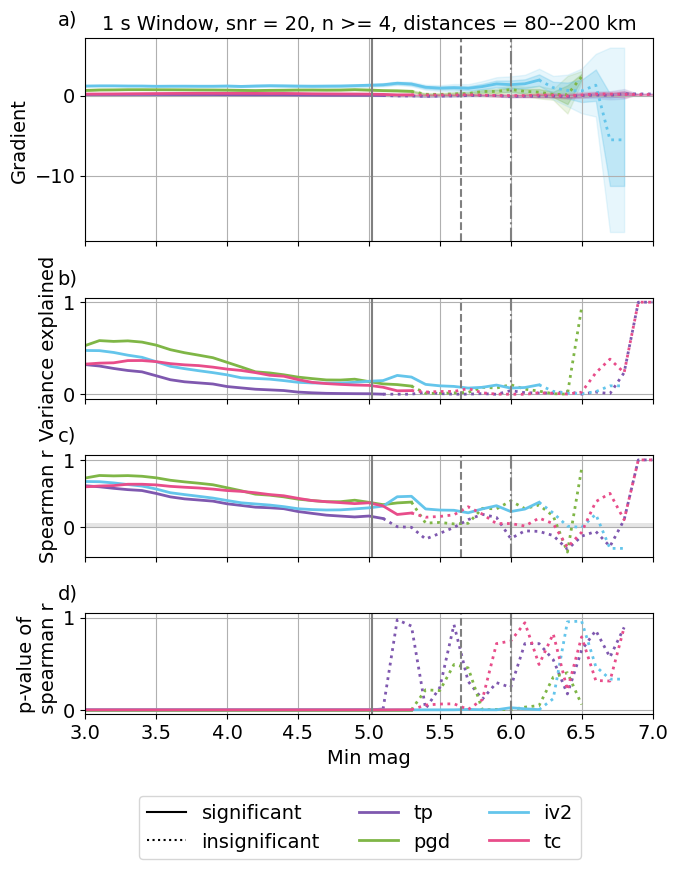

tp 0.578387065459334
pgd 0.7062106705990565
tc 0.5393897280785327
iv2 0.6780055368515575
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


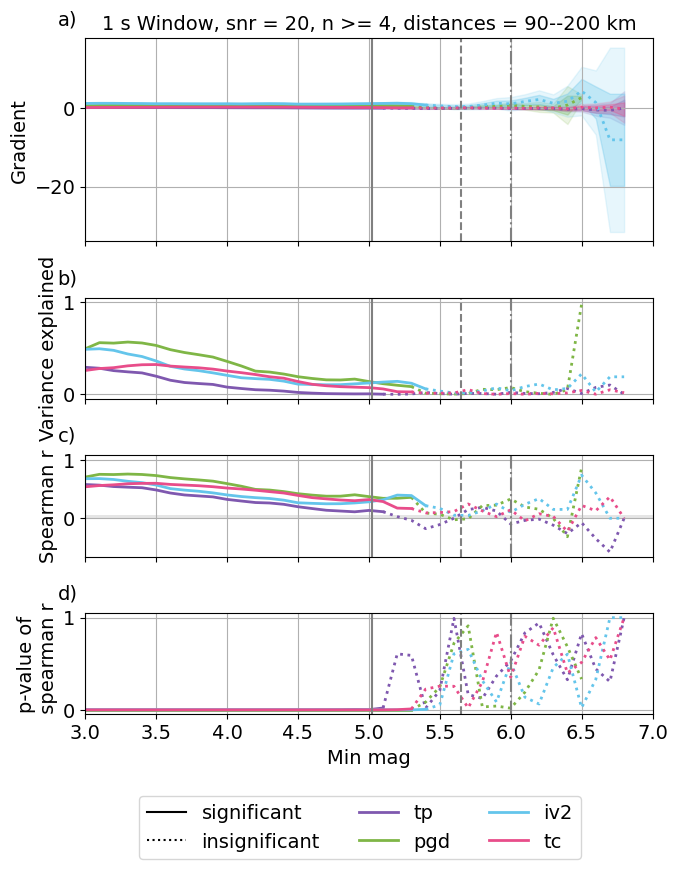

tp 0.753222492524381
pgd 0.7728070299745304
tc 0.827860044004133
iv2 0.6562355809606434
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


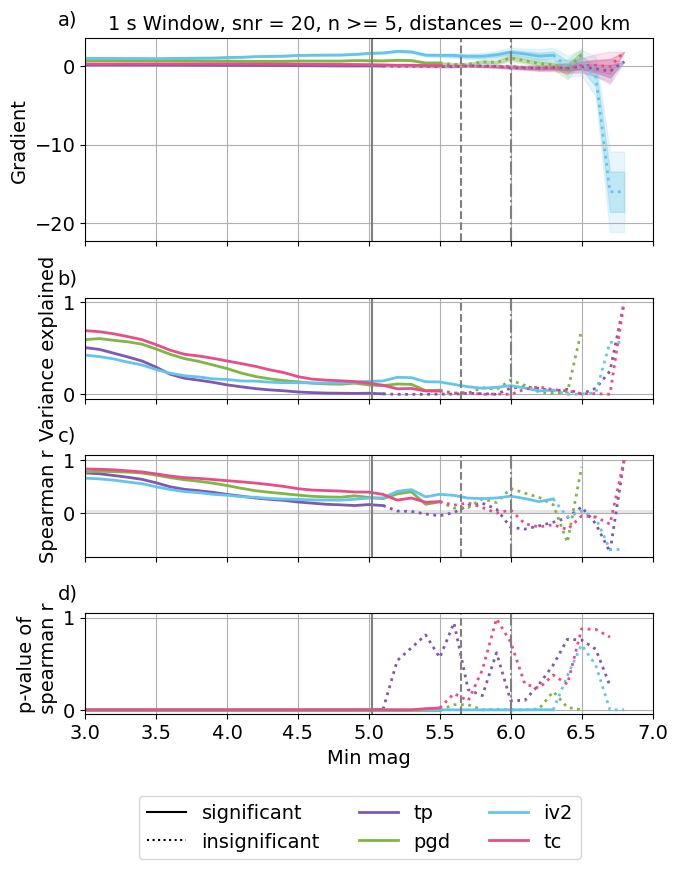

tp 0.7519909019954231
pgd 0.771657663901403
tc 0.82214458782213
iv2 0.6551591994364224
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


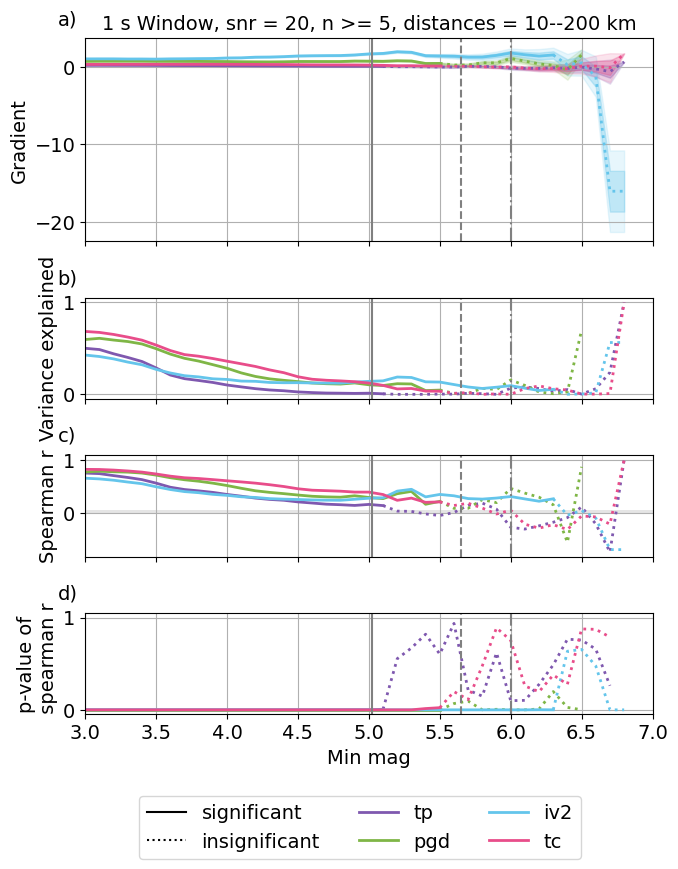

tp 0.7357517487852351
pgd 0.7645563351504112
tc 0.8115716746363071
iv2 0.6456712973128996
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


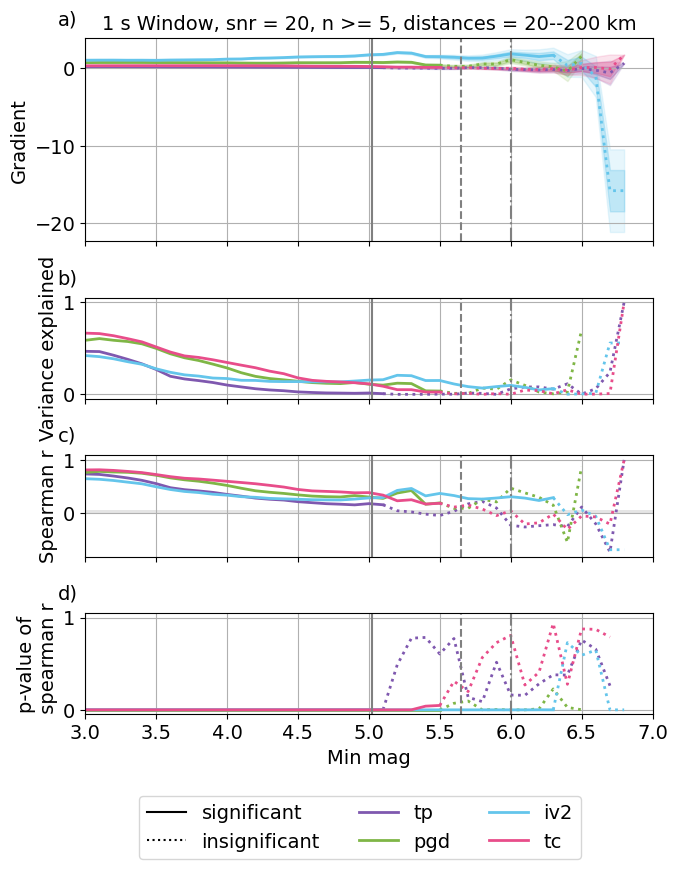

tp 0.7243037994105604
pgd 0.7565304736076754
tc 0.7933430881217097
iv2 0.6259488309665685
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


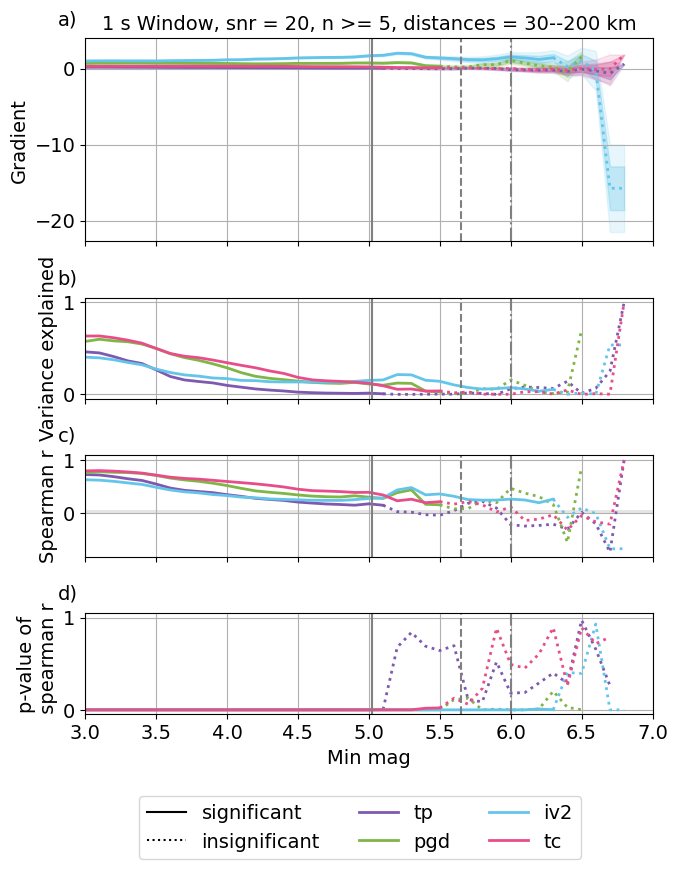

tp 0.7144819535382902
pgd 0.7491840578719999
tc 0.7753079714498402
iv2 0.6126246157315288
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


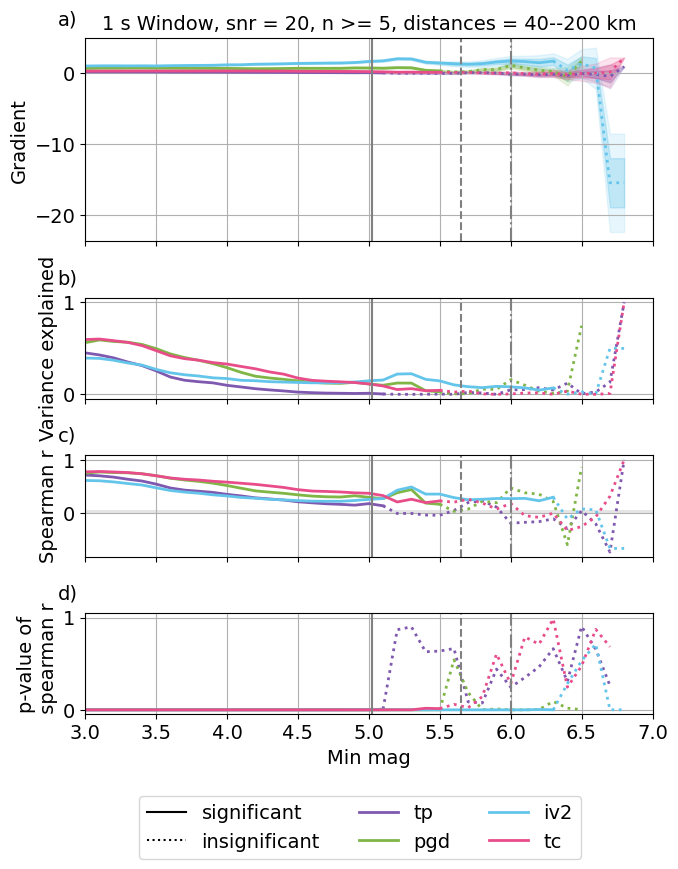

tp 0.7013873768840058
pgd 0.7482110902645643
tc 0.7595507668209854
iv2 0.6204470101363545
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


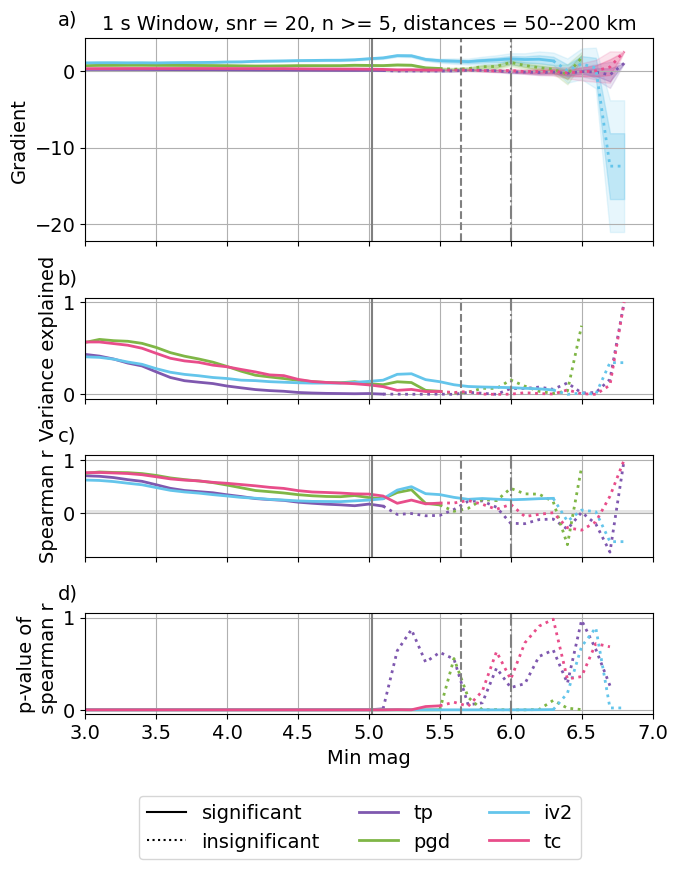

tp 0.6858089334535994
pgd 0.7438085088771254
tc 0.7293466198049515
iv2 0.6339461248982128
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


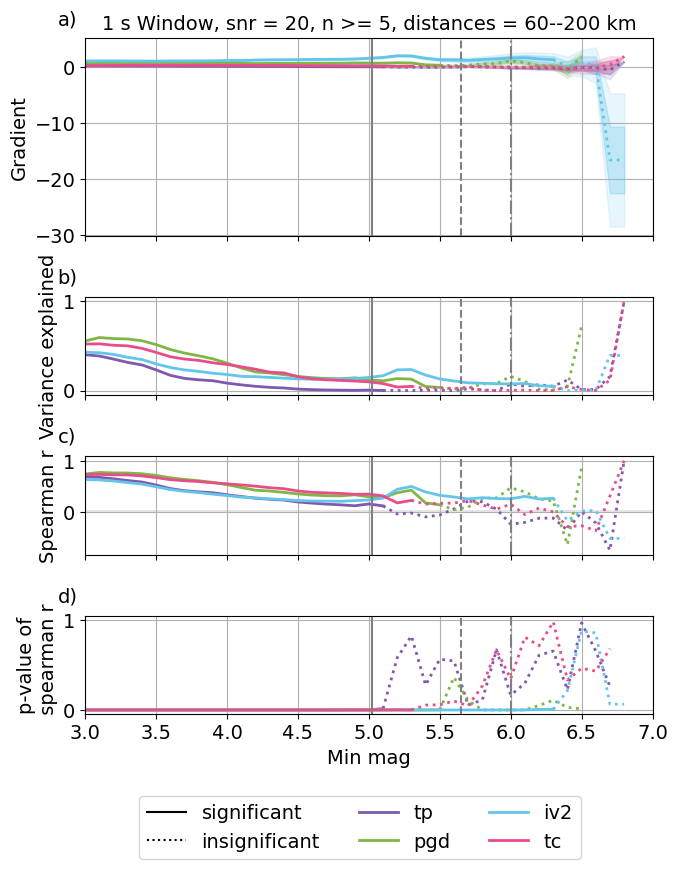

tp 0.6700154432207356
pgd 0.7370630005251213
tc 0.6776740193832821
iv2 0.6535223020277634
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


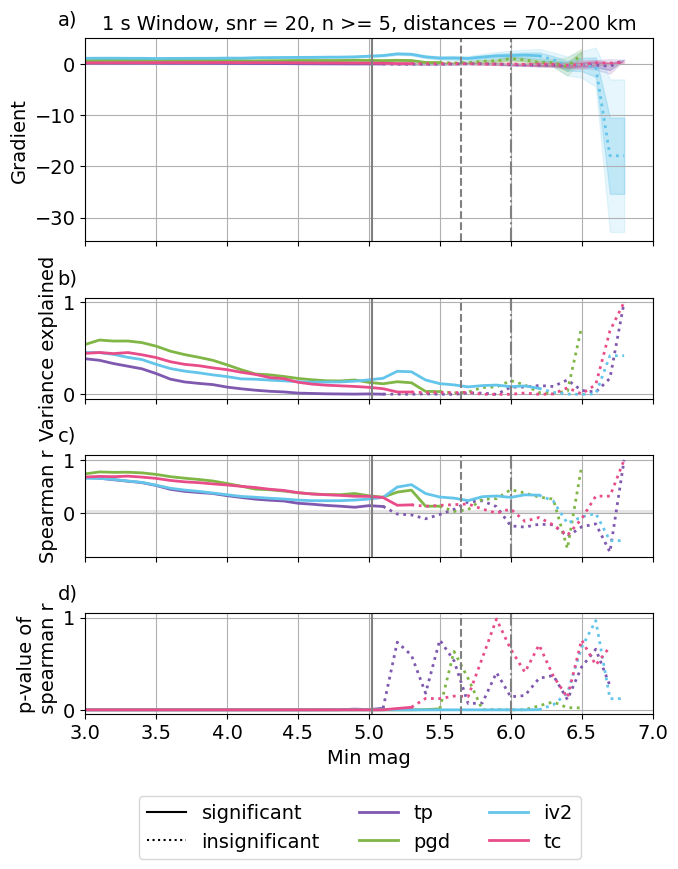

tp 0.6284563781275238
pgd 0.7270001333407607
tc 0.6038163052081984
iv2 0.6882893909838815
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


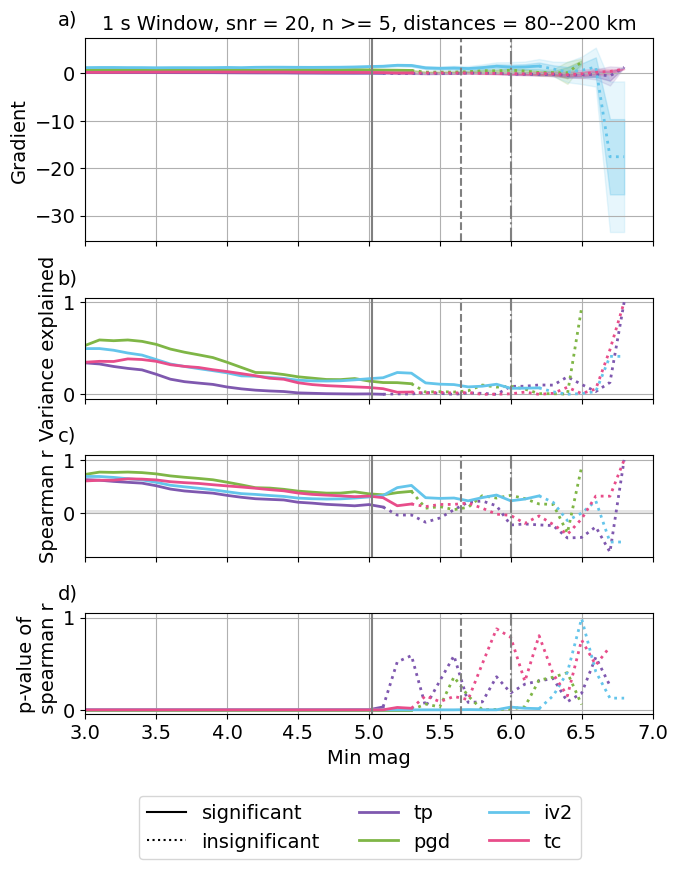

tp 0.5970263005853466
pgd 0.7030207682473173
tc 0.5461213781948276
iv2 0.6941782806458112
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


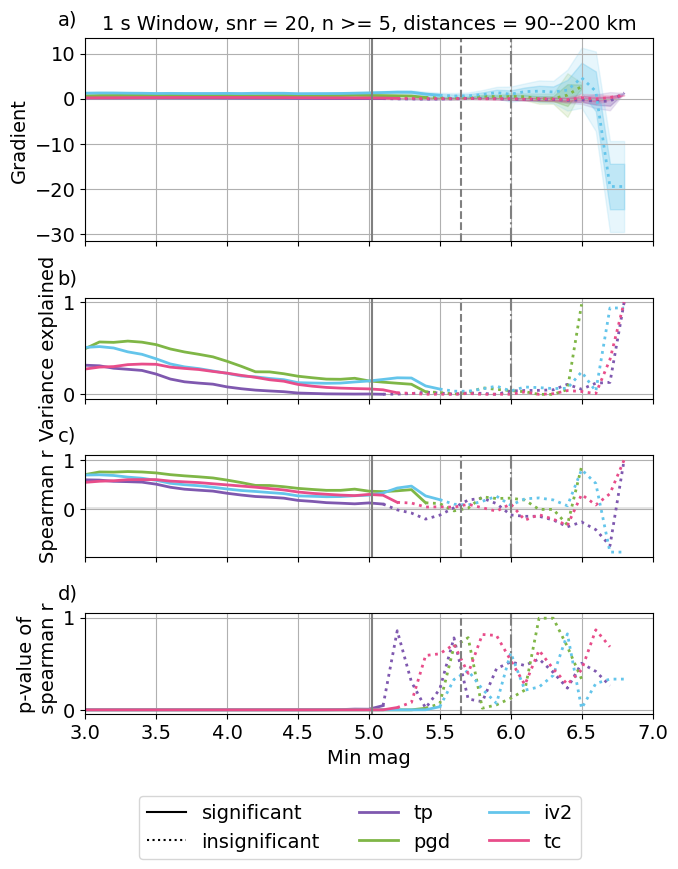

tp 0.769204767024537
pgd 0.7680277505501774
tc 0.834327062292069
iv2 0.6505284739321837
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


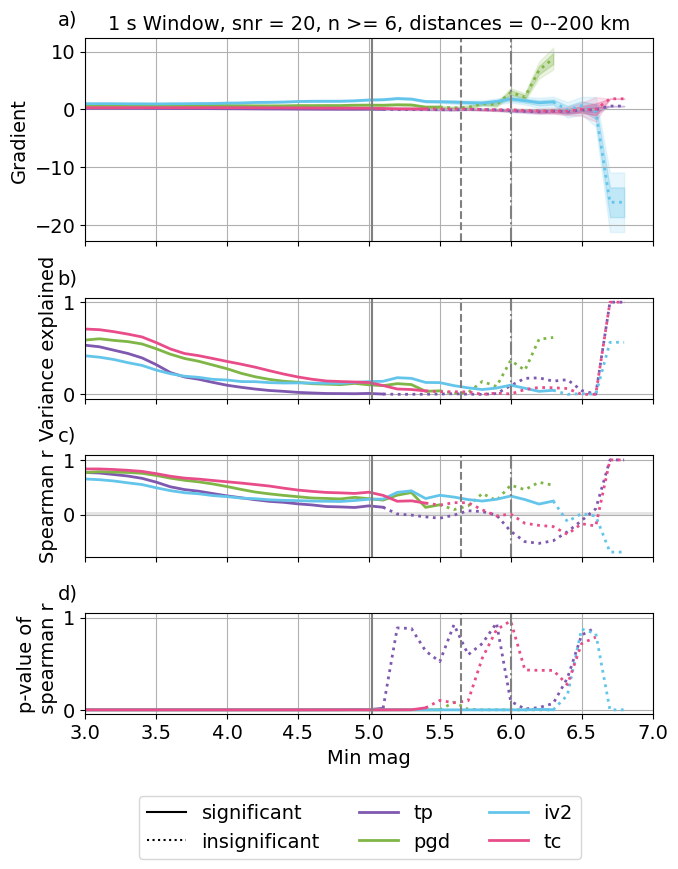

tp 0.7680415486605946
pgd 0.7670103058362239
tc 0.8284736857223702
iv2 0.6498188098144573
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


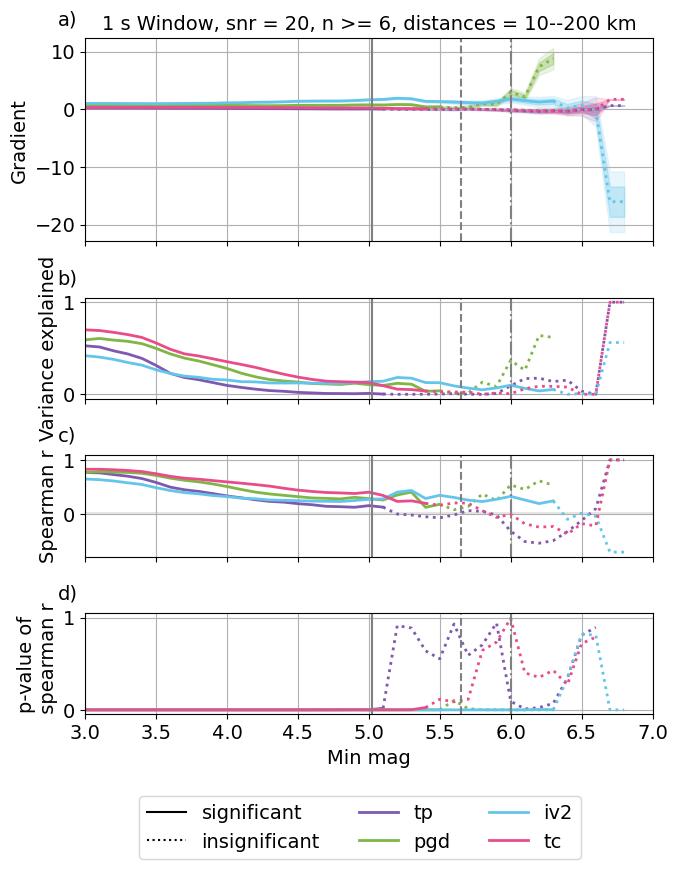

tp 0.7508279579300113
pgd 0.7597658598295837
tc 0.8209381014284486
iv2 0.6408684120959712
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


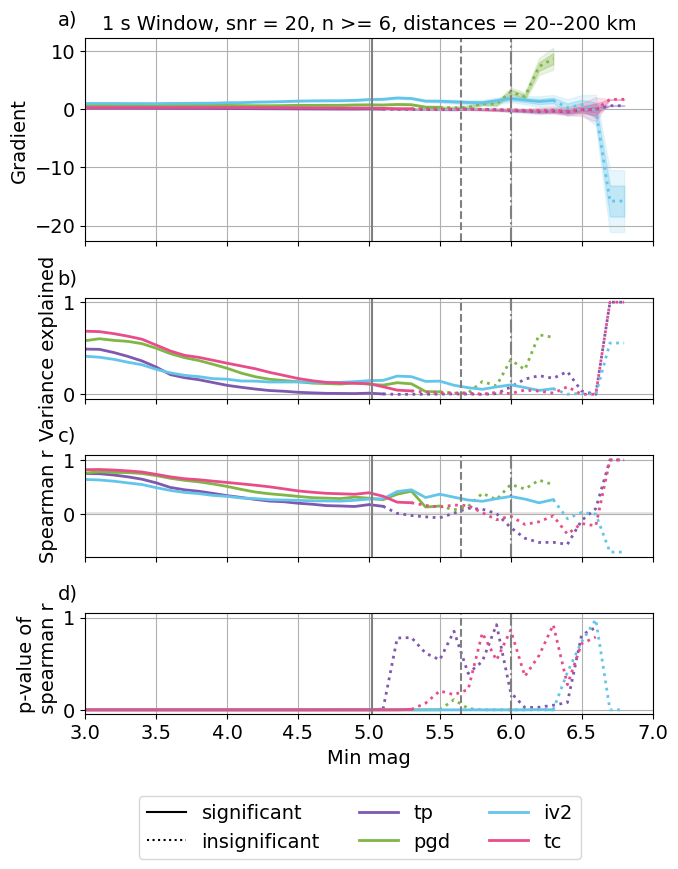

tp 0.7459930246759768
pgd 0.752627373825328
tc 0.8129105836500629
iv2 0.6218769999639538
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


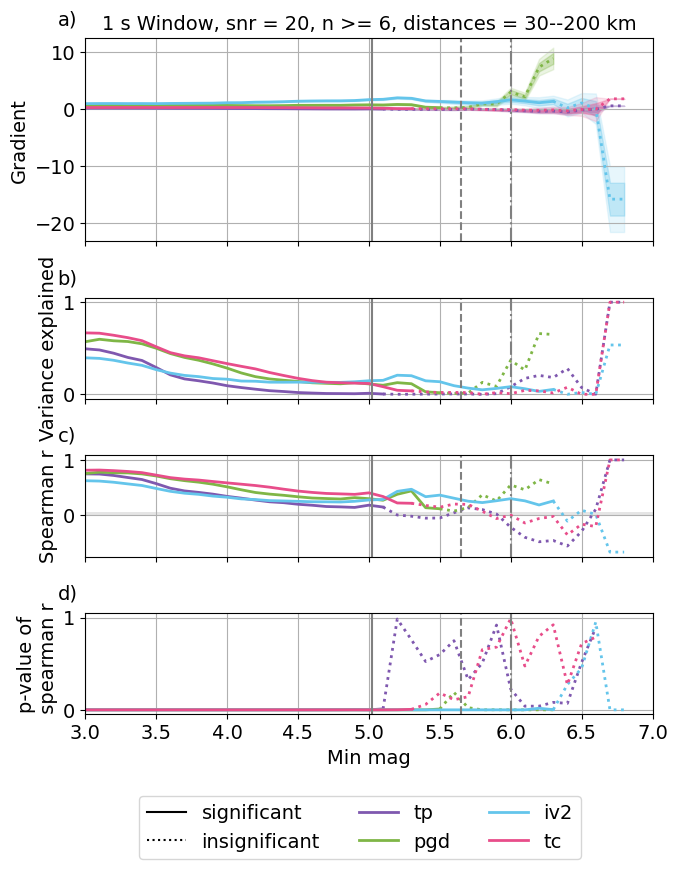

tp 0.7378892998079023
pgd 0.7463137424470541
tc 0.7964795186790209
iv2 0.6094694660111573
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


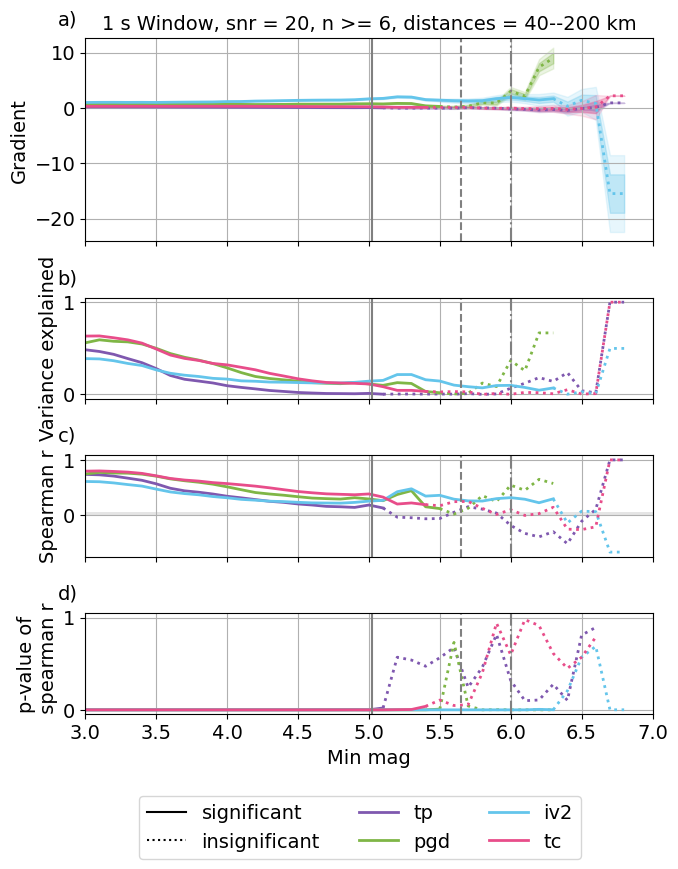

tp 0.7267912289437083
pgd 0.7450897319776971
tc 0.7771873027225873
iv2 0.6165726140376722
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


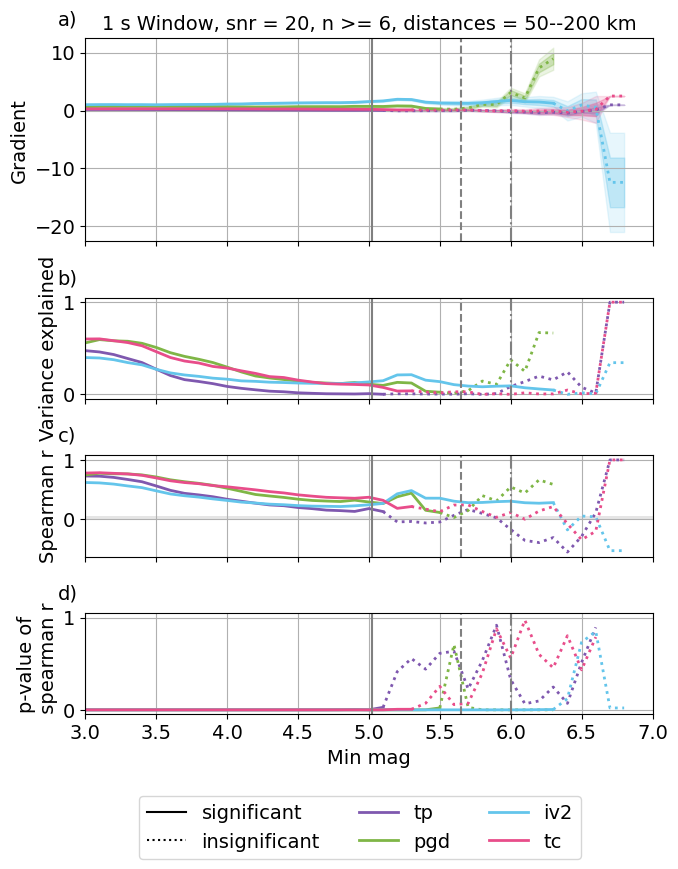

tp 0.711535474158026
pgd 0.7403679487428785
tc 0.7471587058638961
iv2 0.6311619069152328
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


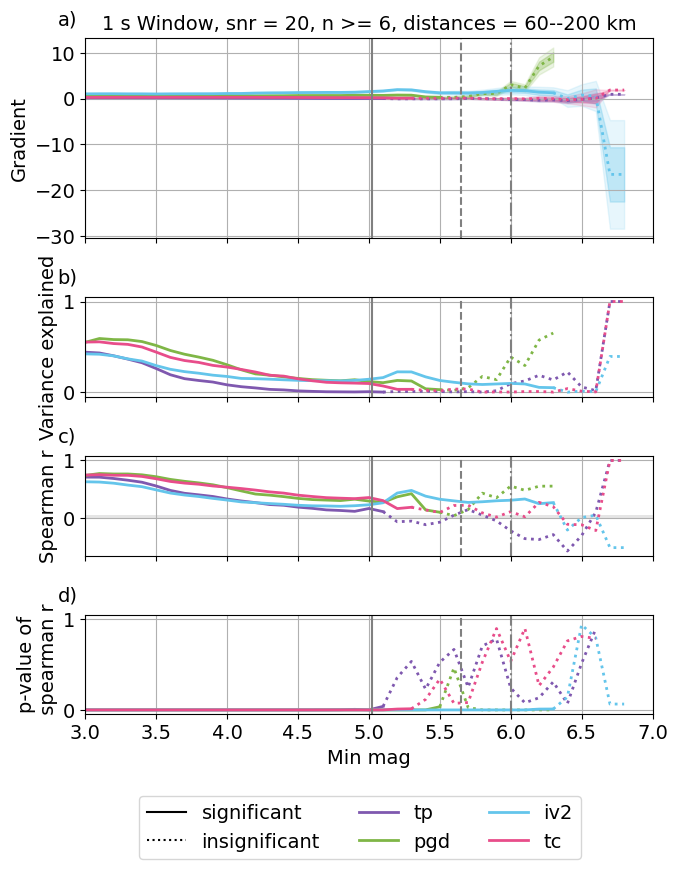

tp 0.69543969893018
pgd 0.7324248411805098
tc 0.6951549314241815
iv2 0.6487991375203737
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


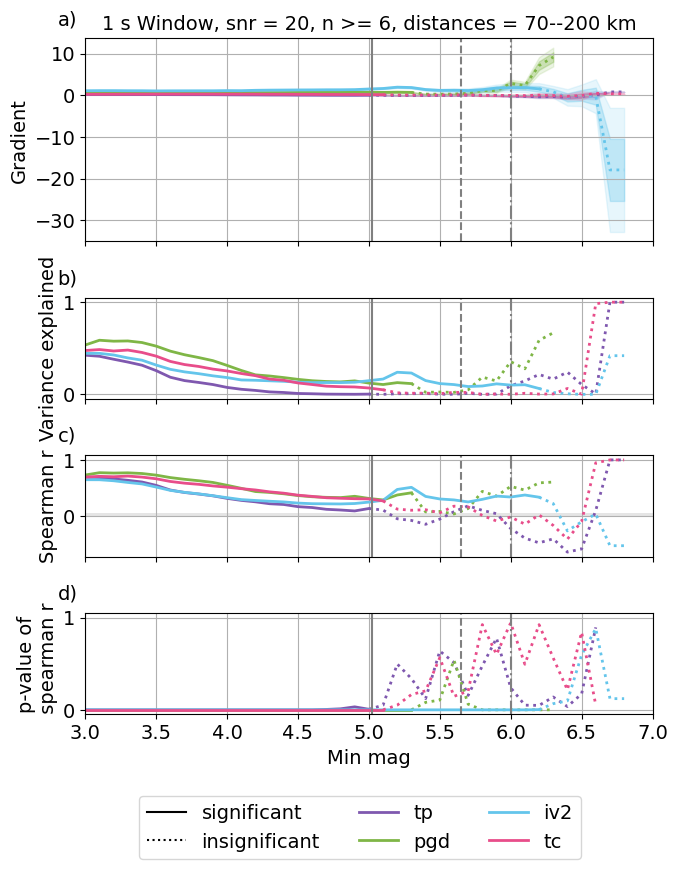

tp 0.6541419545495831
pgd 0.7216371141479317
tc 0.6125769933627591
iv2 0.6877591796070966
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


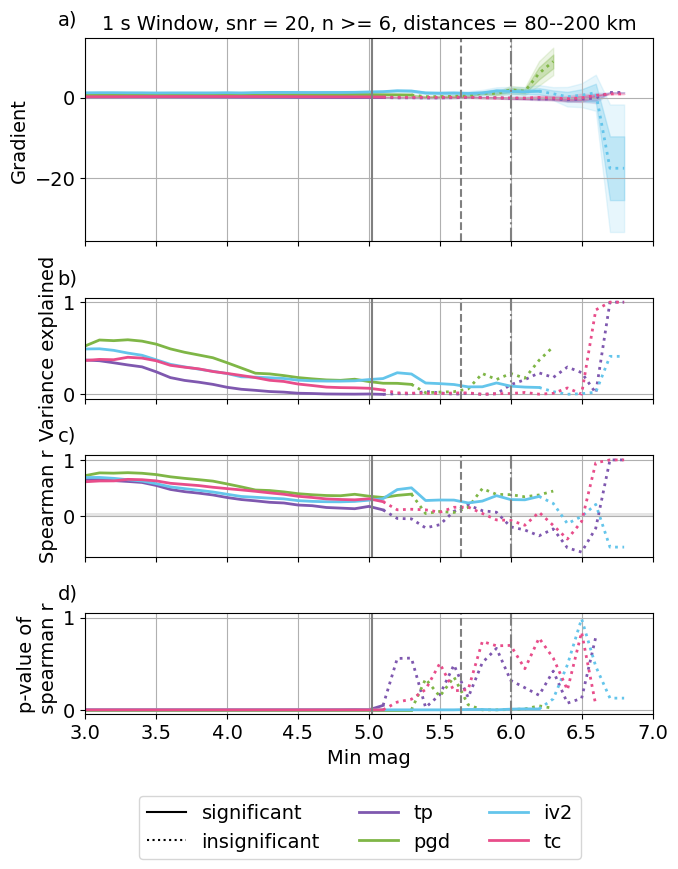

tp 0.6163037636086883
pgd 0.6977179848555174
tc 0.5496067077034453
iv2 0.6994810066230356
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


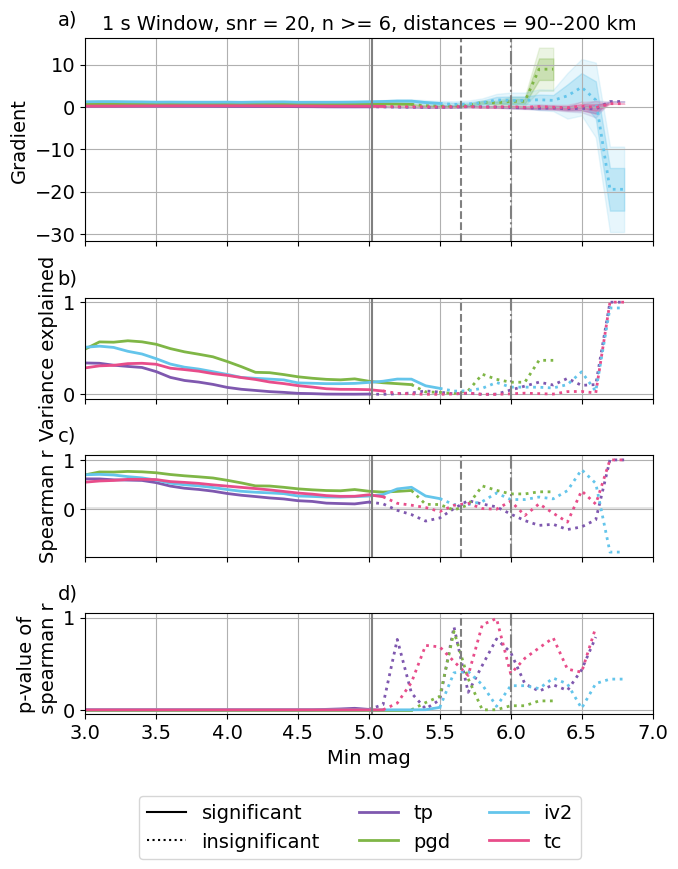

eq_object_4s_bandpass_01_19_snr_20_blank_0_new_snr20
tp 0.5589298354323806
pgd 0.8376397490811472
tc 0.7456101469456294
iv2 0.7945765889796864
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


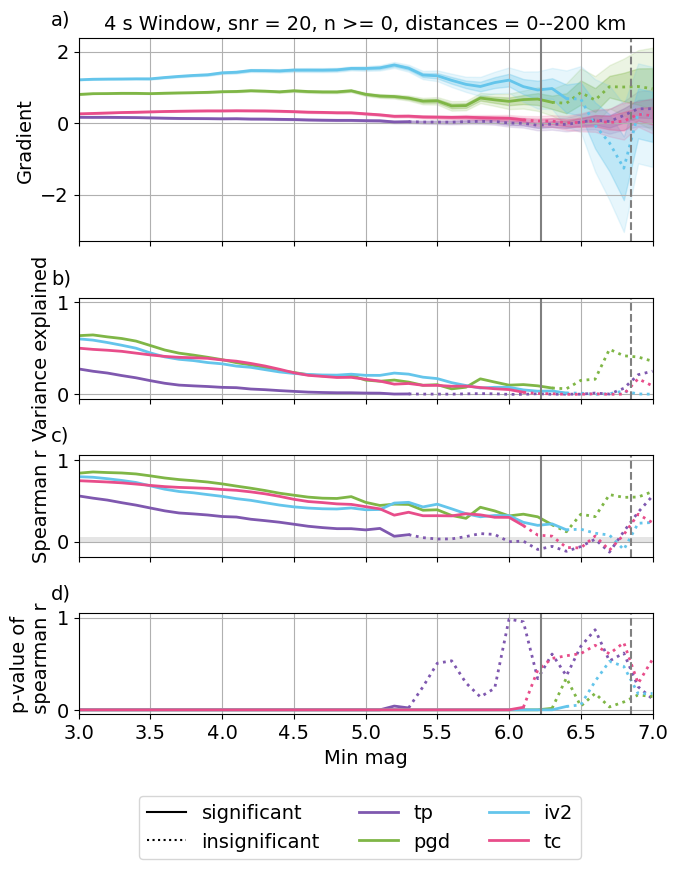

tp 0.5518215477149566
pgd 0.8375682623402342
tc 0.7398090524852872
iv2 0.7990533947638914
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


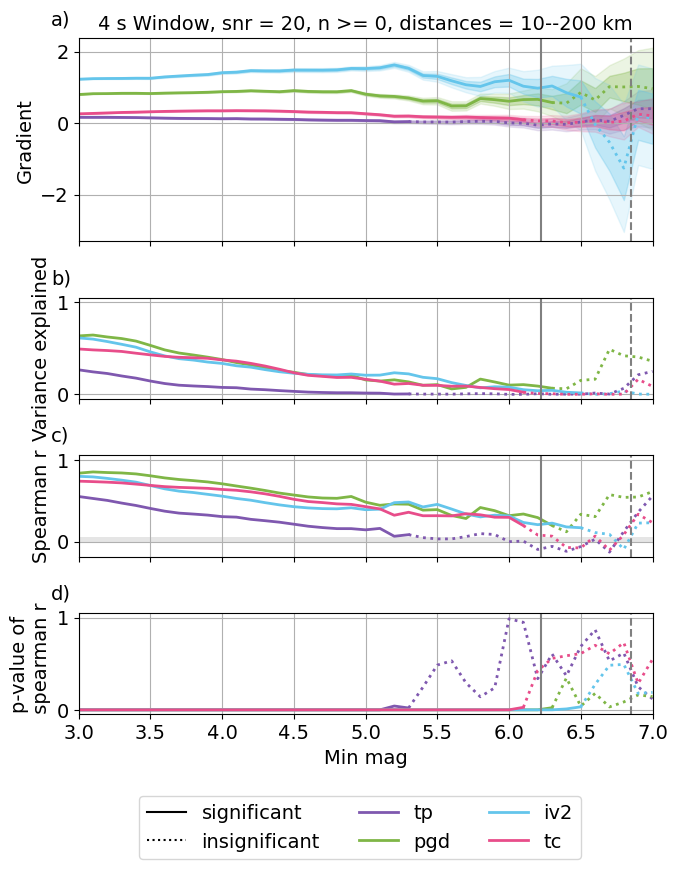

tp 0.5379687029841613
pgd 0.8372499699573678
tc 0.7329159212070104
iv2 0.8053370969216478
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


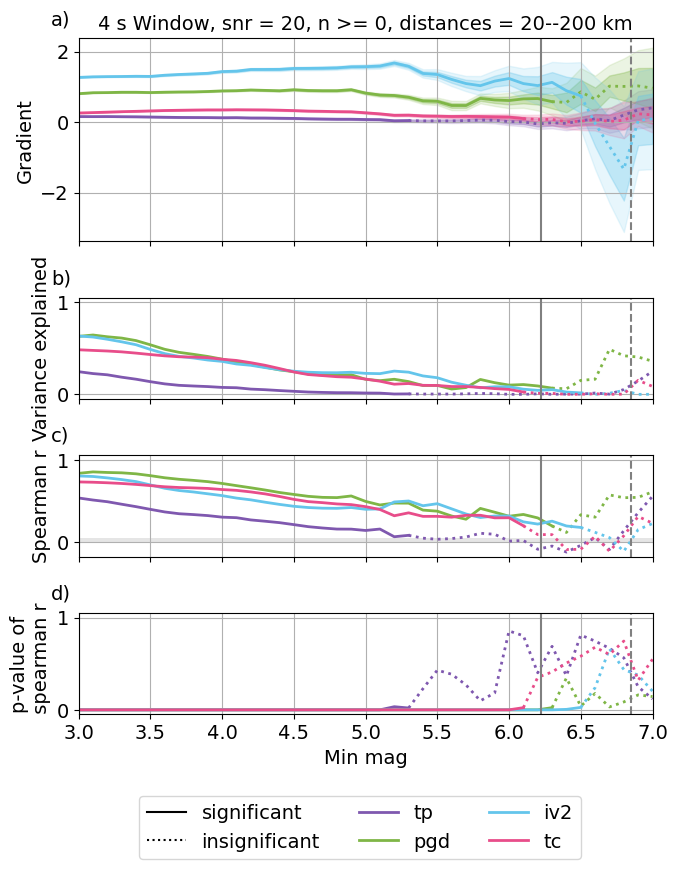

tp 0.528294131534285
pgd 0.8331719118673695
tc 0.7293394631322945
iv2 0.7974663809383677
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


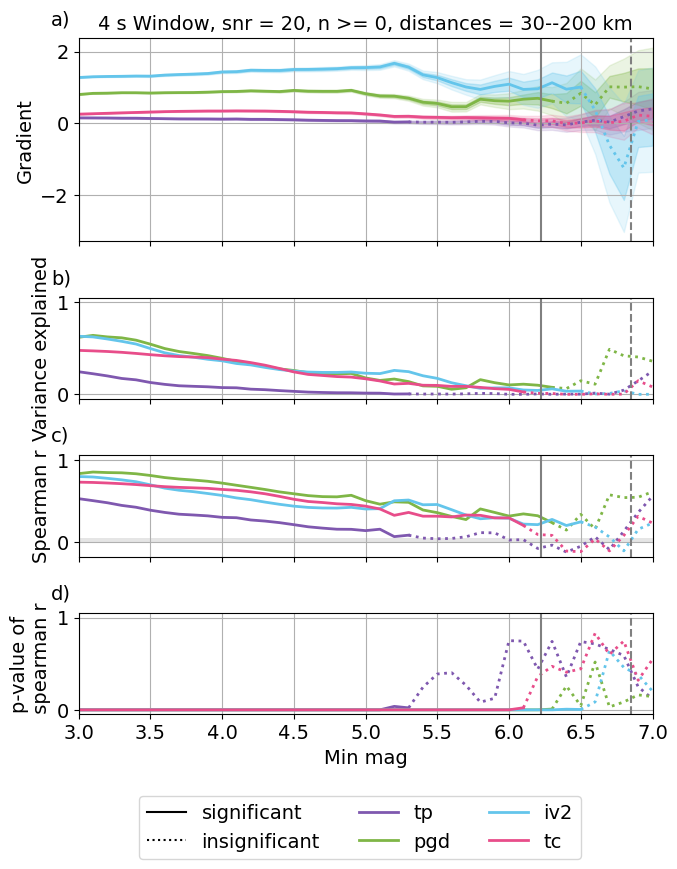

tp 0.5226879235706662
pgd 0.8245494395291202
tc 0.7262277417549126
iv2 0.7814160948074602
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


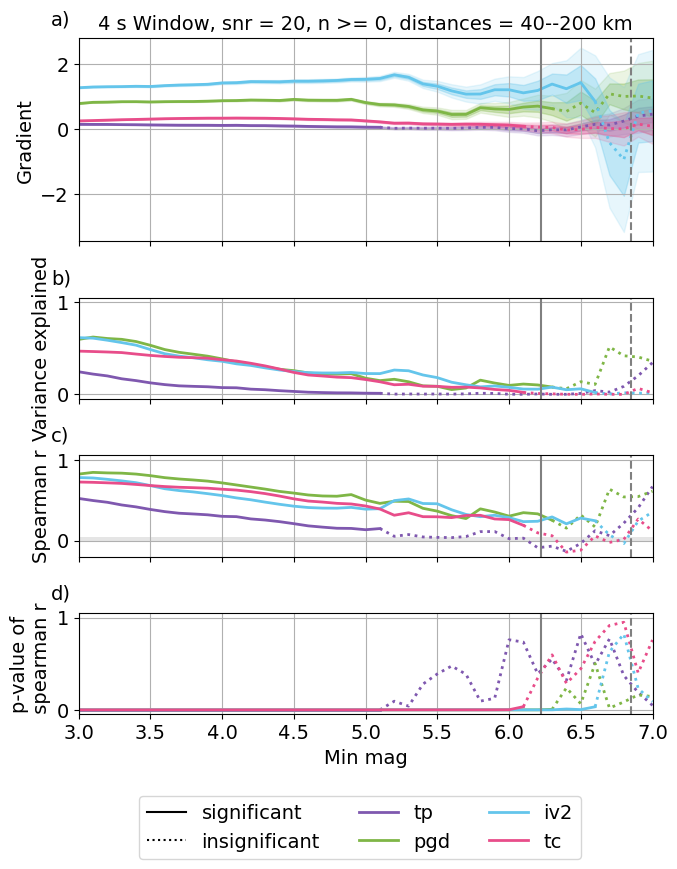

tp 0.5093089087070946
pgd 0.8193565159771364
tc 0.7186955443578372
iv2 0.778420809658278
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


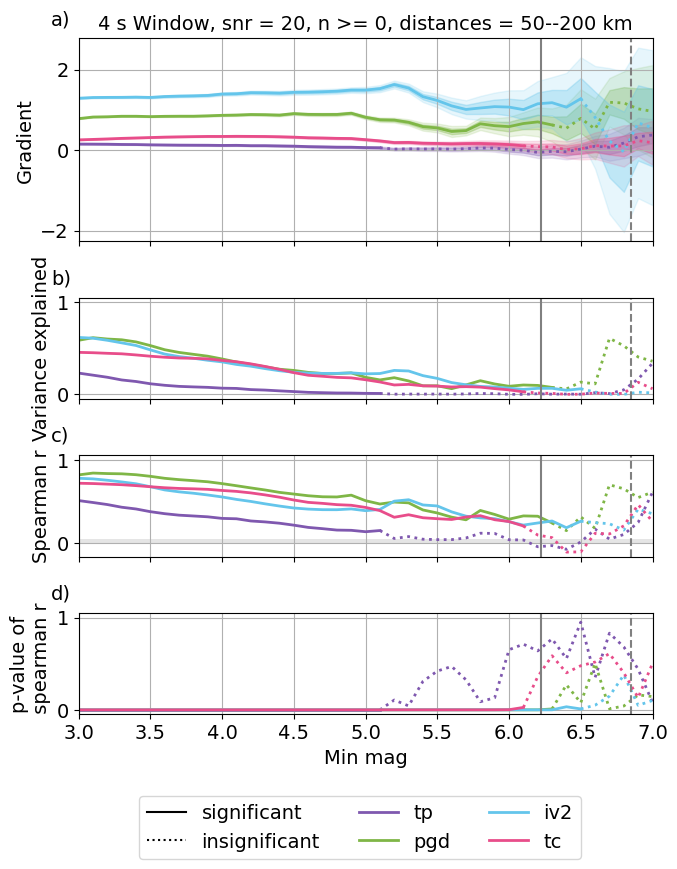

tp 0.4982473710296554
pgd 0.8127610097215017
tc 0.7077982839886544
iv2 0.7782792936617605
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


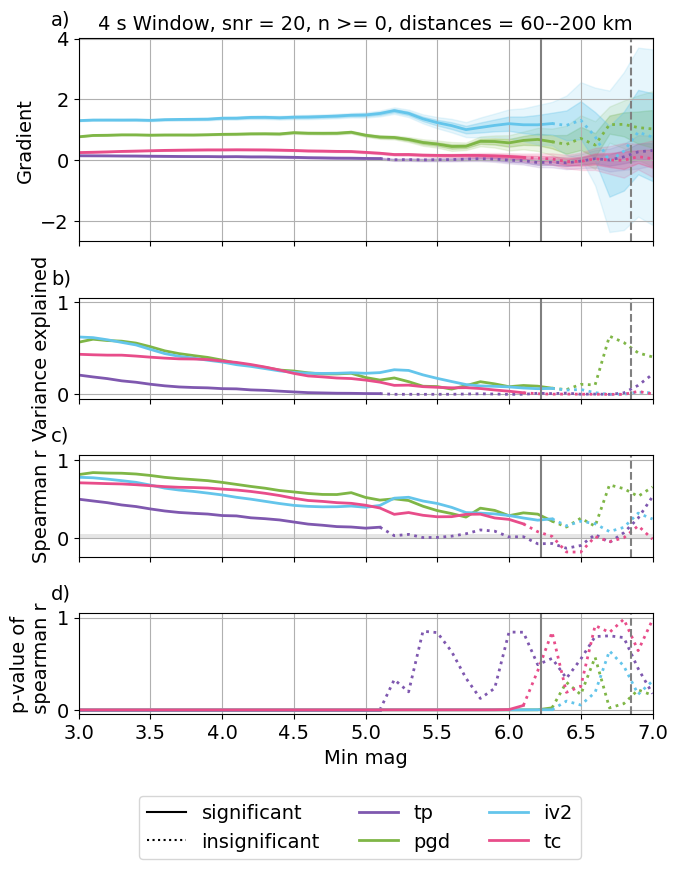

tp 0.4867767552026098
pgd 0.8023793031591886
tc 0.689086440934762
iv2 0.778134848732668
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


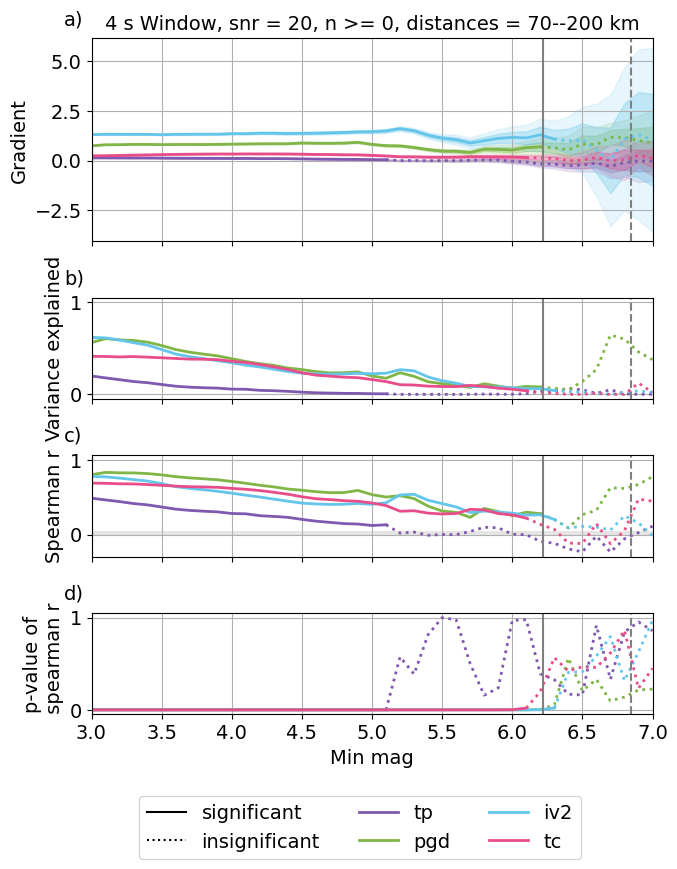

tp 0.47097042014920026
pgd 0.7826608436574285
tc 0.6665959764736218
iv2 0.7711242412497379
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


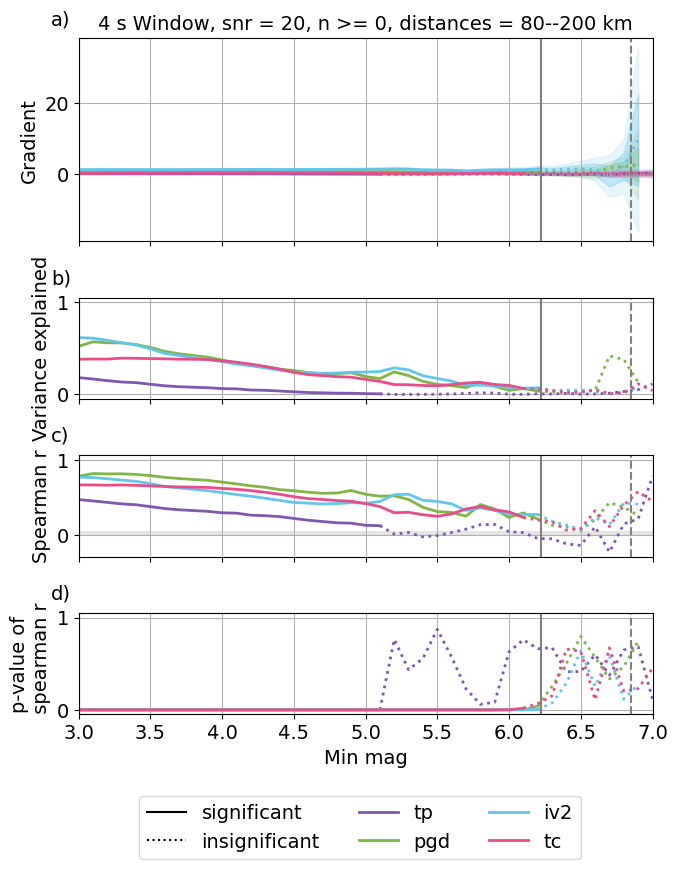

tp 0.44788078653712265
pgd 0.7547921935801893
tc 0.6448415045986837
iv2 0.757838404071535
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


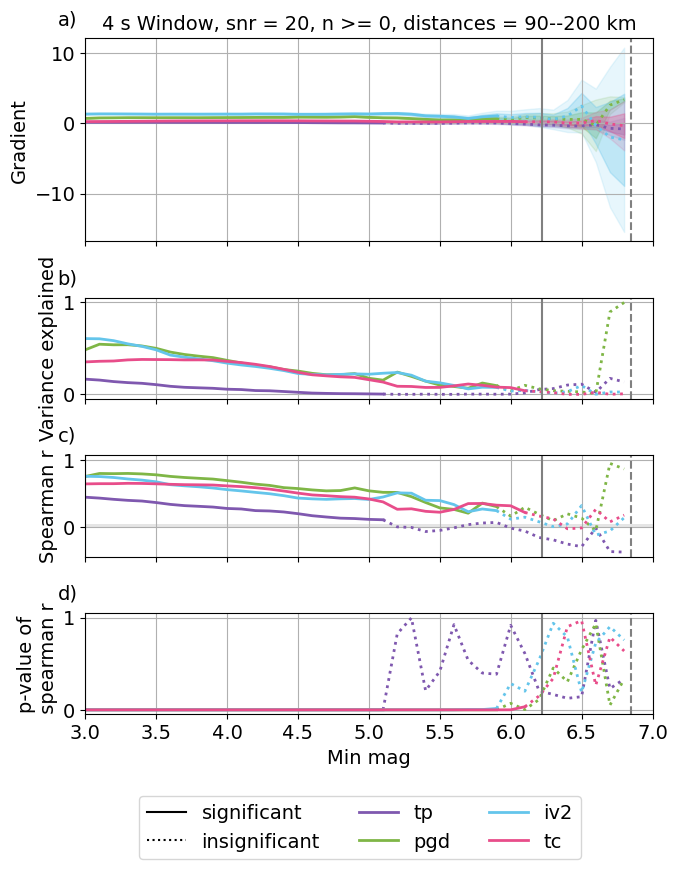

tp 0.5589298354323806
pgd 0.8376397490811472
tc 0.7456101469456294
iv2 0.7945765889796864
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


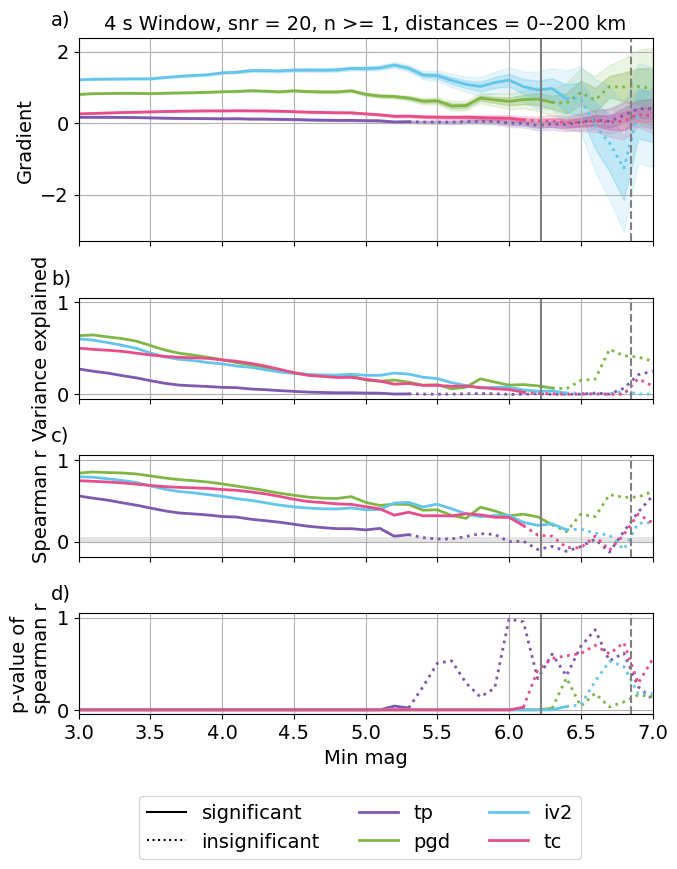

tp 0.5518215477149566
pgd 0.8375682623402342
tc 0.7398090524852872
iv2 0.7990533947638914
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


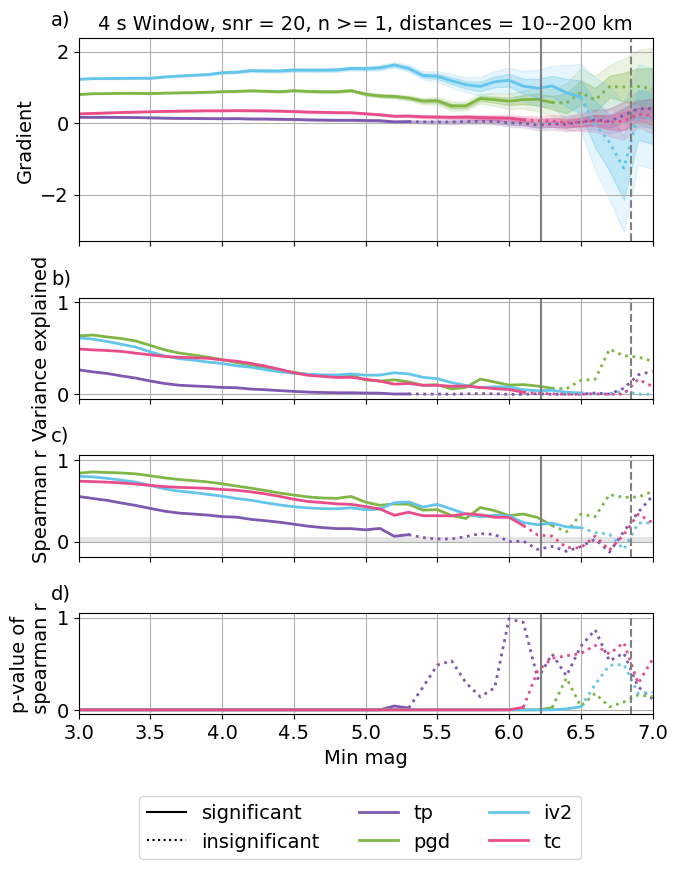

tp 0.5379687029841613
pgd 0.8372499699573678
tc 0.7329159212070104
iv2 0.8053370969216478
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


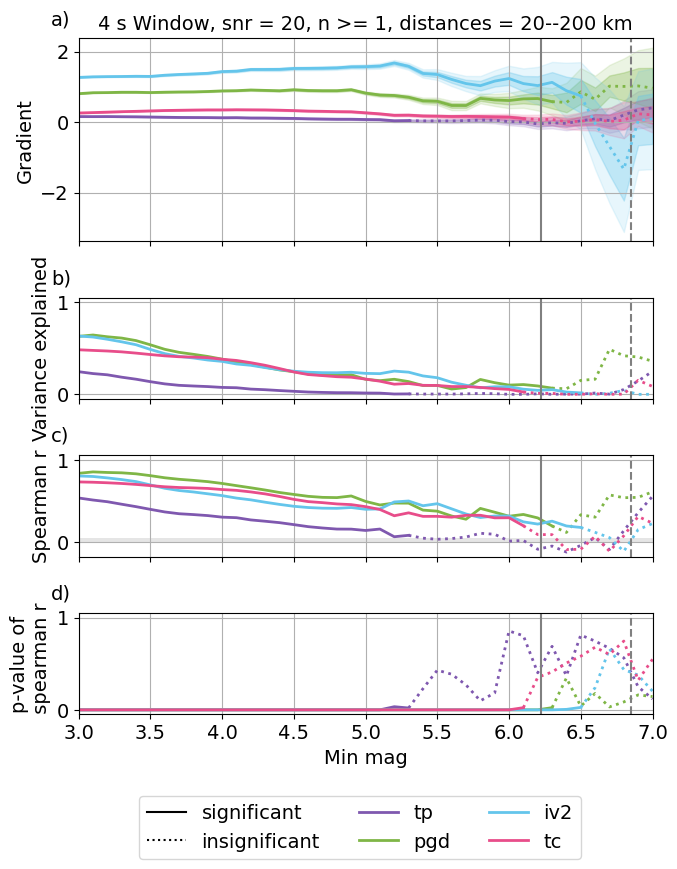

tp 0.528294131534285
pgd 0.8331719118673695
tc 0.7293394631322945
iv2 0.7974663809383677
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


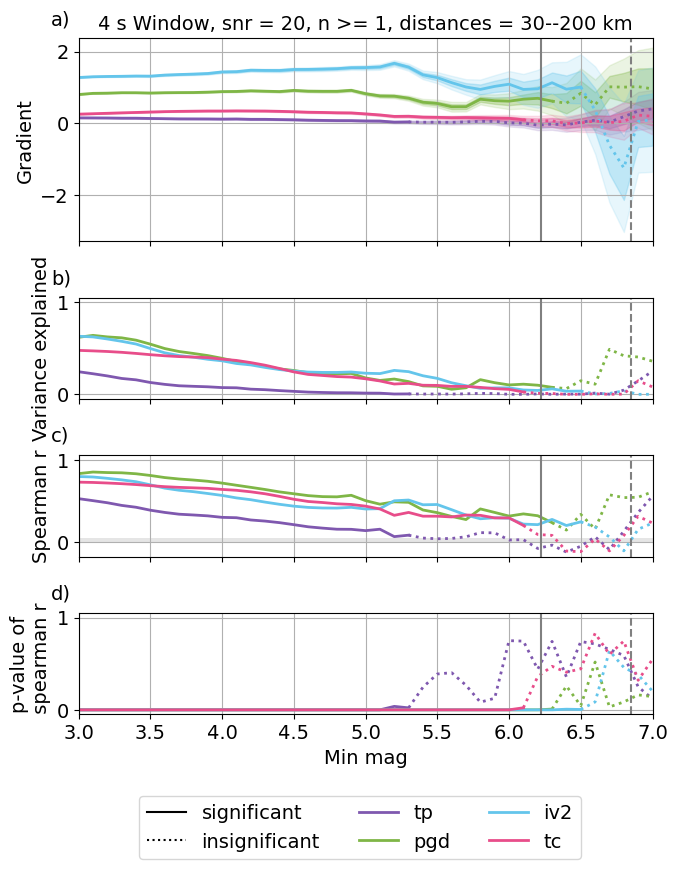

tp 0.5226879235706662
pgd 0.8245494395291202
tc 0.7262277417549126
iv2 0.7814160948074602
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


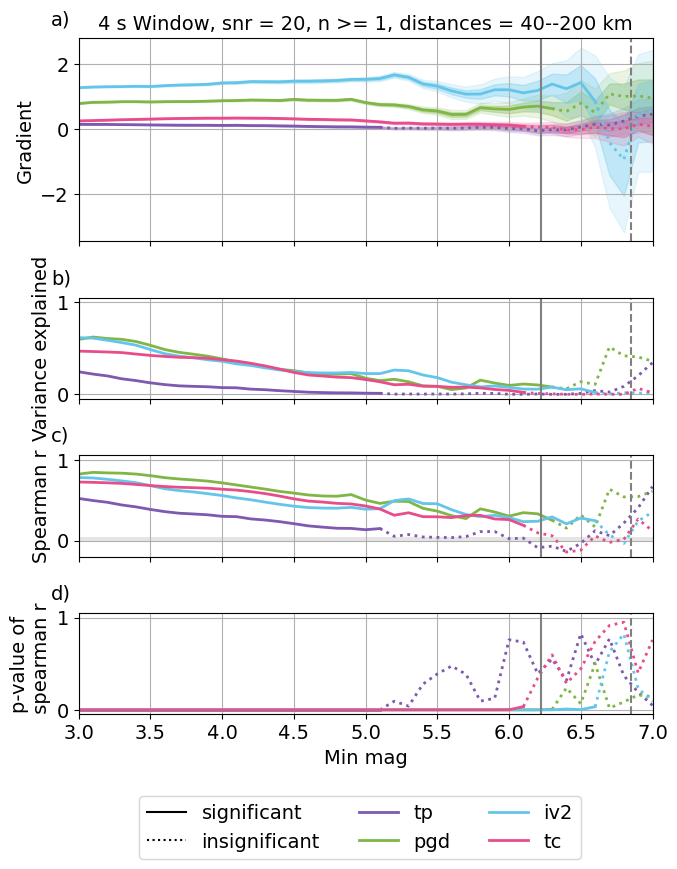

tp 0.5093089087070946
pgd 0.8193565159771364
tc 0.7186955443578372
iv2 0.778420809658278
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


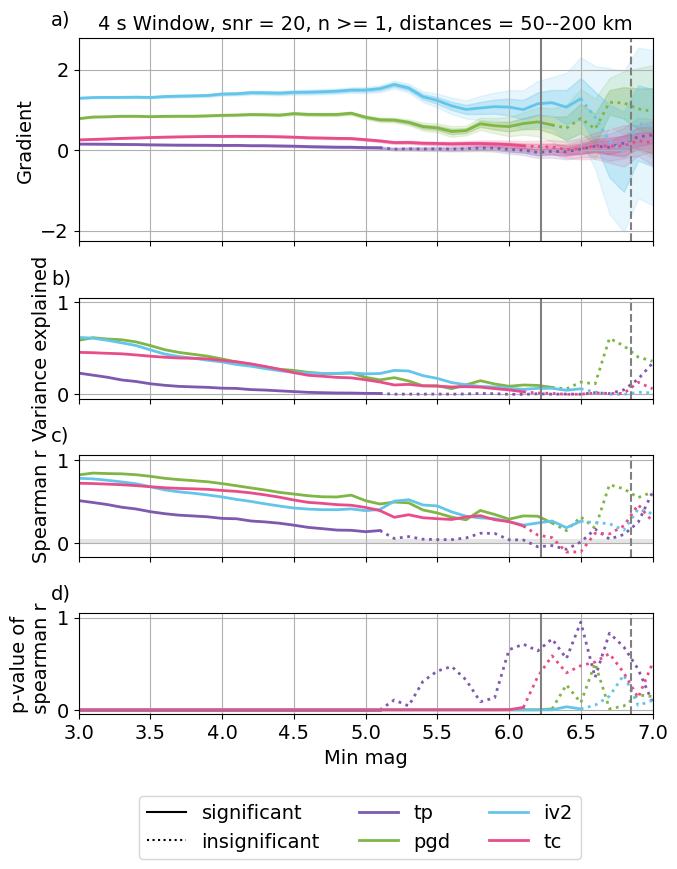

tp 0.4982473710296554
pgd 0.8127610097215017
tc 0.7077982839886544
iv2 0.7782792936617605
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


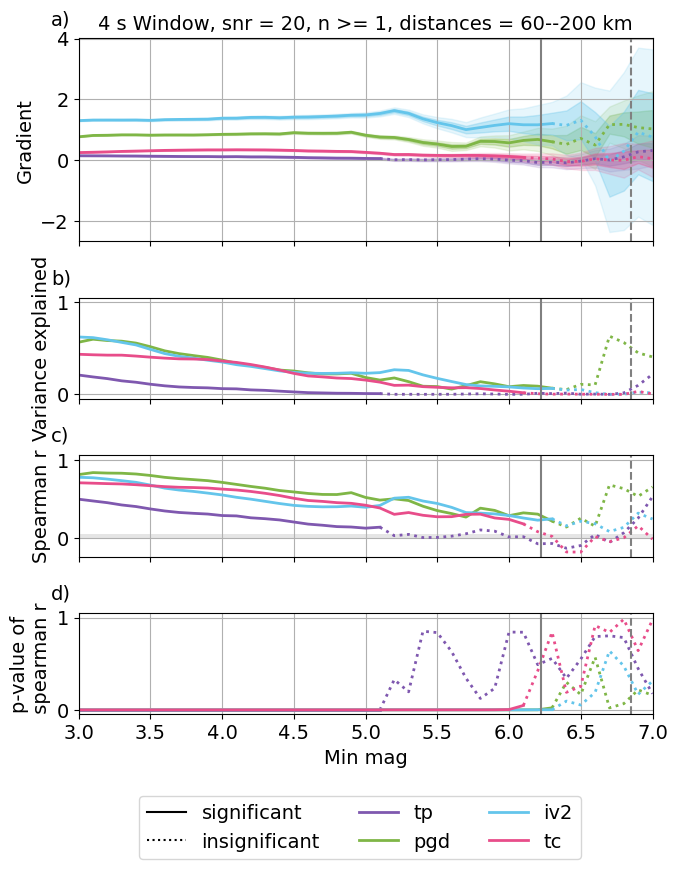

tp 0.4867767552026098
pgd 0.8023793031591886
tc 0.689086440934762
iv2 0.778134848732668
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


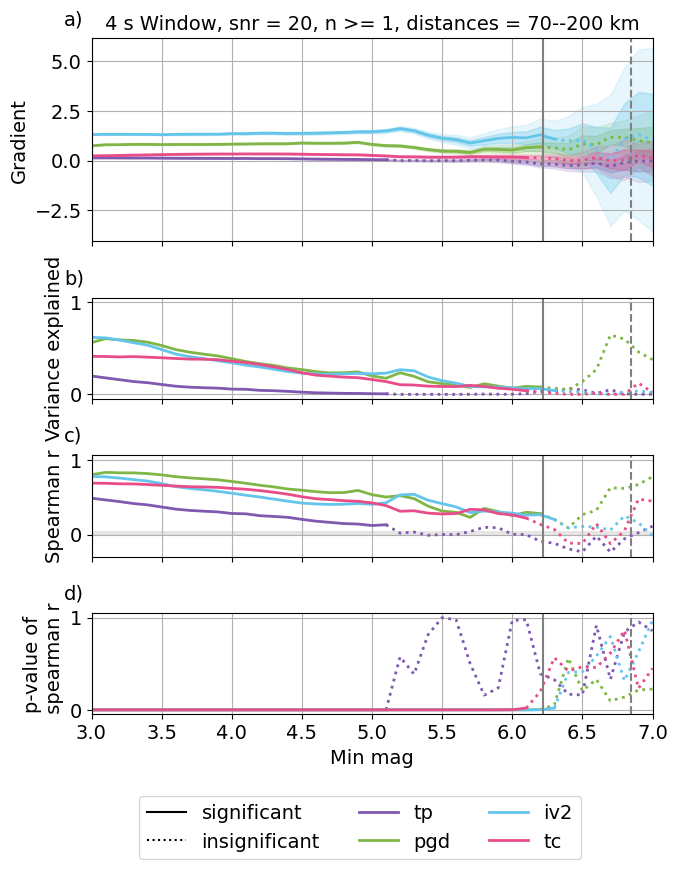

tp 0.47097042014920026
pgd 0.7826608436574285
tc 0.6665959764736218
iv2 0.7711242412497379
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


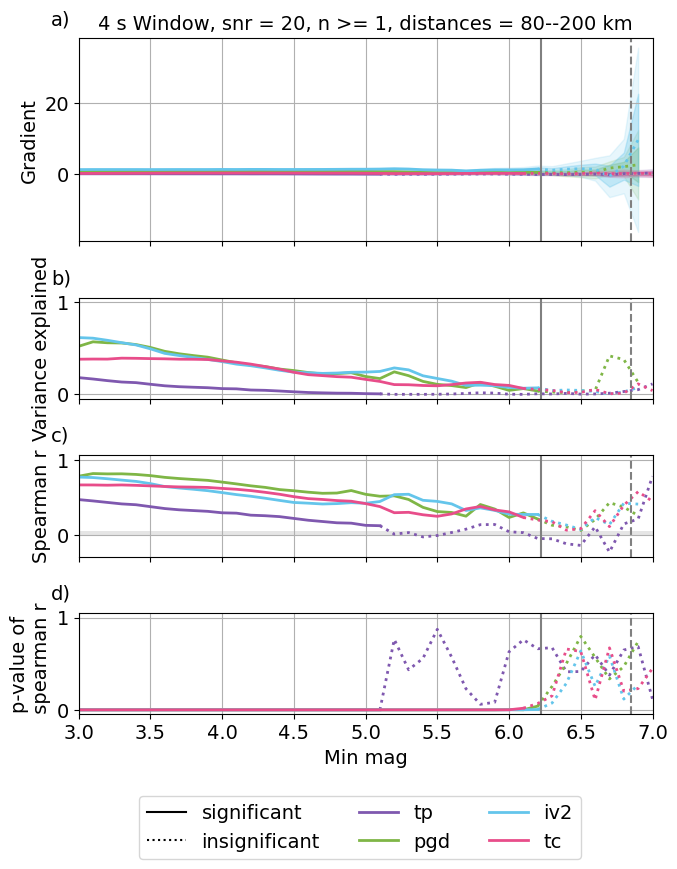

tp 0.44788078653712265
pgd 0.7547921935801893
tc 0.6448415045986837
iv2 0.757838404071535
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


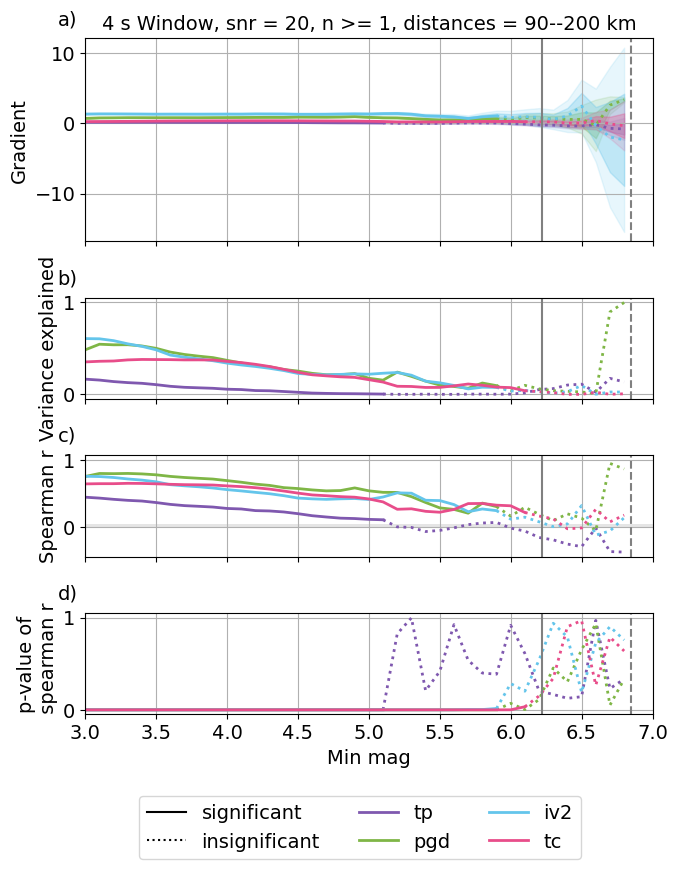

tp 0.6460977867837192
pgd 0.8393424123572862
tc 0.7663879253164962
iv2 0.7995239433131685
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


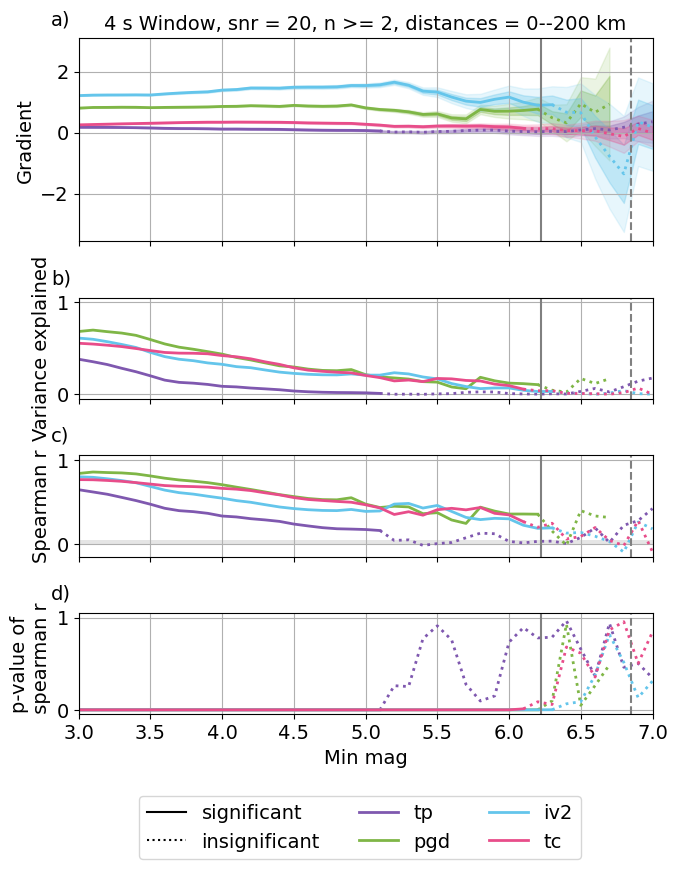

tp 0.6396858452400512
pgd 0.8395246688425204
tc 0.7584404080886217
iv2 0.8045081072329145
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


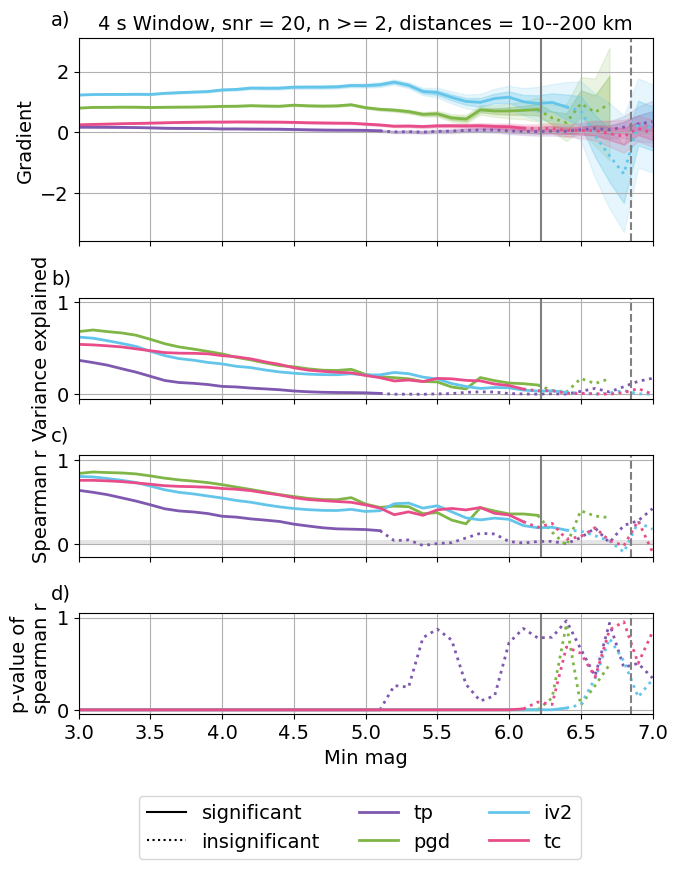

tp 0.6226389242625888
pgd 0.8393084120032746
tc 0.7489974593650693
iv2 0.8113405748456635
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


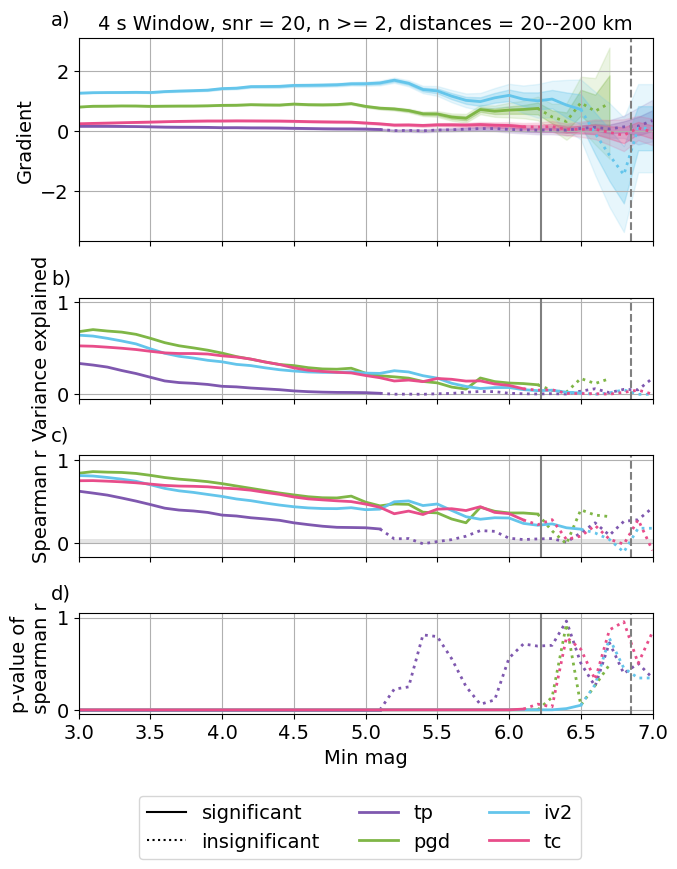

tp 0.6103672026185848
pgd 0.835728228291805
tc 0.7427024168244725
iv2 0.8038589295565094
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


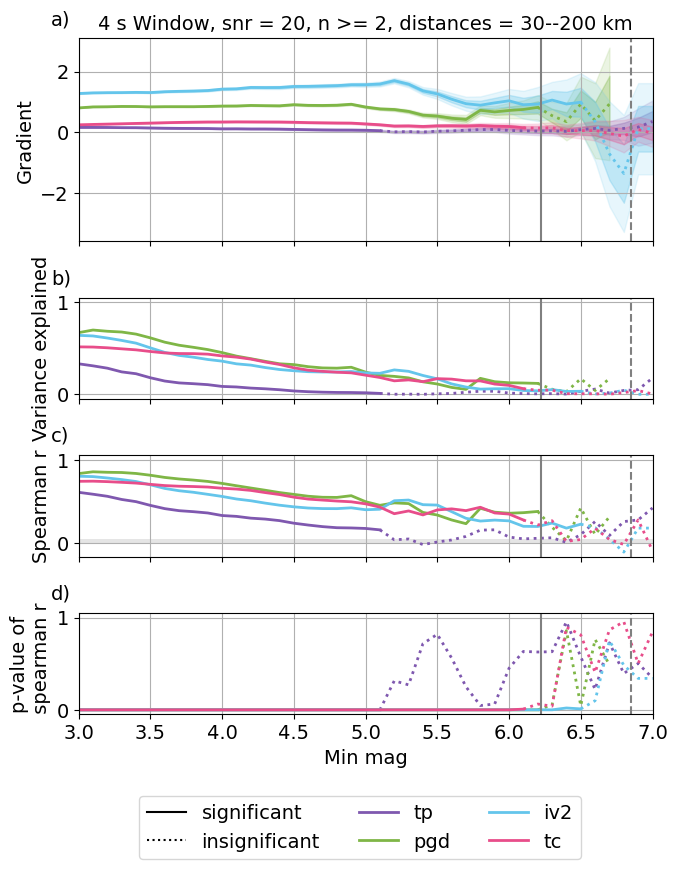

tp 0.6038621716866486
pgd 0.827624993357435
tc 0.7408696810462901
iv2 0.788187763349663
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


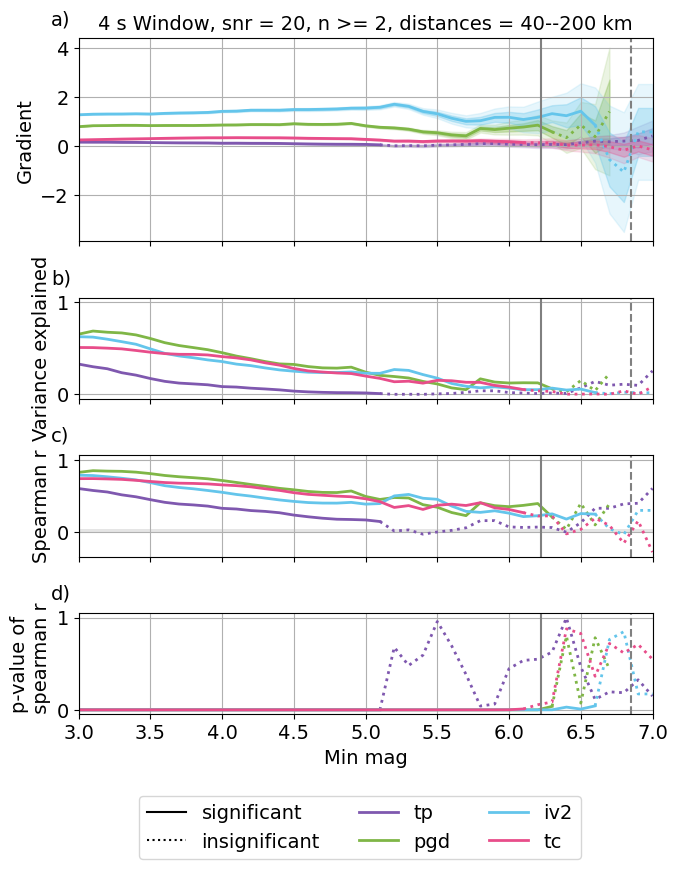

tp 0.5878484181371209
pgd 0.8227050911731247
tc 0.7317408073660118
iv2 0.7869008519666897
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


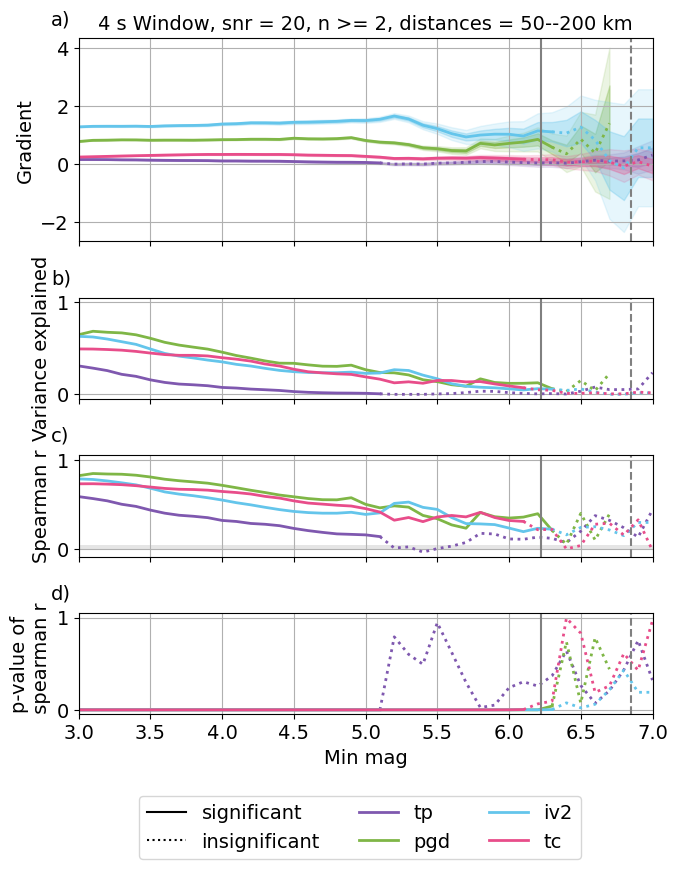

tp 0.5753071213014717
pgd 0.8161535154149928
tc 0.7208262134837881
iv2 0.7879235126796714
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


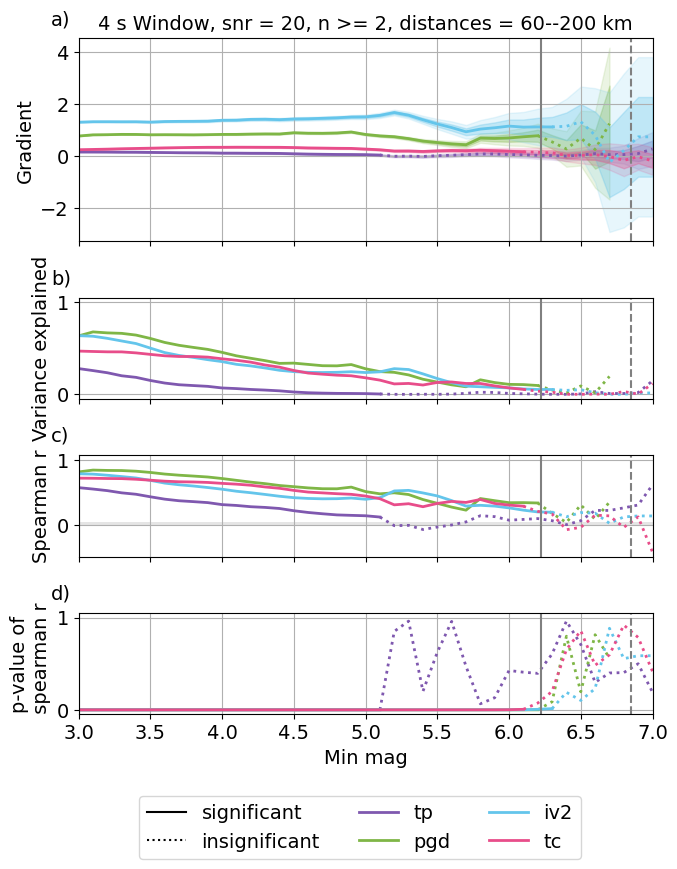

tp 0.5601584937051868
pgd 0.8044131922030936
tc 0.6966619378863051
iv2 0.7890940876940054
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


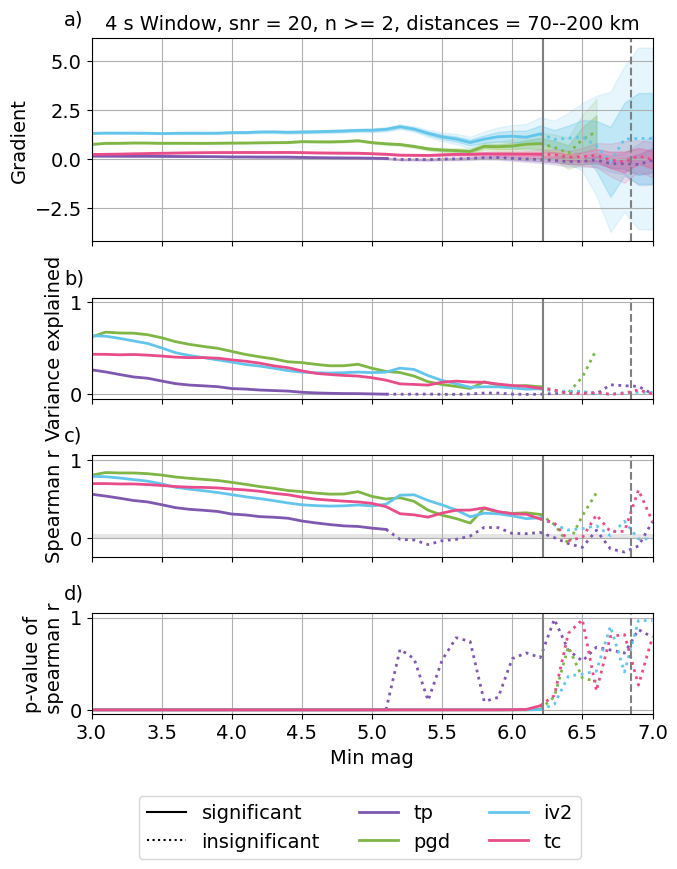

tp 0.5335921194865892
pgd 0.7843089639395048
tc 0.6679667397207311
iv2 0.7856038708657668
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


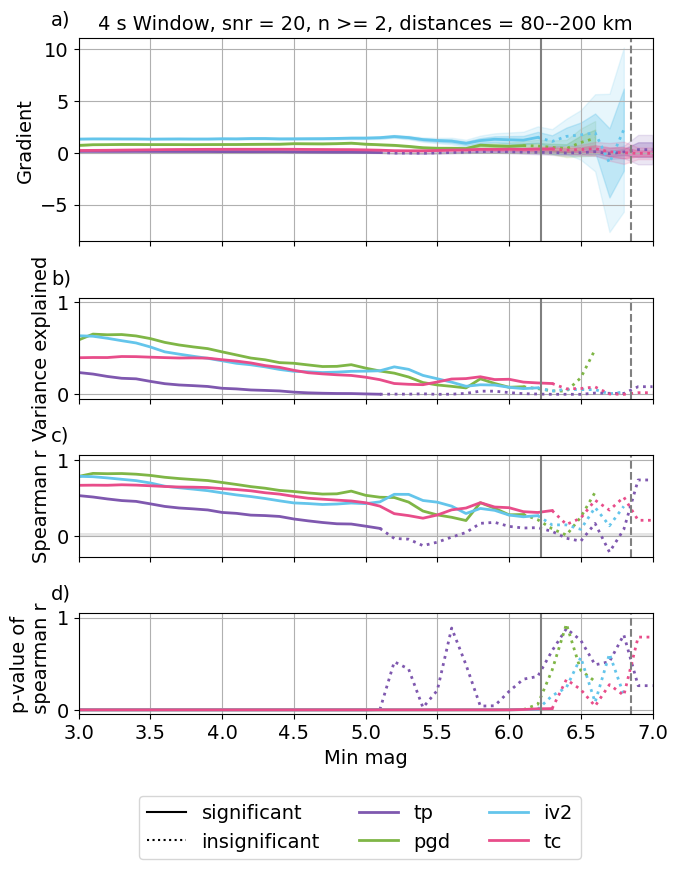

tp 0.5026155771566256
pgd 0.7543057791098645
tc 0.6389248742490958
iv2 0.7765527551175747
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


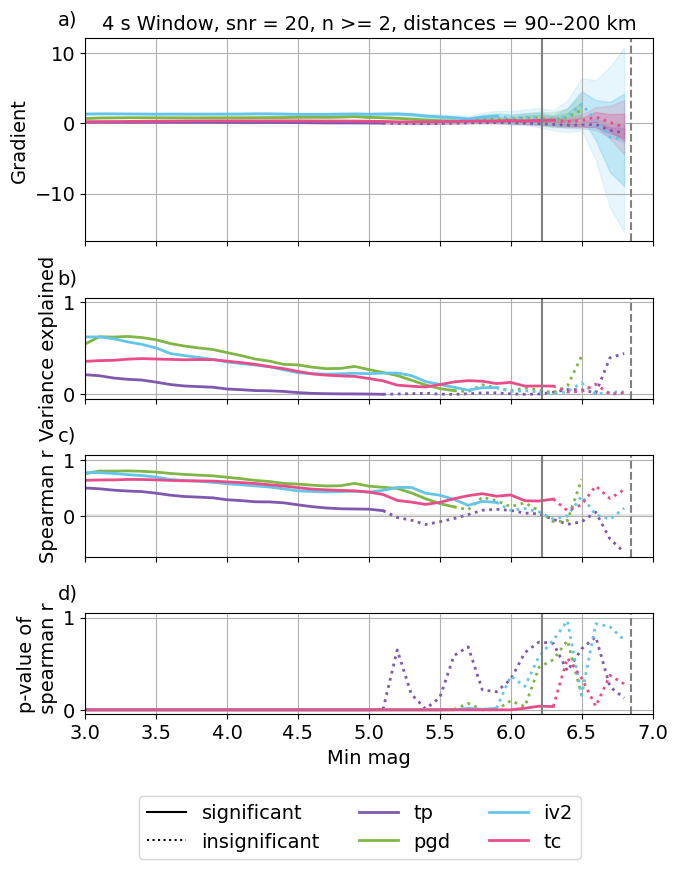

tp 0.6946650175705977
pgd 0.8380847213682087
tc 0.7781804151949915
iv2 0.8011586511657912
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


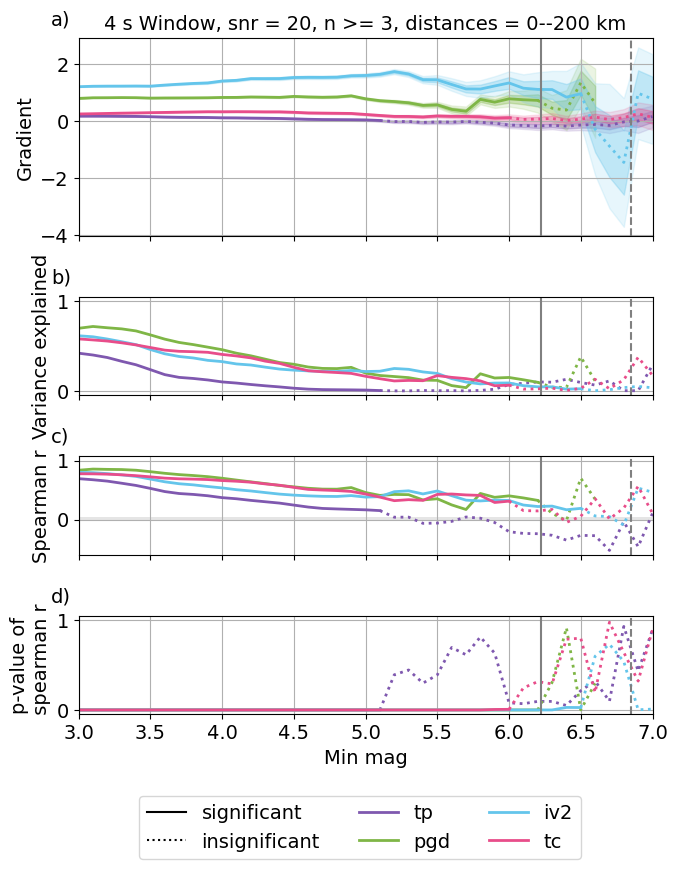

tp 0.693155824711503
pgd 0.8387799366976685
tc 0.7710319085659096
iv2 0.8068325704908493
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


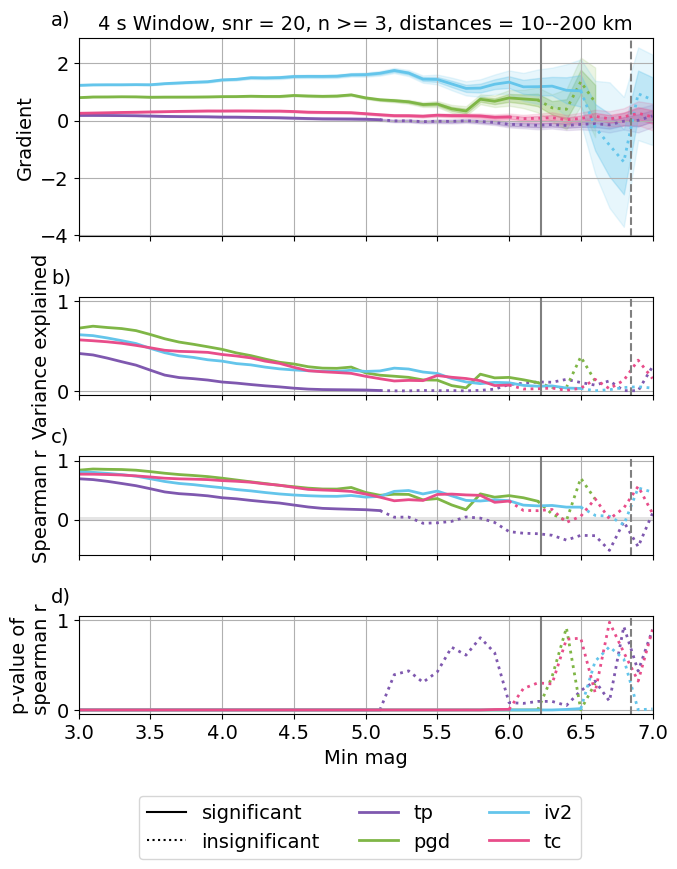

tp 0.6791669566533418
pgd 0.8389812921676627
tc 0.7612563015962077
iv2 0.8154697373027381
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


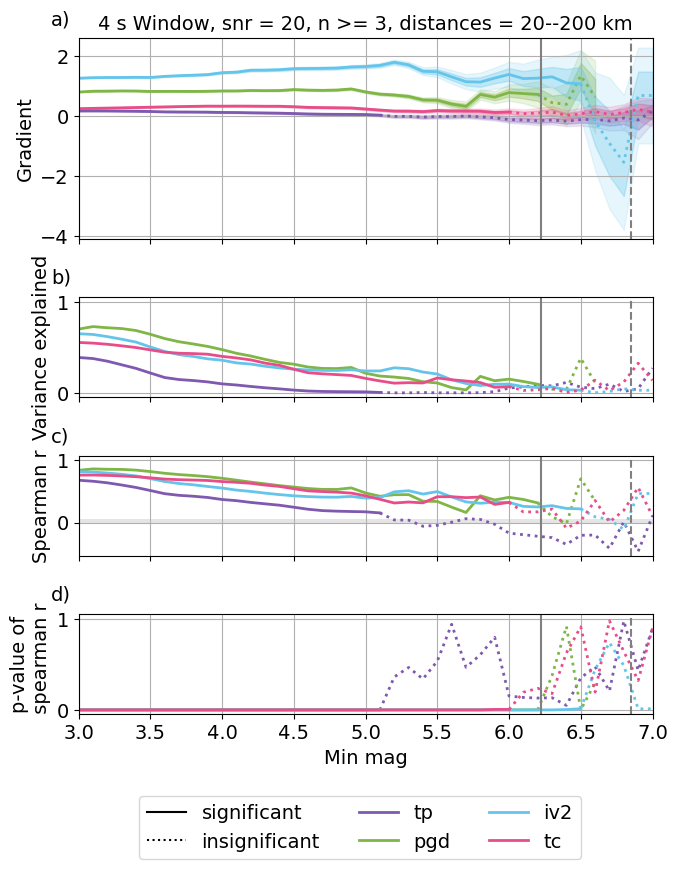

tp 0.6679520121262058
pgd 0.8358576584487968
tc 0.7546209109216871
iv2 0.8092812367291082
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


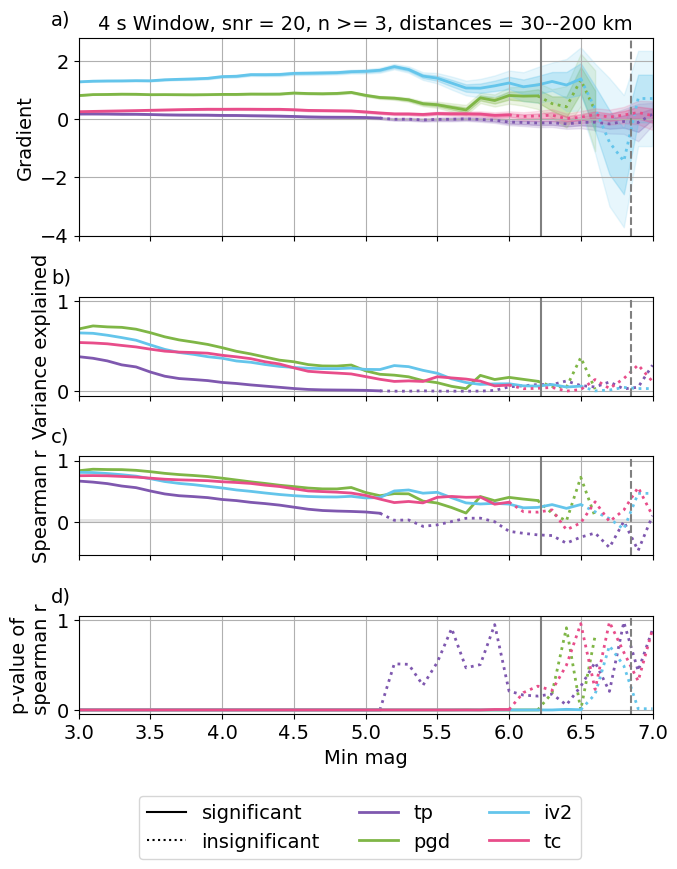

tp 0.6599520107053216
pgd 0.8279733863645122
tc 0.74870577246863
iv2 0.7951982407957457
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


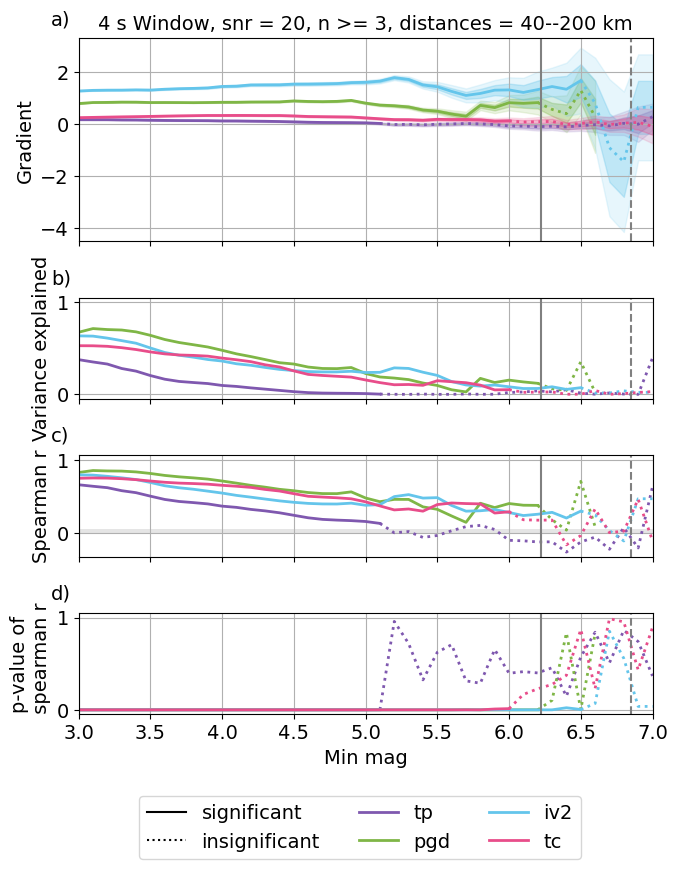

tp 0.6465001164652044
pgd 0.8233707623050817
tc 0.7378358339906899
iv2 0.7949133032402252
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


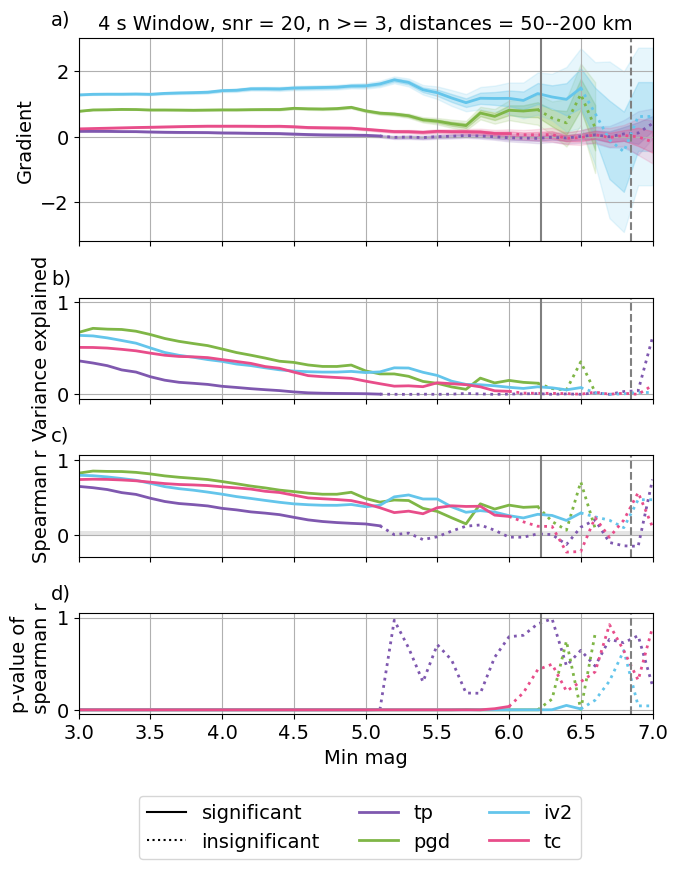

tp 0.6361306612296233
pgd 0.8166653652012732
tc 0.7281102146789193
iv2 0.7980258511210051
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


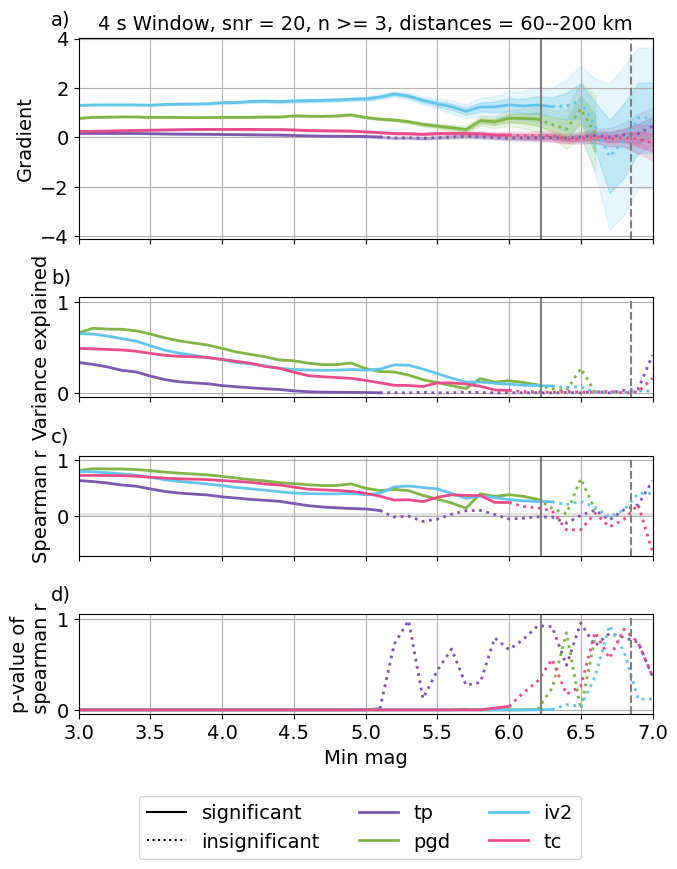

tp 0.6277979580255502
pgd 0.8038910474171663
tc 0.7026615641038071
iv2 0.7977947235496607
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


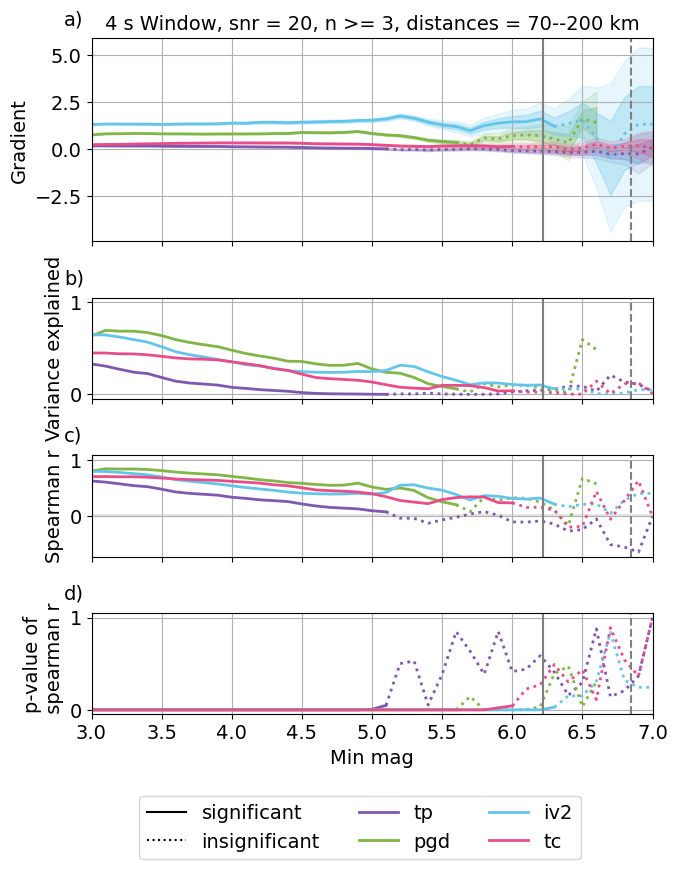

tp 0.5910172097439326
pgd 0.7820744050389621
tc 0.6743091191417295
iv2 0.7921216064288216
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


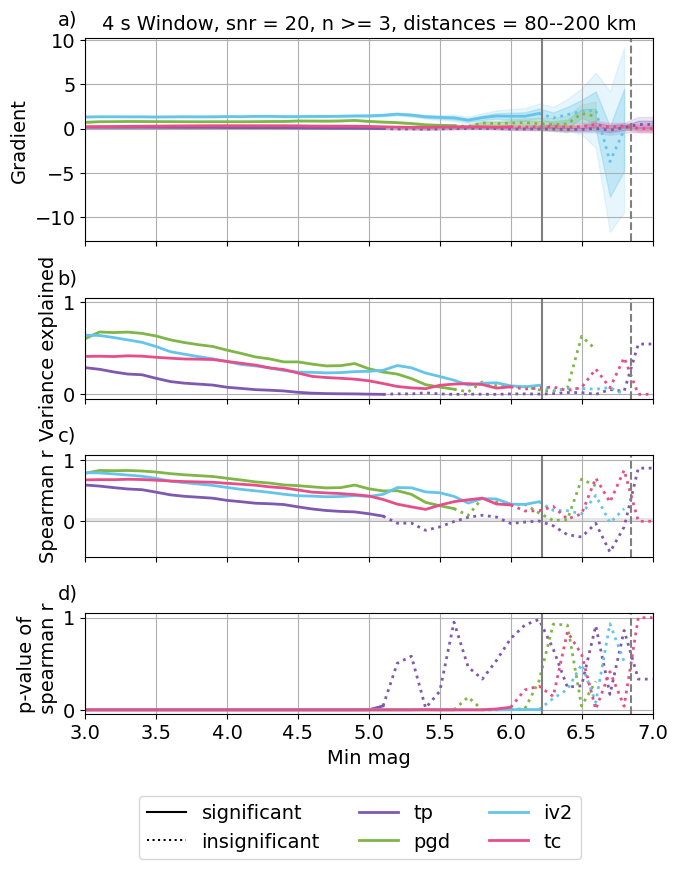

tp 0.5590452952398094
pgd 0.7493831269974847
tc 0.6432279466580992
iv2 0.7852137572129446
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


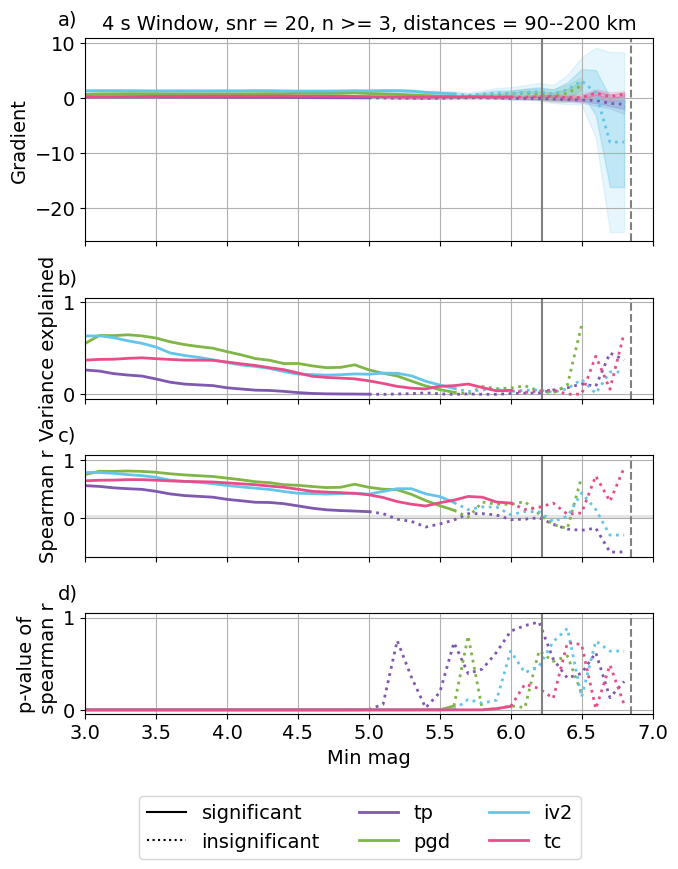

tp 0.7345487518101036
pgd 0.8350774239721517
tc 0.7859963645898108
iv2 0.8018913190937438
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


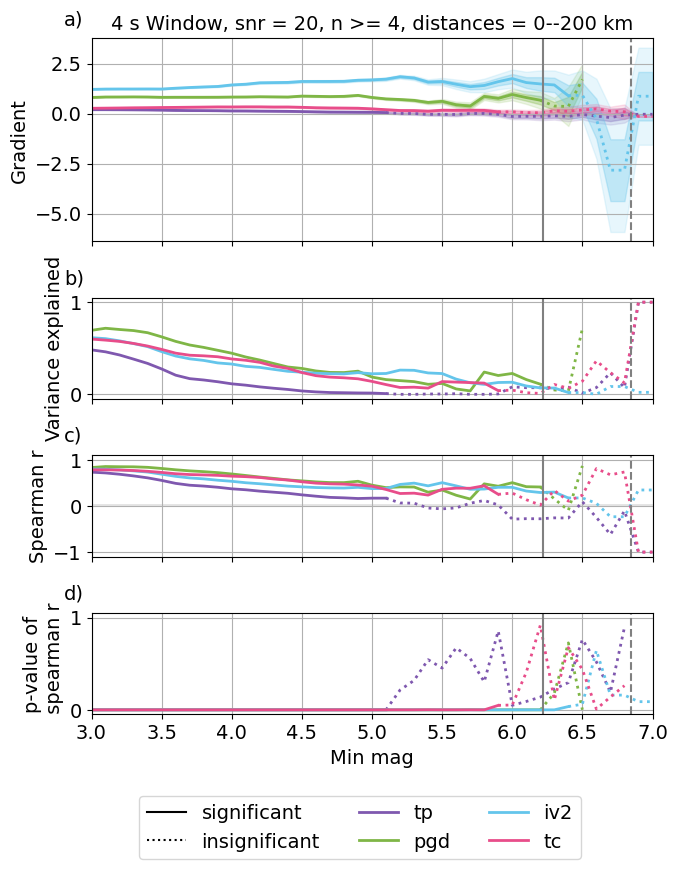

tp 0.7307914412970626
pgd 0.8361806796779568
tc 0.778962609657385
iv2 0.8083346019364243
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


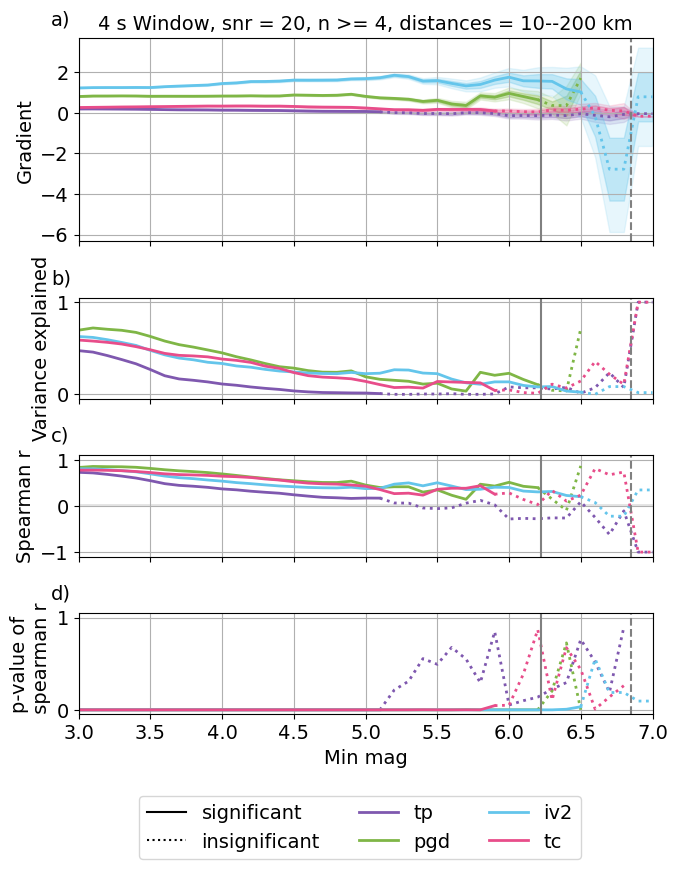

tp 0.7185220836450076
pgd 0.8363819528113944
tc 0.7692273482739557
iv2 0.818712303174199
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


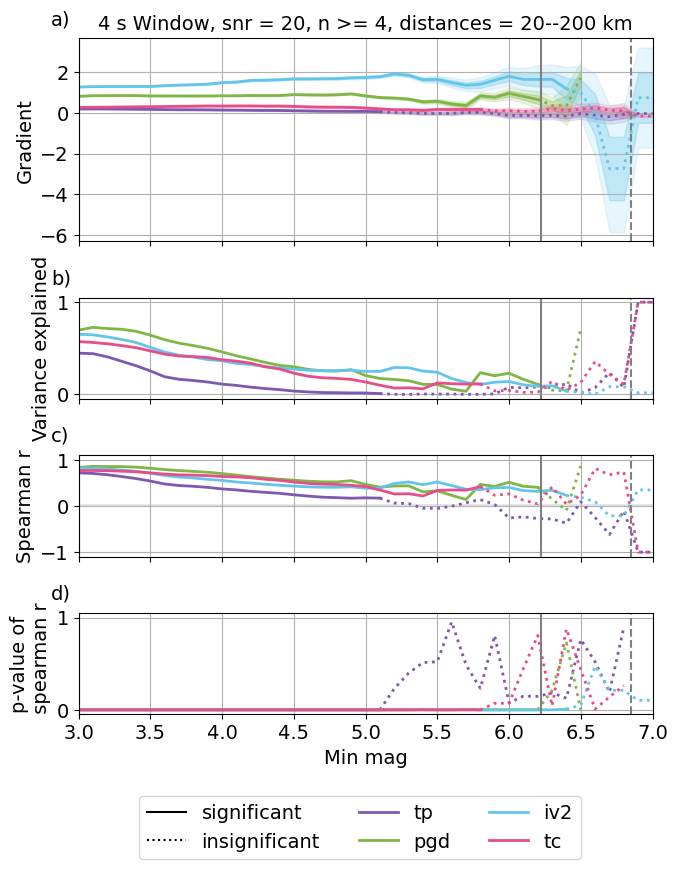

tp 0.70617907946286
pgd 0.8331831577186075
tc 0.7641009168653873
iv2 0.8142475692397064
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


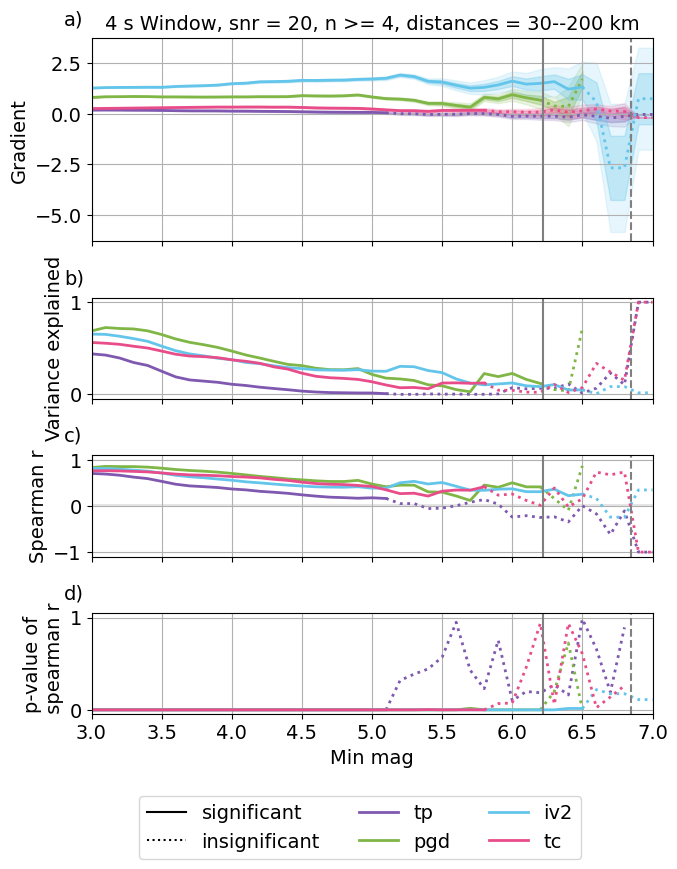

tp 0.6960319780657772
pgd 0.8251927525452767
tc 0.7549887429339013
iv2 0.8017222401226434
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


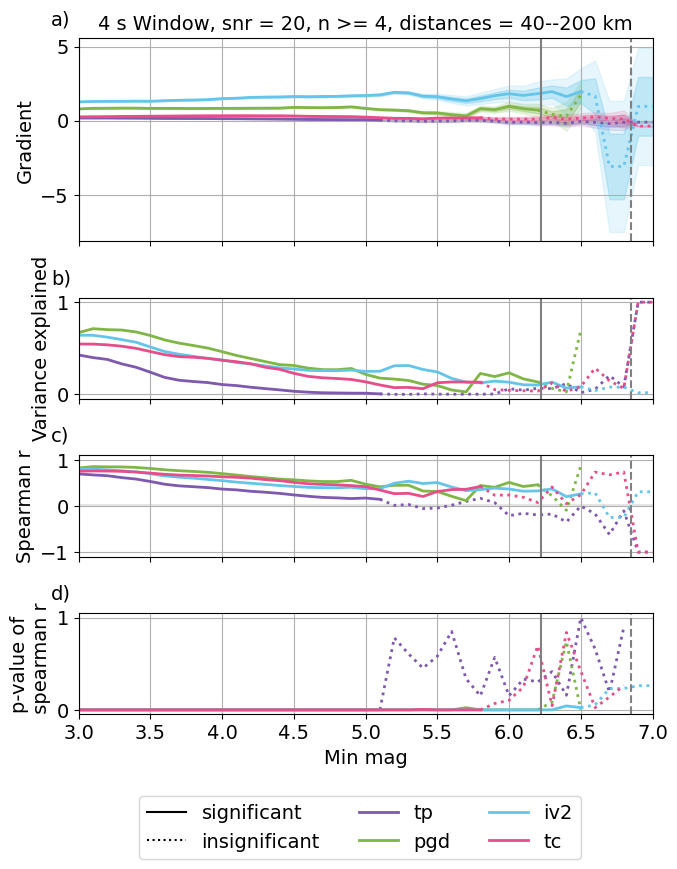

tp 0.6801510317128479
pgd 0.820538822711722
tc 0.7457899186272391
iv2 0.8034144958286963
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


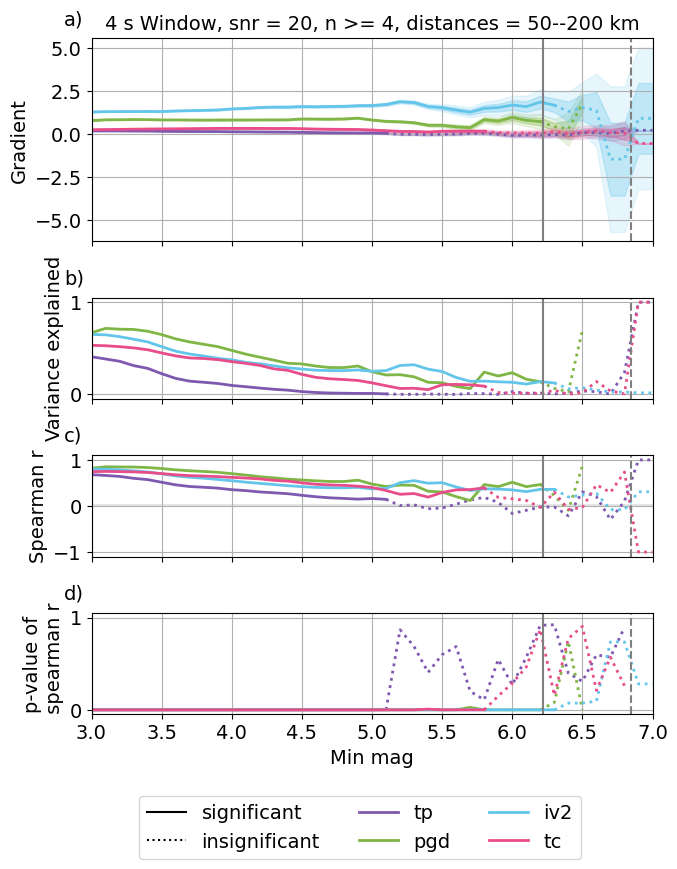

tp 0.6661462101766538
pgd 0.8129661274304677
tc 0.7302740594132942
iv2 0.8079679981280296
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


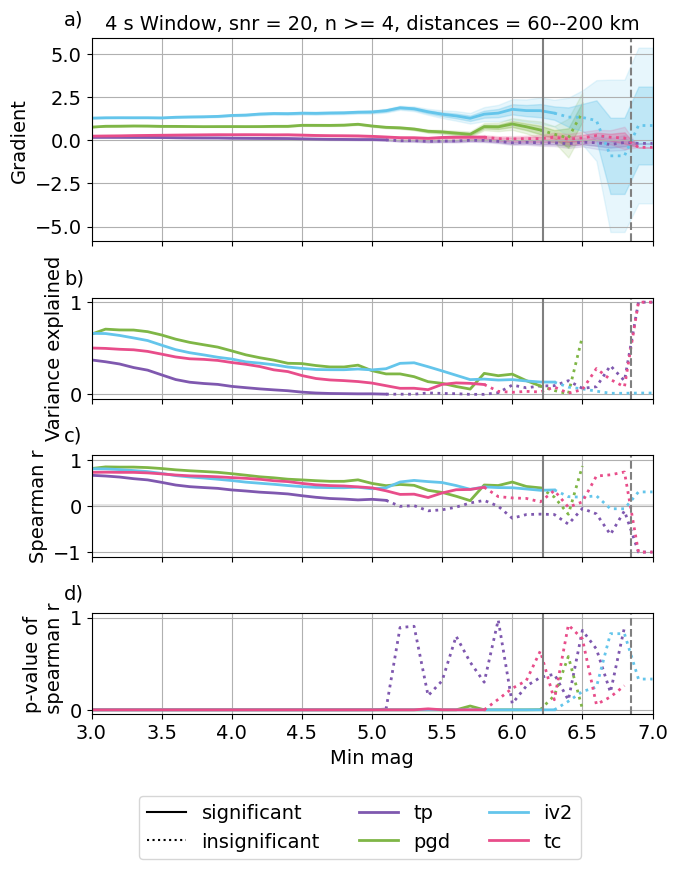

tp 0.6542012754058919
pgd 0.7994353075612548
tc 0.7032933439098128
iv2 0.8099983492868491
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


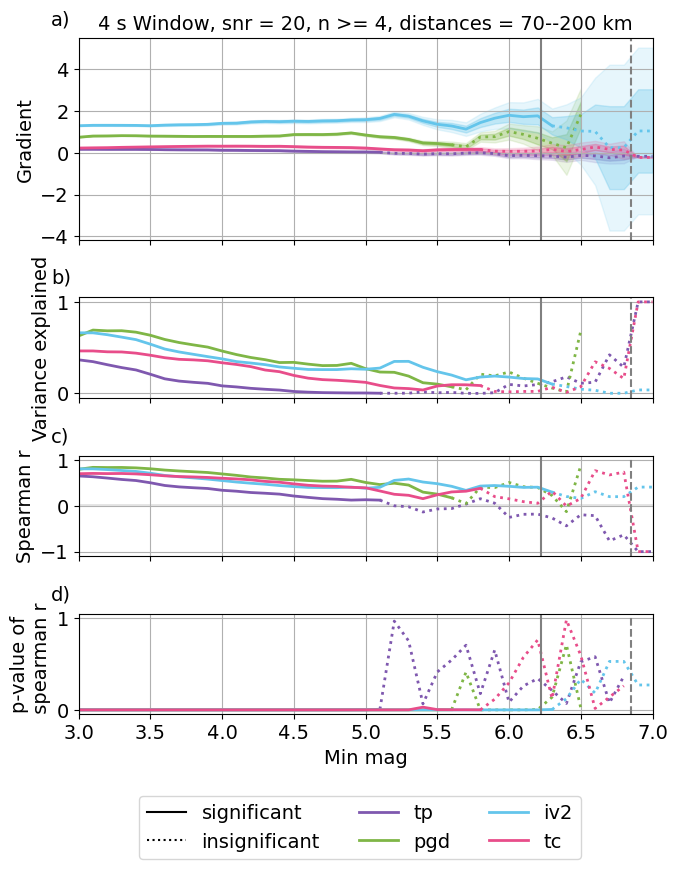

tp 0.618801740613287
pgd 0.7769797956225284
tc 0.6754958901753398
iv2 0.8089490722764898
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


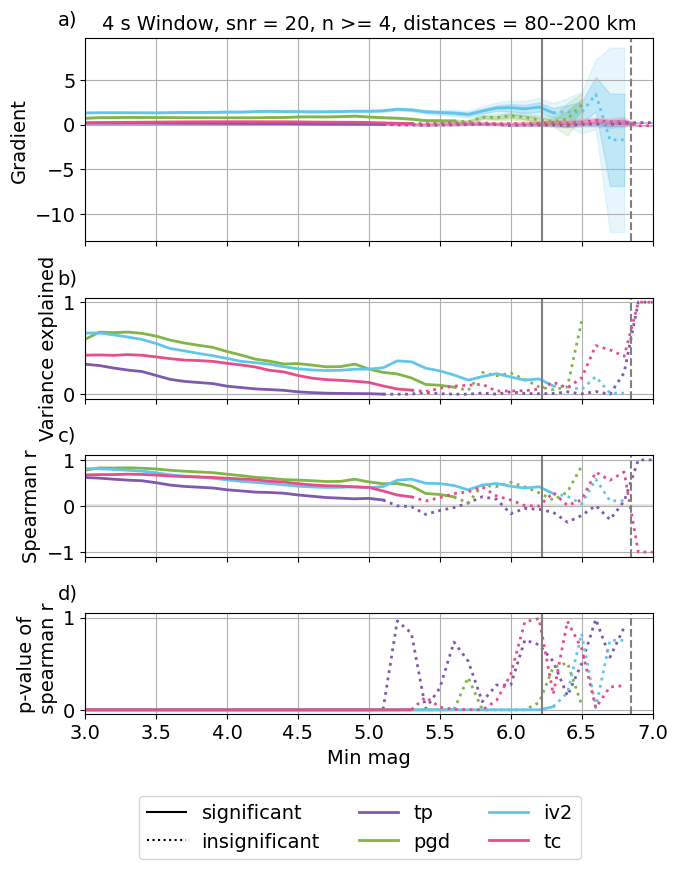

tp 0.5825047623657463
pgd 0.7420742007601674
tc 0.6456350903024324
iv2 0.8023315627486158
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


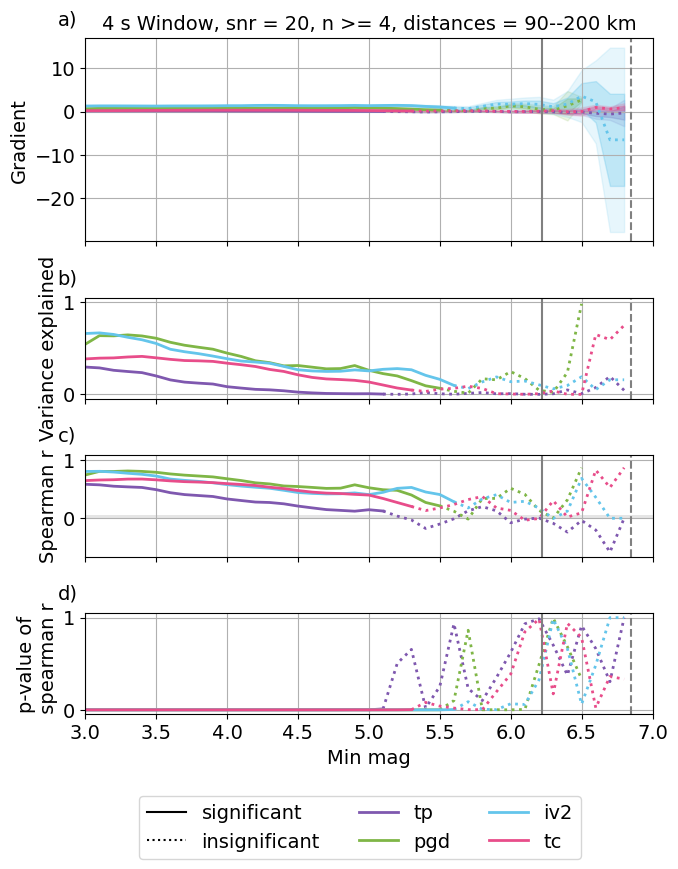

tp 0.7584939332358727
pgd 0.831683563115312
tc 0.8012112191658836
iv2 0.8034864698034565
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


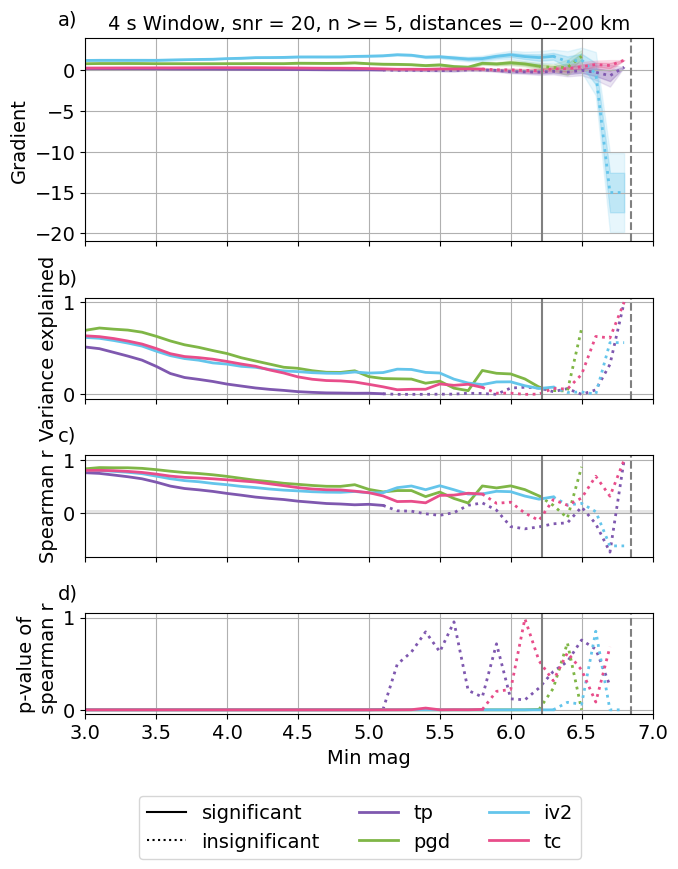

tp 0.7564197147502523
pgd 0.8333215465513754
tc 0.7951717436886775
iv2 0.8106509463844143
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


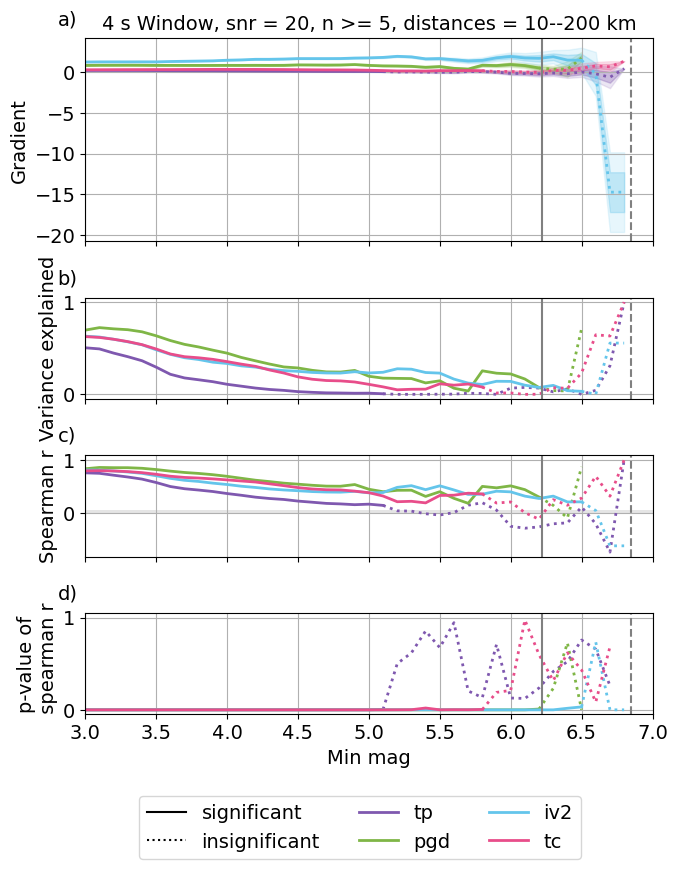

tp 0.7419636936711371
pgd 0.8340373642666841
tc 0.7857912332679361
iv2 0.8227462604923302
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


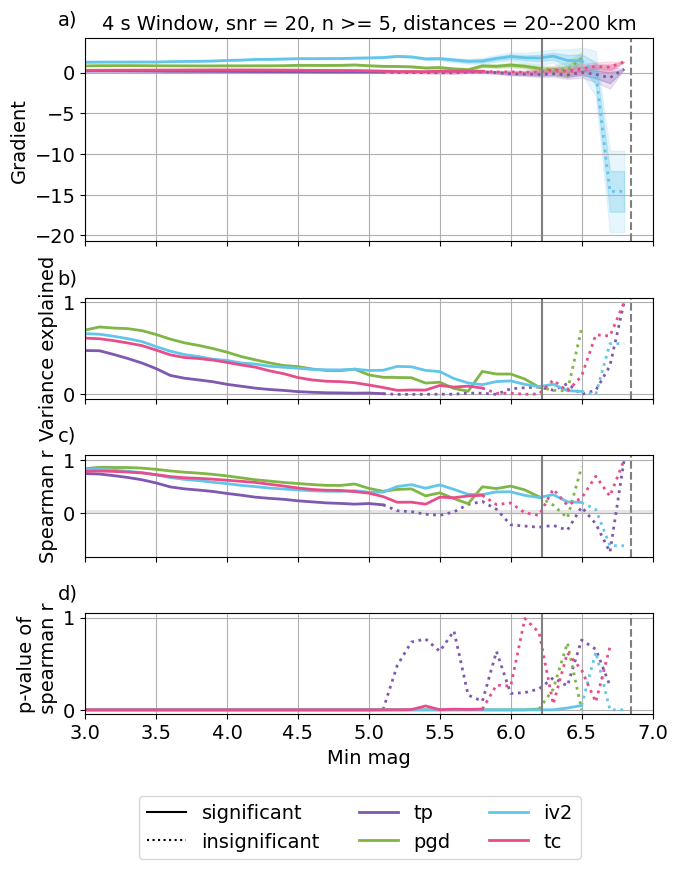

tp 0.7327238479746317
pgd 0.8314495114884077
tc 0.7809958476389816
iv2 0.8197045072016058
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


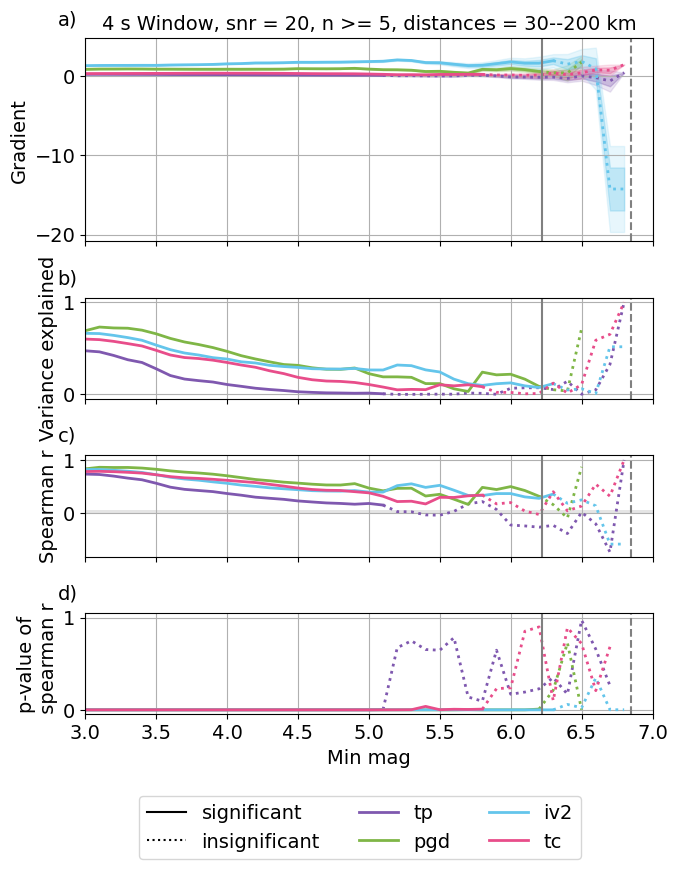

tp 0.7219792177469488
pgd 0.8239799768431756
tc 0.7686332004961612
iv2 0.807996048344494
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


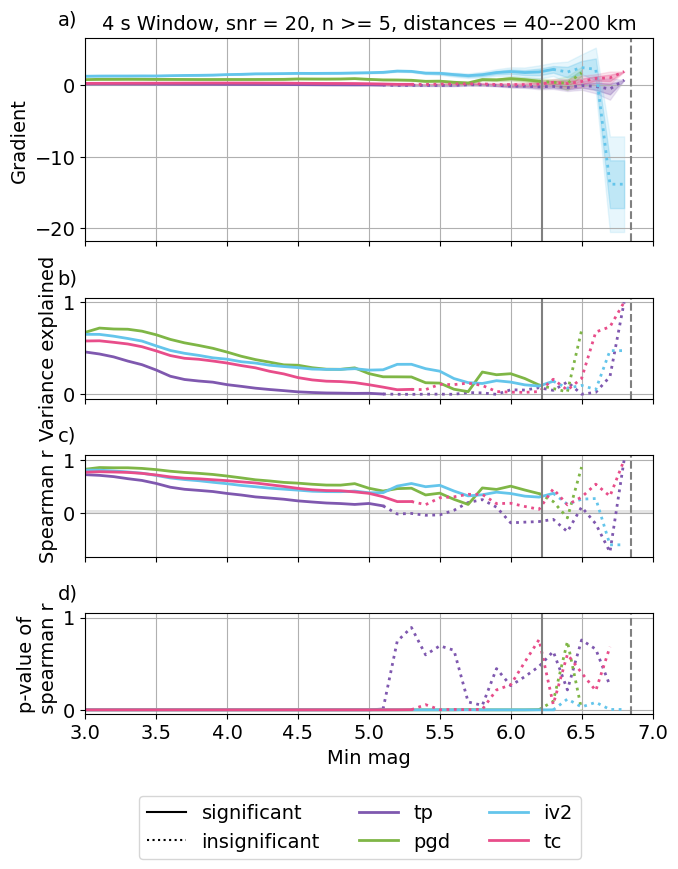

tp 0.7082145369066969
pgd 0.8190258471583812
tc 0.76085116397507
iv2 0.8103307155878524
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


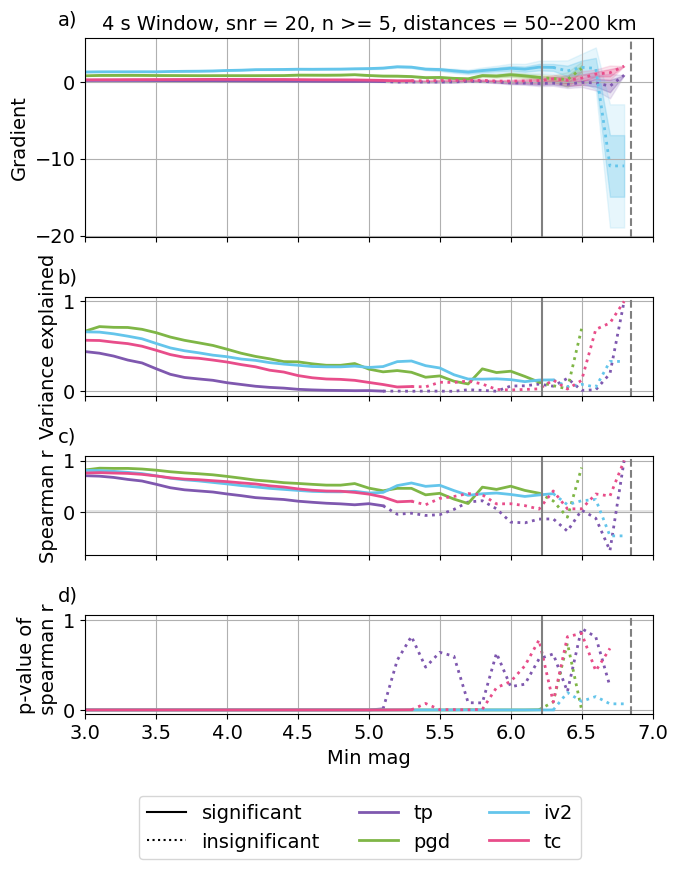

tp 0.6937146352654574
pgd 0.8110863765263105
tc 0.7458095961097446
iv2 0.8151055184577349
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


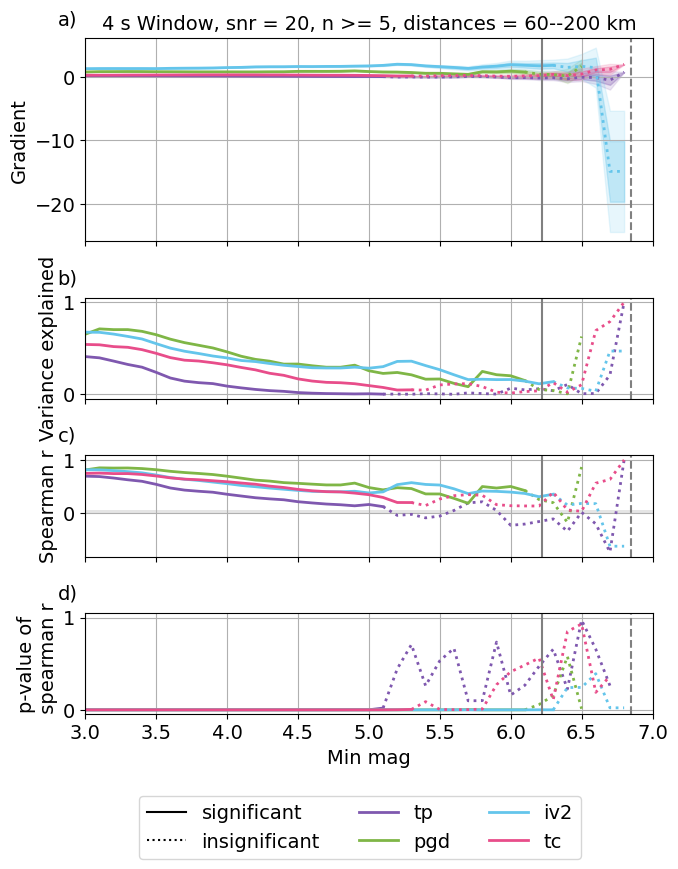

tp 0.6751106597194928
pgd 0.7959942842669933
tc 0.7178854523101987
iv2 0.8158220742604112
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


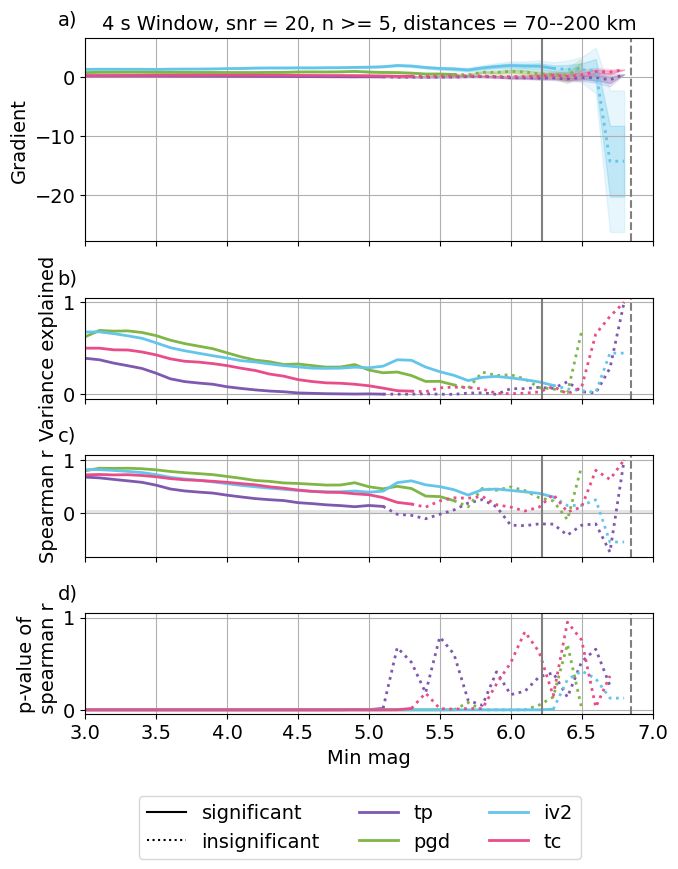

tp 0.6347464213784949
pgd 0.773445710238316
tc 0.6872478204417763
iv2 0.8177323652504641
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


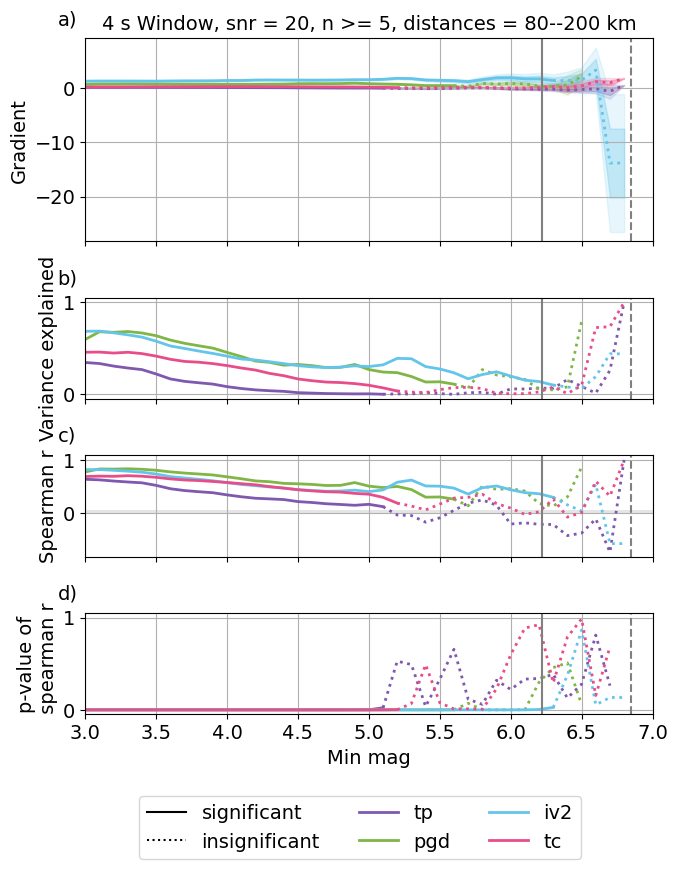

tp 0.6028396831311817
pgd 0.7384926028416844
tc 0.6581978357576024
iv2 0.8116561923528651
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


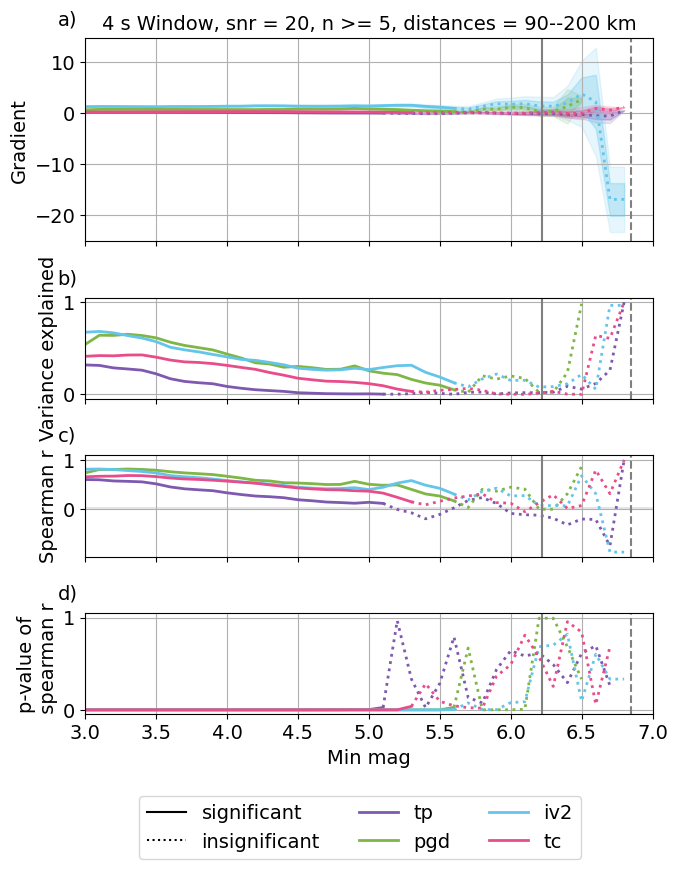

tp 0.7756152465512551
pgd 0.8282172565115193
tc 0.8117330739833888
iv2 0.8016924900261608
in else, len(res)>0
in if, len(res)==0


TypeError: unhashable type: 'list'

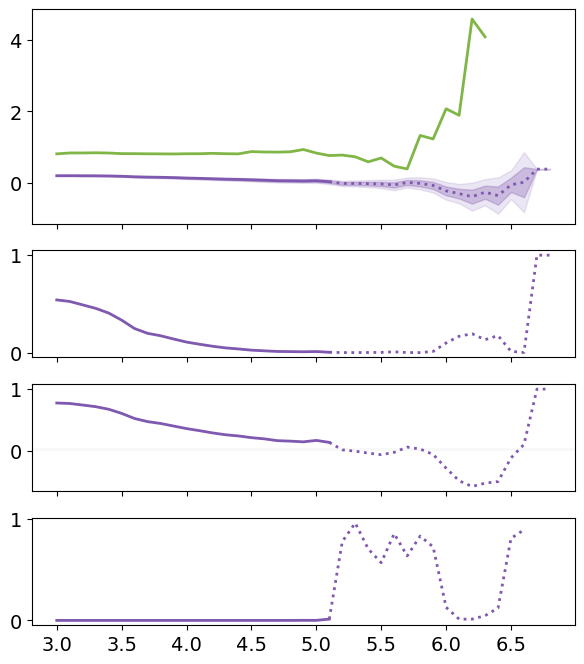

In [5]:
%matplotlib inline
n_stations = 0
min_dist = 30
max_dist = 200
for f in filenames:
    print(f)
    df = pd.read_pickle(f'/home/earthquakes1/homes/Rebecca/phd/data/results_database_hypo/{f}')
    #print(df.head(10))
    for n_stations in range(0,7):
        for min_dist in range(0, 100, 10):
            options = {'n': n_stations, 'min_dist': min_dist, 'max_dist': max_dist}
            x_tp, y_tp = calc_tp_mag_lim(df, 3.,**options)
            x_pgd, y_pgd = calc_pgd_mag_lim(df, 3.,**options)
            x_tc, y_tc = calc_tc_mag_lim(df, 3.,**options)
            x_iv2, y_iv2 = calc_iv2_mag_lim(df, 3.,**options)

            
            gradt, intercept, gradt_std, intercept_std = [],[],[],[]
            pearson = []
            spearman = []
            spearman_p = []
            n_l = []
            
            for mag_lim in magnitudes:
                x, y = calc_tp_mag_lim(df, mag_lim,**options)
                gradt, intercept, gradt_std, intercept_std, pearson, spearman, spearman_p, n = calc_opt(x,y, gradt, intercept, gradt_std, intercept_std, pearson, spearman, spearman_p, n_l)
            tp_params = [gradt, gradt_std, np.array(pearson)**2, spearman, spearman_p, n, 'tp']
            #plot_spearman_subplots(f, gradt, gradt_std, spearman, spearman_p, n, 'tp', False)  
            if len(spearman)>0:
                print('tp', spearman[0])
            
            gradt, intercept, gradt_std, intercept_std = [],[],[],[]
            pearson = []
            spearman = []
            spearman_p = []
            n_l = []
            
            for mag_lim in magnitudes:
                x, y = calc_pgd_mag_lim(df, mag_lim,**options)
                gradt, intercept, gradt_std, intercept_std, pearson, spearman, spearman_p, n = calc_opt(x,y, gradt, intercept, gradt_std, intercept_std, pearson, spearman, spearman_p, n_l)
            #plot_spearman_subplots(f, gradt, gradt_std, spearman, spearman_p, n, 'pgd', False)  
            pgd_params = [gradt, gradt_std, np.array(pearson)**2, spearman, spearman_p, n,  'pgd']
            if len(spearman)>0:
                print('pgd', spearman[0])
            
            gradt, intercept, gradt_std, intercept_std = [],[],[],[]
            pearson = []
            spearman = []
            spearman_p = []
            n_l = []
            
            for mag_lim in magnitudes:
                x, y = calc_tc_mag_lim(df, mag_lim,**options)
                gradt, intercept, gradt_std, intercept_std, pearson, spearman, spearman_p, n = calc_opt(x,y, gradt, intercept, gradt_std, intercept_std, pearson, spearman, spearman_p, n_l)
            #plot_spearman_subplots(f, gradt, gradt_std, spearman, spearman_p, n, 'pgd', False)  
            tc_params = [gradt, gradt_std, np.array(pearson)**2, spearman, spearman_p, n, 'tc']
            if len(spearman)>0:
                print('tc', spearman[0])
            
            gradt, intercept, gradt_std, intercept_std = [],[],[],[]
            pearson = []
            spearman = []
            spearman_p = []
            n_l = []
            
            for mag_lim in magnitudes:
                x, y = calc_iv2_mag_lim(df, mag_lim,**options)
                #print(len(x[y==0]))
                gradt, intercept, gradt_std, intercept_std, pearson, spearman, spearman_p, n = calc_opt(x,y, gradt, intercept, gradt_std, intercept_std, pearson, spearman, spearman_p, n_l)
            #plot_spearman_subplots(f, gradt, gradt_std, spearman, spearman_p, n, 'iv2', False)  
            iv2_params = [gradt, gradt_std, np.array(pearson)**2, spearman, spearman_p, n,'iv2']
            if len(spearman)>0:
                print('iv2', spearman[0])
            
            #plot_data_subplots_line([x_tp, x_pgd, x_tc, x_iv2], [y_tp, y_pgd, y_tc, y_iv2], ['tp','pgd','tc','iv2'],f, tp_params, pgd_params, tc_params, iv2_params)
            plot_spearman_subplots_all_on_one_no_n_shaded_percent_var(f, tp_params, pgd_params, iv2_params, tc_params, log = False, save = True, **options)
            #print(tp_params[4][0], tc_params[4][0])
            #plot_spearman_subplots_all_on_one(f, gradt, gradt_std, spearman, spearman_p, n, 'iv2', True) 
            


In [ ]:
calc_iv2_mag_lim(df, mag_lim,**options)

([], [])